# This code is made for testing out Markowitz Portfolio Theory.

Throughout this notebook, I will walk you through the math and code going on. 

First, we must import a few important packages that will be useful for us.

In [ ]:
import numpy as np
from scipy.stats import rv_discrete
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import math
import random
from bisect import bisect_left
import datetime
import urllib.request, json
import numpy as np
import pandas as pd
import datetime
import time
import json
import os
import scipy as sci
from google.colab import drive
import traceback

# Up first is the simulatation of stocks.

To do this, we must set up our constants:

* We set our current risk free interest rate (retreived at [this website](https://www.bloomberg.com/markets/rates-bonds/government-bonds/us)). This can also be toggled to whatever we would like.
* $T$ is a constant that represents how long we will let our simulated stock run for, in years. For example: $T=1$ means that the stock will be simulated for a year. $T=\frac{1}{12}$ means that it will be simulated for a month.
* We multiply $T$ by $252$ because it is (approximately) the number of trading days in a year. This tells us how many data points to simulate.
* Lastly, we generate a few random values to assign as our drift value $\mu$ and volatility $\sigma$. We also randomly generate the starting price, and we are given the choice to add in the risk free rate as an asset. If we choose to add the risk free asset, we will see it in our graphics.

In [ ]:
# Preparing constants

RISK_FREE_INTEREST_RATE = .0418    # Risk free interest rate
T = 1         # Timeframe (in years)
dT = 1/252
num_stocks = 10
mu_range = (-.1, 2)                                       # Randomly assigning different stocks different drift values (mu),
sigma_range = (0.1, 1)                                    # volatilities/standard deviations (sigma),
S0_range = np.random.randint(5, 100, size=num_stocks)     # and starting prices (S0).

## Here we get to some meat!

The way we simulate our stocks is using *Geometric Brownian Motion*. The formula for a stock $S(t)$ that is given by Geometric Brownian Motion is solved by the differential equation

$$dS = \mu S dt + \sigma S dW,$$

where $\mu$ is the *drift* of the stock, $\sigma$ is the volatility of the stock, and $W(t)$ is Brownian motion.

The solution to this differential equation is given by

$$ S(t) = S_0 e^{\left(\mu - \frac{\sigma^2}{2}\right)t + \sigma W(t)},$$

where $S_0$ is the initial price of the stock at time $t=0$. This type of motion is often used to simulate stocks in the stock market because it has the randomness of Brownian motion, cannot go below 0, and also tends to gain momentum over time, just as other stocks do.  

Many people like to work with the log of this data, since the differential equation has a much nicer solution and since it follows a normal distribution (hence the name *lognormal*). Let $G(t) = \ln{S(t)}$. Then the differential equation that describes $G$ is given by

$$ dG = \left(\mu - \frac{\sigma^2}{2}\right)dt + \sigma dW.$$

This is just simple bronwian motion, and has the solution

$$ G(t) = \left(\mu - \frac{\sigma^2}{2}\right)t + \sigma W(t) + C,$$

where $C = G(0)$. Thus, solving for $C$, we get

$$\ln{\frac{S(t)}{S_0}} = \left(\mu - \frac{\sigma^2}{2}\right)t + \sigma W(t).$$

To simulate Brownian motion, we can use a limit of random walks!

Let $X_i$ be independant random variables with mean 0 and variance 1 for each $i \in \mathbb{N}$. Define

$$ W_n(t) = \frac{1}{\sqrt{n}}\sum_{i=1}^{⌊nt⌋} X_i.$$

[Donsker's theorem](https://en.wikipedia.org/wiki/Donsker%27s_theorem) tells us that $\lim_{n\rightarrow ∞}W_n(t)$ converges to $W(t)$, where $W$ is our mean 0 variance 1 brownian motion!

Sources:
* https://en.wikipedia.org/wiki/Geometric_Brownian_motion
* https://en.wikipedia.org/wiki/Wiener_process

In [ ]:
# Construct simulated data
# Using geometric brownian motion to model
# Brownian motion is the limit of random walk (Weiner process) with mean 0 and variance 1
# dS = mu*S*dt + sigma*S*dB
# See https://en.wikipedia.org/wiki/Geometric_Brownian_motion#Solving_the_SDE for information on solution to diffeq

def simulate_stocks(num_stocks, T, mu_range=(-.1, 2), sigma_range=(.1, 1), S0_range=(5, 100)):
    drift_mus = np.random.uniform(mu_range[0], mu_range[1],
                                  size=num_stocks)  # Randomly assigning different stocks different drift values (mu),
    std_dev_sigmas = np.random.uniform(sigma_range[0], sigma_range[1],
                                       size=num_stocks)  # volatilities/standard deviations (sigma),
    S0s = np.random.randint(S0_range[0], S0_range[1], size=num_stocks)  # and starting prices (S0).
    num_steps = round(252 * T)
    dt = T / num_steps
    inv_sqrt = math.sqrt(dt)

    df = pd.DataFrame(
        np.random.randint(0, 2,
                          size=(num_steps, num_stocks))) * 2 - 1  # Random numbers, either -1 or 1 (mean 0 varience 1)
    data = pd.DataFrame(np.zeros((num_steps, num_stocks)))
    lognormal_data = pd.DataFrame(np.zeros((num_steps, num_stocks)))
    for i in range(df.shape[1]):
        for j in range(df.shape[0]):
            # Function S(t) for price of an asset
            # Sum and multiply by 1/sqrt(n) to get weiner process
            data[i][j] = S0s[i] * np.exp(
                (drift_mus[i] - .5 * (std_dev_sigmas[i] * std_dev_sigmas[i])) * j * dt + inv_sqrt * std_dev_sigmas[i] *
                df[i][:j].sum())
            lognormal_data[i][j] = (drift_mus[i] - .5 * (std_dev_sigmas[i] * std_dev_sigmas[i])) * j * dt + inv_sqrt * \
                                   std_dev_sigmas[i] * df[i][:j].sum()

    return data, lognormal_data, drift_mus, std_dev_sigmas, S0s

We can use the following function to graph our stocks over our timeframes. 

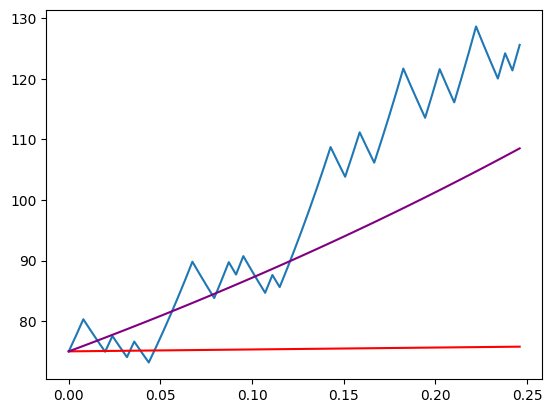

stock = 0
mu = 1.5013610925534513
sigma = 0.45402647738096824
S0 =  75


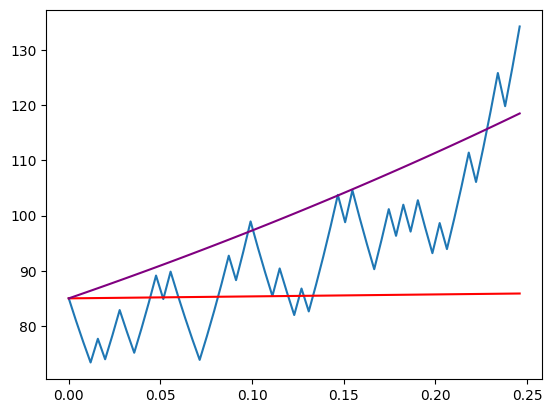

stock = 1
mu = 1.3509762172654447
sigma = 0.8407717110922304
S0 =  85


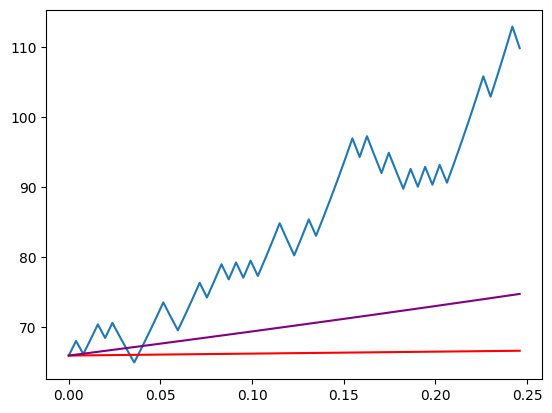

stock = 2
mu = 0.5078084852797287
sigma = 0.46590318990673174
S0 =  66


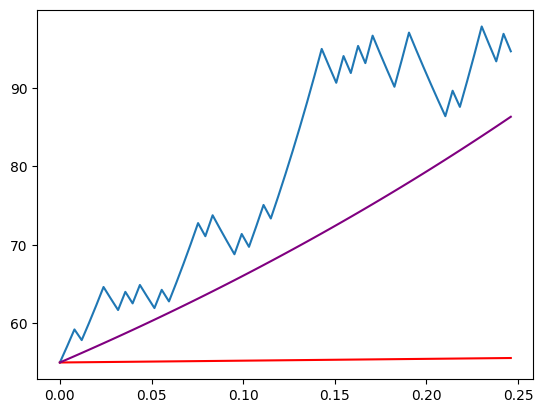

stock = 3
mu = 1.8313965544558681
sigma = 0.4773008984512641
S0 =  55


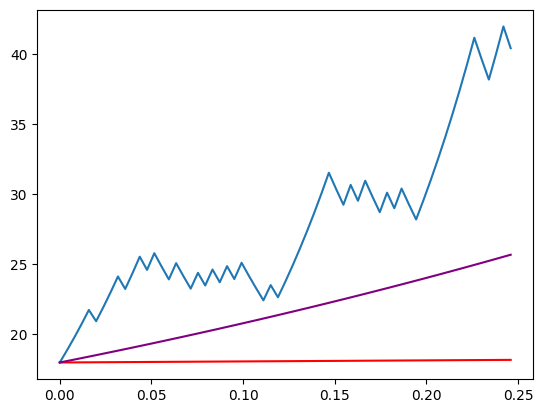

stock = 4
mu = 1.4460394375978842
sigma = 0.6738546845959789
S0 =  18


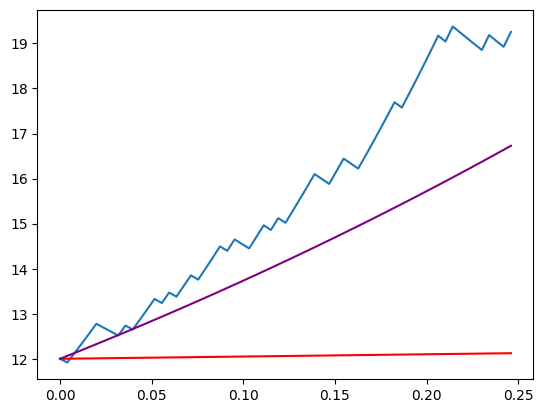

stock = 5
mu = 1.350027569051614
sigma = 0.19224440809211618
S0 =  12


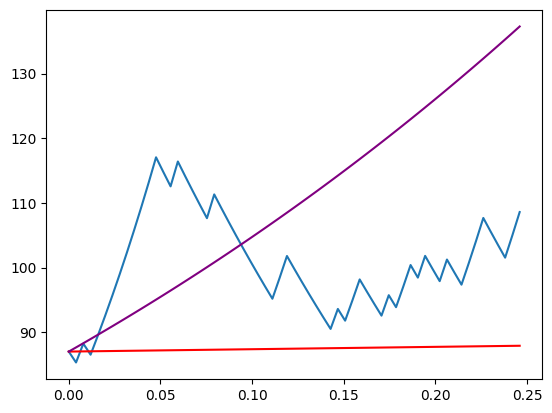

stock = 6
mu = 1.8543844868609332
sigma = 0.4220381409776033
S0 =  87


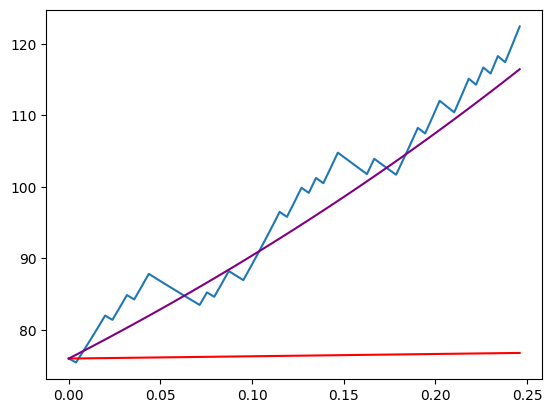

stock = 7
mu = 1.7342462040646835
sigma = 0.22285177510538365
S0 =  76


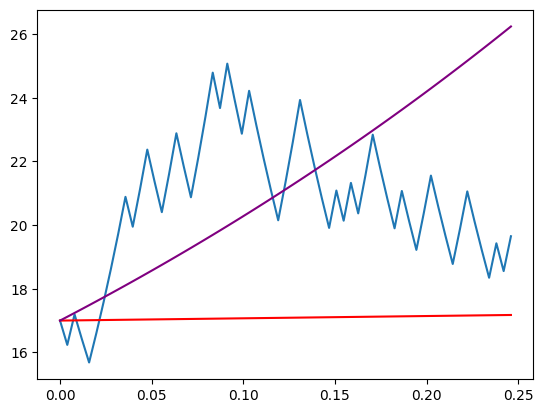

stock = 8
mu = 1.7644141592834288
sigma = 0.8198518730672608
S0 =  17


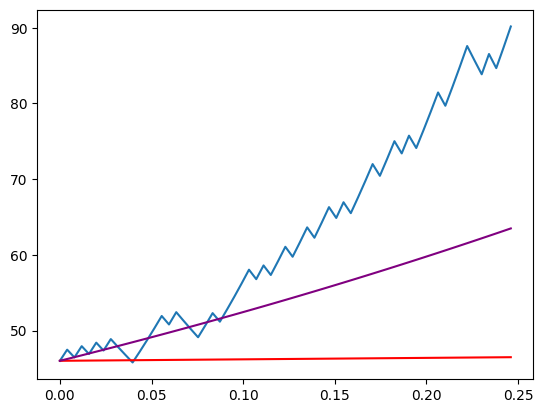

stock = 9
mu = 1.3097709873300851
sigma = 0.4227535793032513
S0 =  46


In [ ]:
# Plot simulated data
def plot_stock_data(data, T, dT, S0s, drift_mus, std_dev_sigmas, lognormal=False):

    for i, txt in enumerate(data.columns):
        S0, drift_mu, std_dev_sigma = S0s[i], drift_mus[i], std_dev_sigmas[i]
        t = np.arange(0, T, dT)
        y1 = data[i]
        if lognormal:
            y2 = RISK_FREE_INTEREST_RATE * t    # Risk-free interest rate
            y3 = (drift_mu - .5 * (std_dev_sigma * std_dev_sigma)) * t  # Drift
        else:
            y2 = S0 * np.exp(RISK_FREE_INTEREST_RATE * t)  # Risk-free interest rate
            y3 = S0 * np.exp(drift_mu * t)  # Drift

        plt.plot(t, y1)
        plt.plot(t, y2, color='red')
        plt.plot(t, y3, color='purple')
        plt.show()
        print("stock =", txt)
        print("mu =", drift_mus[i])
        print("sigma =", std_dev_sigmas[i])
        print("S0 = ", S0s[i])

Now, let us generate and plot some stocks!

In [ ]:
data, lognormal_data, drift_mus, std_dev_sigmas, S0s = simulate_stocks(num_stocks, T, mu_range, sigma_range, S0_range)

In [ ]:
plot_stock_data(data, T, dT, S0s, drift_mus, std_dev_sigmas, lognormal=False)

In [ ]:
plot_stock_data(lognormal_data, T, dT, S0s, drift_mus, std_dev_sigmas, lognormal=True)

# Next up: Modern Portfolio Thoery

## First, some background and math

This is the code that represents the *Markowitz portfolio theory*, also known as *modern portfolio theory*! The basic idea of this model is that investors will base their decisions on what to invest on soley on the expected return of a stock and the volatility of the stock. Here are the assumptions of our model:
* Investors seek to maximize the expected return of total wealth
* All investors have the same expected single period investment horizon
* All investors are risk-adverse, that is they will only accept greater risk if they
are compensated with a higher expected return
* Investors base their investment decisions on the expected return and risk
* All markets are perfectly efficient (e.g. no taxes and no transaction costs).

Markowitz originally wanted to create a model for stock portfolio selection that emphasizes diversification as important, as many other models at the time did not take into account diversification of assets. He did this by trying to minimize volatility for a given expected return.

Our goal here is to empirically find these optimal portfolios.

One thing that is important to note is that all of this is done in terms of the random variables for *rate of return*. Given a stock $X$ and a random variable $R_t$ representing the value of the stock at some discrete incriment $t$, the rate of return of the stock is

$$ r_t = \frac{R_t}{R_{t-1}}-1.$$

Using this value is so that stocks are weighed only on their percent increase. Here is the setup:

Given stocks $X_i$ for $i=1,\cdots, n$, let $r_i$ be their respective rates of return. Let $T$ be a positive number representing the time in years you want to measure. Let $e=(1, \cdots, 1)$ be the vector of all ones of length $n$, $w = (w_1, \cdots, w_n)$ be a vector such that $⟨e, w⟩ = 1$. Additionally, let $\Sigma$ denote the covariance matrix for $r_1, \cdots, r_n$. We call $w$ a *portfolio*, and the entries of $w$ are the *weights* of the portfolio. Let $\mu_i$ denote the expected rate of return for $r_i$ at time $T$. Let $m = (\mu_1, \cdots, \mu_n)$. We can calcualte the volatility $\sigma_w$ and expected value $\mu_w$ of a portfolio $w$ via the following equations:

$$\mu_w = T⟨m, w⟩$$
$$\sigma_w = \sqrt{T}⟨w, \Sigma w⟩$$

In our model, we want to find $w$ that minimizes $\frac{1}{2}\sigma_w$ subject to $\mu_w = \mu_b$ for some constant $\mu_b$. This has in fact been solved, and the portfolio $w$ is given by

$$ w = (1-\alpha)w_{min} + \alpha w_{mk}$$

where

$$w_{min} = \frac{\Sigma^{-1}e}{⟨e, \Sigma^{-1}e⟩},$$

$$w_{mk} = \frac{\Sigma^{-1}m}{⟨e, \Sigma^{-1}m⟩},$$

and

$$ \alpha = \frac{\mu_b - ⟨m, w_{min}⟩}{⟨m, w_{mk}-w_{min}⟩}.$$

We call $w_{min}$ the *minimum volatility portfolio* because $\sigma_{w_{min}} \leq \sigma_w$ for all portfolios $w$. We call $w_{mk}$ the *market portfolio* because it is the portfolio that in some sense utilizes the entire market to its fullest potential.

One important thing to note is that as we move $\mu_b$ around and graph $(\sigma_w, \mu_w)$, we get a porabola! This porabola is called the *efficient frontier*. It is the boundary of the region containing all possible pairs $(\sigma_w, \mu_w)$ for any portfolio $w$. It contains all the best possible portfolios, so it is of great importance.

One thing to note about the efficient frontier is that any portfolio on it is just a convex combination of $w_{min}$ and $w_{mk}$. This means that so long as we have these two potfolios, we can compute any optimal portfolio we desire.

One last thing to note: If we include a risk-free asset as an option with risk free rate $r_f$, the efficient frontier becomes a line that passes through the point $(0, r_f)$. Additionally, this line is tangent to the efficient frontier without the risk free asset at the point corresponding to the market portfolio. This line is called the *Capital Market Line*, and every portfolio must be below this line.

As a reminder, a portfolio $w$'s *Sharpe ratio* is given by

$$ \frac{\mu_w - r_{f}}{\sigma_w}.$$

This quatity is useful because having a higher Sharpe ratio corresponds to beating out the risk free rate with lower volatility. We will be recording these values for later. Additionally, the equation $\frac{\mu - r_f}{\sigma} = m$ is linear passing through the point $(0, r_f)$. $m$ represents the slope of this line, so increasing $m$ increases the slope of this line. Since the Capital Market Line is the line with smallest slope interesecting with the efficient frontier, it must contain the portfolio with the maximum Sharpe ratio. Hence $w_{mk}$ is the portfolio with the maximum Sharpe ratio.

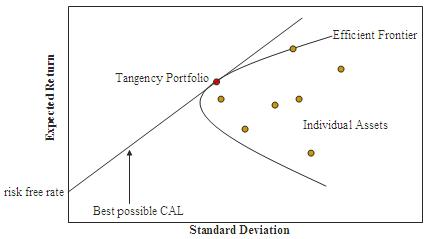

Sources:
* *Markowitz’s Portfolio Selection Model and Related Problems*, Abhijit Ravipati
* *Portfolio Selection*, Harry Markowitz
* Mark1.pdf

## Now for the code

First, we must have some basic code for getting the expected rate of return and volatility.

In [ ]:
def portfolio_expected_return(weights, mean_returns, T):
    returns = np.sum(mean_returns * weights) * T
    return returns


def portfolio_volatility(weights, cov_matrix, T_root):
    val = np.dot(weights, np.dot(cov_matrix, weights))
    if val < 0:  # the cov_matrix matrix is positive semidefinite, so theoretically this value should never be negative. If it is, then we have run into a precision error that occurs when our numbers get too small (on the order of 10e-20)
        std = 0
    else:
        std = math.sqrt(np.dot(weights, np.dot(cov_matrix, weights))) * T_root
    return std

Here, we use these equations to analytically compute the market portfolio and minimum volatility portfolios so that we can graph the Capital Market Line and Efficient Frontier. One difference in this code is that we compute the efficient frontier by taking the minimum variance portfolio as the critical point of the porabola, then solving for the quadratic that passes through the market portfolio. Similarly, we simply plot the line that goes through the market portfolio and the point $(0, r_f)$ to get the capital market line.

In [ ]:
def solve_matrix_equation(A, b, assume_a='gen'):
    if np.linalg.cond(A) < 10 ** 15:
        x = sci.linalg.solve(A, b, assume_a=assume_a)
    else:
        x = None
    return x


def get_minimum_variance_portfolio_analytically(mean_returns, cov_matrix):
    e = np.ones(len(mean_returns))
    sigma_inv_e = solve_matrix_equation(cov_matrix, e, assume_a="sym")
    if not (sigma_inv_e is None):
        w_min_var = sigma_inv_e / np.dot(e, sigma_inv_e)
        w_min_var /= np.sum(w_min_var)
    else:
        w_min_var = None
    return w_min_var

# Function that uses the analytic equations described above to get the market portfolio
# ------------------------------------------------------------------------------------------------------
# Input:
#   mean_returns (numpy array): An array with the mean returns of n different stocks
#   cov_matrix (numpy matrix): The (n)x(n) covariance matrix for the stocks
# Output:
#   w_mk (numpy vector): The portfolio that has minimum variance, or None if the covariance matrix is singular
def get_market_portfolio_analytically(mean_returns, cov_matrix):
    e = np.ones(len(mean_returns))
    sigma_inv_m =  solve_matrix_equation(cov_matrix, mean_returns, assume_a="sym")
    if not (sigma_inv_m is None):
        w_mk = sigma_inv_m/np.dot(e, sigma_inv_m)
        w_mk /= np.sum(w_mk)
    else:
        w_mk = None
    return w_mk

# Given the range of expected returns, analytically compute the efficient frontier for these values.
# ------------------------------------------------------------------------------------------------------
# Input:
#   w_mk (numpy array): The market portfolio
#   w_min (numpy array): The minimum variance portfolio
#   mean_returns (numpy array): An array with the mean returns of n different stocks
#   cov_matrix (numpy matrix): The (n)x(n) covariance matrix for the stocks
#   T (int): The number of periods measured per year
#   returns_range (numpy array): An array of floats that you wish to measure the efficient frontier on
# Output:
#   analytic_efficient_frontier_volatilities (numpy array): A list of the portfolio weights that lie on the efficient frontier
def get_analytic_efficient_frontier(w_mk, w_min, mean_returns, cov_matrix, T, returns_range):
  min_variance_volatility, min_variance_return = portfolio_volatility(w_min, cov_matrix, math.sqrt(T)), portfolio_expected_return(w_min, mean_returns, T)
  market_volatility, market_return = portfolio_volatility(w_mk, cov_matrix, math.sqrt(T)), portfolio_expected_return(w_mk, mean_returns, T)
  eff_front = lambda y: ((market_volatility - min_variance_volatility)/((market_return - min_variance_return)**2))*((y - min_variance_return)**2) + min_variance_volatility
  analytic_efficient_frontier_volatilities = eff_front(target)
  return analytic_efficient_frontier_volatilities

# Given the range of expected returns, compute the capitcal market line for these values.
# ------------------------------------------------------------------------------------------------------
# Input:
#   w_mk (numpy array): The market portfolio
#   mean_returns (numpy array): An array with the mean returns of n different stocks
#   cov_matrix (numpy matrix): The (n)x(n) covariance matrix for the stocks
#   T (int): The number of periods measured per year
#   risk_free_interest_rate (float): The risk-free interest rate
#   returns_range (numpy array): An array of floats that you wish to measure the efficient frontier on
# Output:
#   analytic_capital_market_line_volatilities (numpy array): A list of the portfolio weights that lie on the capital market line
def get_analytic_capital_market_line(w_mk, mean_returns, cov_matrix, T, risk_free_interest_rate, returns_range):
  market_volatility, market_return = portfolio_volatility(w_mk, cov_matrix, math.sqrt(T)), portfolio_expected_return(w_mk, mean_returns, T)
  CML = lambda y: market_volatility*(y - risk_free_interest_rate)/(market_return-risk_free_interest_rate)
  analytic_capital_market_line_volatilities = CML(returns_range)
  return analytic_capital_market_line_volatilities

One difficulty, however, is that sometimes the covariance matrix is singular or close to singular. This means solving the equation $\Sigma x = b$ for $x$ is nearly impossible. So we must also compute the efficient frontier empirically as well.

Additionally, you will notice that we only generate positive portfolios, i.e. none of the weights will be negative. This is because we do not want to take into account shorting the stocks. We will go more into the significance of this decision later on.

We can generate random portfolios and calculate their expected rate of return and volatility.  We must also make sure the weights add to 1, as it is a proportion of our total funds that we invest into the stock.

In [ ]:
# Given the mean returns, covarience matrix, and risk-free-interest rate, randomly select different portfolios
# and calculate their expected return, standard deviation, and sharpe ratios.
# ------------------------------------------------------------------------------------------------------
# Input:
#   num_portfolios (int): The number of random portfolios to observe (i.e. number of data points desired)
#   mean_returns (numpy array): An array with the mean returns of n different stocks
#   cov_matrix (numpy matrix): The (n)x(n) covariance matrix for the stocks
#   risk_free_rate (float): The risk free interest rate
#   T (int): The number of periods measured per year
# Output:
#   results (numpy matrix): An (3)x(num_portfolios) matrix, where the first column corresponds to the standard deviations,
#                           the second column corresponds to the expected returns, and the third column corresponds to the
#                           Sharpe ratios for each random portfolio
def random_portfolios(num_portfolios, mean_returns, cov_matrix, risk_free_rate, T):
  results = np.zeros((3, num_portfolios))
  T_root = math.sqrt(T)
  for i in range(num_portfolios):
    weights = np.random.random(size=len(mean_returns))
    weights /= np.sum(weights)
    portfolio_std_dev, portfolio_return = portfolio_volatility(weights, cov_matrix, T_root), portfolio_expected_return(weights, mean_returns, T)
    results[0,i] = portfolio_std_dev # Standard deviation
    results[1,i] = portfolio_return  # expected return
    results[2,i] = (portfolio_return - risk_free_rate) / portfolio_std_dev # Sharpe ratio
  return results

These next few functions are just used for finding the portfolio with the minimum volatility. We use the scipy package to do this.

In [ ]:
# Given the expected returns and covariance matrix, find the portfolio that minimizes volatility
# ------------------------------------------------------------------------------------------------------
# Input:
#   mean_returns (numpy array): An array with the mean returns of n different stocks
#   cov_matrix (numpy matrix): The (n)x(n) covariance matrix for the stocks
#   T (int): The number of periods measured per year
#   tolerance (float): The tolerance of sci.optimize.minimize for finding the solution
# Ouptut:
#   result (numpy array): The weights corresponding to the portfolio that minimizes volatility
def min_variance(mean_returns, cov_matrix, T, tolerance):
  num_assets = len(mean_returns)
  args = (cov_matrix, math.sqrt(T))
  constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1}, # Making sure sum of weights must be equal to 1
                 {'type': 'ineq', 'fun': lambda x: np.min(x)})   # Making sure all elements are positive
  bound = (0.0,1.0)
  bounds = tuple(bound for asset in range(num_assets)) # Each asset can range from 0% of the weight to 100% of the weight

  result = sci.optimize.minimize(portfolio_volatility, num_assets*[1./num_assets,], args=args, # Might be good to test how fast this algorithm converges/test different methods
                        method='SLSQP', bounds=bounds, constraints=constraints, tol=tolerance)['x']
  return result


def negative_eta(mu, psi, M, const_for_eta):
  return .5*np.dot(mu, np.dot(M, mu)) - const_for_eta*np.dot(psi, mu)

def min_eta(psi, M, const_for_eta):
  num_assets = len(psi)
  args = (psi, M, const_for_eta)
  constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1}, # Making sure sum of weights must be equal to 1
                 {'type': 'ineq', 'fun': lambda x: np.min(x)})   # Making sure all elements are positive
  bound = (0.0,1.0)
  bounds = tuple(bound for asset in range(num_assets)) # Each asset can range from 0% of the weight to 100% of the weight

  result = sci.optimize.minimize(negative_eta, num_assets*[1./num_assets,], args=args, # Might be good to test how fast this algorithm converges/test different methods
                        method='SLSQP', bounds=bounds, constraints=constraints, tol=tolerance)['x']
  return result

Similar to the above, we wish to also find the portfolio with the maximum Sharpe ratio, as this is also an important portfolio.

In [ ]:
# Helper function used simply as input into sci.optimize.minimize in max_sharpe_ratio
# ------------------------------------------------------------------------------------------------------
# Input:
#   weights (numpy array): An array (that sums to 1) corresponding to the weight assigned to each stock
#   mean_returns (numpy array): An array with the mean returns of n different stocks
#   cov_matrix (numpy matrix): The (n)x(n) covariance matrix for the stocks
#   risk_free_rate (float): The risk-free-interest rate
#   T (int): The number of periods measured per year
#   T_root (float): The square root of T (for efficiency)
# Output:
#   neg_sharpe_ratio: The NEGATIVE of the Sharpe ratio of the given portfolio
def neg_sharpe_ratio(weights, mean_returns, cov_matrix, risk_free_rate, T, T_root):
  p_var, p_ret = portfolio_volatility(weights, cov_matrix, T_root), portfolio_expected_return(weights, mean_returns, T)
  neg_sharpe_ratio =  -(p_ret - risk_free_rate) / p_var
  return neg_sharpe_ratio

# Given the expected returns, covariance matrix, and risk-free-interest rate, find the portfolio that maximizes Sharpe ratio
# ------------------------------------------------------------------------------------------------------
# Input:
#   mean_returns (numpy array): An array with the mean returns of n different stocks
#   cov_matrix (numpy matrix): The (n)x(n) covariance matrix for the stocks
#   risk_free_rate (float): The risk-free-interest rate
#   T (int): The number of periods measured per year
#   tolerance (float): The tolerance of sci.optimize.minimize for finding the solution
# Ouptut:
#   result (numpy array): The weights corresponding to the portfolio that minimizes volatility
def max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, T, tolerance):
  num_assets = len(mean_returns)
  args = (mean_returns, cov_matrix, risk_free_rate, T, math.sqrt(T))
  constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1}, # Making sure sum of weights must be equal to 1
                 {'type': 'ineq', 'fun': lambda x: np.min(x)})   # Making sure all elements are positive
  bound = (0.0,1.0)
  bounds = tuple(bound for asset in range(num_assets)) # Each asset can range from 0% of the weight to 100% of the weight
  result = sci.optimize.minimize(neg_sharpe_ratio, num_assets*[1./num_assets,], args=args,
                        method='SLSQP', bounds=bounds, constraints=constraints, tol=tolerance)['x']
  return result

Next, we attempt to find the *efficient frontier*. Given a specific portfolio, you can graph the expected rate of return against the volatility for all possible portfolios.

In [ ]:
# Given a expected returns, covariance matrix, target expected return, find the portfolio that has an expected return equal to
# the target value that minimizes the variance
# ------------------------------------------------------------------------------------------------------
# Input:
#   mean_returns (numpy array): An array with the mean returns of n different stocks
#   cov_matrix (numpy matrix): The (n)x(n) covariance matrix for the stocks
#   target (float): Target expected return
#   T (int): The number of periods measured per year
#   tolerance (float): The tolerance of sci.optimize.minimize for finding the solution
# Ouptut:
#   result (numpy array): The weights corresponding to the portfolio that minimizes volatility
def efficient_return(mean_returns, cov_matrix, target, T, tolerance):
  num_assets = len(mean_returns)
  args = (cov_matrix, math.sqrt(T))

  constraints = ({'type': 'eq', 'fun': lambda x: portfolio_expected_return(x, mean_returns, T) - target}, # Want expected return to be equal to target
                  {'type': 'eq', 'fun': lambda x: np.sum(x) - 1},
                  {'type': 'ineq', 'fun': lambda x: np.min(x)})                                      # and weights to sum to 1
  bounds = tuple((0,1) for asset in range(num_assets)) # Each asset can range from 0% of the weight to 100% of the weight
  result = sci.optimize.minimize(portfolio_volatility, num_assets*[1./num_assets,], args=args,
                        method='SLSQP', bounds=bounds, constraints=constraints, tol=tolerance)['fun']
  return result

# Function that traces out the efficient frontier given the range of expected returns
# ------------------------------------------------------------------------------------------------------
# Input:
#   mean_returns (numpy array): An array with the mean returns of n different stocks
#   cov_matrix (numpy matrix): The (n)x(n) covariance matrix for the stocks
#   returns_range (numpy array): An array of floats that you wish to measure the efficient frontier on
#   T (int): The number of periods measured per year
# Output:
#   efficients (list): A list of the portfolio weights that lie on the efficient frontier
def efficient_frontier(mean_returns, cov_matrix, returns_range, T, tolerance):
  length = len(returns_range)
  efficients = [None]*length
  for i in range(length):
    efficients[i] = efficient_return(mean_returns, cov_matrix, returns_range[i], T, tolerance)
  return efficients

Finally, after all that, we can compute and graph the efficient frontier for our stocks.

In [ ]:
# Function for graphing the data and the efficient frontier
# ------------------------------------------------------------------------------------------------------
# Input:
#   mean_returns (numpy array): An array with the mean returns of n different stocks
#   cov_matrix (numpy matrix): The (n)x(n) covariance matrix for the stocks
#   num_portfolios (int): The number of random portfolios to observe (i.e. number of data points desired)
#   risk_free_rate (float): The risk-free-interest rate
#   number_of_decimals (int): The number of decimal places the output will round to
#   T (int): The number of periods measured per year
def display_calculated_ef_with_random(data, risk_free_rate, number_of_decimals, num_portfolios=10000, T=252, tolerance = 10**(-8),
                                      boundary_polynomial_degree=2, efficient_frontier_granularity=100, calculate_analytic_solution=True):

  if number_of_decimals < 2:
    raise ValueError("number_of_decimals must be greater than or equal to 2")

  returns = data.pct_change() # Rate of returns for the stocks
  mean_returns = np.array(returns.mean()) # Mean rate of returns
  cov_matrix = np.array(returns.cov()) # Covariance matrix
  T_root = math.sqrt(T)

  print("Simulating portfolios...")
  t = time.time()
  results = random_portfolios(num_portfolios, mean_returns, cov_matrix, risk_free_rate, T) # Calculate standard deviation, expected return, and Sharpe ratio of different portfolios
  w, an_vol_individual_stocks, an_rt_individual_stocks = np.zeros(len(mean_returns)), np.zeros(len(mean_returns)), np.zeros(len(mean_returns))
  for i in range(len(mean_returns)):
    w[i-1] = 0
    w[i] = 1
    an_vol_individual_stocks[i] = portfolio_volatility(w, cov_matrix, T_root)
    an_rt_individual_stocks[i] = portfolio_expected_return(w, mean_returns, T)


  print("Finished simulating portfolios! This took", time.time() - t, "seconds.")

  print("Finding portfolio with maximum Sharpe ratio...")
  t = time.time()
  max_sharpe = max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, T, tolerance) # Get the portfolio with the max Sharpe ratio
  sdp, rp = portfolio_volatility(max_sharpe, cov_matrix, T_root), portfolio_expected_return(max_sharpe, mean_returns, T)  # Calculate expected value and standard deviation
  max_sharpe_allocation = pd.DataFrame(max_sharpe, index=data.columns, columns=['allocation']) # Convert to pandas dataframe for better printing
  max_sharpe_allocation.allocation = [round(i*100, number_of_decimals-2) for i in max_sharpe]
  max_sharpe_allocation = max_sharpe_allocation.T
  print("Portfolio found! This took", time.time() - t, "seconds.")

  print("Finding portfolio with minumum volatility...")
  t = time.time()
  min_vol = min_variance(mean_returns, cov_matrix, T, tolerance) # Get the portfolio with the min volatility
  sdp_min, rp_min = portfolio_volatility(min_vol, cov_matrix, T_root), portfolio_expected_return(min_vol, mean_returns, T) # Calculate expected value and standard deviation
  min_vol_allocation = pd.DataFrame(min_vol, index=data.columns, columns=['allocation'])  # Convert to pandas dataframe for better printing
  min_vol_allocation.allocation = [round(i*100, number_of_decimals-2) for i in min_vol_allocation.allocation]
  min_vol_allocation = min_vol_allocation.T
  print("Portfolio found! This took", time.time() - t, "seconds.")

  print("Finding efficient frontier...")
  t = time.time()
  target = np.linspace(min(min(results[1,:]), min(an_rt_individual_stocks)), max(max(results[1,:]), max(an_rt_individual_stocks)), efficient_frontier_granularity)
  dx = target[1] - target[0]
  target = np.append(target, [target[len(target)-1] + dx])
  target = np.append([target[0] - dx], target)
  efficient_portfolio_means = efficient_frontier(mean_returns, cov_matrix, target, T, tolerance)
  boundary_poly_coefs = np.polynomial.polynomial.polyfit(target, efficient_portfolio_means, boundary_polynomial_degree)
  print("Efficient frontier found! This took", time.time() - t, "seconds.")

  if calculate_analytic_solution:
    print("Calculating Analytic Solution...")
    if np.linalg.cond(cov_matrix) < 10**15:
      t = time.time()
      e = np.ones(len(mean_returns))
      sigma_inv_e = solve_matrix_equation(cov_matrix, e, assume_a="sym")
      w_min_var = sigma_inv_e/np.dot(e, sigma_inv_e)
      sigma_inv_m =  solve_matrix_equation(cov_matrix, mean_returns, assume_a="sym")
      w_mk = sigma_inv_m/np.dot(e, sigma_inv_m)
      w_mk /= sum(w_mk)
      W = lambda x: (1 - x)*w_min_var + x*w_mk
      mu_M = portfolio_expected_return(w_mk, mean_returns, T)
      sigma_M = portfolio_volatility(w_mk, cov_matrix, T_root)
      mu_r = lambda x: risk_free_rate + ((mu_M - risk_free_rate)/sigma_M)*x
      l = np.arange(-1000, 1000, .01)
      std_dev_analytic_CML = np.arange(0, 100, .0001)
      expected_ret_analytic_CML = mu_r(std_dev_analytic_CML)
      std_dev_analytic_eff_front, expected_ret_analytic_eff_front = [None]*len(l), [None]*len(l)
      for i in range(len(l)):
        expected_ret_analytic_eff_front[i] = portfolio_expected_return(W(l[i]), mean_returns, T)
        std_dev_analytic_eff_front[i] = portfolio_volatility(W(l[i]), cov_matrix, T_root)

      j = 0
      while j < len(expected_ret_analytic_eff_front) and expected_ret_analytic_eff_front[j] < min(target):
        j += 1
      expected_ret_analytic_eff_front = expected_ret_analytic_eff_front[max(j-50,0):]
      std_dev_analytic_eff_front = std_dev_analytic_eff_front[max(j-50,0):]
      j = 0
      while j < len(expected_ret_analytic_eff_front) and expected_ret_analytic_eff_front[j] <= max(target):
        j += 1
      expected_ret_analytic_eff_front = expected_ret_analytic_eff_front[:j+50]
      std_dev_analytic_eff_front = std_dev_analytic_eff_front[:j+50]
      j = 0
      while j < len(expected_ret_analytic_CML) and expected_ret_analytic_CML[j] <= max(target):
        j += 1
      expected_ret_analytic_CML = expected_ret_analytic_CML[:j+10]
      std_dev_analytic_CML = std_dev_analytic_CML[:j+10]

      w_mk = pd.DataFrame(w_mk, index=data.columns, columns=['allocation']) # Convert to pandas dataframe for better printing
      w_mk.allocation = [round(i*100, number_of_decimals-2) for i in w_mk.allocation]
      w_mk = w_mk.T
      print("Analytic soltuion computed! This took", time.time() - t, "seconds.")
      singular = False
    else:
      print("Warning: Covariance matrix is too close to being singular. Analytic solution cannot be computed.")
      singular = True
      w_mk = None
  else:
    w_mk = None
    singular = True


  print("Displaying results")
  print("\n\n\n")

  print("-"*80) # Printing info about maximal Sharpe ratio portfolio
  print("Maximum Sharpe Ratio Portfolio Allocation\n")
  print("Annualised Return:", round(rp, number_of_decimals))
  print("Annualised Volatility:", round(sdp, number_of_decimals))
  print("Sharpe Ratio:", round((rp - risk_free_rate) / sdp, number_of_decimals))
  print("\n")
  print(max_sharpe_allocation)
  print("-"*80) # Printing info about minimial volatility portfolio
  print("Minimum Volatility Portfolio Allocation\n")
  print("Annualised Return:", round(rp_min, number_of_decimals))
  print("Annualised Volatility:", round(sdp_min, number_of_decimals))
  print("Sharpe Ratio:", round((rp_min - risk_free_rate) / sdp_min, number_of_decimals))
  print("\n")
  print(min_vol_allocation)
  if not singular:
    print("-"*80)
    print("Analytic Market Portfolio Allocation\n")
    print("Annualised Return:", round(mu_M, number_of_decimals))
    print("Annualised Volatility:", round(sigma_M, number_of_decimals))
    print("Sharpe Ratio:", round((mu_M - risk_free_rate) / sigma_M, number_of_decimals))
    print("\n")
    print(w_mk)
  print("-"*80)
  print("Polynomial Approximation for the Boundary\n")
  boundary_poly_coefs_saved = np.copy(boundary_poly_coefs)
  s = str(round(boundary_poly_coefs[0], number_of_decimals))
  if boundary_poly_coefs[1] >= 0:
    s += " + "
  else:
    s += " - "
    boundary_poly_coefs[1] = (-1)*boundary_poly_coefs[1]
  s += str(round(boundary_poly_coefs[1], number_of_decimals)) + "y"
  for i in range(2, len(boundary_poly_coefs)):
    if boundary_poly_coefs[i] >= 0:
      s += " + "
    else:
      s += " - "
      boundary_poly_coefs[i] = (-1)*boundary_poly_coefs[i]
    s += str(round(boundary_poly_coefs[i], number_of_decimals)) + "y^" + str(i)
  print(s)
  print("\n")

  plt.figure(figsize=(10, 7))
  plt.scatter(results[0,:],results[1,:],c=results[2,:],cmap='YlGnBu', marker='o', s=10, alpha=0.3)
  color_bar = plt.colorbar()
  color_bar.set_label('Sharpe Ratio')
  plt.scatter(sdp,rp,marker='*',color='y',s=200, label='Maximum Sharpe ratio')
  plt.scatter(sdp_min, rp_min, marker='*',color='g',s=200, label='Minimum volatility')
  plt.scatter(an_vol_individual_stocks, an_rt_individual_stocks, color='red', marker='o',s=20)
  for i, txt in enumerate(data.columns):
    plt.annotate(txt, (an_vol_individual_stocks[i],an_rt_individual_stocks[i]), xytext=(10,0), textcoords='offset points')
  plt.plot(efficient_portfolio_means, target, linestyle='-.', color='black', label='positive efficient frontier')
  plt.plot(np.polyval(boundary_poly_coefs_saved[::-1], target), target, color='green', alpha=0.5, label='polynomial approximation')
  if not singular:
    plt.scatter([sigma_M], [mu_M], color='red', marker='o',s=50)
    plt.annotate("Market Portflio", (sigma_M, mu_M), xytext=(10,0), textcoords='offset points')
    plt.plot(std_dev_analytic_eff_front, expected_ret_analytic_eff_front, linestyle='-.', color='red', alpha=0.5, label="analytic soltution for efficient frontier")
    # plt.plot(std_dev_analytic_CML, expected_ret_analytic_CML, linestyle='-.', color='blue', alpha=0.5, label="analytic soltution for capital market line")
  plt.title('Calculated Portfolio Optimization based on Efficient Frontier')
  plt.xlabel('annualised volatility')
  plt.ylabel('annualised returns')
  plt.legend(labelspacing=0.8)

  return max_sharpe, min_vol, w_mk, (target, efficient_portfolio_means), boundary_poly_coefs_saved

Simulating portfolios...
Finished simulating portfolios! This took 1.9209425449371338 seconds.
Finding portfolio with maximum Sharpe ratio...
Portfolio found! This took 0.09092307090759277 seconds.
Finding portfolio with minumum volatility...
Portfolio found! This took 0.019646167755126953 seconds.
Finding efficient frontier...
Efficient frontier found! This took 1.9490900039672852 seconds.
Calculating Analytic Solution...
Analytic soltuion computed! This took 4.456823825836182 seconds.
Displaying results




--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 2.0929243202
Annualised Volatility: 0.110197255
Sharpe Ratio: 18.613207025


                   0    1         2         3         4          5         6  \
allocation  4.535186  0.0  7.675159  5.874282  5.986767  40.507397  7.096816   

                    7         8        9  
allocation  19.980668  0.644516  7.69921  
------------------

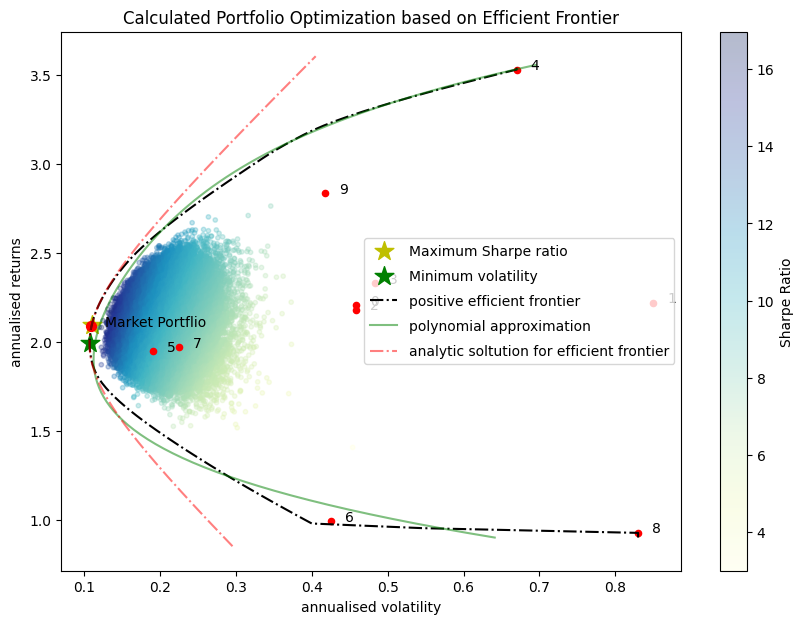

In [ ]:
# Attempt to recreate the efficient frontier with data

num_portfolios = 100000
risk_free_rate = rf
num_decimal_points = 10
tolerance = 10**(-15)
boundary_polynomial_degree = 4
efficient_frontier_granularity = 100
num_days_to_estimate_into_future=252

max_sharpe, min_vol, w_mk, (target, efficient_portfolio_means), boundary_poly_coefs_saved = display_calculated_ef_with_random(
                                         data=data, num_portfolios=num_portfolios, risk_free_rate=risk_free_rate,
                                         number_of_decimals=num_decimal_points, T=num_days_to_estimate_into_future,
                                         tolerance=tolerance, boundary_polynomial_degree=boundary_polynomial_degree,
                                         efficient_frontier_granularity=efficient_frontier_granularity,
                                         calculate_analytic_solution=True)

Simulating portfolios...
Finished simulating portfolios! This took 3.1112163066864014 seconds.
Finding portfolio with maximum Sharpe ratio...
Portfolio found! This took 0.040982723236083984 seconds.
Finding portfolio with minumum volatility...
Portfolio found! This took 0.03085184097290039 seconds.
Finding efficient frontier...
Efficient frontier found! This took 15.330447673797607 seconds.
Calculating Analytic Solution...
Analytic soltuion computed! This took 7.403538227081299 seconds.
Displaying results




--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.5619856608
Annualised Volatility: 0.0301820923
Sharpe Ratio: 17.2349105683


                   0    1       2         3         4          5         6  \
allocation  5.793803  0.0  8.6305  6.419173  5.609525  30.656815  8.408115   

                  7         8         9  
allocation  25.0615  0.256591  9.163977  
----------------------

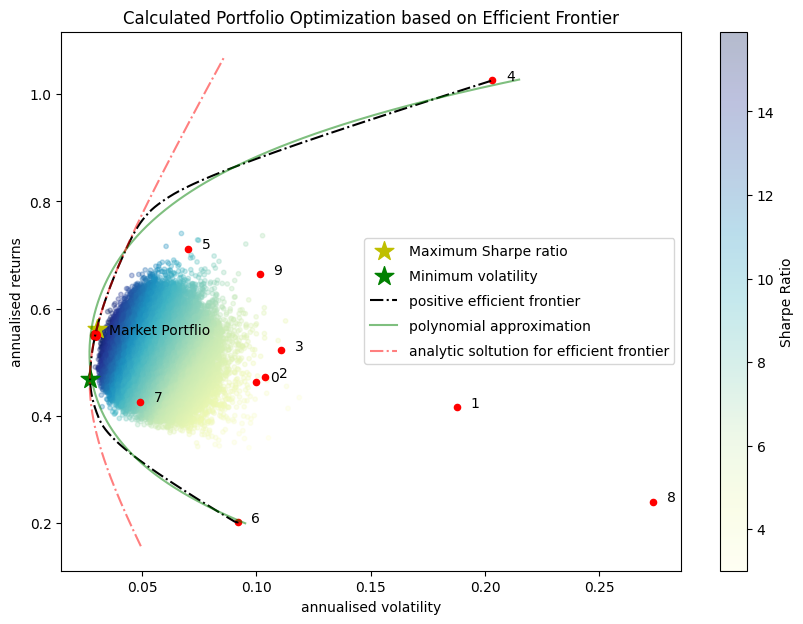

In [ ]:
# Attempt to recreate the efficient frontier with LOG DATA

num_portfolios = 100000
risk_free_rate = rf
num_decimal_points = 10
tolerance = 10**(-15)
boundary_polynomial_degree = 4
efficient_frontier_granularity = 500
num_days_to_estimate_into_future=252

max_sharpe, min_vol, w_mk, (target, efficient_portfolio_means), boundary_poly_coefs_saved = display_calculated_ef_with_random(
                                         data=np.log(data), num_portfolios=num_portfolios, risk_free_rate=risk_free_rate,
                                         number_of_decimals=num_decimal_points, T=num_days_to_estimate_into_future,
                                         tolerance=tolerance, boundary_polynomial_degree=boundary_polynomial_degree,
                                         efficient_frontier_granularity=efficient_frontier_granularity,
                                         calculate_analytic_solution=True)


What you may notice is that the analytic efficient frontier is different from the observed efficient frontier. This is because the observed efficient frontier only takes into account positive portfolios, meaning we cannot minimize th equation all the way, and the boundary does not become a porabola. This means that much of our analytic data is for naught. :(

Unfortunatly, there is not much we can do about this.

# Time for real life data!

Next, we swtich to working with real life data! Much of the same math applies, and so we need only format our data to look nice.

## But first, we must set up and format our data

Before we can actually play with real life data, we need to scrape it from somewhere. For us, that will be from Yahoo Finance, as they store a lot of good information coneniantly in json data on their website.

First, we write a few helper functions that will be useful later on, such as a way to convert between dates and unix times (seconds since january 1 1970).

In [ ]:
# Simple function to get the index of the historal data for a given start time and end time
# Inputs:
#   starttime: The start time (in seconds since jan 1 1970) of the range you want to observe
#   endtime: The end time (in seconds since jan 1 1970) of the range you want to observe
# Outputs:
#   i1: The starting index
#   i2: The ending index
def get_partition_timeseries_indices(starttime, endtime):
  i1, i2 = int((starttime - (starttime%86400))/86400), int((endtime - (endtime%86400))/86400)
  return i1, i2

# Function that inputs a day, month, and year and outputs the unix timecode (seconds since jan 1 1970)
# Inputs:
#   day: integer representing the day of the month
#   month: integer representind the month of the year
#   year: integer >= 1970 represending the year
# Output:
#   Integet representing seconds since jan 1 1970
def get_unix_time_from_date(day, month, year):
  return int(datetime.datetime(year, month, day).timestamp())

# Function that fetches the market cap of a given stock
# Input:
#   ticker (string): The ticker name for the stock you wish to get the market cap for
# Output:
#   marketcap (int): The current marketcap for that stock, or None if there was an error grabbing the data
def get_market_cap(ticker):
  try:
    j = pd.read_json("https://query1.finance.yahoo.com/v6/finance/options/" + ticker)
    marketcap = j["optionChain"]["result"][0]["quote"]["marketCap"]
  except Exception as e:
    print(e)
    marketcap = None
  return marketcap


# Function that looks through data and removes stocks that do not have enough data in them
# Input:
#   data (pandas dataframe): A pandas dataframe of stock data
# Output:
#   data[good_tickers] (pandas dataframe): The dataframe after removing tickers that have too many NaNs.
def remove_stocks_without_enough_data(data, i1, i2):
  data_temp = data.iloc[i1:i2]
  num_nans = data_temp.isnull().sum()
  max_nan = num_nans.min()
  good_tickers = []
  for i, ticker in enumerate(data.columns):
    if num_nans[ticker] == max_nan:
      good_tickers.append(ticker)
  return data[good_tickers]

# Function that adds a set amount of days, months, or years to a given date
# Input:
#   current_day (int): The given day of the date
#   current_month (int): The given month of the date
#   current_year (int): the given year of the date
#   unit_of_time (string): The unit of time you with to add to the specified current date. It must either be
#                          "day", "month", or "year"
#   jump (int): The number of "unit_of_time"s you wish to add to the given date
# Output:
#   next_day (int): The day of the date after addition
#   next_month (int): The month of the date after addition
#   next_year (int): The year of the date after addition
def add_days_months_or_years_to_date(current_day, current_month, current_year, unit_of_time, jump):
  date = datetime.datetime(current_year, current_month, current_day)
  if unit_of_time == "day":
    date = datetime.datetime(current_year, current_month, current_day)
    new_date = date + datetime.timedelta(days=jump)
    next_day, next_month, next_year = new_date.day, new_date.month, new_date.year
  elif unit_of_time == "month":
    next_day = current_day
    next_year = current_year
    while current_month + jump < 1:
      next_year -= 1
      jump += 12
    while current_month + jump > 12:
      next_year += 1
      jump -= 12
    next_month = current_month + jump
  elif unit_of_time == "year":
    next_day, next_month, next_year = current_day, current_month, current_year + jump
  else:
    raise ValueError('Variable "unit_of_time" must either be "day", "month", or "year"')
  return next_day, next_month, next_year

# A function to use only particular desired stocks
# Input:
#   data (pd dataframe): a dataframe of data
#   desired_stocks (list): a list of ticker names of the stocks you wish to use
# Output:
#   data (pd dataframe): the data containing only the desired stocks (so long as the data contained the information for the stocks to begin with)
def use_only_desired_stocks(data, desired_stocks):
  stocks = data.columns.to_list()
  keep = []
  for ticker in desired_stocks:
    if ticker in stocks:
      keep.append(ticker)
  data = data[keep]
  return data

# A function to remove particular stocks from dataset
# Input:
#   data (pd dataframe): a dataframe of data
#   banned_stocks (list): a list of ticker names of stocks you wish to ban
# Output:
#   data (pd dataframe): the data without the columns containing the banned stocks
def remove_banned_stocks(data, banned_stocks):
  stocks = data.columns.to_list()
  banned = []
  for ticker in banned_stocks:
    if ticker in stocks:
      banned.append(ticker)
  data.drop(columns=banned, inplace=True)
  return data

Next, we mount google drive so that we can write and grab data easily. We do this because google Colab will not save files between runtimes (very inconvenient). We will have 3 sets of data: every single stock on the NASDAQ, every SMP 500 stock, and every stock listed in James' original list.

In [ ]:
# Mounting google drive to get files
drive.mount('/content/drive', force_remount=True)

# Make sure that this path exists in google drive. (I.e. just have a folder named "research24" and make sure that RTD_ticker_names.csv is inside of it.)
folder_path = os.path.join("drive", "MyDrive", "research24")
nasdaq_json_path_name = "nasdaq_stock_data.json"
SMP500_json_path_name = "SMP500_stock_data.json"
james_json_path_name = "james_stock_data.json"

Mounted at /content/drive


This next bit of code accesses open source data from Yahoo Finance, giving us information on the closing prices of every stock for a given stock ticker. For an example of what this data looks like, [look here](https://query1.finance.yahoo.com/v8/finance/chart/AAPL).

I would recommend running this code overnight. If you have already run this code in the past, there is no need to run it again, as you should already have the data saved to your google drive.

In [ ]:
# Get data from yahoo finace and format it as pandas dataframe
# Don't need to run this if you have run it before, as we just grab the json again later

json_paths = [nasdaq_json_path_name, SMP500_json_path_name, james_json_path_name]

tickers_df = pd.read_csv(os.path.join(folder_path, "RTD_ticker_names.csv"))
tickers_list = tickers_df.columns # Column 0 is all nasdaq stocks, Column 1 is SMP500 stocks, column 2 is stocks from James' google sheet
exception_occurred = False
data_lengths = {}
for i in range(len(json_paths)):
  print("getting data for", json_paths[i])
  tickers = list(set([T[1] for T in tickers_df[tickers_list[i]].items() if isinstance(T[1], str) and T[1].isalnum()]))
  day_length = 86400

  data = {}
  current_time = round(datetime.datetime.now(datetime.timezone.utc).timestamp())
  for ticker in tickers:
    ticker = ticker.upper()
    try:
      # Yahoo Finance has json data of historical stock info by day since jan 1 1970. We can put this into pandas to easily manipiulate it and calculate covarience
      try:
        json_data = pd.read_json("https://query1.finance.yahoo.com/v8/finance/chart/" + ticker + "?period1=0&period2=" + str(current_time) + "&interval=1d&events=history&crumb=tO1hNZoUQeQ")
      except Exception as e:
        if str(e) == "HTTP Error 429: Too Many Requests":
          print("Too many requests. Slowing down")
          exit = False
          while not exit:
            print("Waiting for 60 seconds...")
            time.sleep(60)
            try:
              json_data = pd.read_json("https://query1.finance.yahoo.com/v8/finance/chart/" + ticker + "?period1=0&period2=" + str(current_time) + "&interval=1d&events=history&crumb=tO1hNZoUQeQ")
              exit = True
            except Exception as e:
              if str(e) == "HTTP Error 429: Too Many Requests":
                pass
              else:
                raise e
        else:
          raise e



      timestamps = json_data["chart"]["result"][0]["timestamp"]
      closing_prices = json_data["chart"]["result"][0]["indicators"]["quote"][0]["close"]

      if closing_prices[-1] is None:
        print(ticker, "was delisted (I think)")
        continue

      t = 0
      j = 0
      p = []
      while t <= current_time and j < len(timestamps): # This loop makes sure each index in the list corresponds to a day since jan 1 1970. If there is no data for a particular day, then we input None. This make pandas happy, since lists with unequal lengths are bad
        if t <= timestamps[j] and timestamps[j] < t+day_length:
          p.append(closing_prices[j])
          j += 1
        else:
          p.append(None)
        t += day_length
      data[ticker] = p
      if len(p) in data_lengths.keys():
        data_lengths[len(p)] += 1
      else:
        data_lengths[len(p)] = 1
      print(ticker)
    except Exception as e:
      print("Error with ticker:", ticker + ";", e)
      traceback.print_tb(e.__traceback__)
      print("", end="")

  l = -1
  max_length = None
  for k in data_lengths.keys():
    if data_lengths[k] > l:
      l = data_lengths[k]
      max_length = k

  bad_keys = []
  for key in data.keys():
    if len(data[key]) != max_length:
      print(key, "had inccorect data length:", len(data[key]), "!=", max_length)
      bad_keys.append(key)
  for key in bad_keys:
    del data[key]
  data = pd.DataFrame(data)
  data.to_json(os.path.join(folder_path, json_paths[i]))


Streaming output truncated to the last 5000 lines.
OMEX
AREBW
TD
BSX
MGEE
SA
CORT
ASML
ELMD
NEN
AOMR
SSP
GWRS
AYI
BXP
NAAS
MGYR
STRT
OCX
DMAC
SGLY
NEON
RWT
IGI
RFAIR
AACI
HR
NTRS
WST
ATRA
NIVFW
ERNA
NUKK
MVSTW
VPV
BROS
THAR
CHUY
KDLYW
RUSHA
CLDI
VIRI
CIF
FLS
IIF
DFS
ALRN
GJP
YALA
CRBU
STRM
GENK
NVGS
KMDA
ITRN
BDX
PXS
FEDU
OCGN
SKLZ
ODVWZ
CGTX
FR
ZLAB
GLBZ
CHW
LNZA
GTLB
HNRG
TOYO
BEN
MKTW
SEAT
RCRT
NVO
NISN
AVGR
UPWK
TAYD
LIF
RGF
BWBBP
PET
MREO
BNIXW
SNAX
RGLS
POST
ABOS
TV
ENLT
ABVE
OCSL
HALO
AMKR
TPX
FOA
TPET
NCSM
RNST
HLNE
NDRA
REZI
SUI
CRESY
ICFI
NATL
VXZ
FN
ECAT
KWR
TMUS
MCHX
NIE
VRN
BATRK
MNST
GPRO
AMTD
WDI
VST
APG
EICB
LILAK
VSME
ISTR
BPOPM
LOAN
INTU
JDZG
ROIV
IGA
HROWL
BIO
EQS
HIMS
SLGN
HCI
VLYPO
MKL
UPXI
KC
PRPL
KFY
GOOD
LLY
ROCLU
AXIL
ACGL
BNIXR
CITEU
ZUO
IVCPW
NICE
WRN
OXBRW
EZFL
PHM
GOOG
ROG
SSIC
MGRB
GWAV
SMRT
PR
CMLS
FUSB
AGRI
YJ
ICHR
DLB
GSBD
NOTV
NTNX
SRBK
TMDX
TTI
MRT
SEPA was delisted (I think)
PLOW
APVO
ENTX
CDXC
ORAN
OVLY
GHIXW
CCLDP
ICG
IDT
BCSAU
SONY
ZTR
JLL
HAFC
PN

  File "<ipython-input-19-a712a7bef42b>", line 39, in <cell line: 10>
    raise e
  File "<ipython-input-19-a712a7bef42b>", line 22, in <cell line: 10>
    json_data = pd.read_json("https://query1.finance.yahoo.com/v8/finance/chart/" + ticker + "?period1=0&period2=" + str(current_time) + "&interval=1d&events=history&crumb=tO1hNZoUQeQ")
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/json/_json.py", line 780, in read_json
    json_reader = JsonReader(
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/json/_json.py", line 893, in __init__
    data = self._get_data_from_filepath(filepath_or_buffer)
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/json/_json.py", line 933, in _get_data_from_filepath
    self.handles = get_handle(
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/common.py", line 718, in get_handle
    ioargs = _get_filepath_or_buffer(
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/common.py", line 372, in _get_filepath_or_buffe

SPGI
GRFS
WVVI
WBA
SNAP
NKE
PWR
TS
UPST
LIN
AMGN
LRCX
CSCO
ADM
SONY
NCLH
CGC
CACC
DAL
BTI
ESLT
HSY
MGIC
DRD
IPG
NYT
SEDG
RIOT
WNS
Error with ticker: MIXT; HTTP Error 404: Not Found


  File "<ipython-input-19-a712a7bef42b>", line 39, in <cell line: 10>
    raise e
  File "<ipython-input-19-a712a7bef42b>", line 22, in <cell line: 10>
    json_data = pd.read_json("https://query1.finance.yahoo.com/v8/finance/chart/" + ticker + "?period1=0&period2=" + str(current_time) + "&interval=1d&events=history&crumb=tO1hNZoUQeQ")
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/json/_json.py", line 780, in read_json
    json_reader = JsonReader(
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/json/_json.py", line 893, in __init__
    data = self._get_data_from_filepath(filepath_or_buffer)
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/json/_json.py", line 933, in _get_data_from_filepath
    self.handles = get_handle(
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/common.py", line 718, in get_handle
    ioargs = _get_filepath_or_buffer(
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/common.py", line 372, in _get_filepath_or_buffe

RCL
SKM
DD
PARA
WTRG
IBM
PDD
BLK
PEG
MARA
GIS
SJW
SWBI
ACN
DIS
Error with ticker: DISH; HTTP Error 404: Not Found


  File "<ipython-input-19-a712a7bef42b>", line 39, in <cell line: 10>
    raise e
  File "<ipython-input-19-a712a7bef42b>", line 22, in <cell line: 10>
    json_data = pd.read_json("https://query1.finance.yahoo.com/v8/finance/chart/" + ticker + "?period1=0&period2=" + str(current_time) + "&interval=1d&events=history&crumb=tO1hNZoUQeQ")
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/json/_json.py", line 780, in read_json
    json_reader = JsonReader(
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/json/_json.py", line 893, in __init__
    data = self._get_data_from_filepath(filepath_or_buffer)
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/json/_json.py", line 933, in _get_data_from_filepath
    self.handles = get_handle(
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/common.py", line 718, in get_handle
    ioargs = _get_filepath_or_buffer(
  File "/usr/local/lib/python3.10/dist-packages/pandas/io/common.py", line 372, in _get_filepath_or_buffe

WMT
ATGE
NET
SLM
DXCM
T
CHGG
GRWG
UHAL
META
MTCH
FICO
HWM
KDP
VZ
BK
SAM
FCFS
TX
CLH
DESP
SSL
DEO
BBIO
MRK
TGT
NOC
TM
RYAAY
CMRE
FSLR
SHEL
RIO
MGPI
CZR
SPCE
CB
MPC
K
GD
PY
MMYT
TLRY
INTC
GLW
USB
CVX
APP
KO
PH
AAL
TSCO
SCO
MCD
MGM
YPF
NNOX
VOO
FTNT
ALB
CAT
GOOGL
RTX
SBSW
RDY
KR
SOFI
EZPW
NTDOY
NVS
QS
KHC
TGS
ACB
PG
STZ
UHS
TARO was delisted (I think)
CWT
TSLA
NAVI
AMD
LOPE
CWEN
KOS
URI
BKNG
AVGO
ULTA
TD
PZZA
WBD
ODFL
X
MMM
BWG
PSO
ACGL
PFE
DIN
CRM
WCN
CARR
PLTR
SPOT
XOM
GM
DSX
RACE
FREY
MDLZ
LVS
SLB
TSM
UL
NFLX
CMCSA
WIX
TRV
WM
CRON
ETN
GAME
LPL
SBS
TNP
BB
DAC
UBER
TEF
NVR
KB
XRAY
REGN
PM
ROKU
ETR
CPRT
JNJ
HON
BHP
BMBL
OMF
AMZN
HMC
LMT
BAC
TAP
BA
WYNN
VIST
LOMA
BND
FCX
SO
MSI
ORCL
ADBE
HD
PKX
NXPI
HDB
SUM
TEO
VLN
AA
V
ELF
MNDY
NVMI
NVDA
SBUX
DHI
TOPS
F
ON
TXN
AXP
VALE
AZN
PEP
MELI
BMA
SNDL
PAM
PSA
UAL
AAPL
DG
SQ
JPM
WIT
GS
NNI
BSX
GGAL
LOVE
UNH
RSG
CCJ
VRT
BBVA
IHS
CCL
WDC
TSEM
PYPL
SJM
LYFT
GASS
CHK
NVO
QCOM
IBN
AWR
MSEX
ASML
TEVA
ICL
MVST
SIFY
PCG
HAL
LLY
QNRX
AWK
DOW
GE
DLTR
MO
SAN
HM

Once you have run the above code once before, we can finally grab the saved data to use.

In [ ]:
# Grabbing data
json_data = pd.read_json(os.path.join(folder_path, SMP500_json_path_name))

## Now we can actually use it! Hurray!

Let us first experiment with this over a single time period.

First, we may select a smaller batch of stocks to test. We must also pick a time period over which we want the model to estimate the expected rate of return and volatility, i.e. how much historical data to use.

Finally, we want a time to check our stocks to see how good they perform. For example: given a month of historical data, we can try and predict the next month.

In [ ]:
# setting time period, and initializing important constants

desired_stocks = "all" # This can either be the string "all" for all stocks in our database, or it can be a selection of stocks, for example ['MMM', 'AAPL', 'AMZN', 'GOOG', 'TSLA', 'NVDA', 'MSFT', 'INTC', 'CAT', 'BA']
banned_stocks = ['GASS', 'SHIP', 'TEO', 'TOPS', 'TGS', 'MARA', 'UPST', 'RIOT', 'GRND'] # None for no banned stocks, or a list of the stocks you wish not to include, for example ['GASS', 'SHIP', 'TEO', 'TOPS', 'TGS', 'MARA', 'UPST', 'RIOT', 'GRND']
start_time_historical, end_time_historical = get_unix_time_from_date(1, 2, 2022), get_unix_time_from_date(1, 3, 2022) # For example, the input (1, 4, 2020) corresponds to the date April 1, 2020
final_time_observed = get_unix_time_from_date(1, 1, 2023)
risk_free_rate = 0.0418

Here are a few important constants that we will use in our computation later.

In [ ]:
i1, i2 = get_partition_timeseries_indices(start_time_historical, end_time_historical)
if desired_stocks == "all":
  data = json_data
else:
  data = use_only_desired_stocks(json_data, desired_stocks)
if not(banned_stocks is None):
  data = remove_banned_stocks(data, banned_stocks)
data = remove_stocks_without_enough_data(data, i1, i2)
data = data.iloc[i1:i2]

Here, we plot the data over the historical time period. The blue line is the value of the stock and the red line corresponds to the risk free interest rate to see how it compares. We also save the ending values of the stocks to see how the stocks compare.

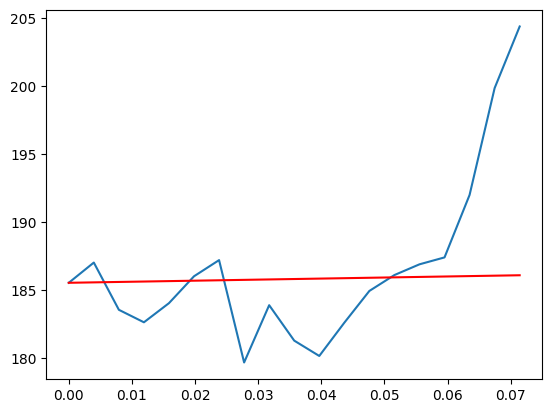

Stock = HII
S0 =  185.5200042725


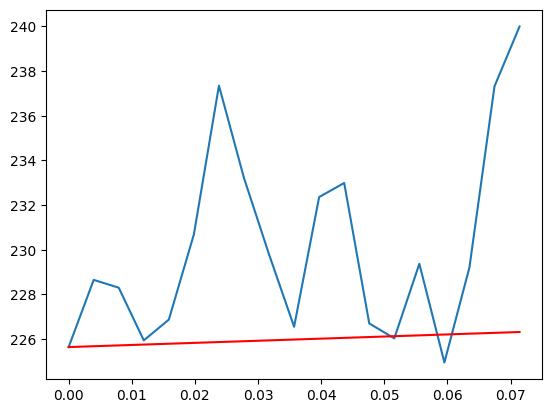

Stock = STE
S0 =  225.6399993896


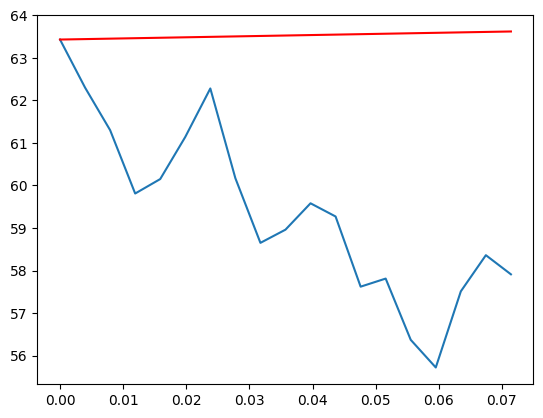

Stock = PNR
S0 =  63.4300003052


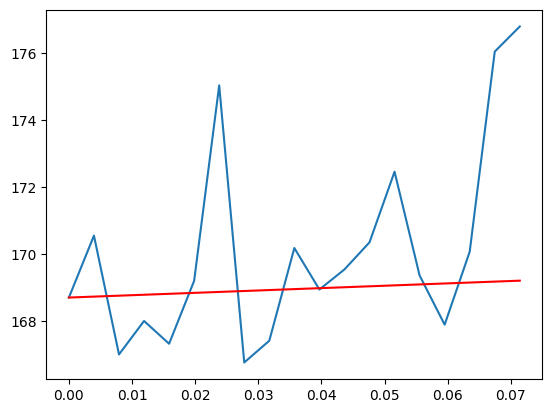

Stock = JKHY
S0 =  168.6999969482


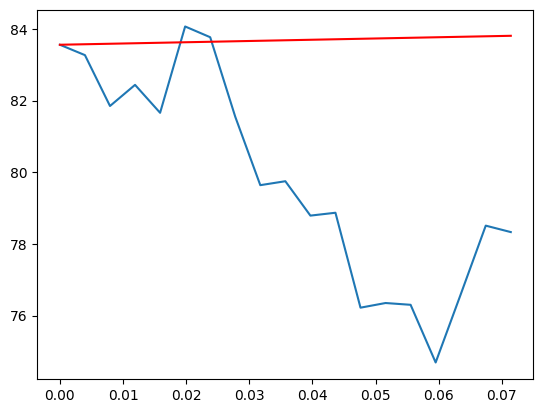

Stock = OTIS
S0 =  83.5599975586


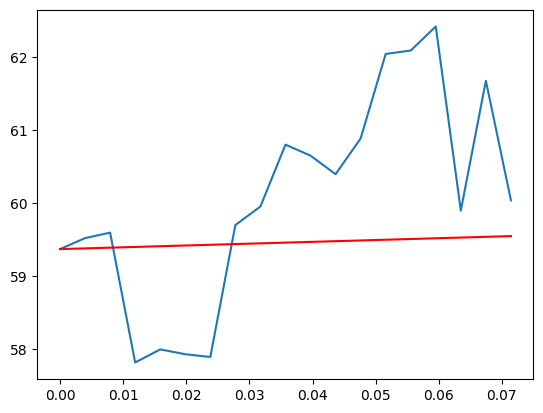

Stock = K
S0 =  59.370891571


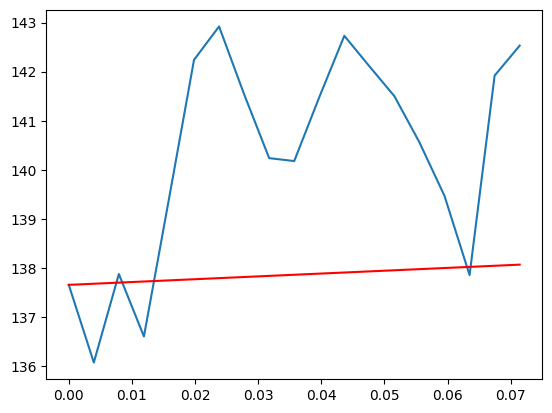

Stock = COR
S0 =  137.6600036621


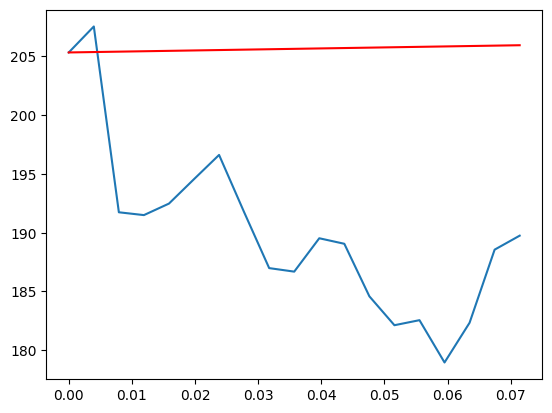

Stock = HON
S0 =  205.3399963379


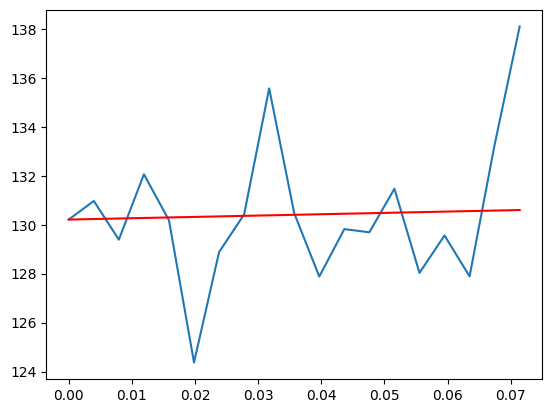

Stock = FANG
S0 =  130.2100067139


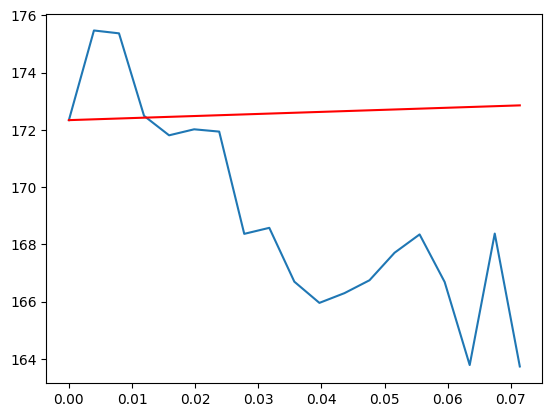

Stock = PEP
S0 =  172.3399963379


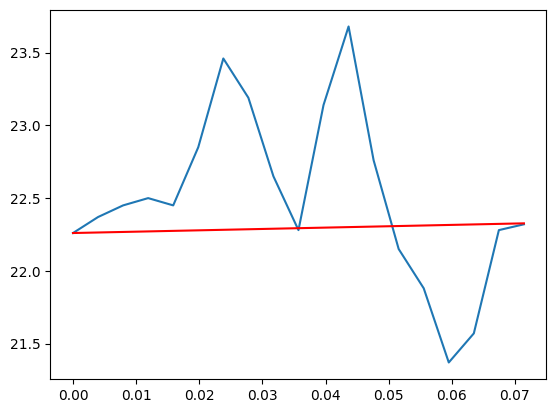

Stock = NWSA
S0 =  22.2600002289


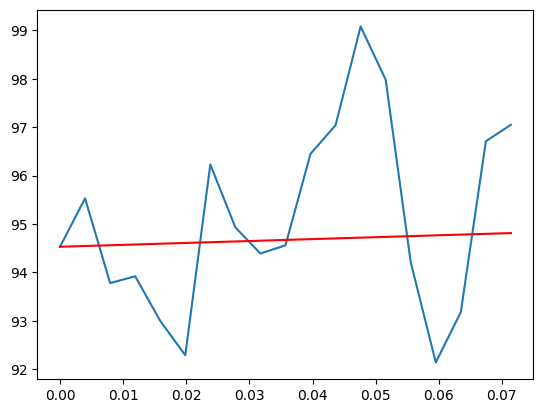

Stock = HAS
S0 =  94.5299987793


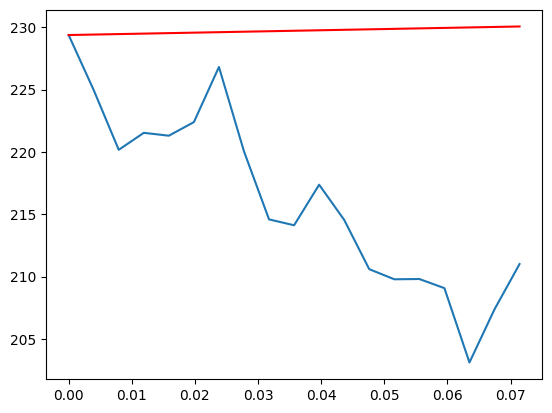

Stock = BIIB
S0 =  229.3699951172


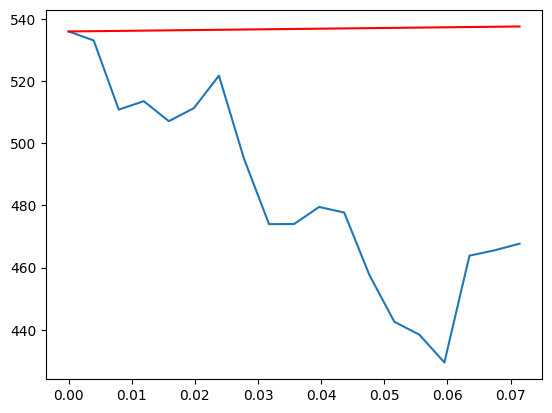

Stock = ADBE
S0 =  535.9799804688


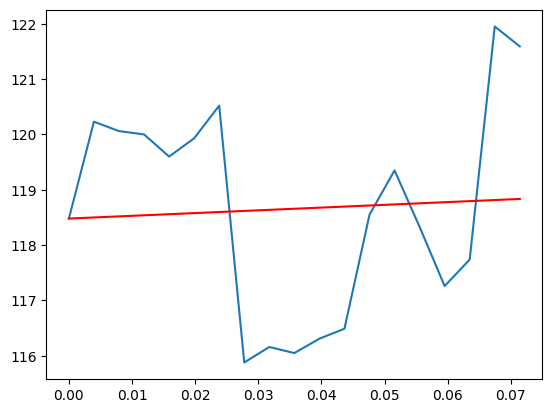

Stock = DTE
S0 =  118.4800033569


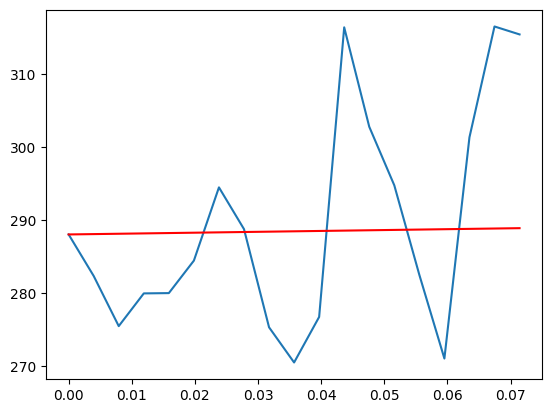

Stock = GNRC
S0 =  288.0199890137


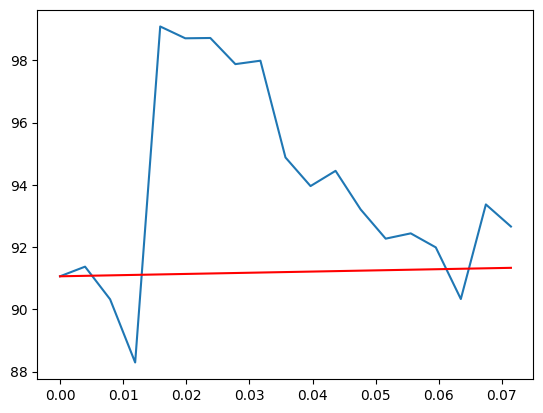

Stock = TSN
S0 =  91.0599975586


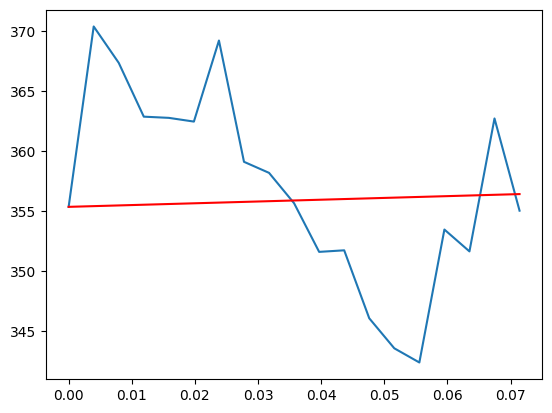

Stock = PSA
S0 =  355.3399963379


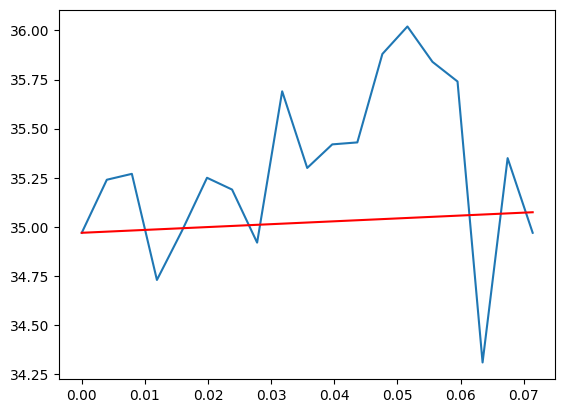

Stock = CAG
S0 =  34.9700012207


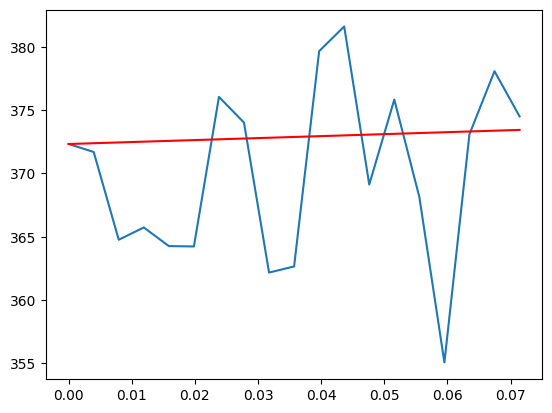

Stock = ULTA
S0 =  372.3200073242


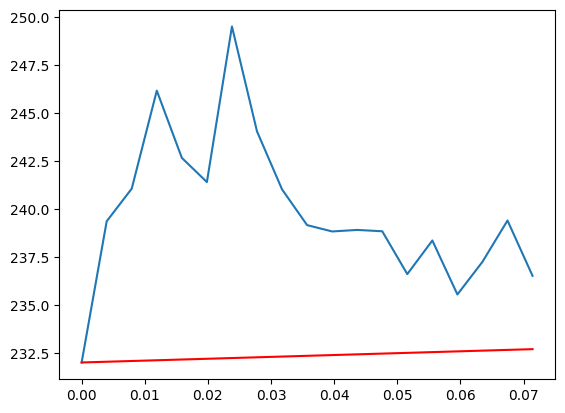

Stock = CME
S0 =  232.0200042725


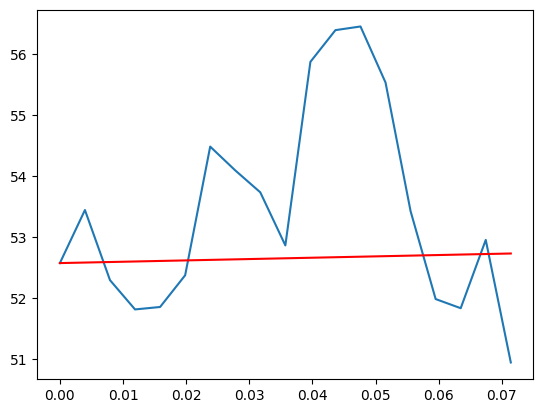

Stock = WDC
S0 =  52.5699996948


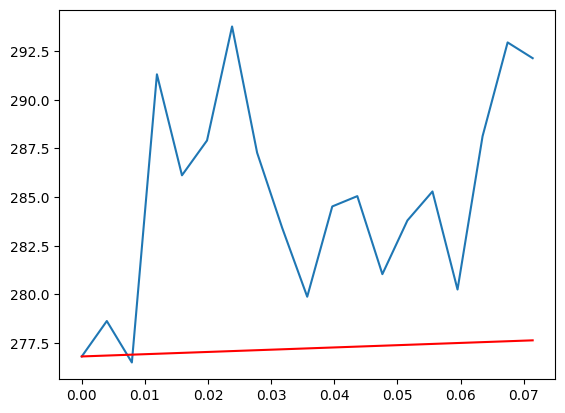

Stock = AON
S0 =  276.8099975586


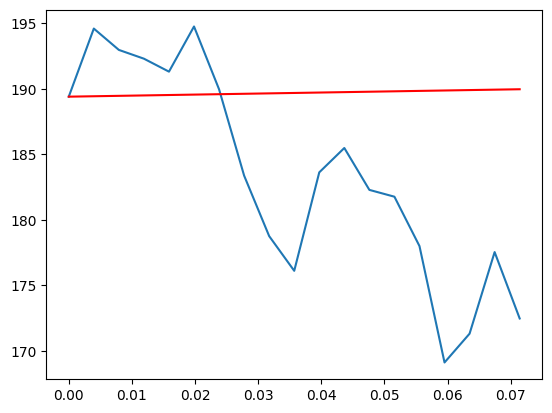

Stock = CDW
S0 =  189.3999938965


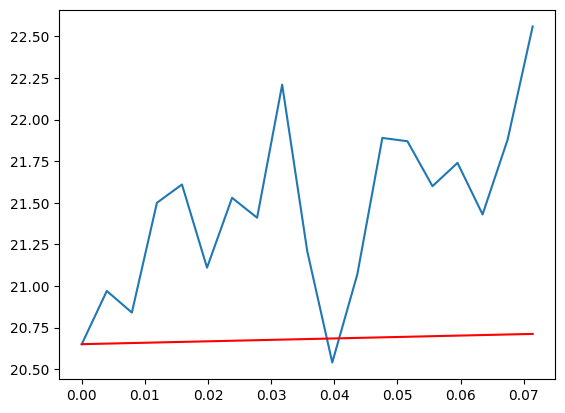

Stock = MRO
S0 =  20.6499996185


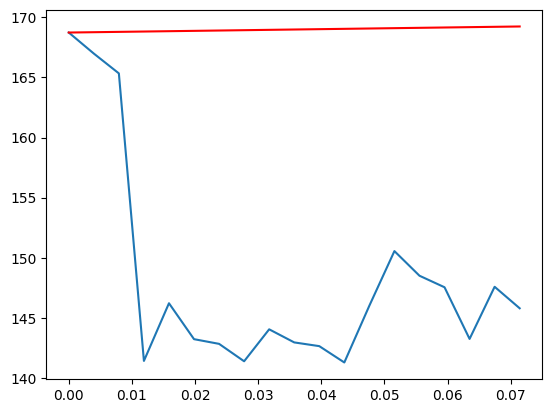

Stock = CLX
S0 =  168.7400054932


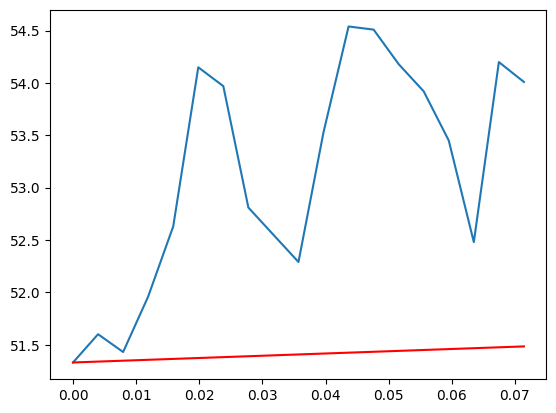

Stock = CAH
S0 =  51.3300018311


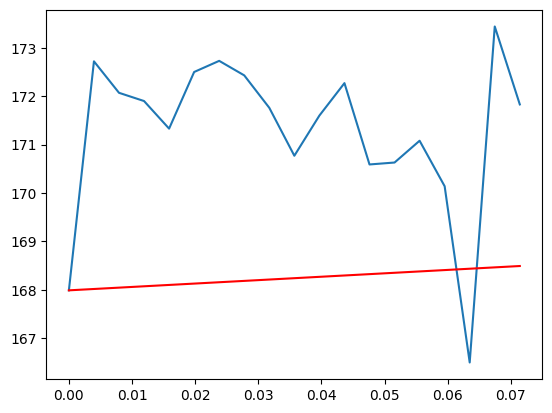

Stock = TRV
S0 =  167.9900054932


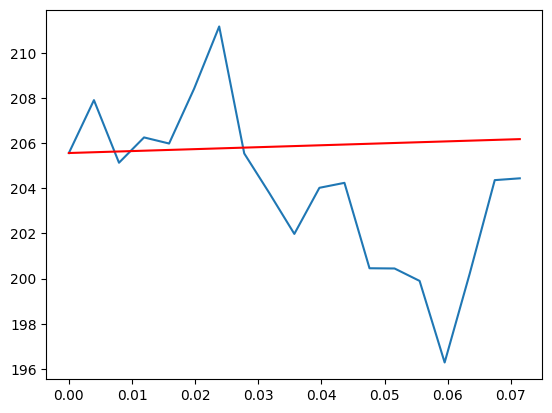

Stock = ADP
S0 =  205.5599975586


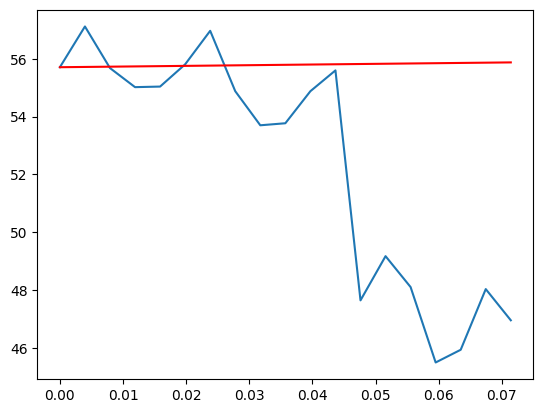

Stock = LKQ
S0 =  55.7099990845


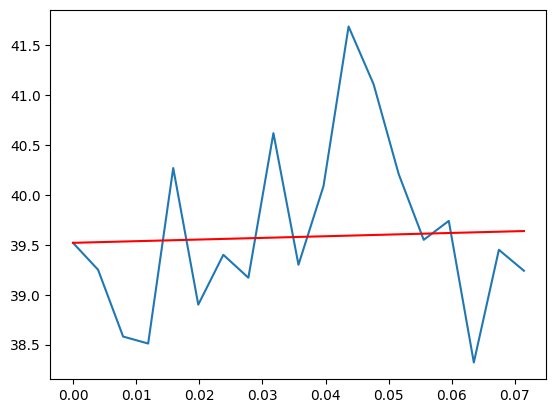

Stock = SLB
S0 =  39.5200004578


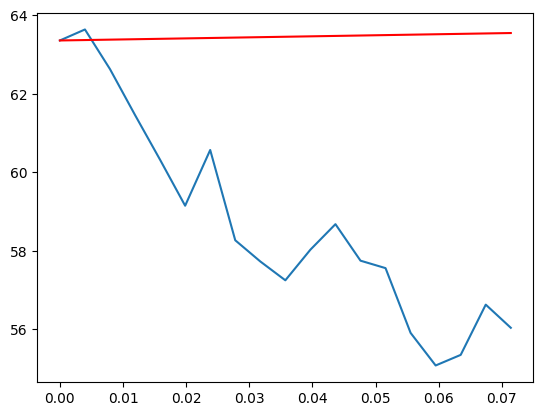

Stock = MAS
S0 =  63.3600006104


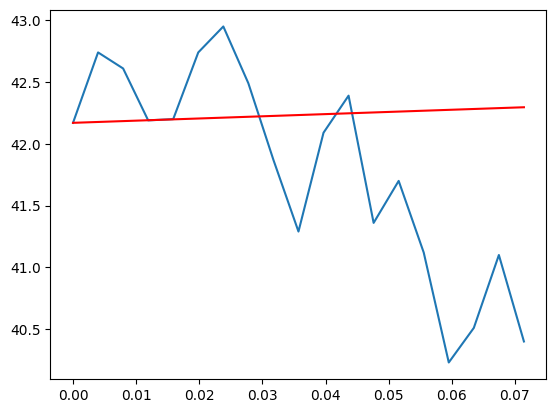

Stock = GLW
S0 =  42.1699981689


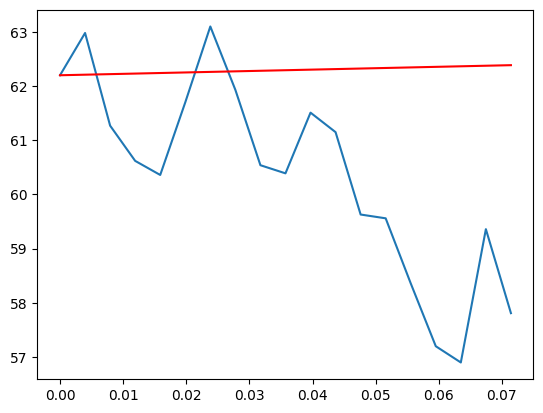

Stock = JBL
S0 =  62.2000007629


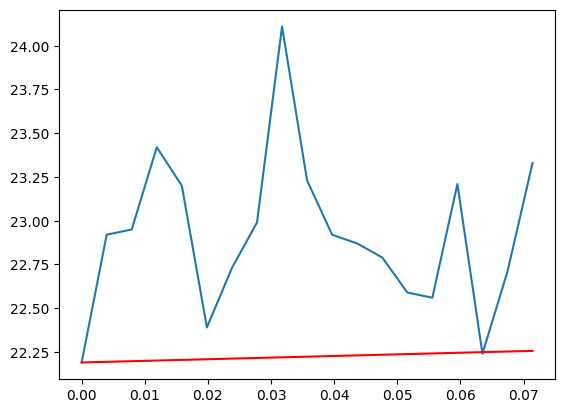

Stock = CTRA
S0 =  22.1900005341


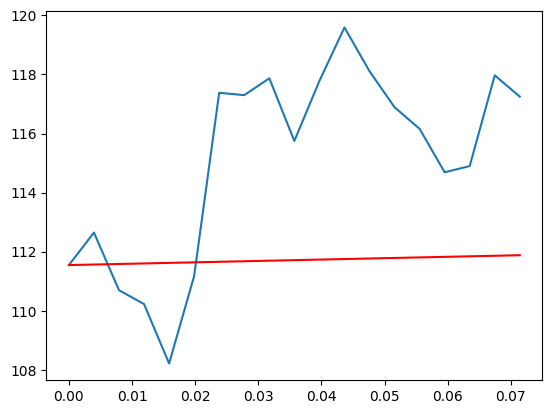

Stock = FMC
S0 =  111.5500030518


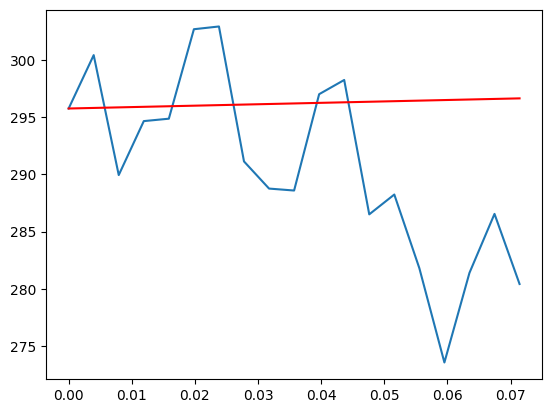

Stock = IT
S0 =  295.7399902344


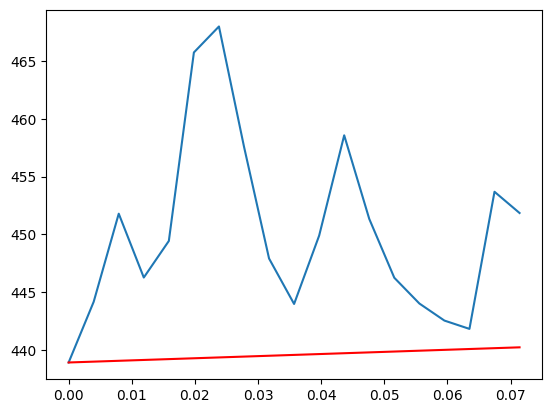

Stock = ELV
S0 =  438.8999938965


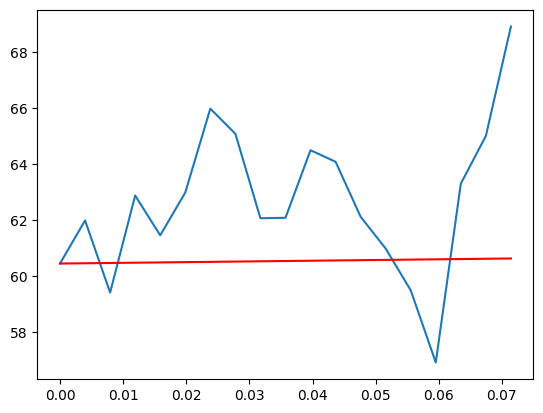

Stock = FTNT
S0 =  60.436000824


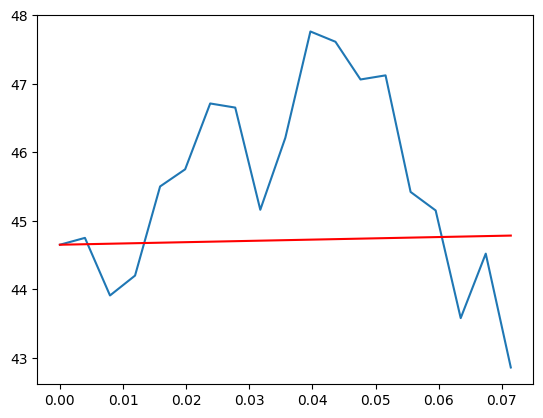

Stock = LVS
S0 =  44.6500015259


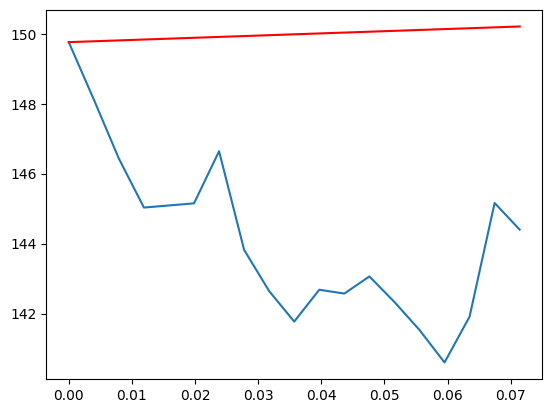

Stock = WM
S0 =  149.7599945068


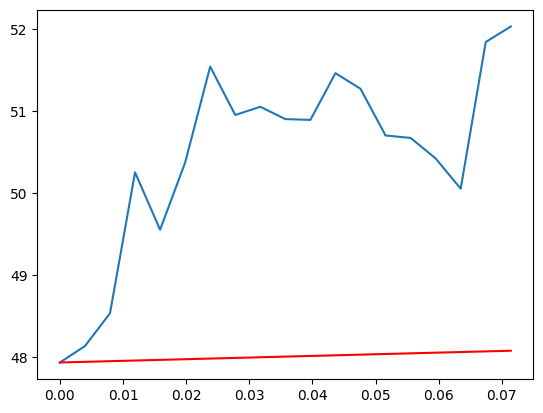

Stock = CTVA
S0 =  47.9300003052


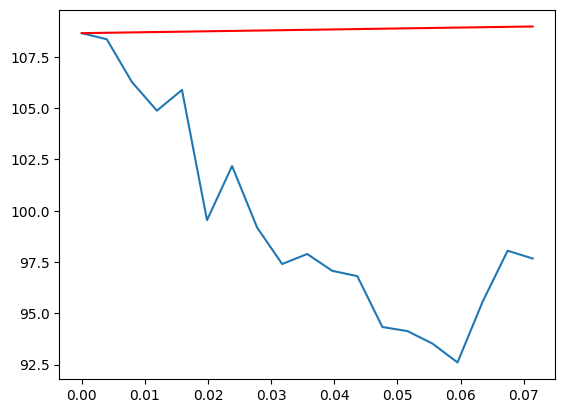

Stock = FI
S0 =  108.6600036621


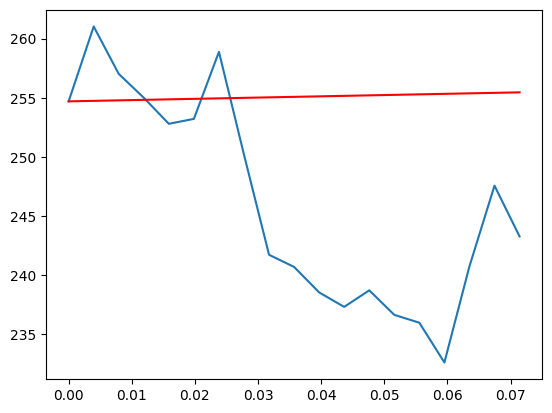

Stock = DHR
S0 =  254.6897125244


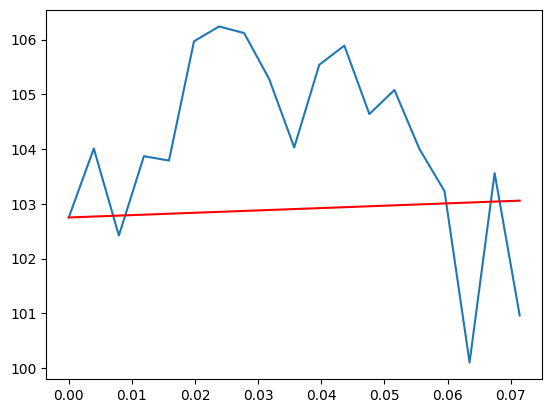

Stock = GL
S0 =  102.75


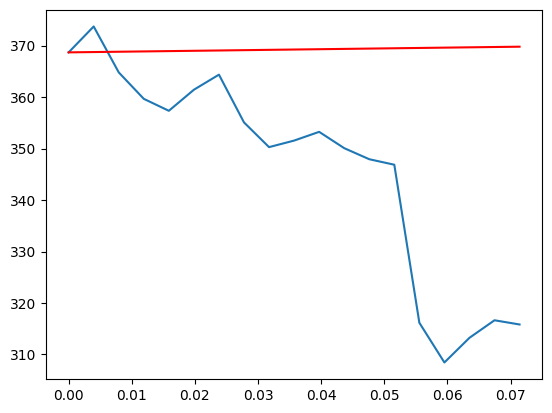

Stock = HD
S0 =  368.700012207


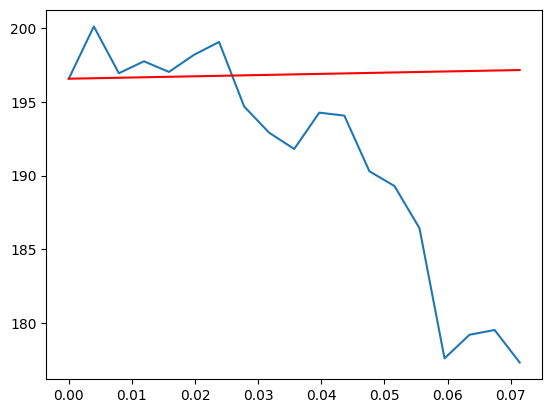

Stock = VRSK
S0 =  196.5700073242


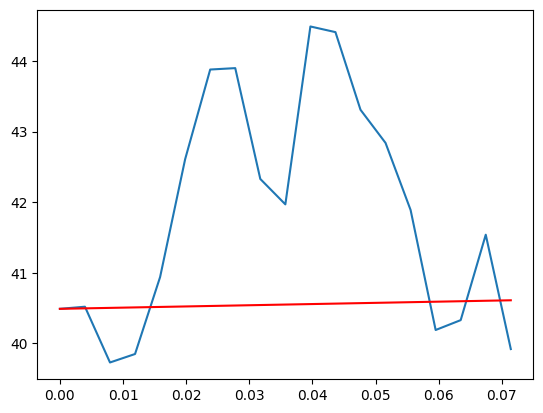

Stock = DAL
S0 =  40.4900016785


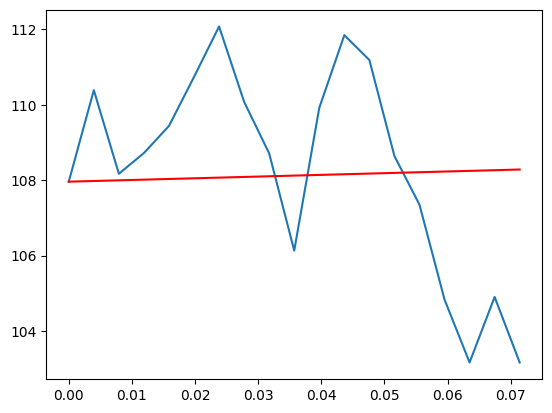

Stock = STX
S0 =  107.9599990845


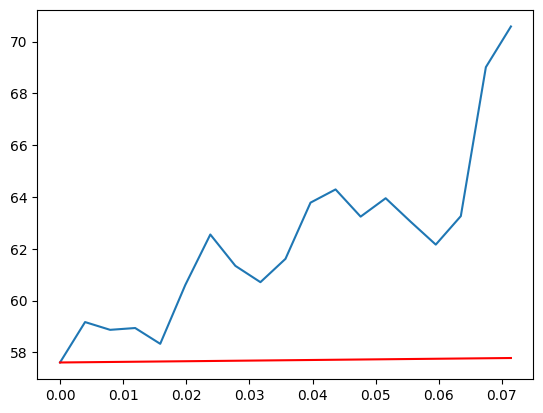

Stock = STLD
S0 =  57.6100006104


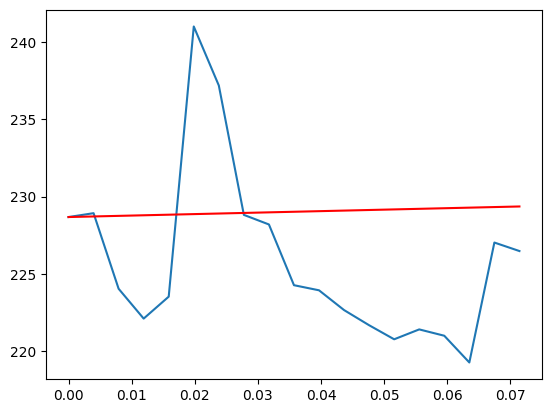

Stock = AMGN
S0 =  228.6799926758


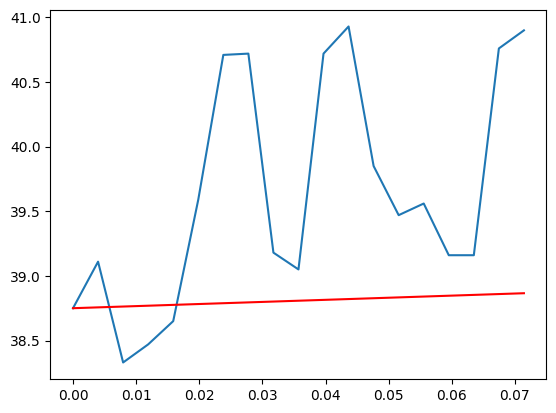

Stock = TPR
S0 =  38.75


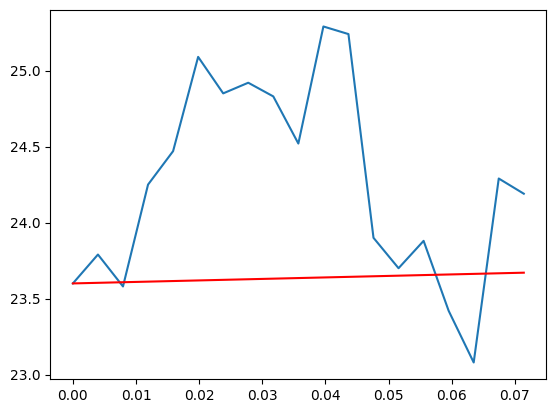

Stock = RF
S0 =  23.6000003815


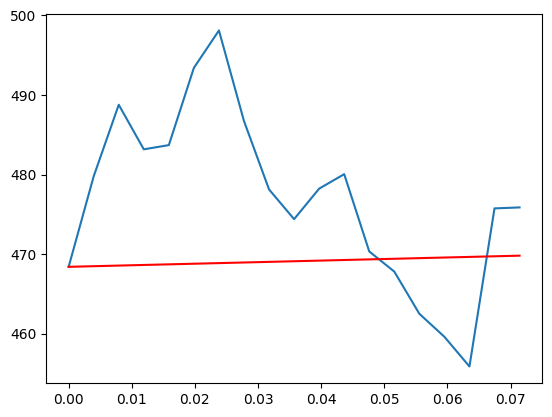

Stock = UNH
S0 =  468.4100036621


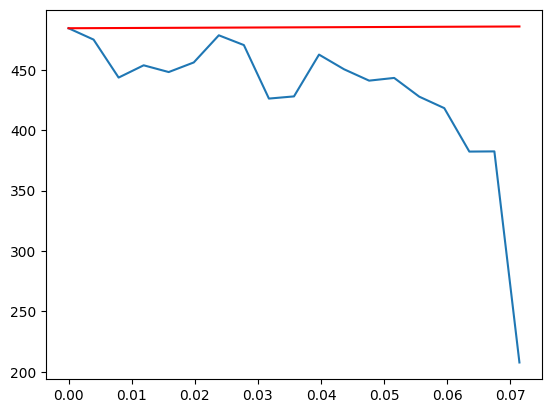

Stock = EPAM
S0 =  484.3599853516


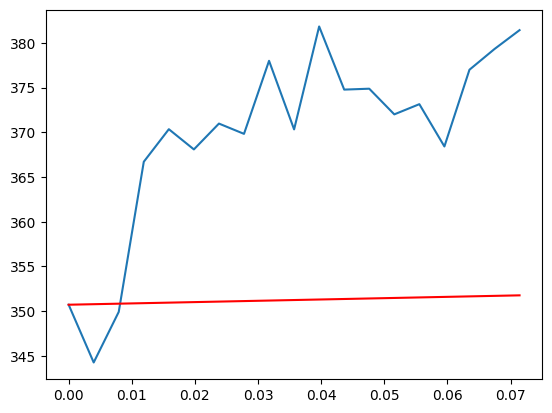

Stock = MKTX
S0 =  350.7200012207


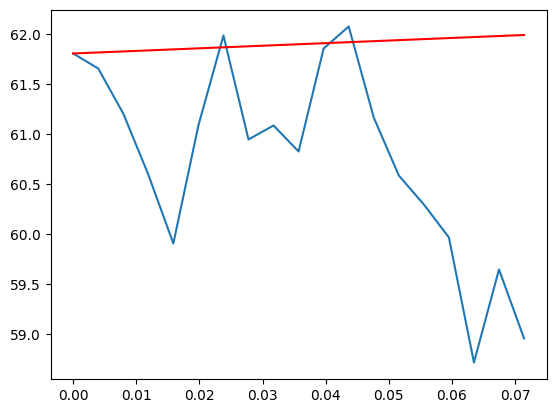

Stock = DOW
S0 =  61.8100013733


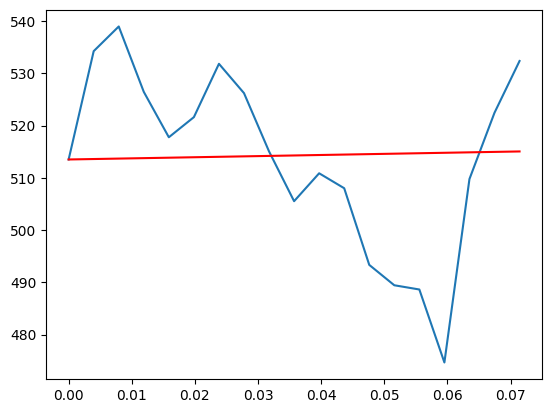

Stock = IDXX
S0 =  513.5100097656


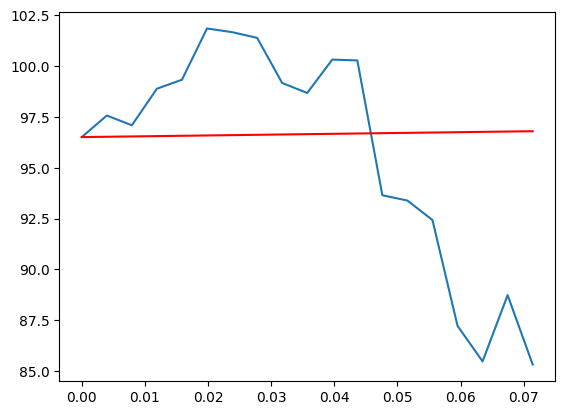

Stock = STT
S0 =  96.5100021362


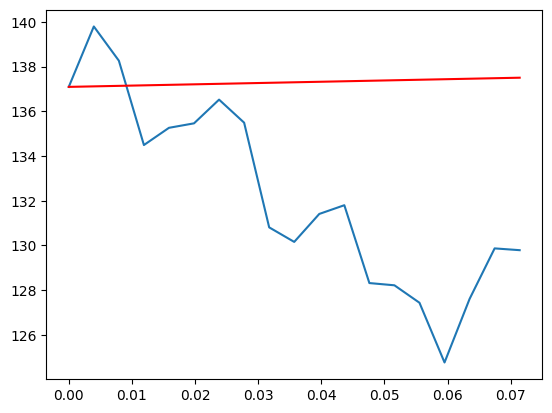

Stock = AME
S0 =  137.0899963379


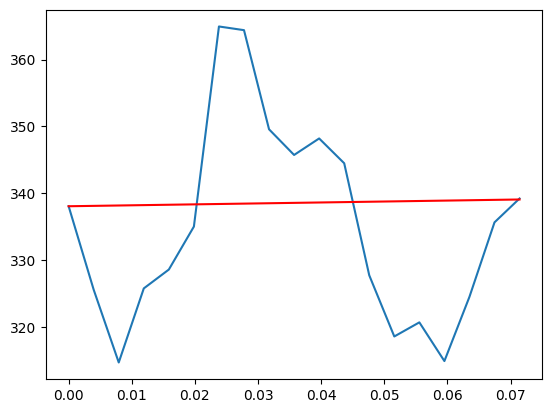

Stock = PAYC
S0 =  338.049987793


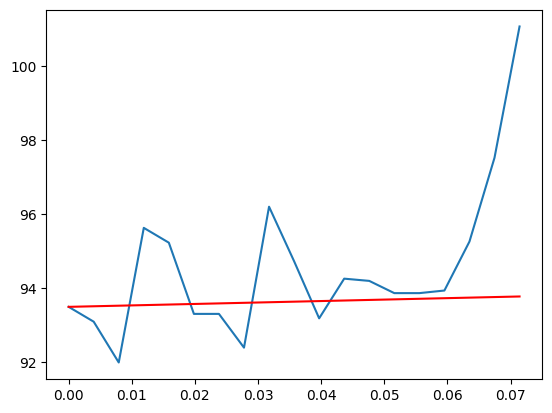

Stock = HES
S0 =  93.5


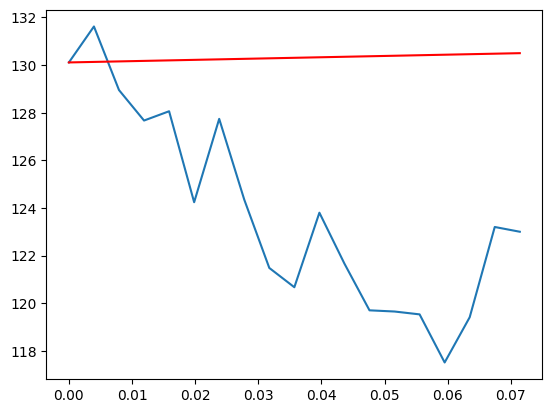

Stock = J
S0 =  130.1100006104


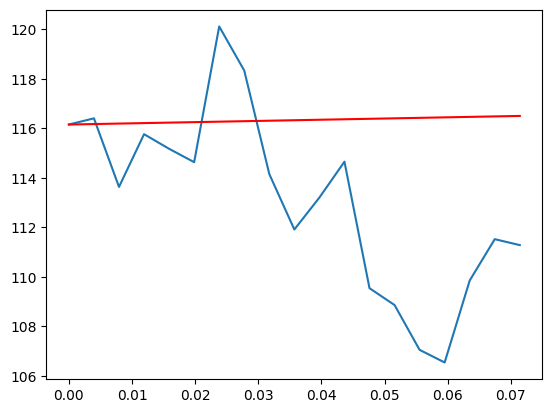

Stock = PTC
S0 =  116.1500015259


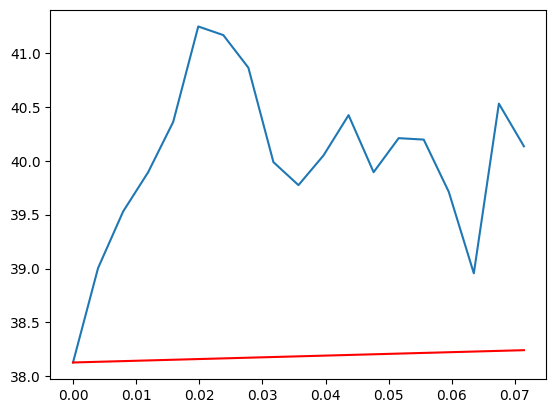

Stock = WRB
S0 =  38.1288871765


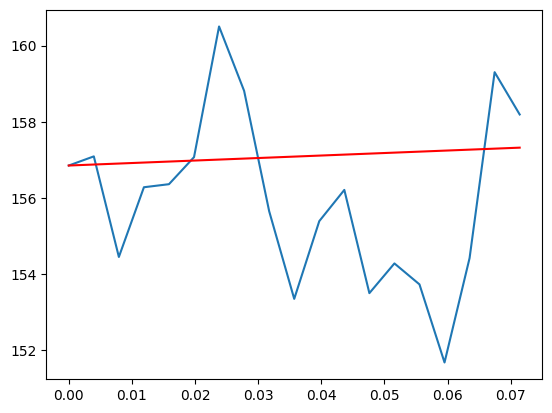

Stock = AJG
S0 =  156.8500061035


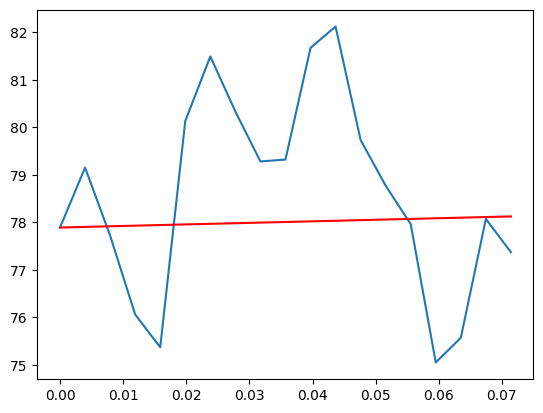

Stock = DD
S0 =  77.8899993896


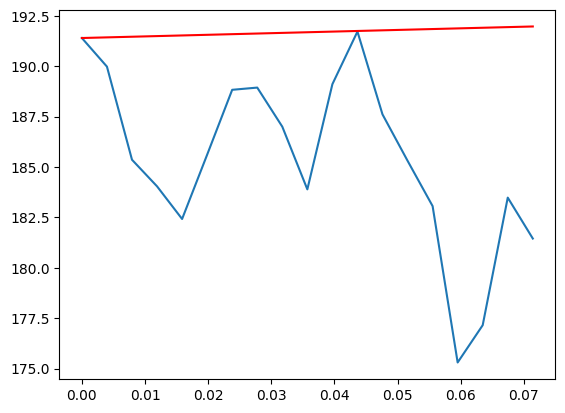

Stock = VMC
S0 =  191.3999938965


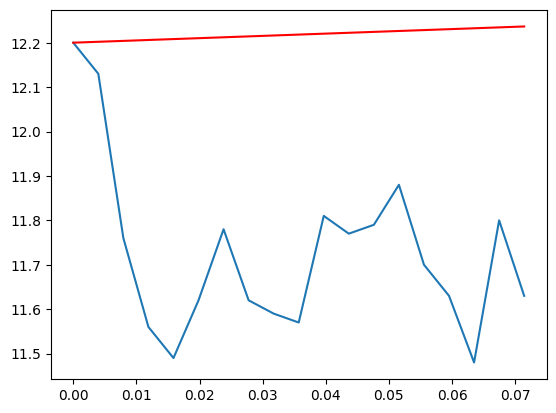

Stock = AMCR
S0 =  12.1999998093


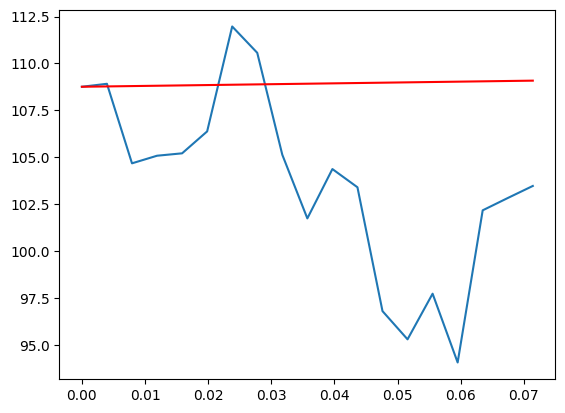

Stock = DXCM
S0 =  108.7600021362


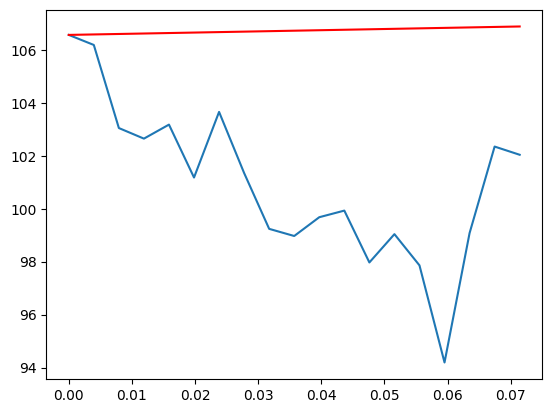

Stock = CTLT
S0 =  106.5699996948


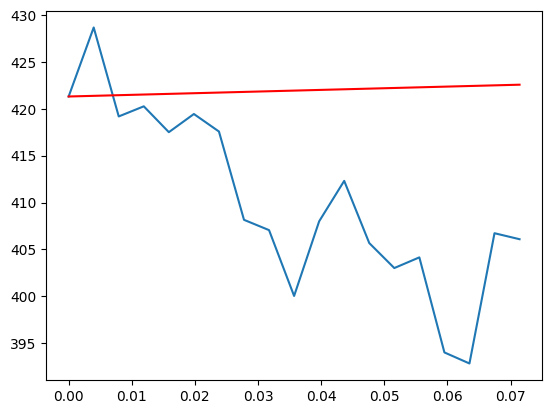

Stock = FDS
S0 =  421.3299865723


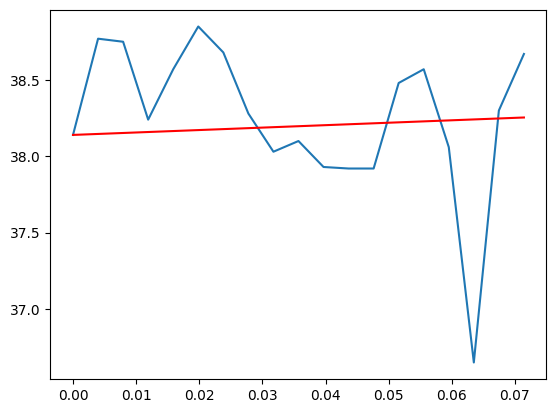

Stock = KDP
S0 =  38.1399993896


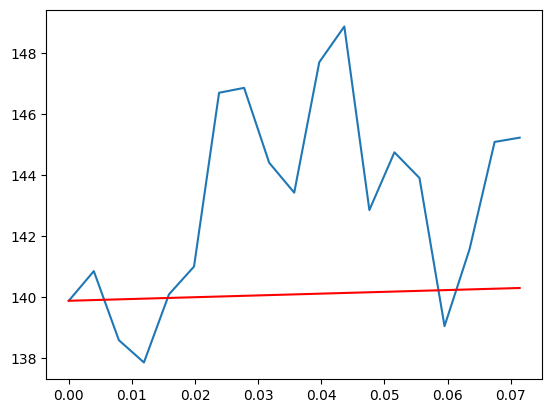

Stock = DRI
S0 =  139.8800048828


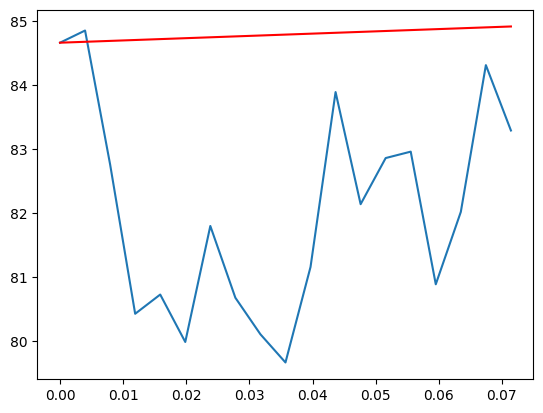

Stock = WELL
S0 =  84.6600036621


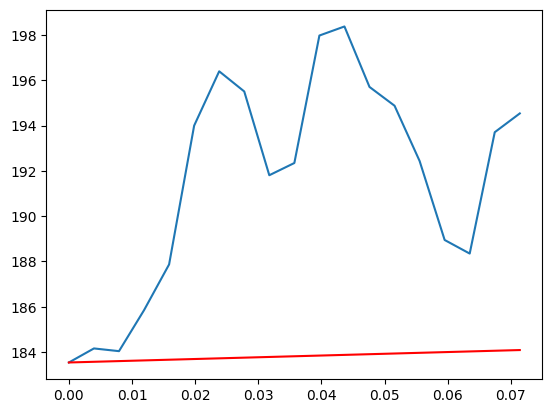

Stock = AXP
S0 =  183.5399932861


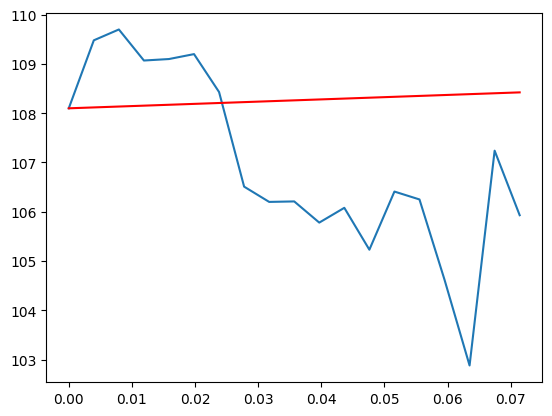

Stock = PGR
S0 =  108.0999984741


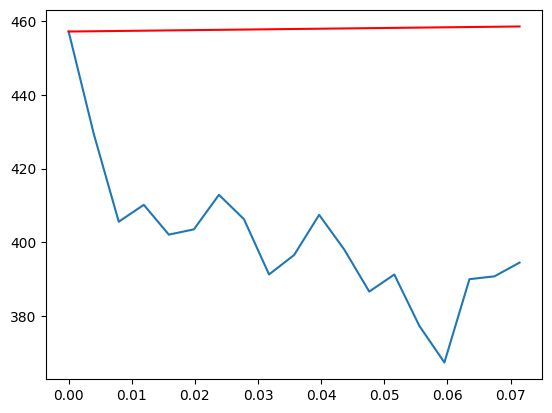

Stock = NFLX
S0 =  457.1300048828


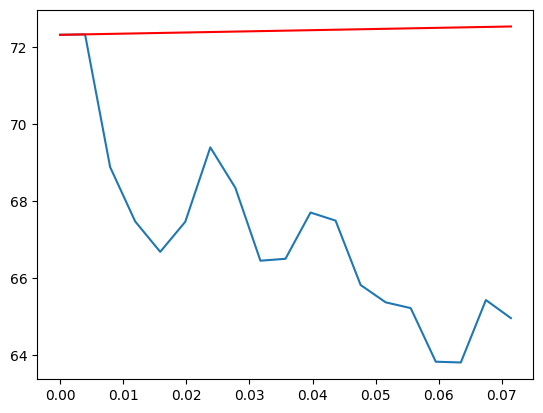

Stock = JCI
S0 =  72.3099975586


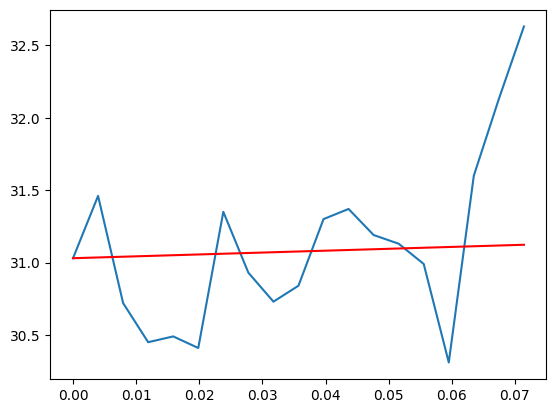

Stock = ROL
S0 =  31.0300006866


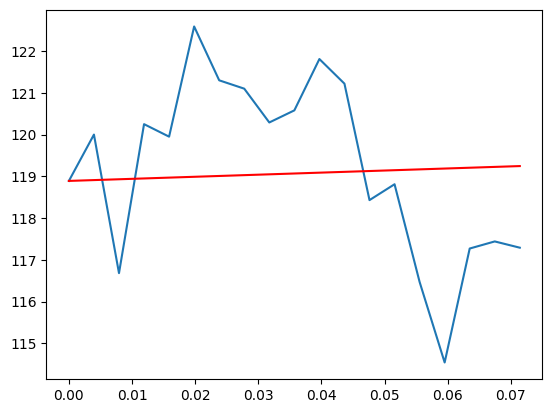

Stock = CBOE
S0 =  118.8899993896


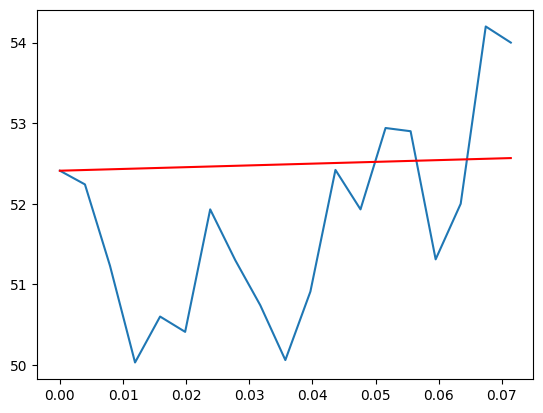

Stock = VTR
S0 =  52.4099998474


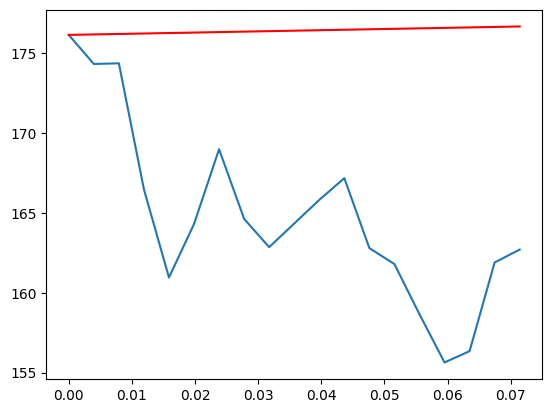

Stock = SWK
S0 =  176.1399993896


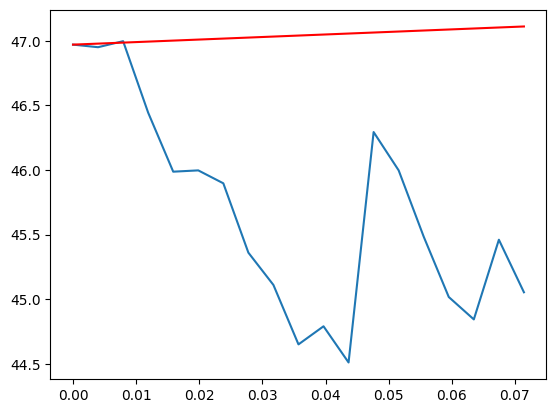

Stock = WMT
S0 =  46.9700012207


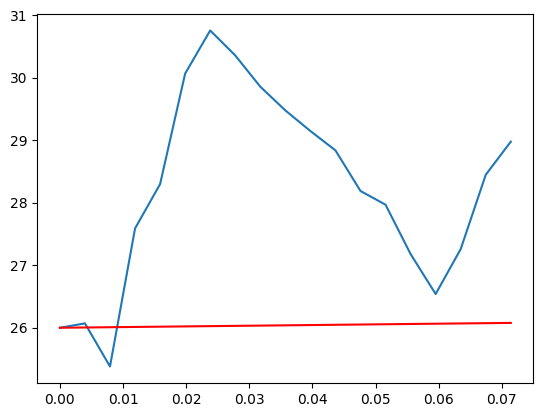

Stock = GEN
S0 =  26.0


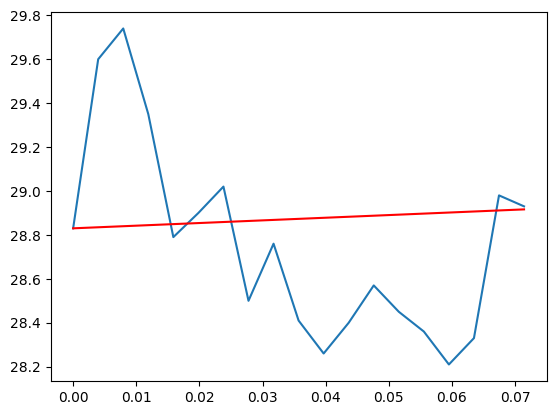

Stock = NI
S0 =  28.8299999237


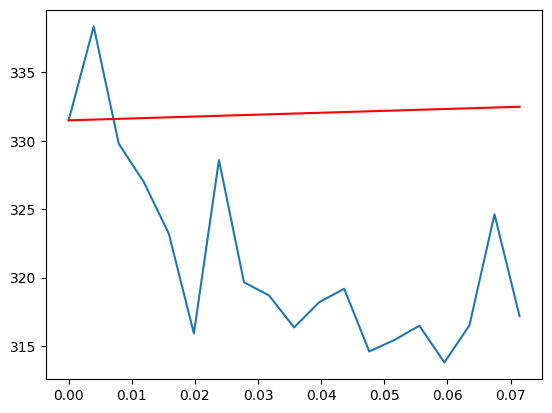

Stock = ESS
S0 =  331.4899902344


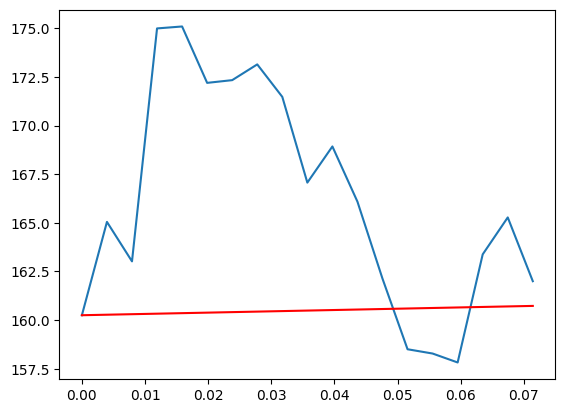

Stock = TTWO
S0 =  160.25


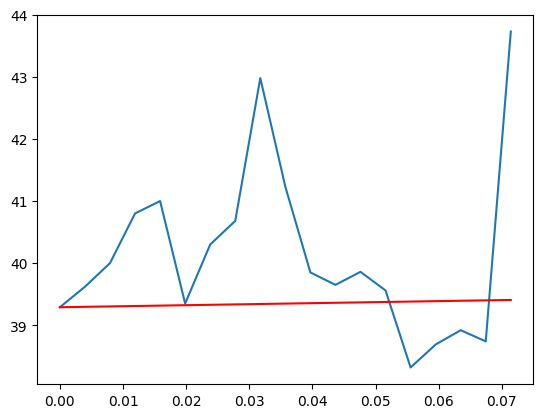

Stock = OXY
S0 =  39.2900009155


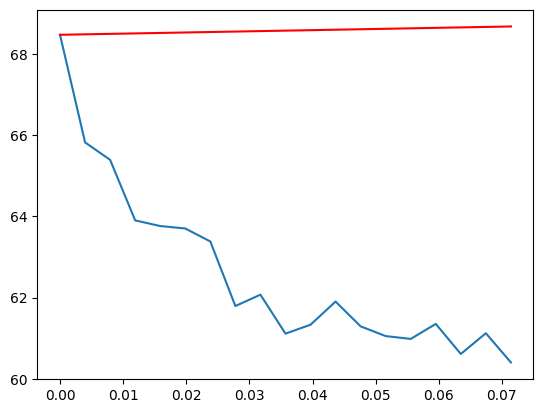

Stock = GILD
S0 =  68.4700012207


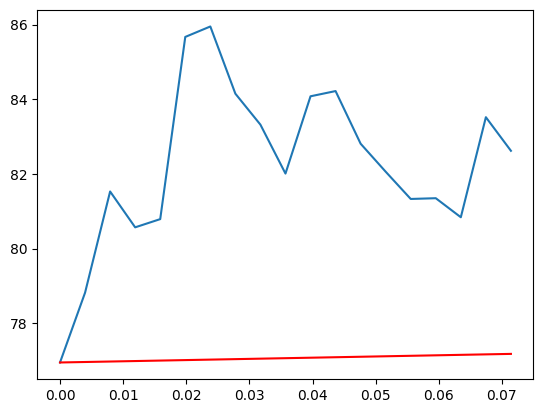

Stock = CNC
S0 =  76.9499969482


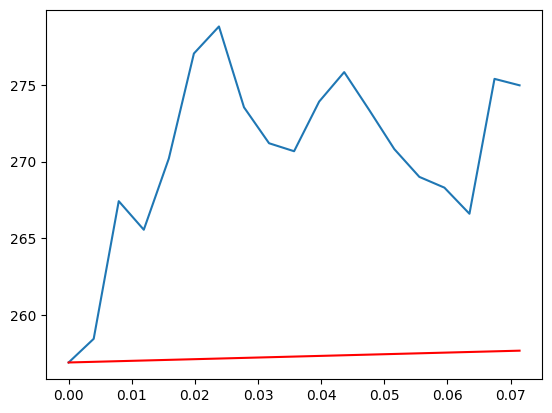

Stock = MCK
S0 =  256.9200134277


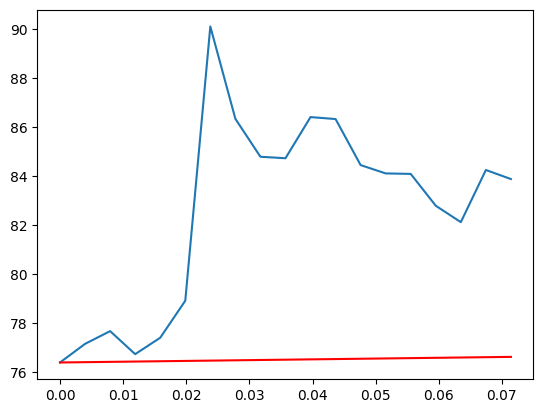

Stock = OMC
S0 =  76.4000015259


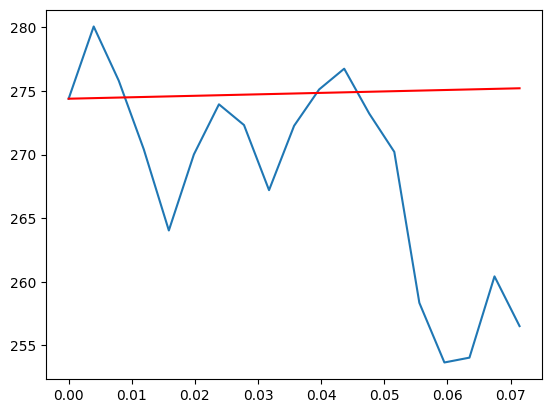

Stock = NSC
S0 =  274.3999938965


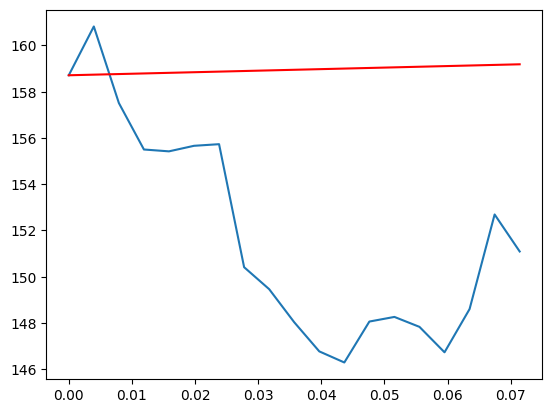

Stock = AWK
S0 =  158.7100067139


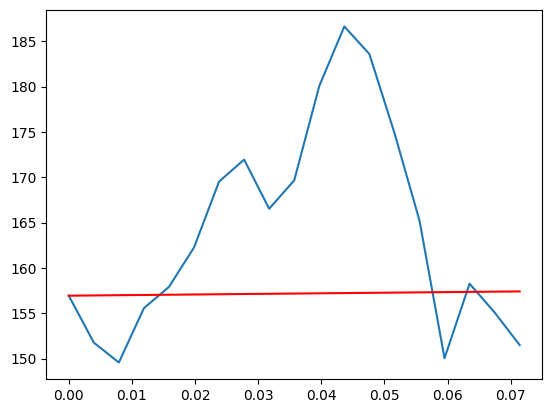

Stock = ABNB
S0 =  156.9400024414


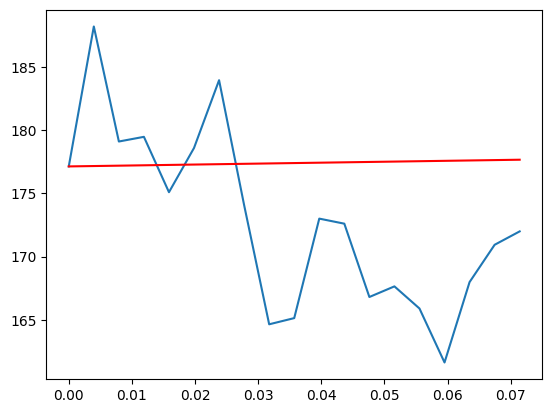

Stock = QCOM
S0 =  177.1300048828


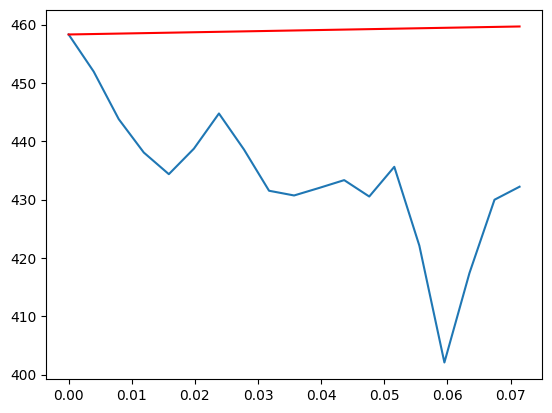

Stock = DPZ
S0 =  458.299987793


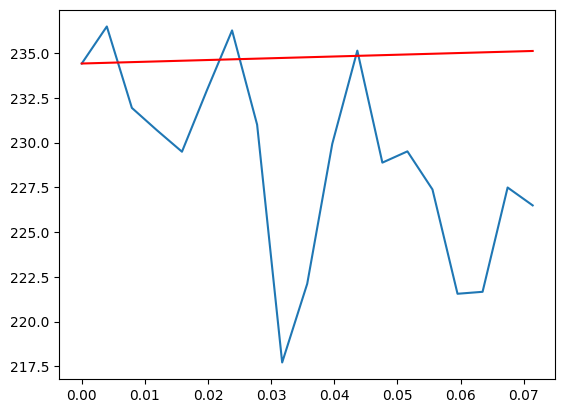

Stock = NDSN
S0 =  234.4199981689


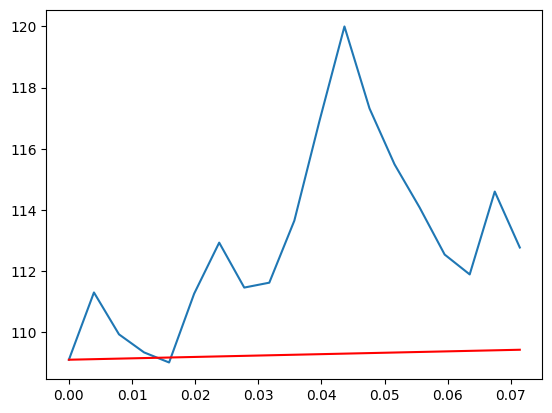

Stock = DVA
S0 =  109.0999984741


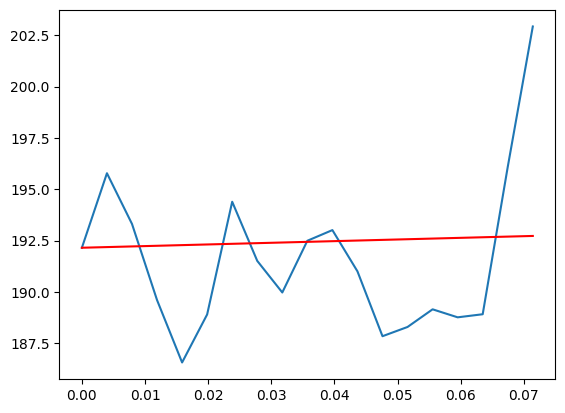

Stock = JBHT
S0 =  192.1499938965


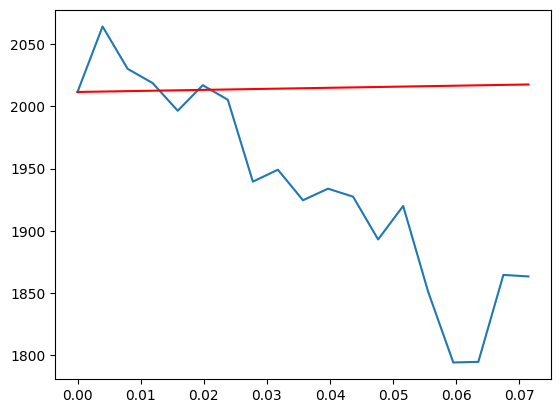

Stock = AZO
S0 =  2011.5699462891


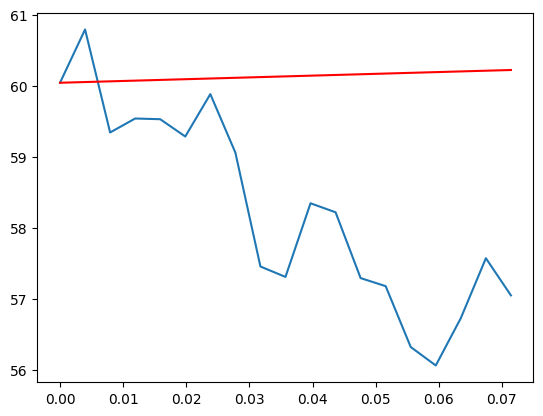

Stock = NDAQ
S0 =  60.0433311462


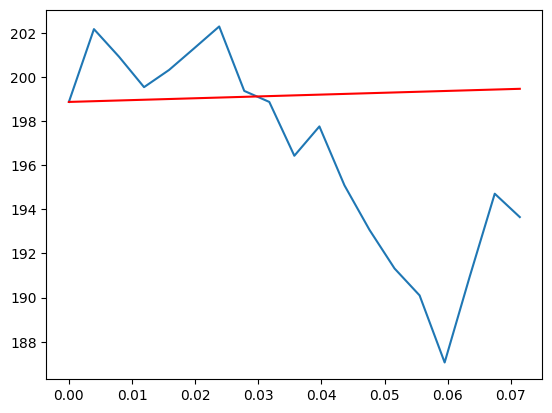

Stock = ZTS
S0 =  198.8699951172


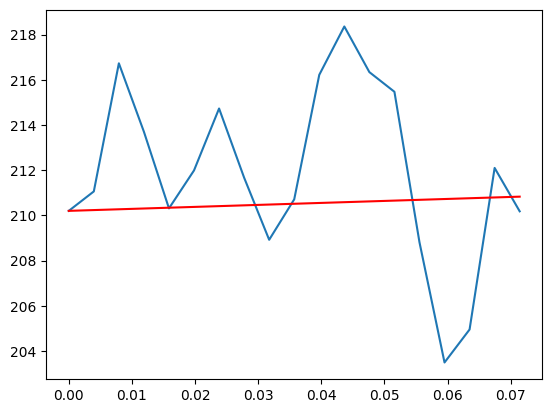

Stock = SNA
S0 =  210.1999969482


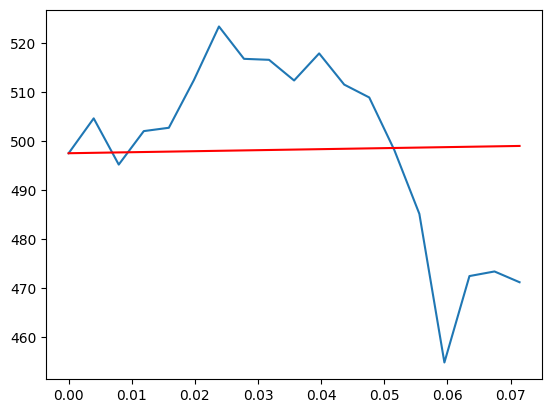

Stock = FICO
S0 =  497.5400085449


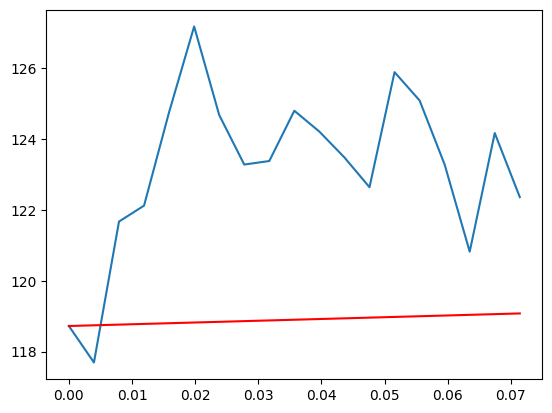

Stock = ALL
S0 =  118.7200012207


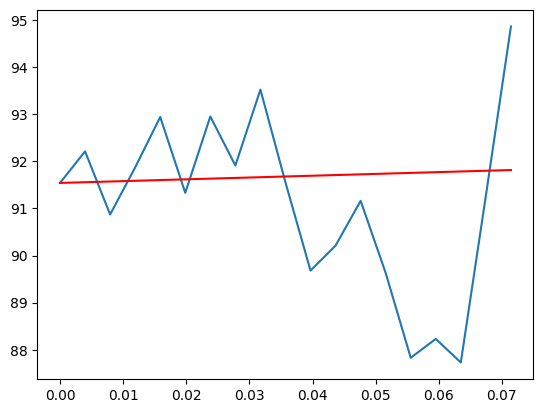

Stock = COP
S0 =  91.5400009155


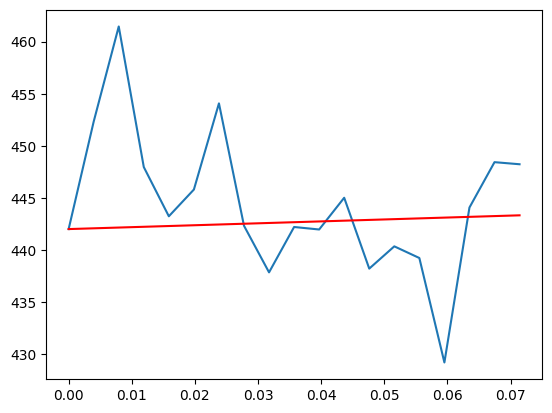

Stock = ROP
S0 =  441.9899902344


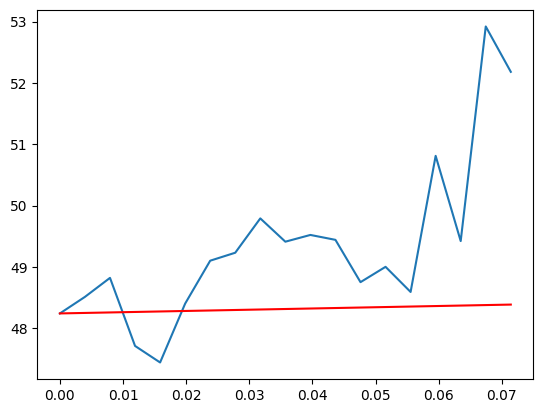

Stock = TAP
S0 =  48.2400016785


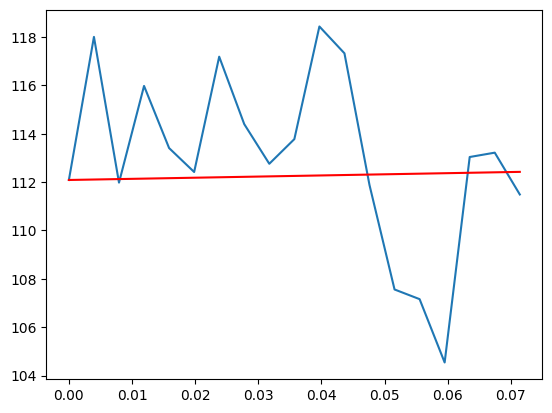

Stock = MTCH
S0 =  112.0899963379


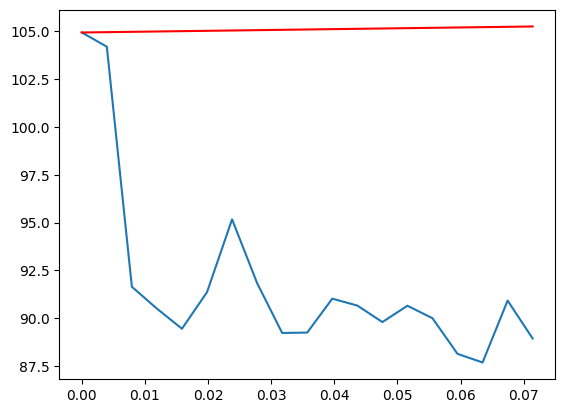

Stock = XYL
S0 =  104.9199981689


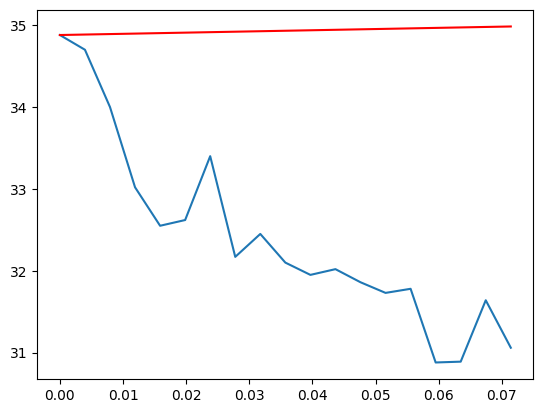

Stock = DOC
S0 =  34.8800010681


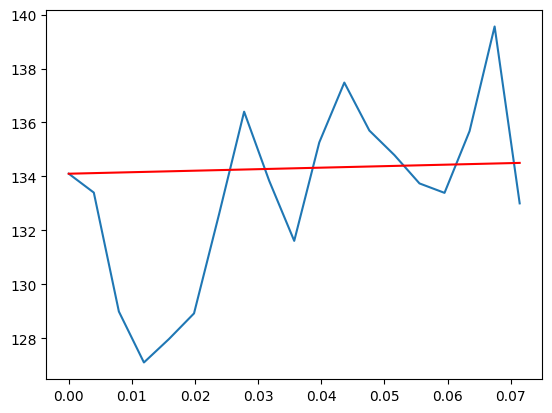

Stock = IFF
S0 =  134.1000061035


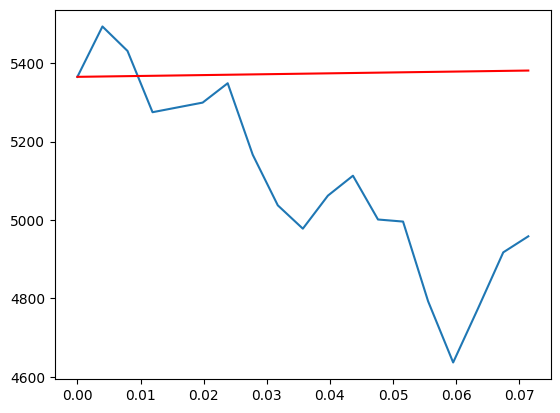

Stock = NVR
S0 =  5365.2700195312


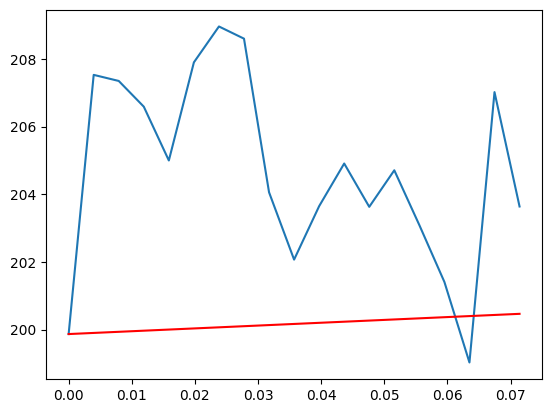

Stock = CB
S0 =  199.8699951172


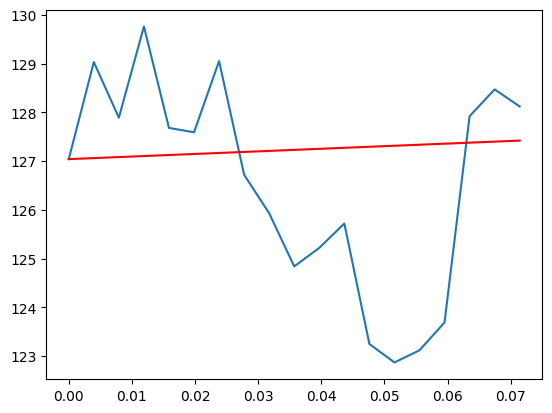

Stock = ICE
S0 =  127.0400009155


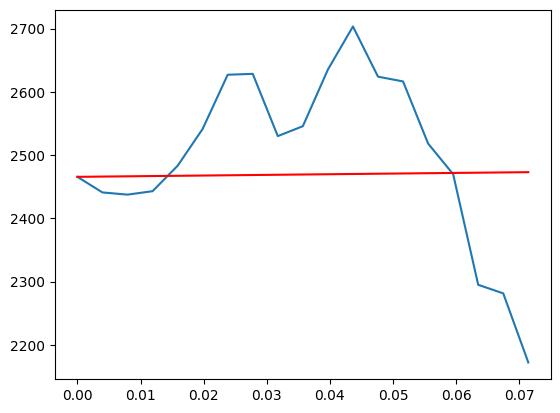

Stock = BKNG
S0 =  2465.6398925781


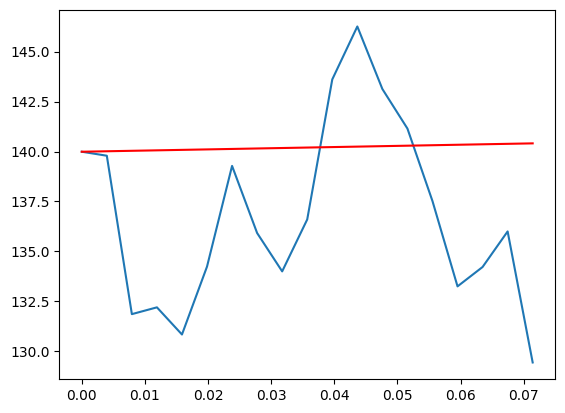

Stock = APTV
S0 =  139.9900054932


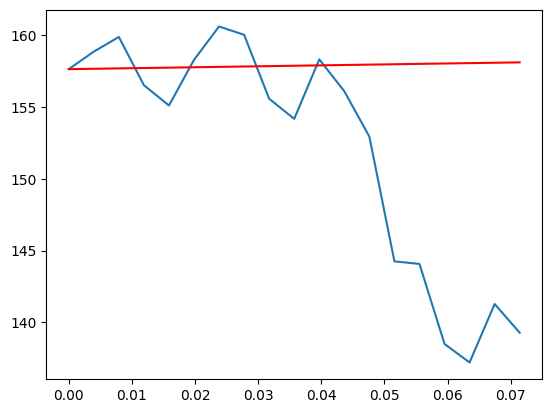

Stock = CE
S0 =  157.6300048828


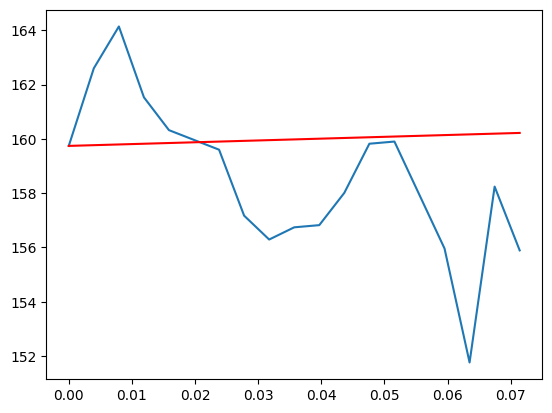

Stock = PG
S0 =  159.7400054932


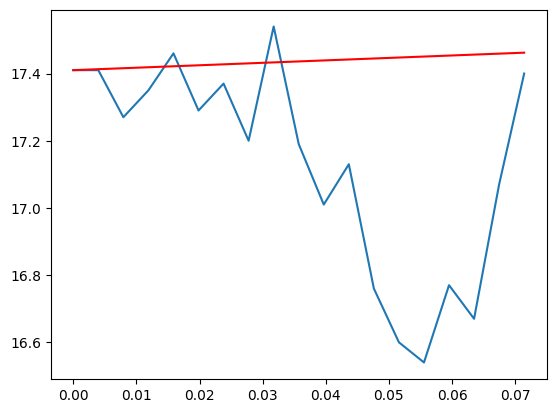

Stock = KMI
S0 =  17.4099998474


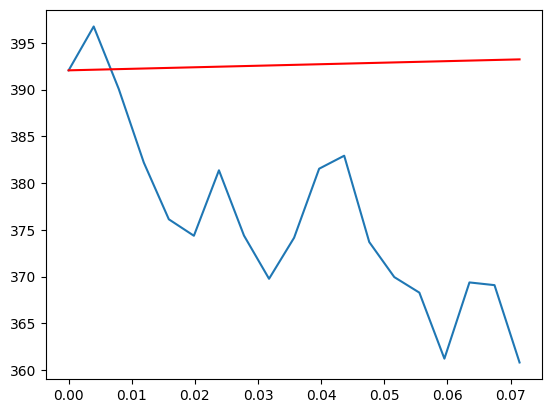

Stock = MA
S0 =  392.0599975586


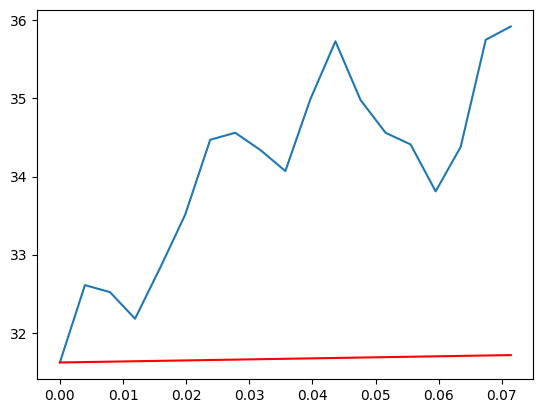

Stock = HWM
S0 =  31.6200008392


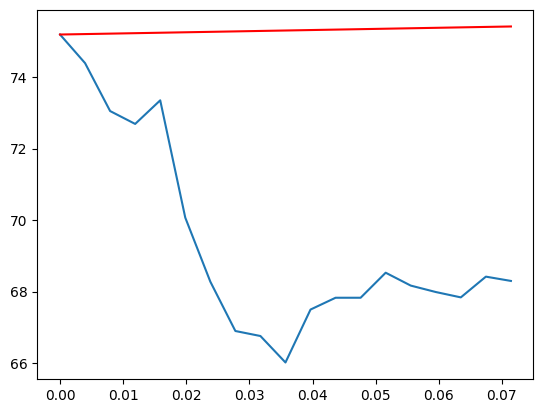

Stock = INCY
S0 =  75.1900024414


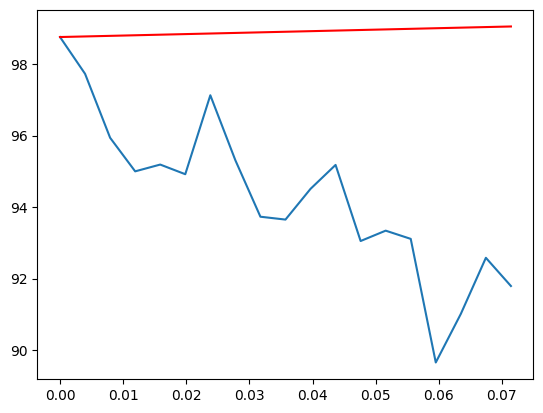

Stock = SBUX
S0 =  98.7600021362


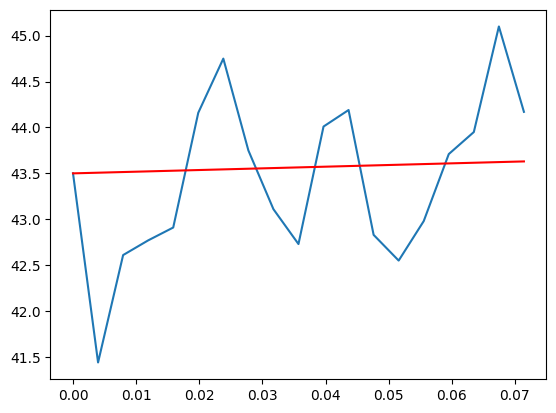

Stock = BSX
S0 =  43.5


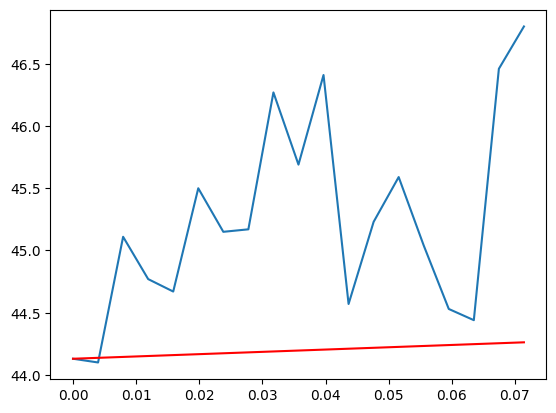

Stock = KR
S0 =  44.1300010681


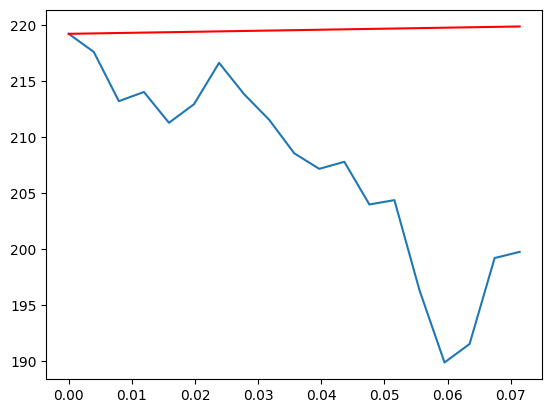

Stock = TGT
S0 =  219.2299957275


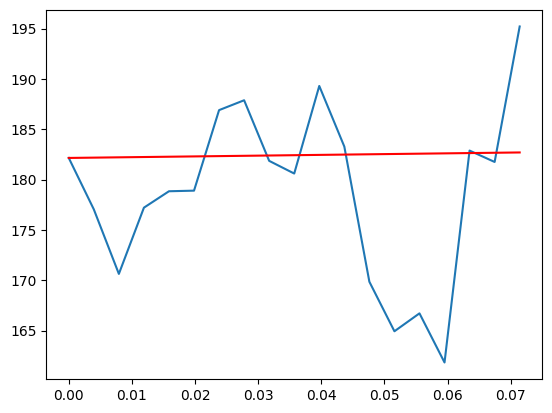

Stock = CRWD
S0 =  182.1499938965


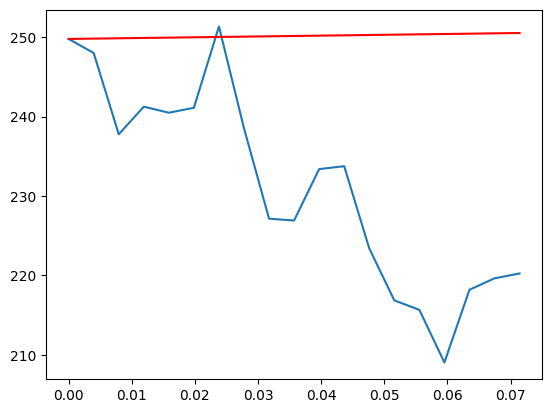

Stock = ADSK
S0 =  249.7700042725


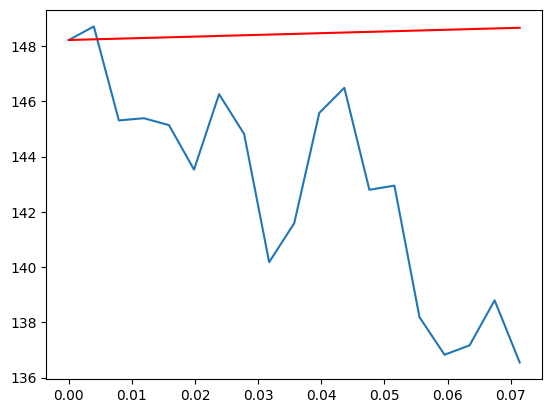

Stock = NKE
S0 =  148.2200012207


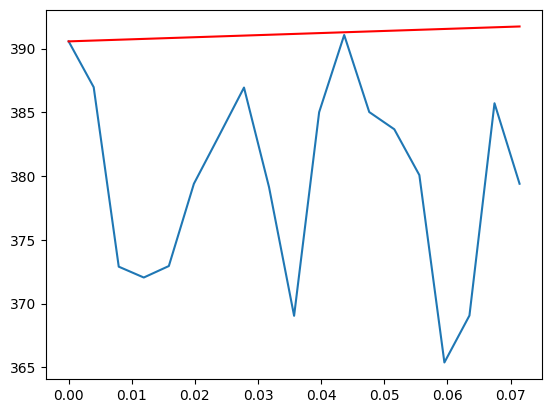

Stock = MLM
S0 =  390.5599975586


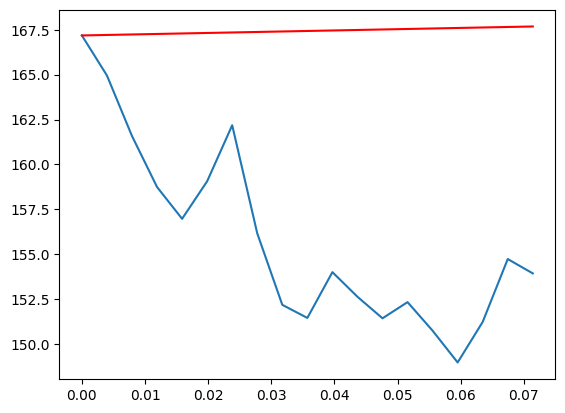

Stock = TT
S0 =  167.1799926758


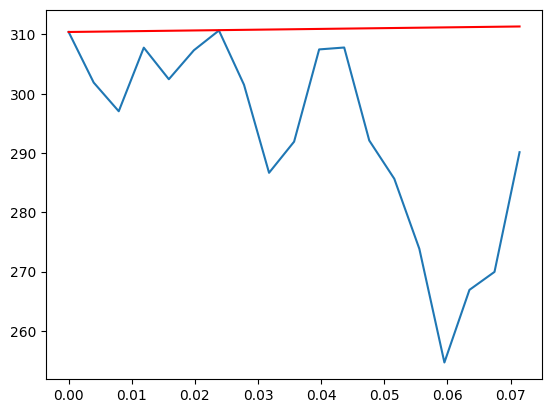

Stock = TSLA
S0 =  310.4166564941


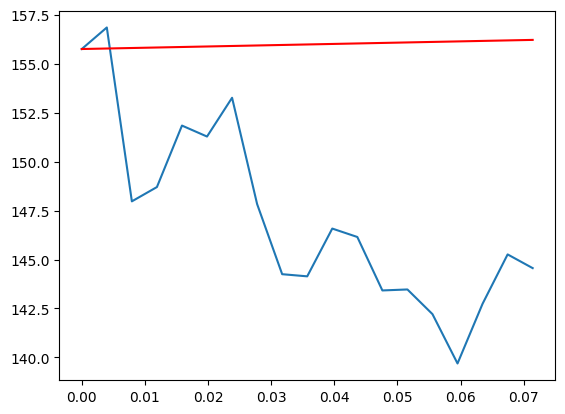

Stock = TROW
S0 =  155.75


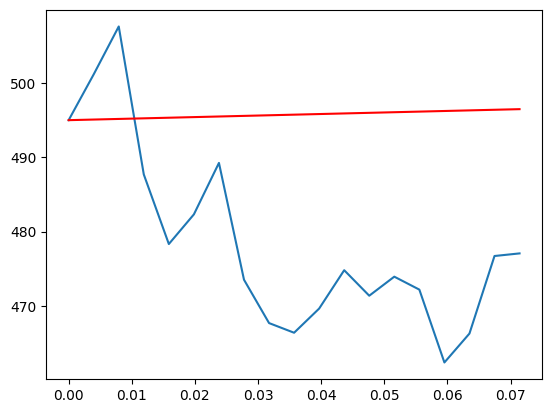

Stock = GWW
S0 =  494.9800109863


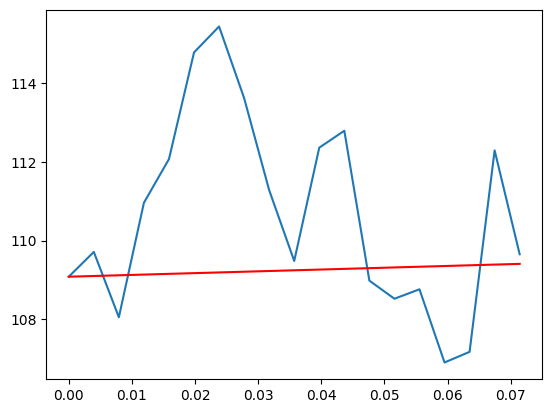

Stock = RJF
S0 =  109.0800018311


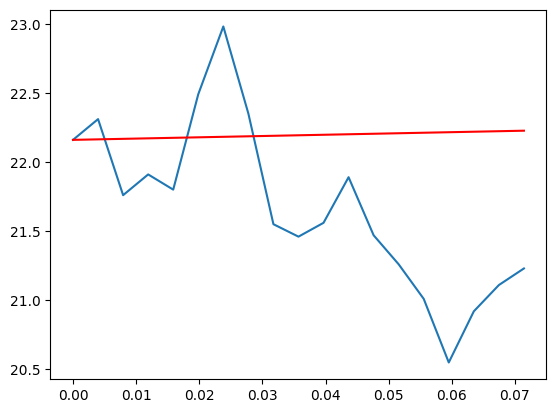

Stock = AES
S0 =  22.1599998474


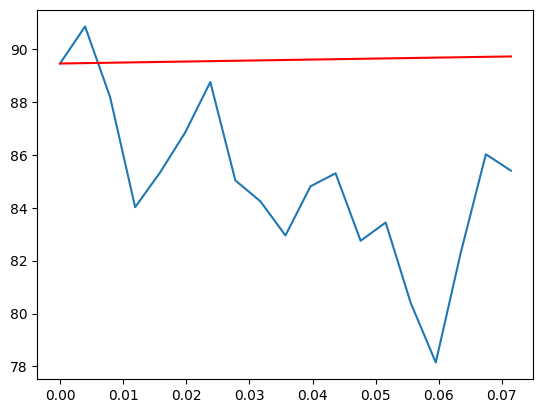

Stock = DHI
S0 =  89.4499969482


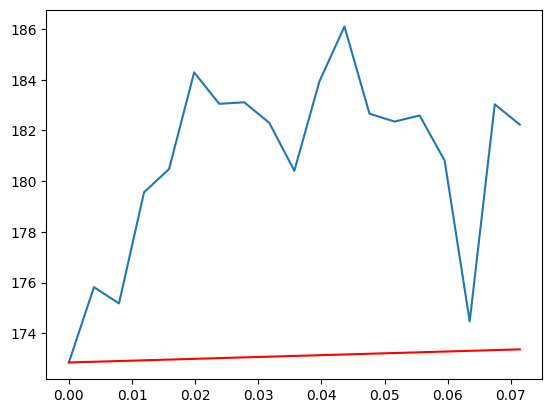

Stock = MTB
S0 =  172.8500061035


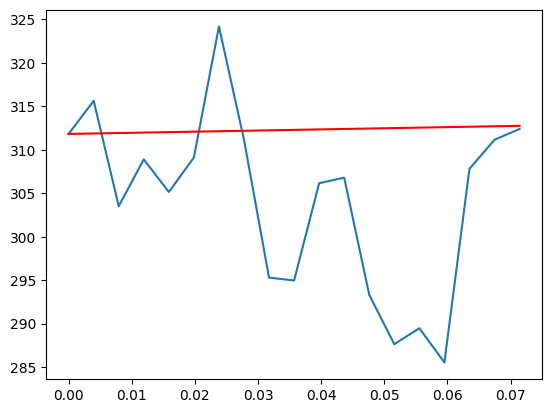

Stock = SNPS
S0 =  311.8200073242


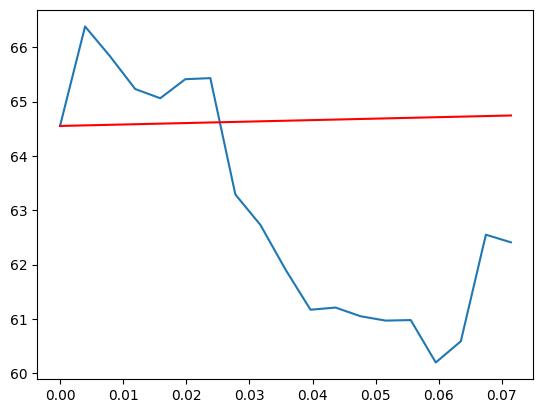

Stock = EVRG
S0 =  64.5500030518


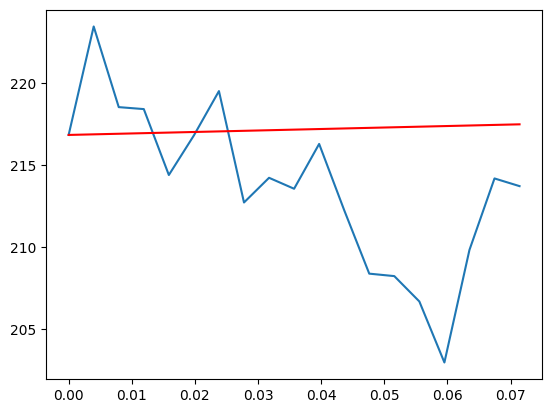

Stock = VRSN
S0 =  216.8500061035


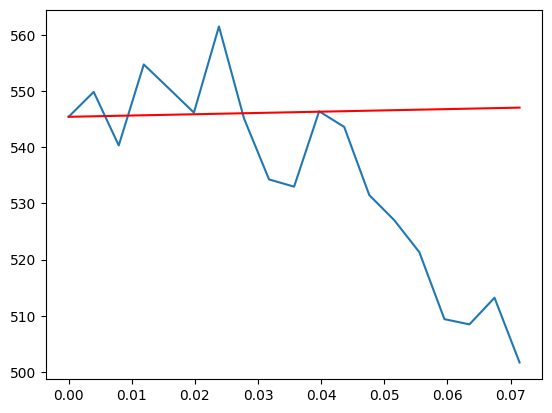

Stock = MSCI
S0 =  545.4000244141


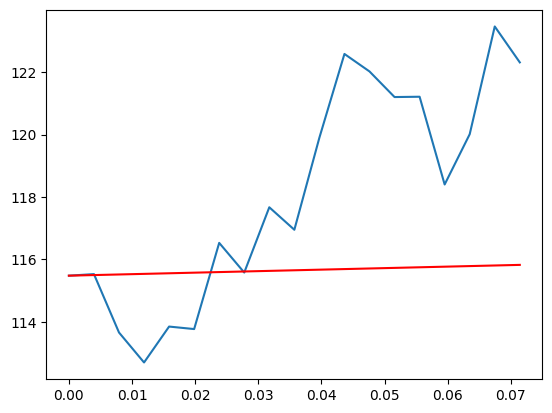

Stock = BXP
S0 =  115.4800033569


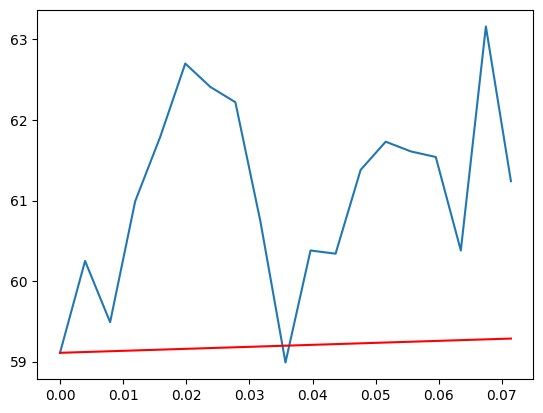

Stock = AIG
S0 =  59.1100006104


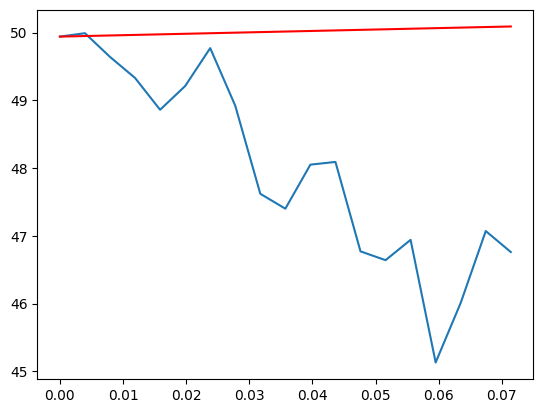

Stock = CMCSA
S0 =  49.9399986267


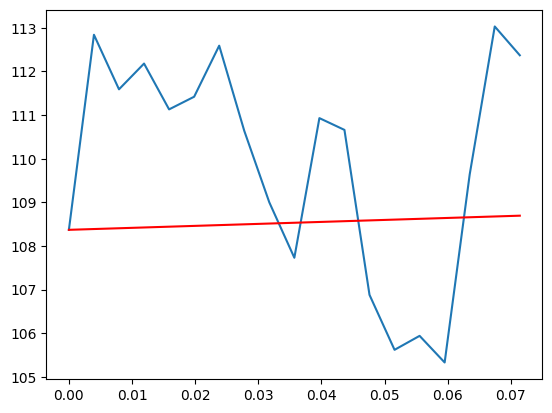

Stock = EW
S0 =  108.3700027466


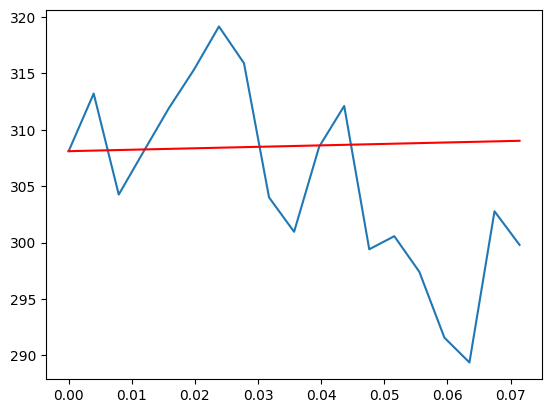

Stock = AMP
S0 =  308.1000061035


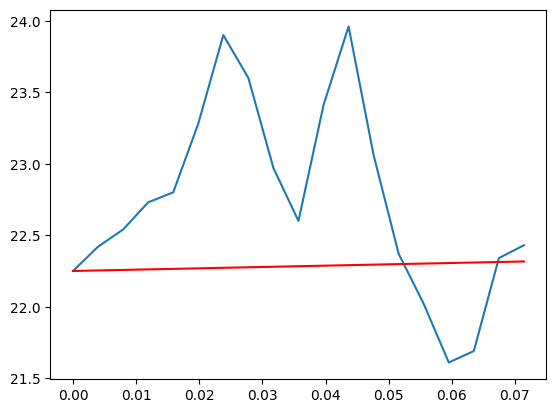

Stock = NWS
S0 =  22.25


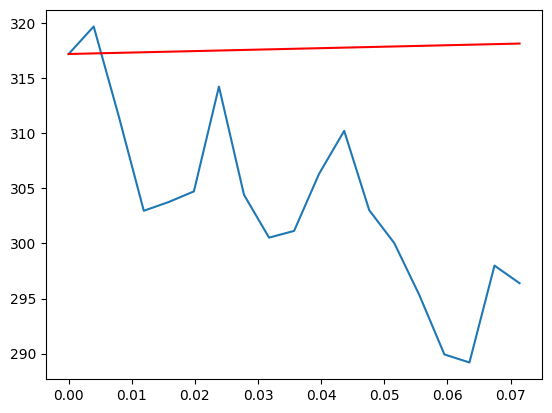

Stock = PH
S0 =  317.2099914551


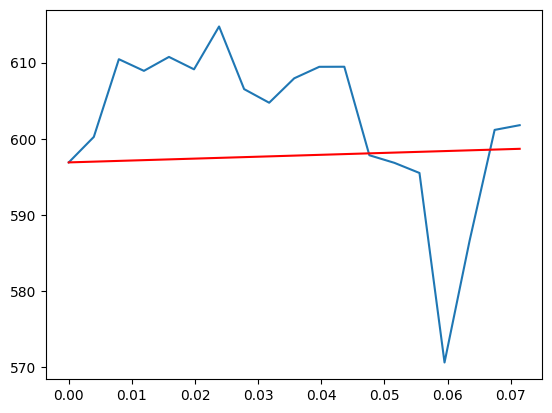

Stock = CHTR
S0 =  596.8900146484


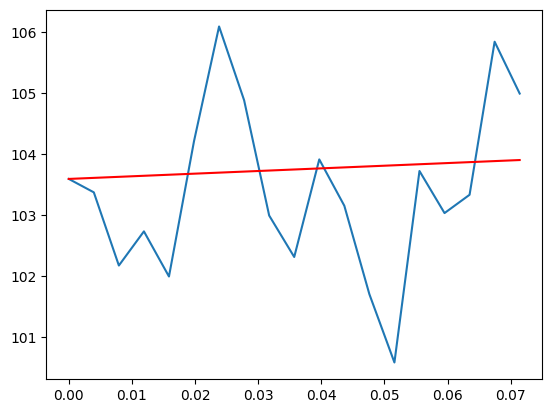

Stock = MDT
S0 =  103.5899963379


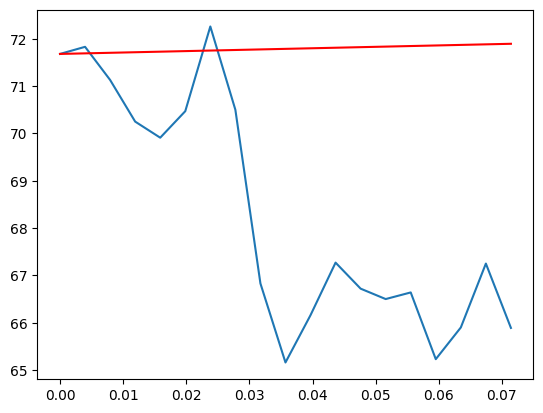

Stock = REG
S0 =  71.6800003052


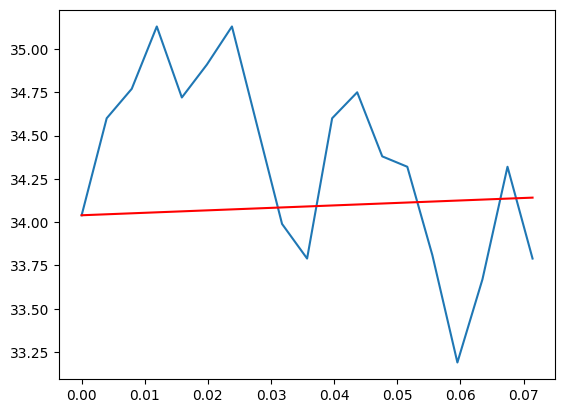

Stock = JNPR
S0 =  34.0400009155


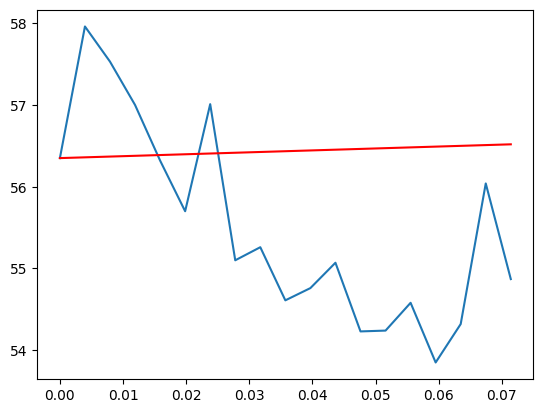

Stock = UDR
S0 =  56.3499984741


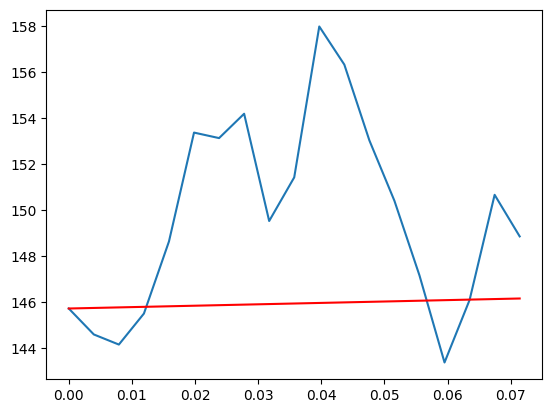

Stock = HLT
S0 =  145.7200012207


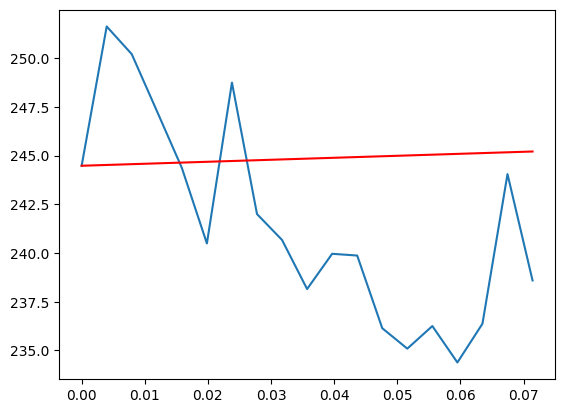

Stock = AVB
S0 =  244.4799957275


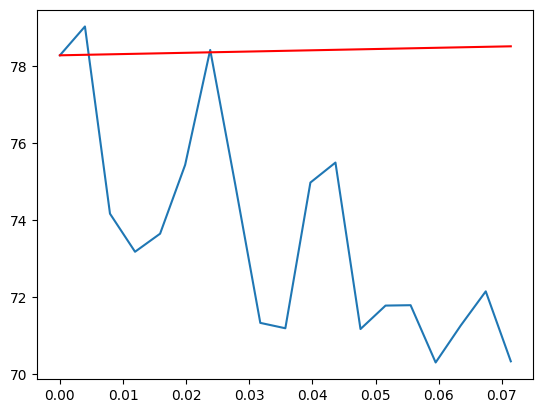

Stock = MCHP
S0 =  78.2900009155


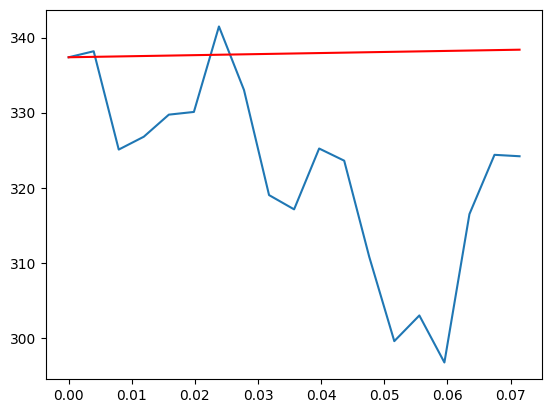

Stock = ANSS
S0 =  337.3699951172


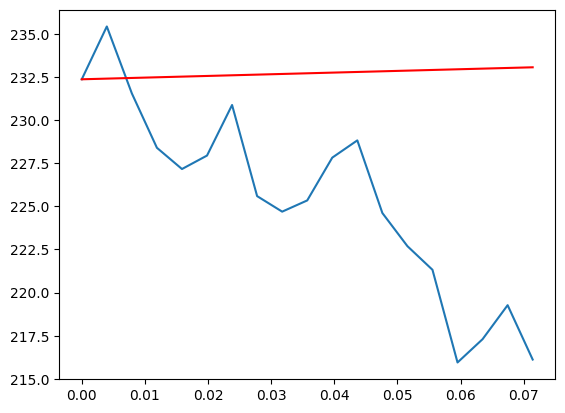

Stock = V
S0 =  232.3600006104


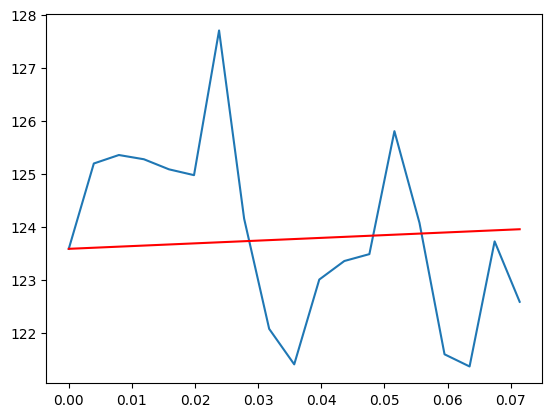

Stock = YUM
S0 =  123.5800018311


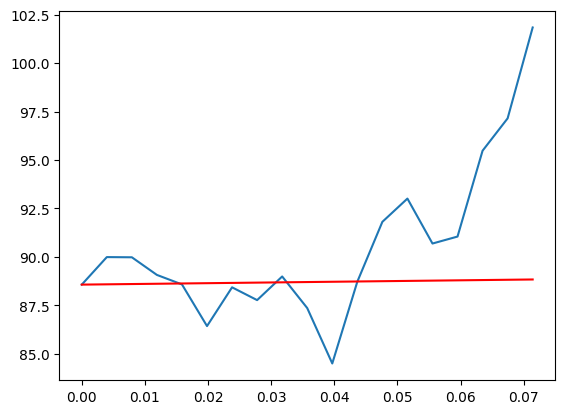

Stock = LDOS
S0 =  88.5699996948


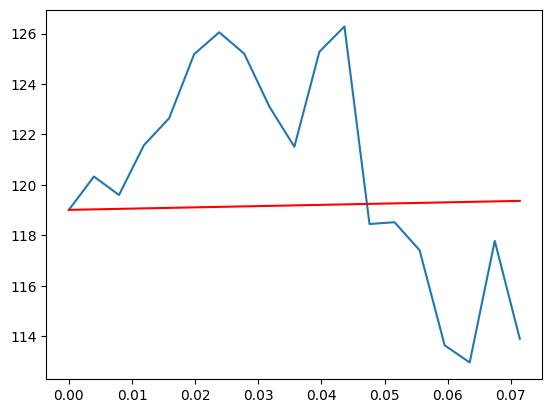

Stock = NTRS
S0 =  119.0100021362


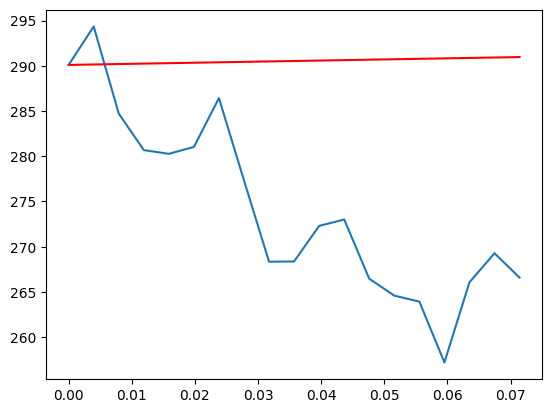

Stock = ROK
S0 =  290.1000061035


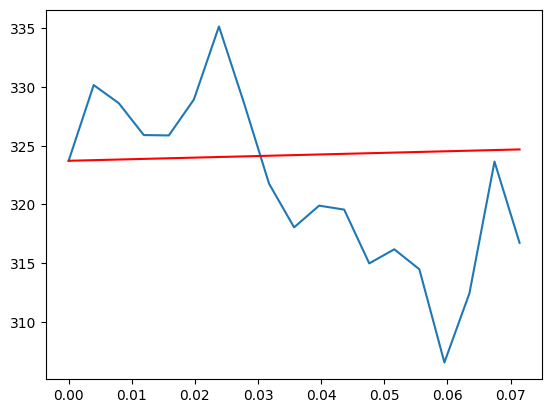

Stock = WAT
S0 =  323.7200012207


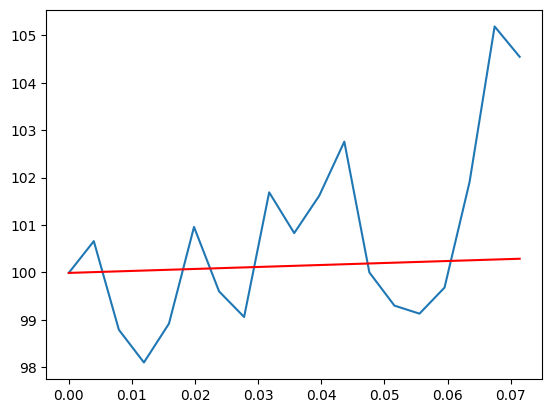

Stock = BG
S0 =  99.9899978638


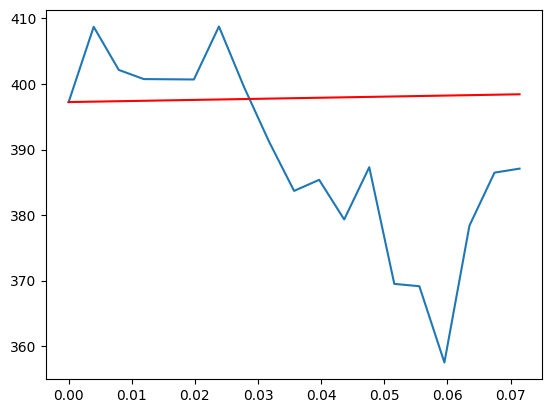

Stock = WST
S0 =  397.2399902344


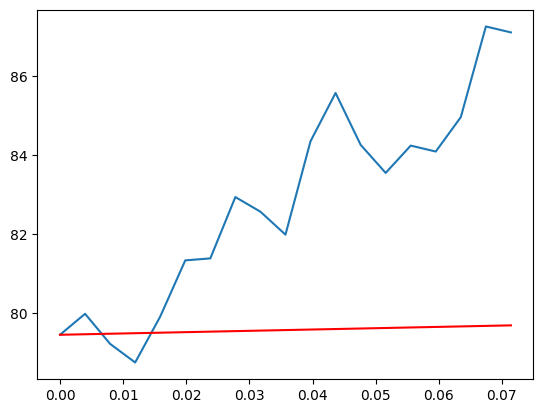

Stock = SYY
S0 =  79.4599990845


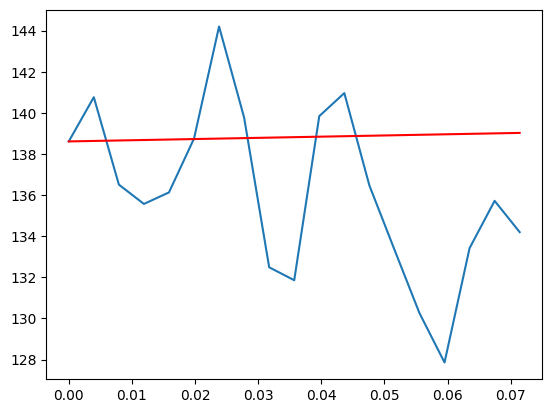

Stock = AMAT
S0 =  138.6100006104


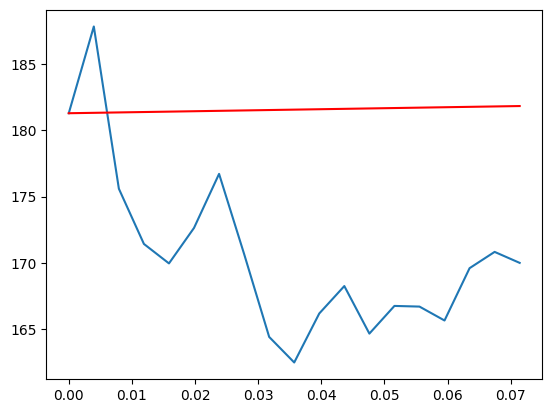

Stock = TXN
S0 =  181.2899932861


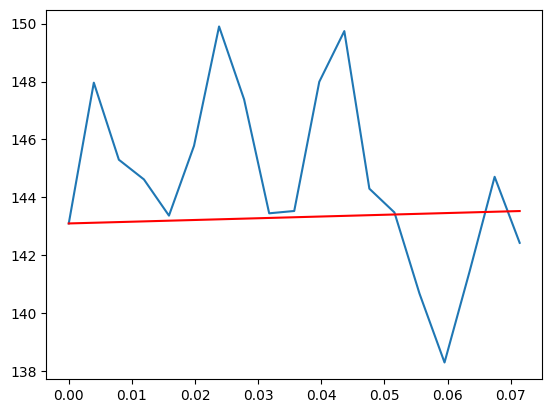

Stock = TEL
S0 =  143.1000061035


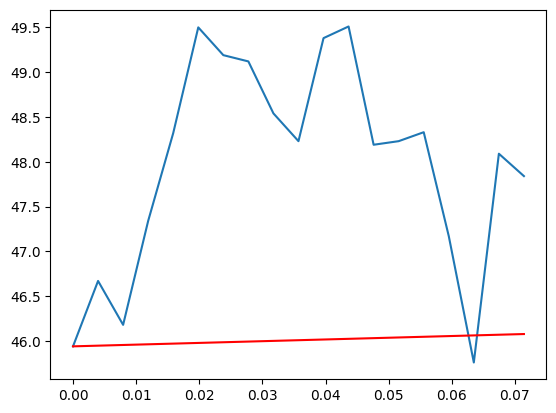

Stock = FITB
S0 =  45.9399986267


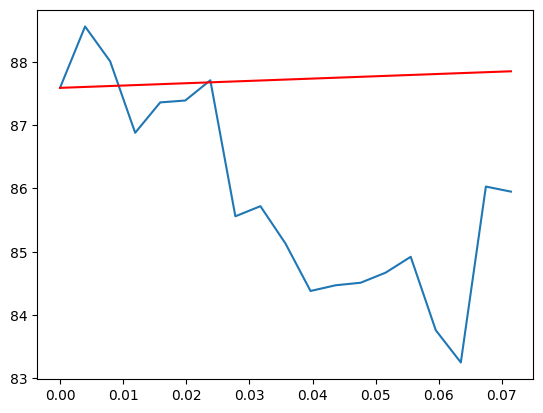

Stock = AEE
S0 =  87.5899963379


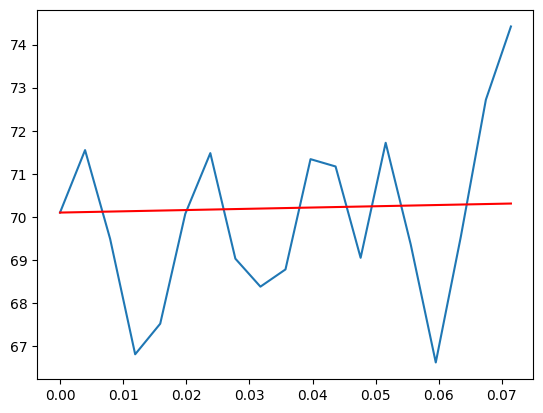

Stock = BLDR
S0 =  70.0999984741


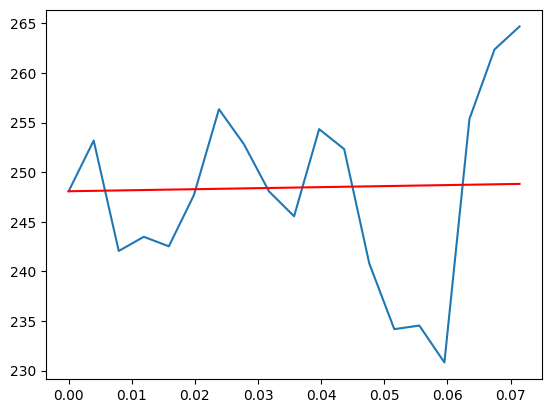

Stock = PODD
S0 =  248.0800018311


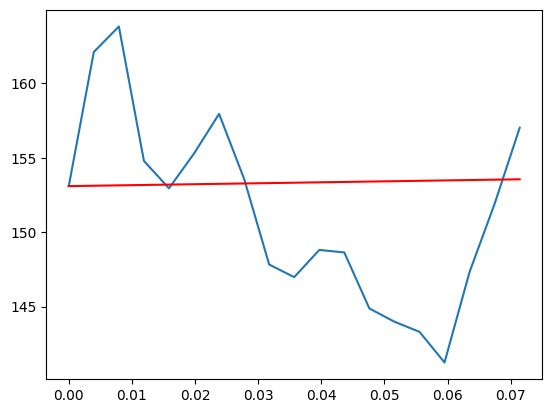

Stock = ODFL
S0 =  153.0950012207


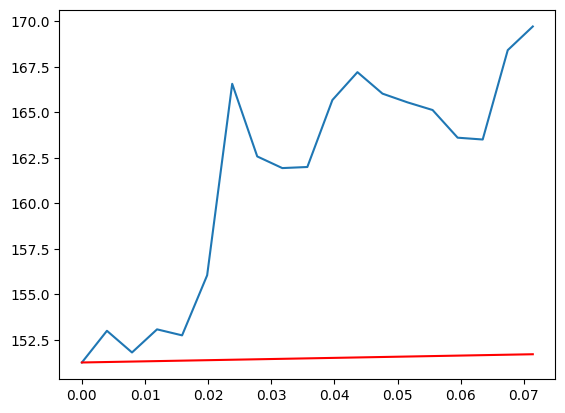

Stock = AIZ
S0 =  151.25


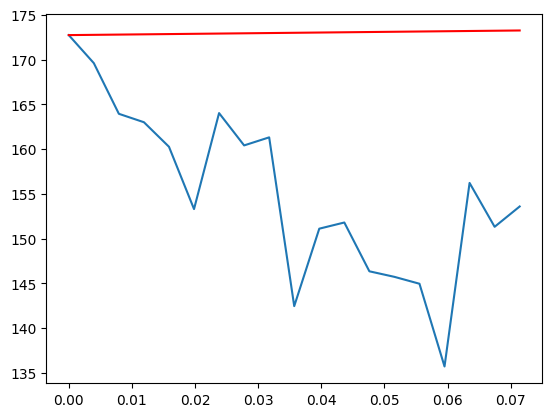

Stock = MRNA
S0 =  172.7400054932


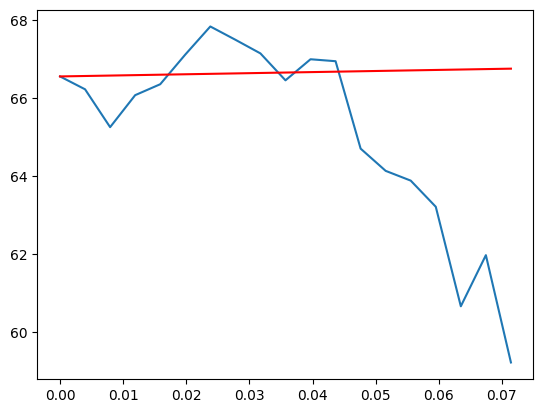

Stock = C
S0 =  66.5599975586


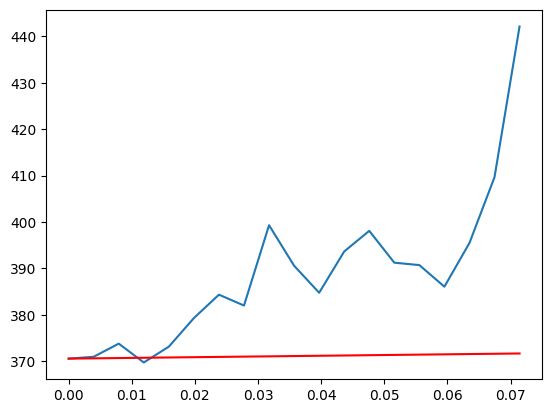

Stock = NOC
S0 =  370.5799865723


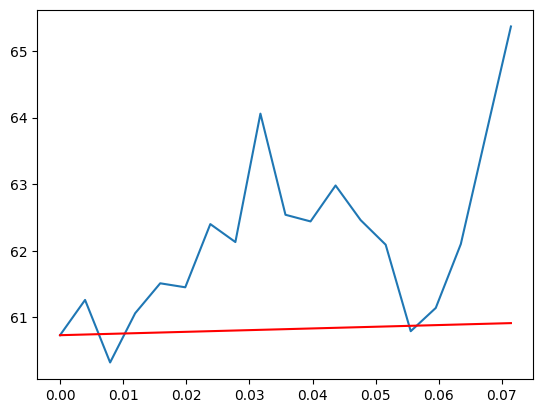

Stock = TRGP
S0 =  60.7299995422


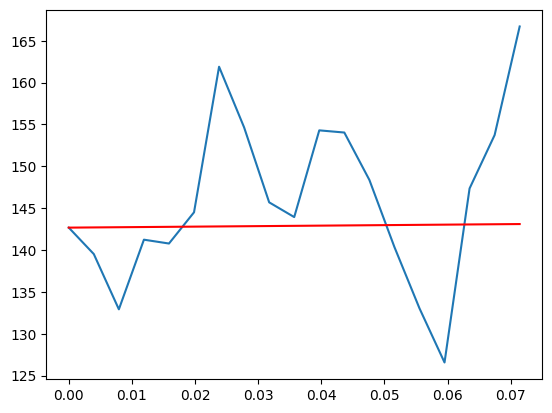

Stock = ENPH
S0 =  142.6699981689


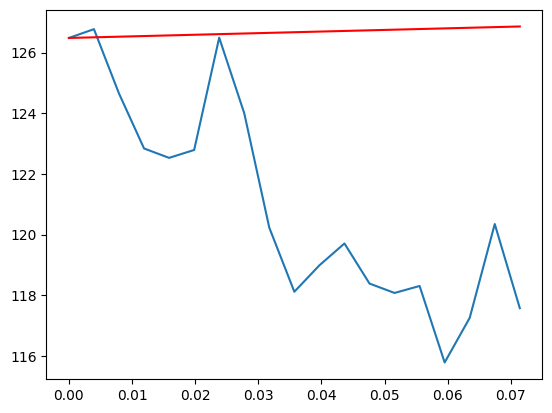

Stock = FRT
S0 =  126.4800033569


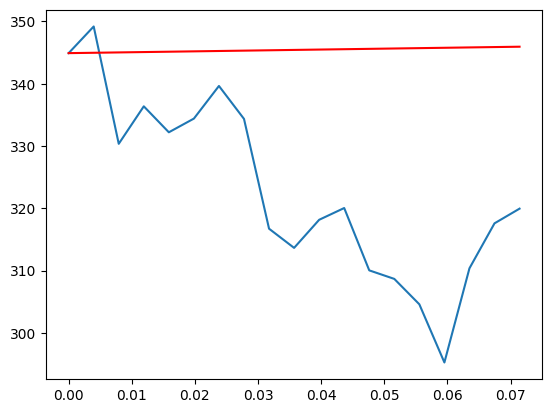

Stock = LULU
S0 =  344.9100036621


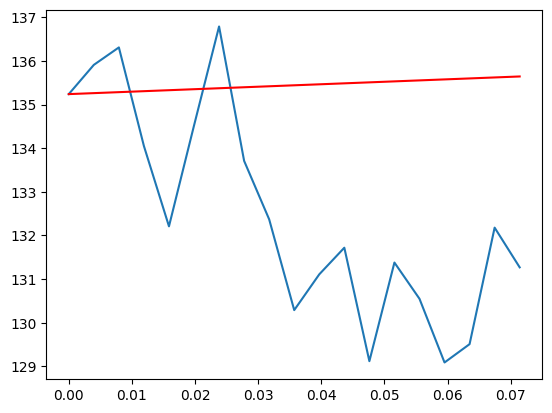

Stock = DGX
S0 =  135.2400054932


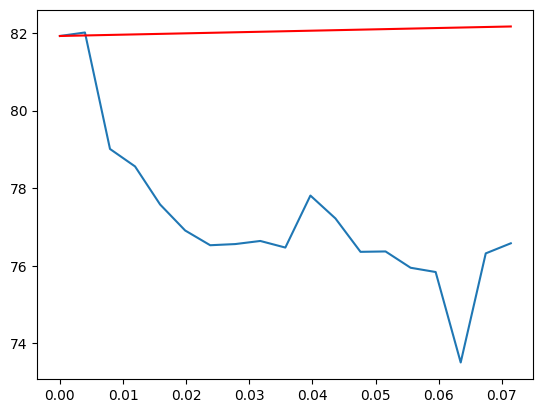

Stock = MRK
S0 =  81.9199981689


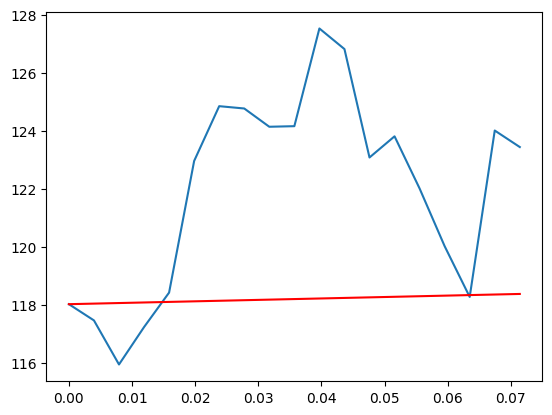

Stock = DFS
S0 =  118.0199966431


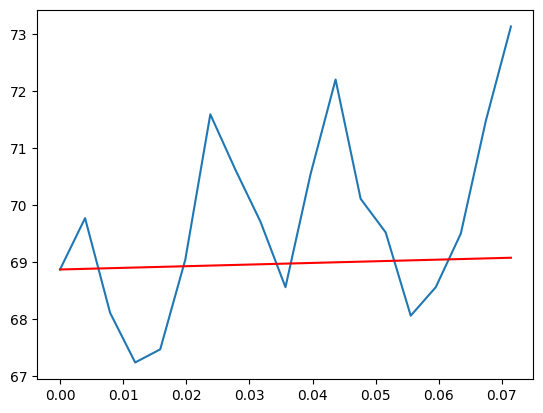

Stock = TXT
S0 =  68.8700027466


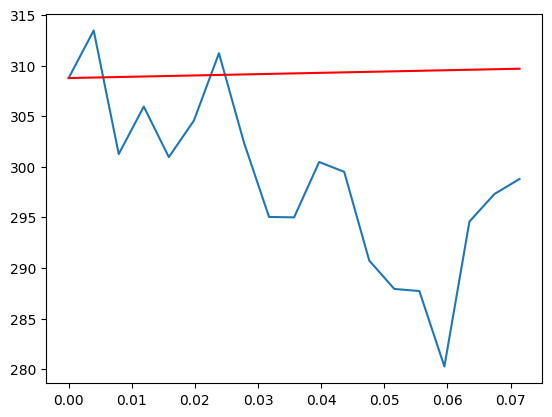

Stock = MSFT
S0 =  308.7600097656


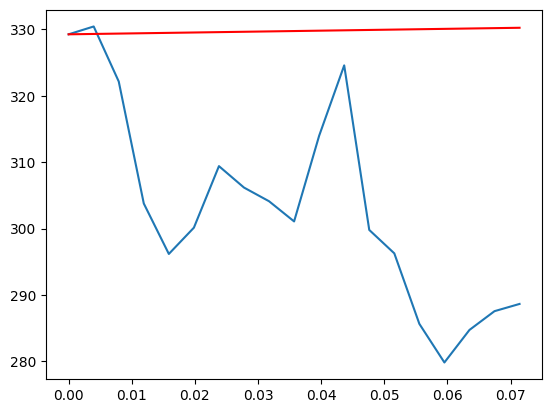

Stock = DECK
S0 =  329.2600097656


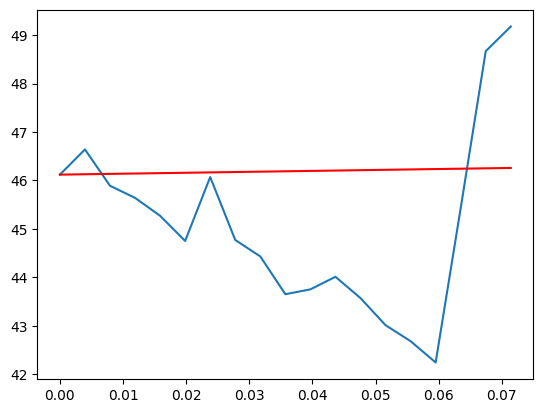

Stock = IRM
S0 =  46.1199989319


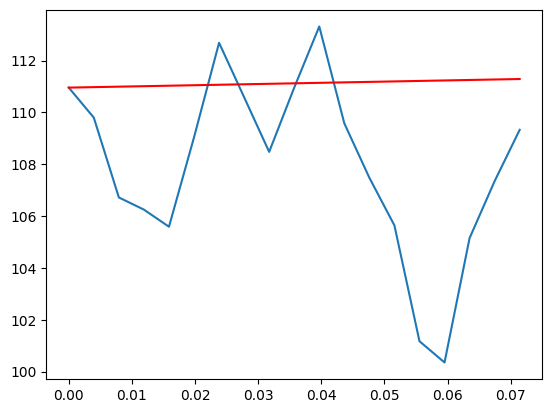

Stock = KMX
S0 =  110.9599990845


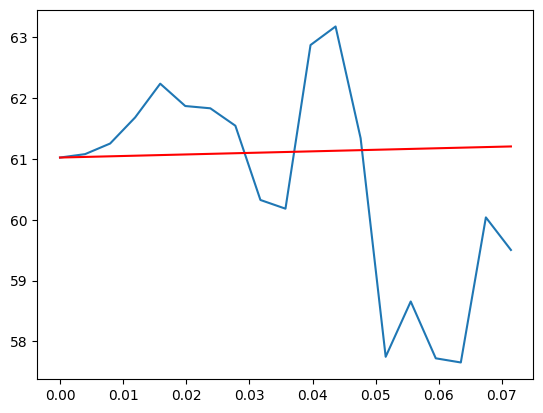

Stock = GE
S0 =  61.0245018005


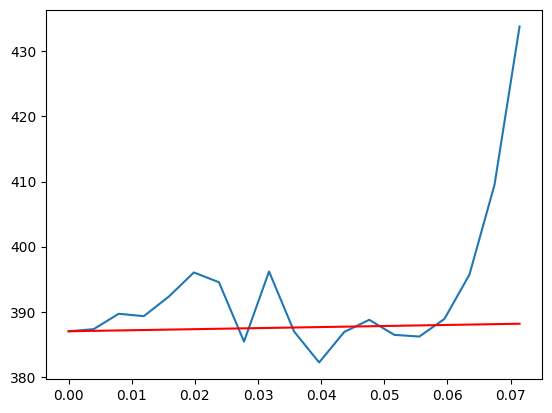

Stock = LMT
S0 =  387.0100097656


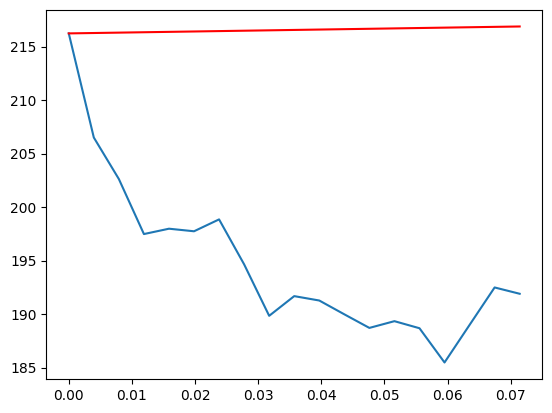

Stock = IEX
S0 =  216.2299957275


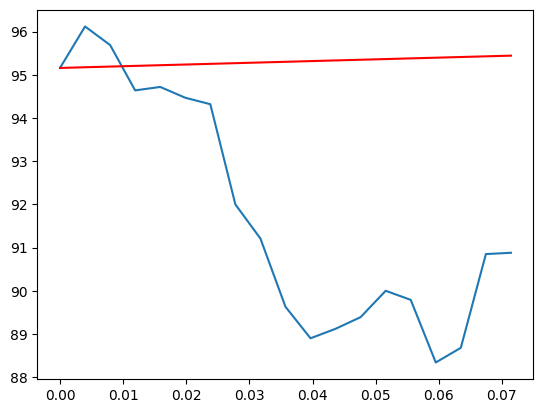

Stock = WEC
S0 =  95.1600036621


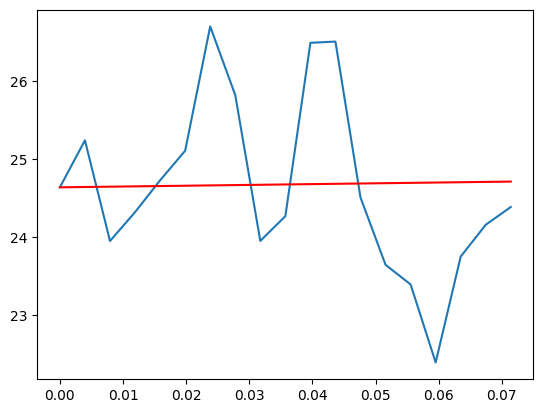

Stock = NVDA
S0 =  24.6380004883


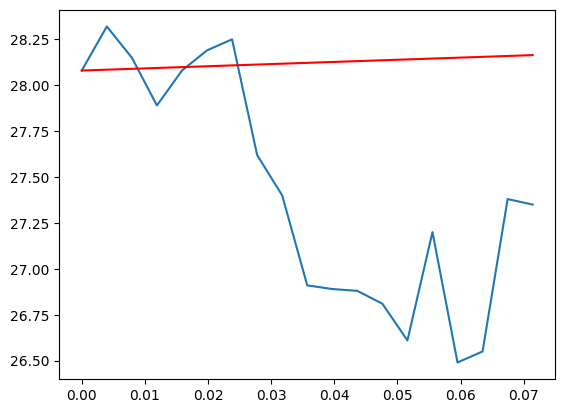

Stock = CNP
S0 =  28.0799999237


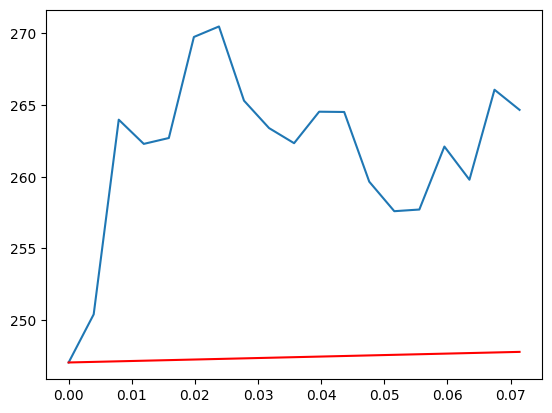

Stock = BDX
S0 =  247.0536651611


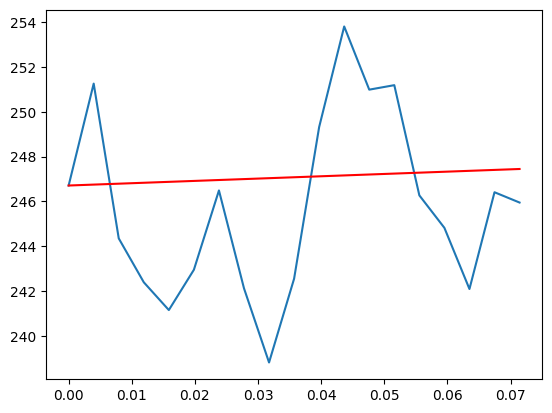

Stock = UNP
S0 =  246.7100067139


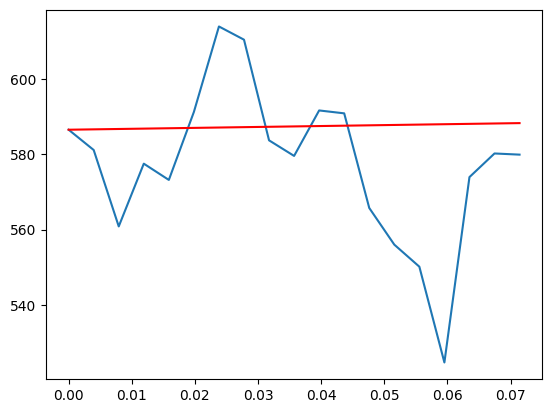

Stock = NOW
S0 =  586.5399780273


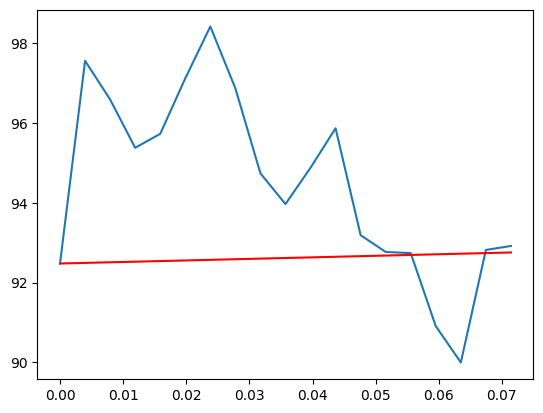

Stock = EMR
S0 =  92.4800033569


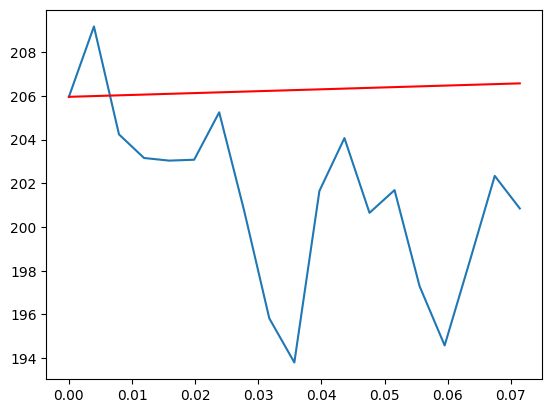

Stock = FFIV
S0 =  205.9600067139


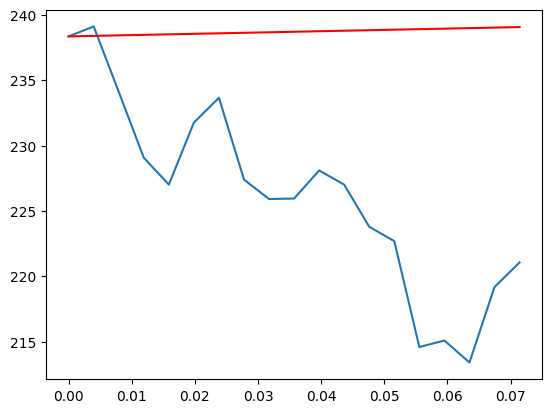

Stock = LOW
S0 =  238.3500061035


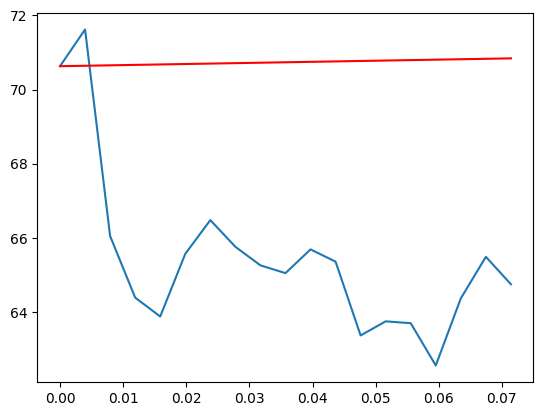

Stock = FTV
S0 =  70.6299972534


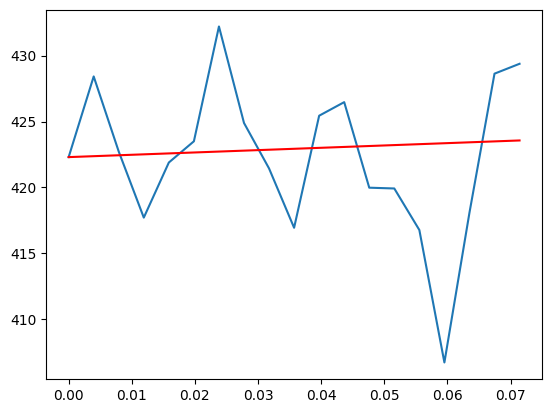

Stock = TDY
S0 =  422.299987793


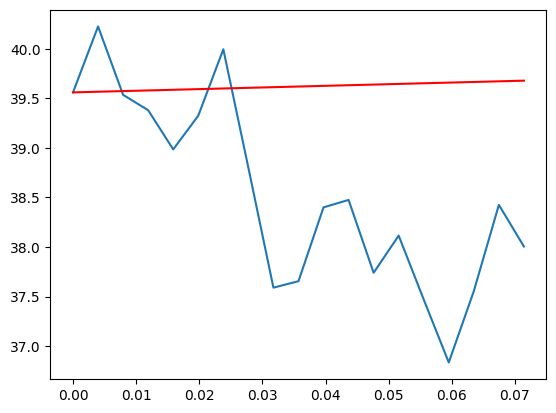

Stock = APH
S0 =  39.5600013733


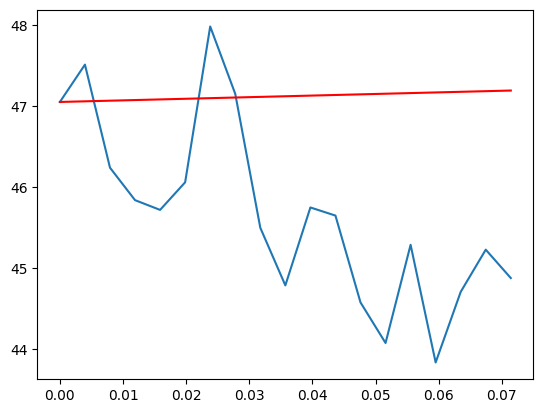

Stock = CARR
S0 =  47.0499992371


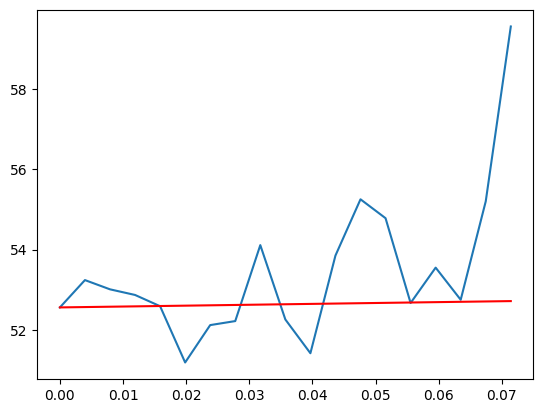

Stock = DVN
S0 =  52.5600013733


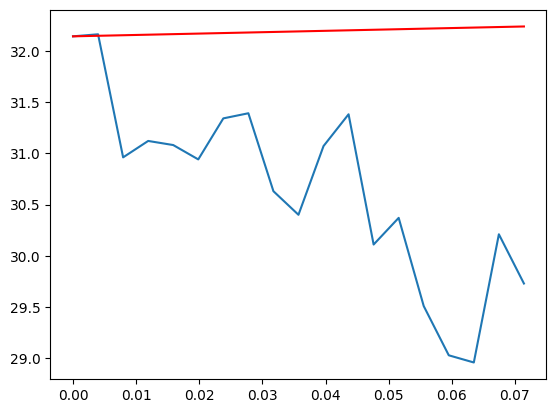

Stock = BEN
S0 =  32.1399993896


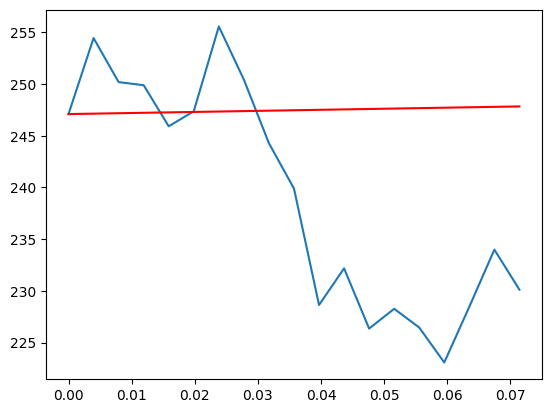

Stock = IQV
S0 =  247.1000061035


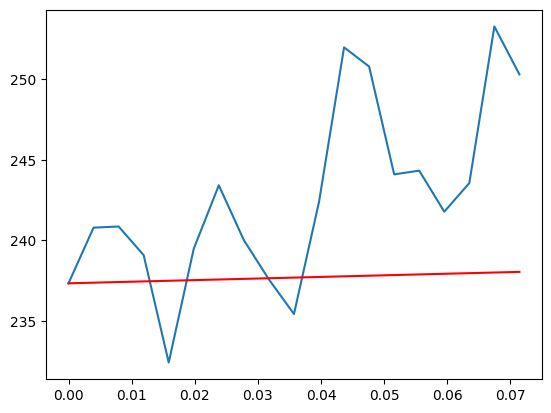

Stock = HCA
S0 =  237.3300018311


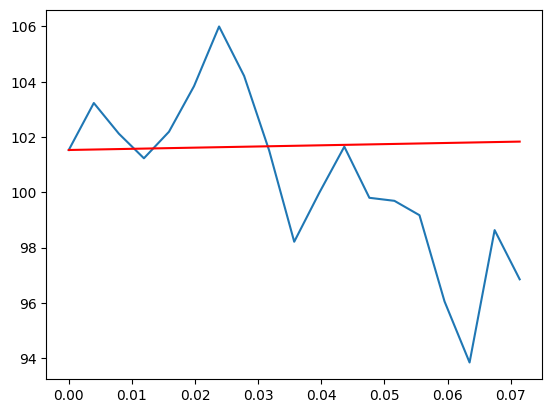

Stock = CBRE
S0 =  101.5299987793


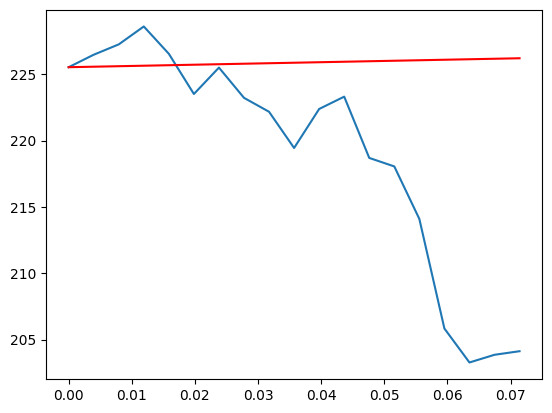

Stock = CMI
S0 =  225.5299987793


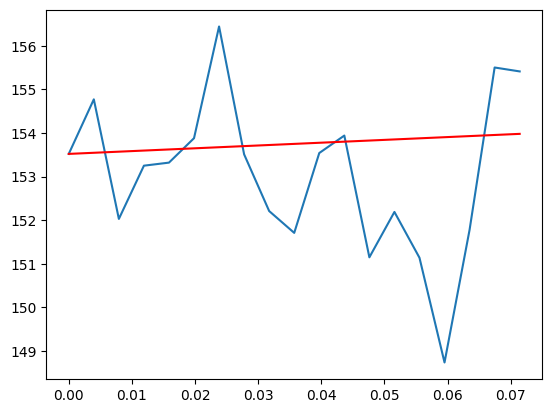

Stock = MMC
S0 =  153.5200042725


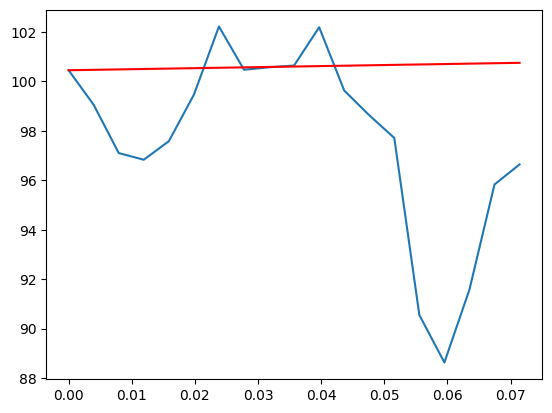

Stock = BBY
S0 =  100.4499969482


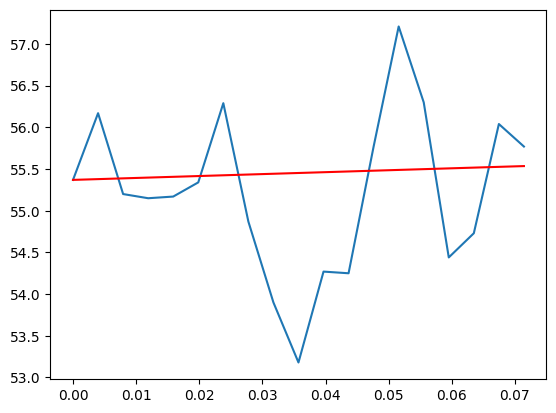

Stock = CSCO
S0 =  55.3699989319


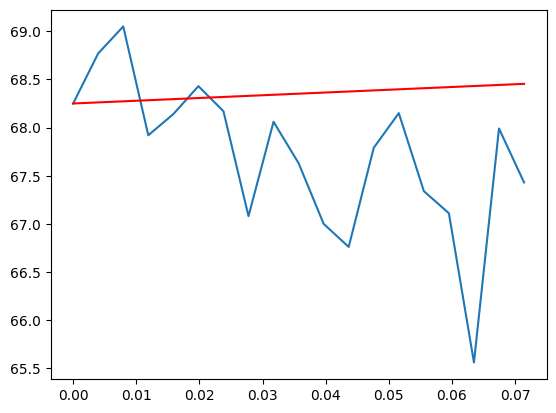

Stock = GIS
S0 =  68.25


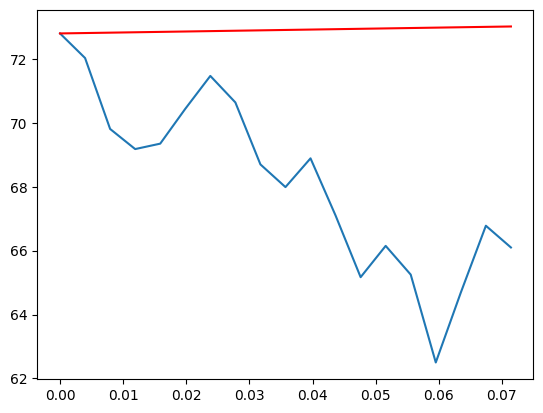

Stock = TJX
S0 =  72.8000030518


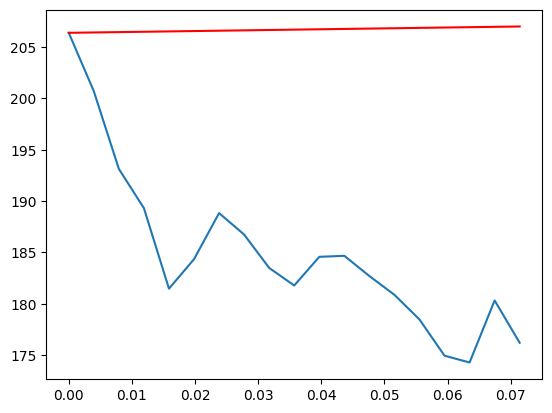

Stock = AVY
S0 =  206.3899993896


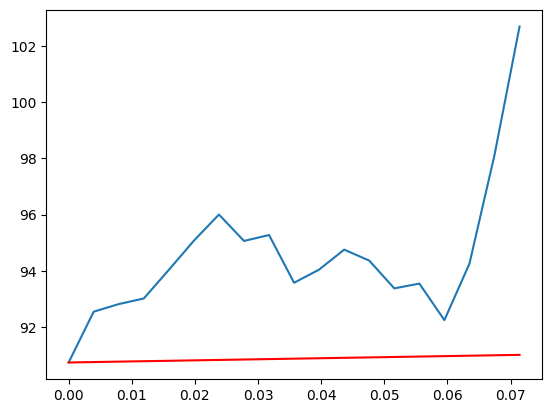

Stock = RTX
S0 =  90.7300033569


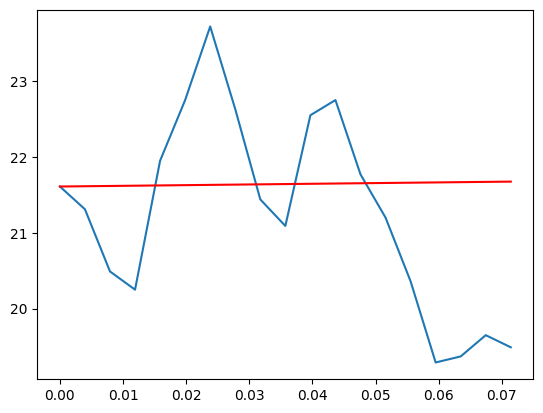

Stock = NCLH
S0 =  21.6100006104


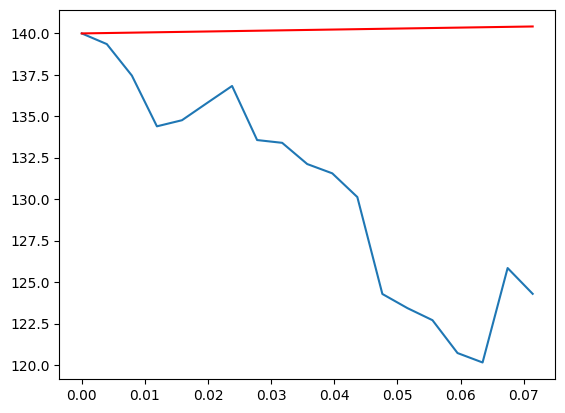

Stock = MMM
S0 =  139.9916381836


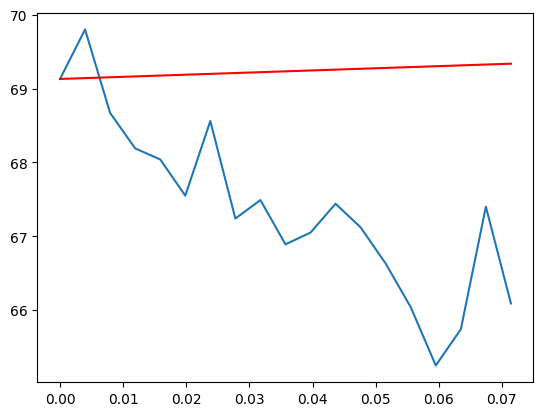

Stock = O
S0 =  69.1299972534


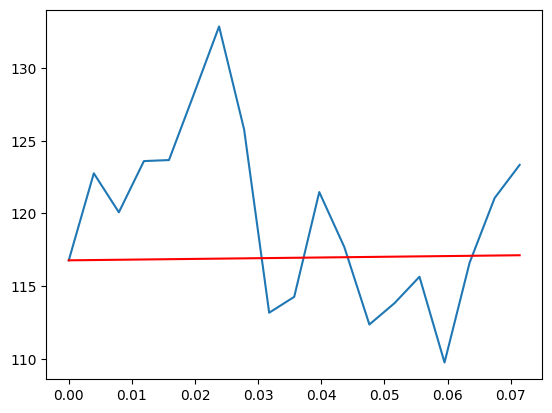

Stock = AMD
S0 =  116.7799987793


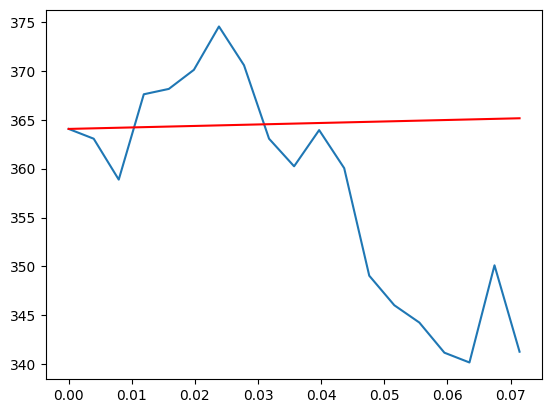

Stock = GS
S0 =  364.0599975586


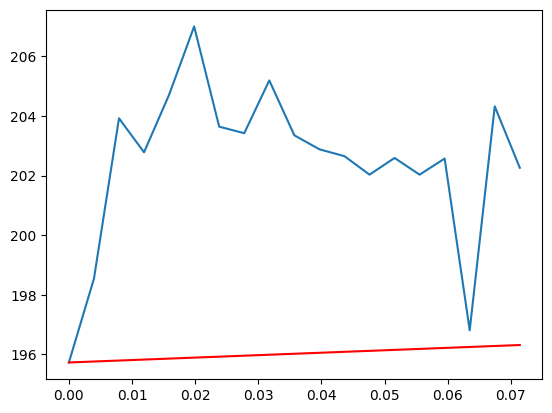

Stock = HSY
S0 =  195.7299957275


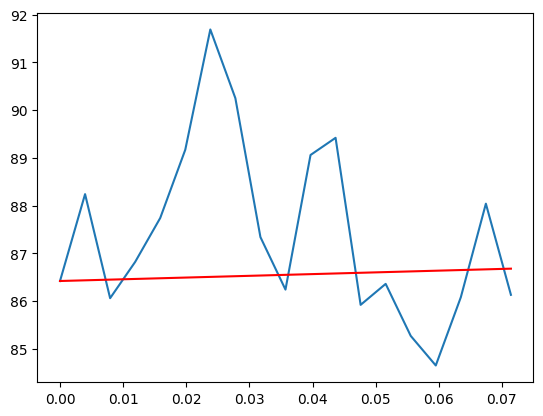

Stock = CTSH
S0 =  86.4199981689


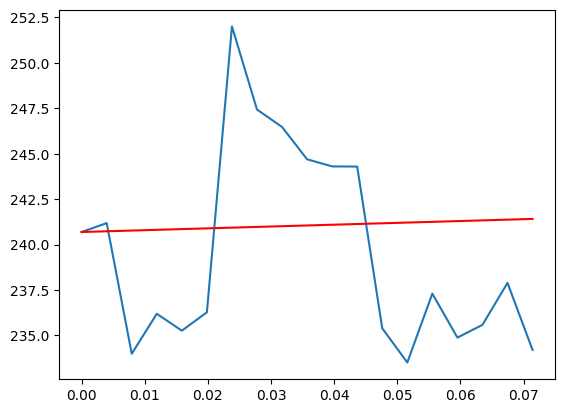

Stock = CPAY
S0 =  240.6900024414


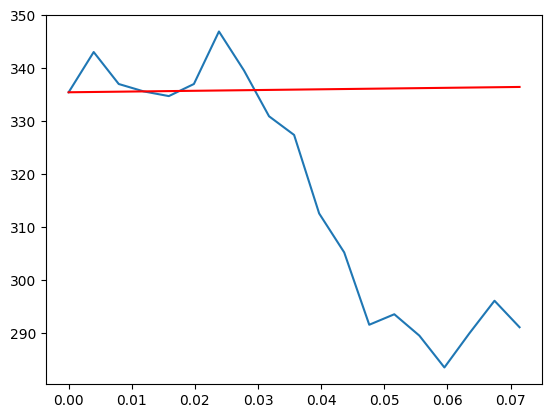

Stock = CRL
S0 =  335.4899902344


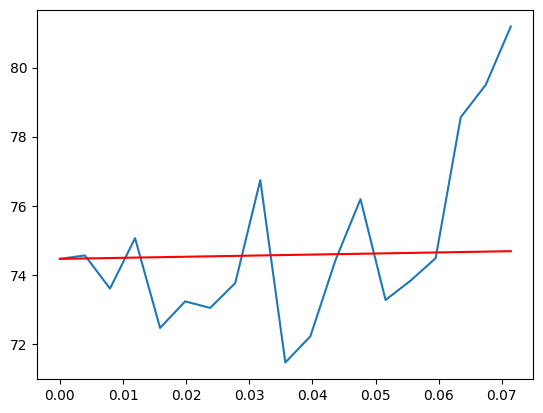

Stock = CF
S0 =  74.4599990845


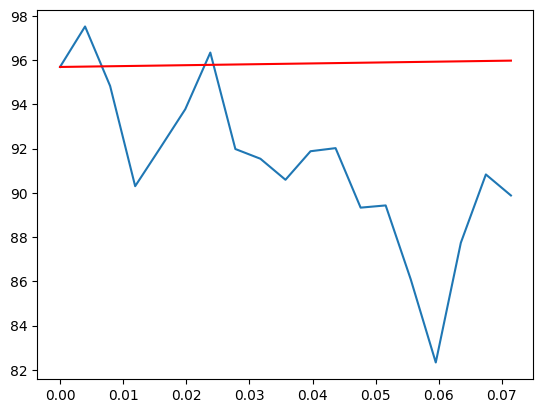

Stock = LEN
S0 =  95.6900024414


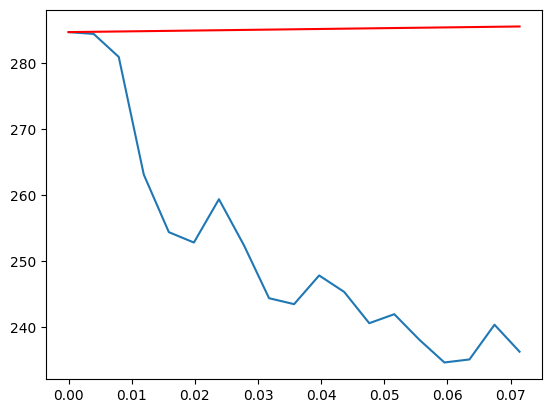

Stock = APD
S0 =  284.6300048828


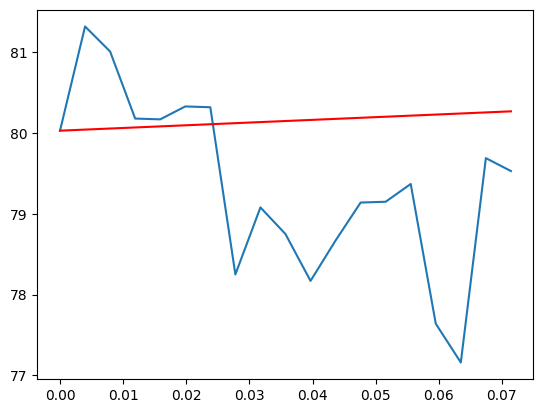

Stock = D
S0 =  80.0299987793


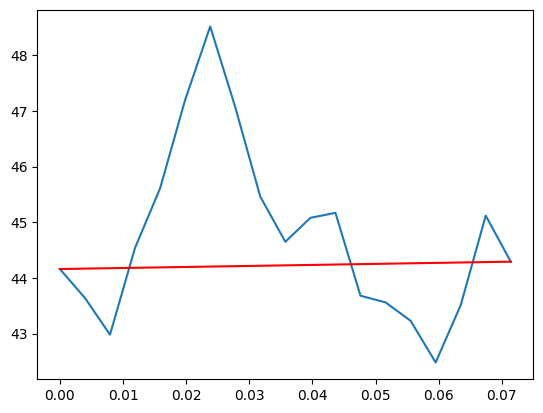

Stock = MGM
S0 =  44.1599998474


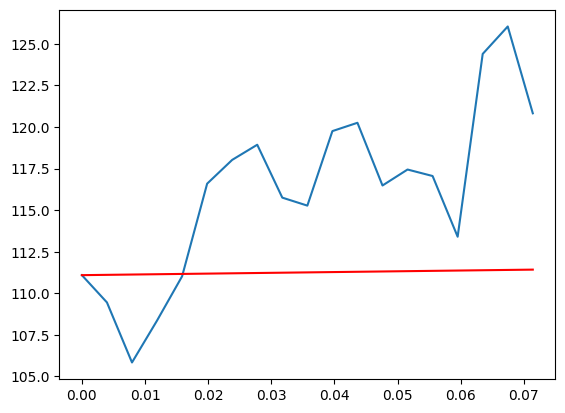

Stock = LYV
S0 =  111.0899963379


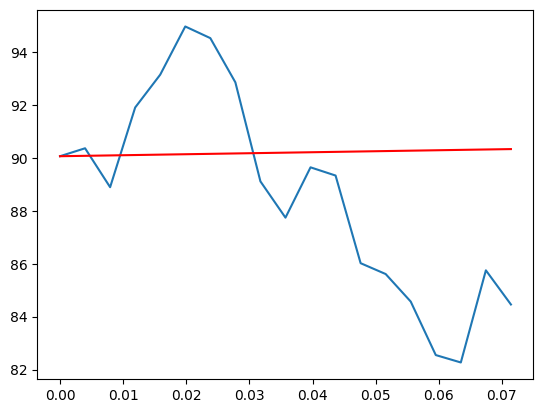

Stock = SCHW
S0 =  90.0599975586


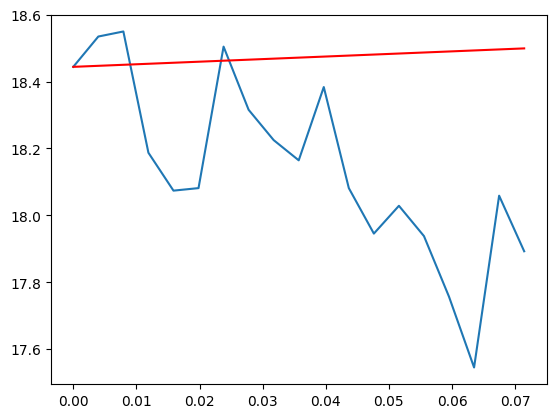

Stock = T
S0 =  18.444108963


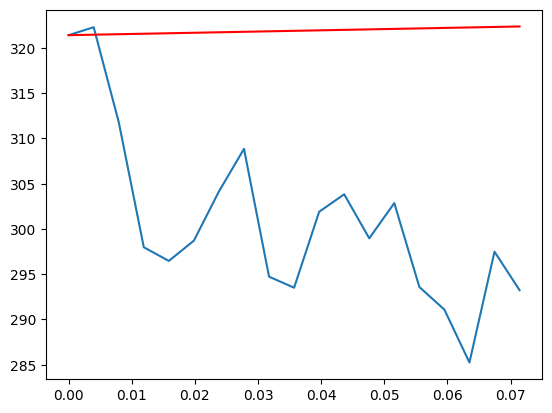

Stock = LIN
S0 =  321.4100036621


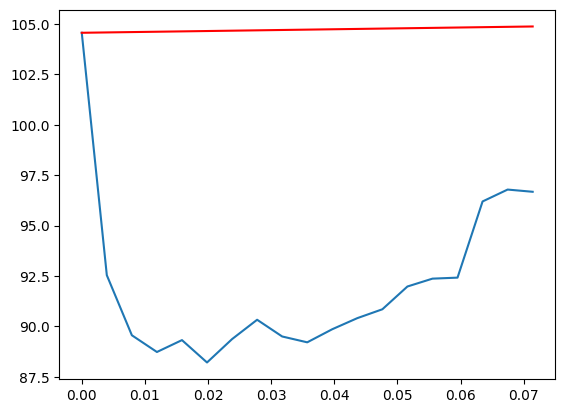

Stock = CHRW
S0 =  104.5699996948


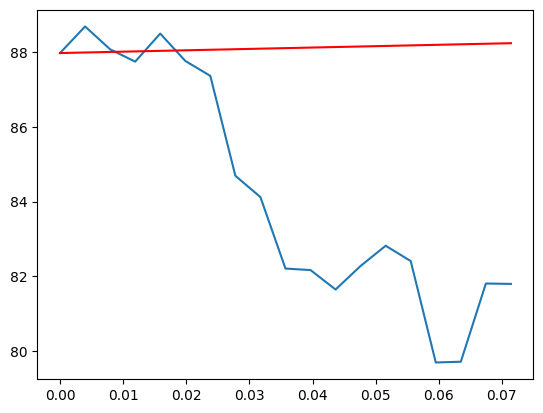

Stock = ES
S0 =  87.9700012207


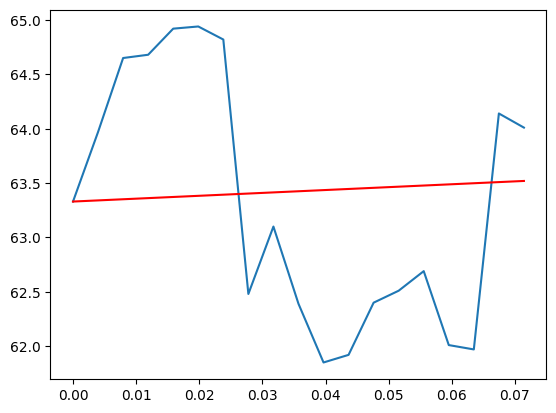

Stock = CMS
S0 =  63.3300018311


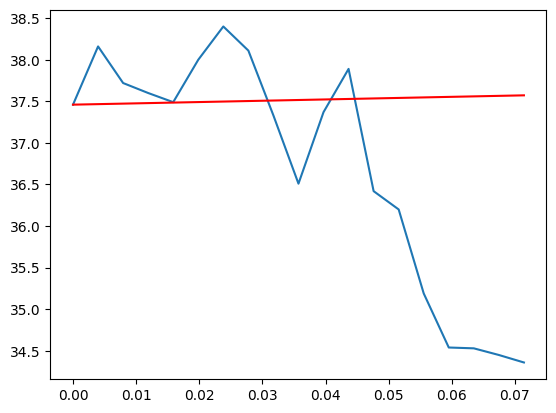

Stock = HPQ
S0 =  37.4599990845


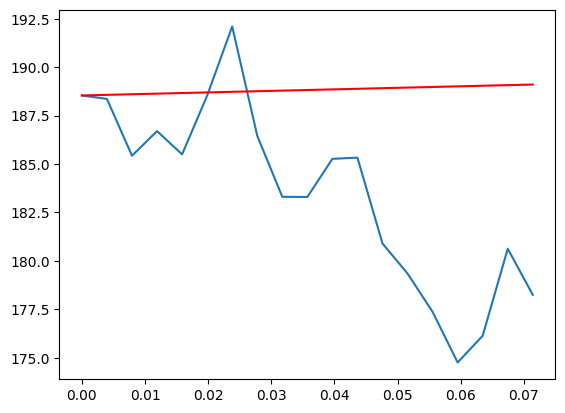

Stock = HUBB
S0 =  188.5399932861


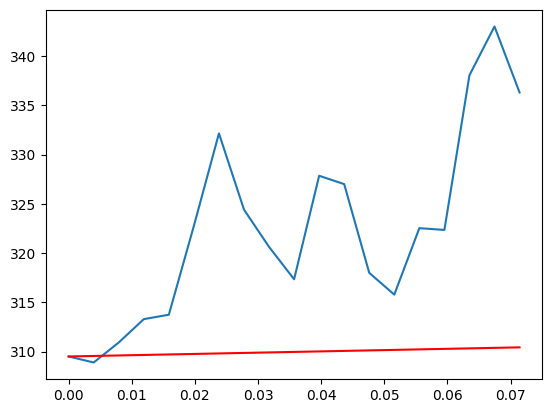

Stock = TFX
S0 =  309.5


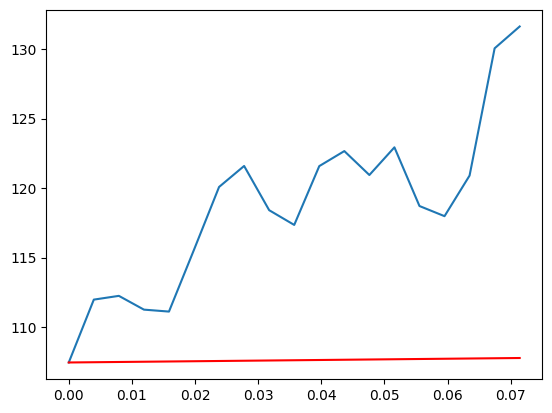

Stock = NUE
S0 =  107.4599990845


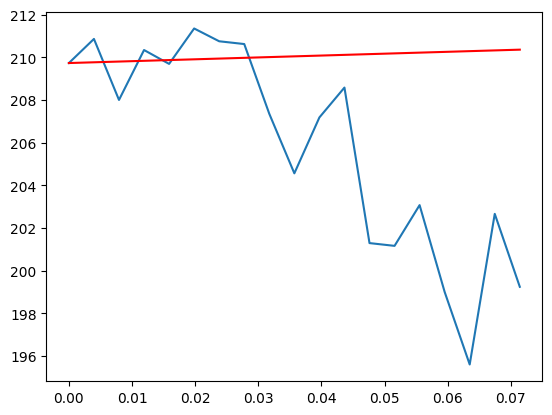

Stock = PNC
S0 =  209.7400054932


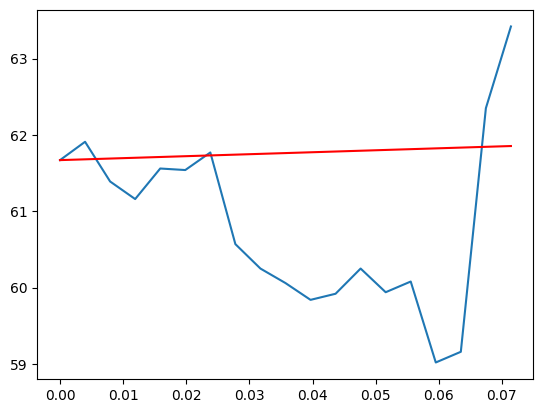

Stock = EIX
S0 =  61.6699981689


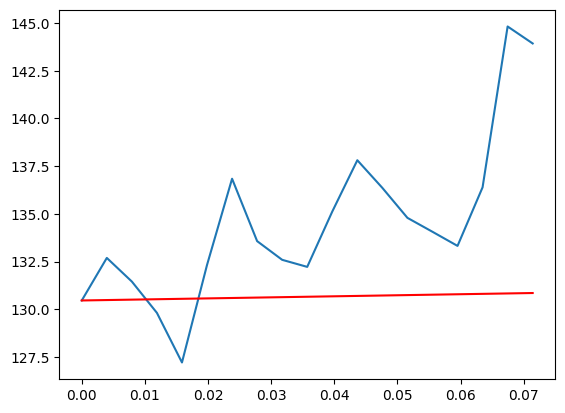

Stock = UHS
S0 =  130.4600067139


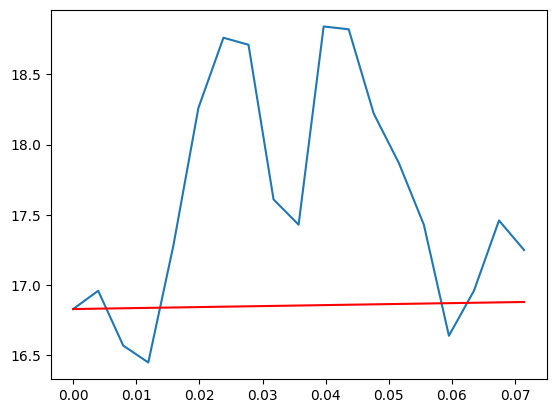

Stock = AAL
S0 =  16.8299999237


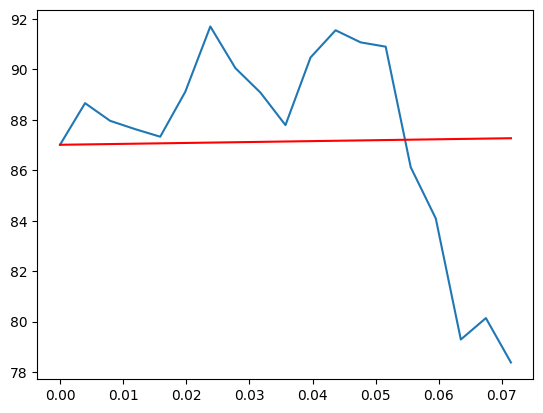

Stock = NTAP
S0 =  87.0100021362


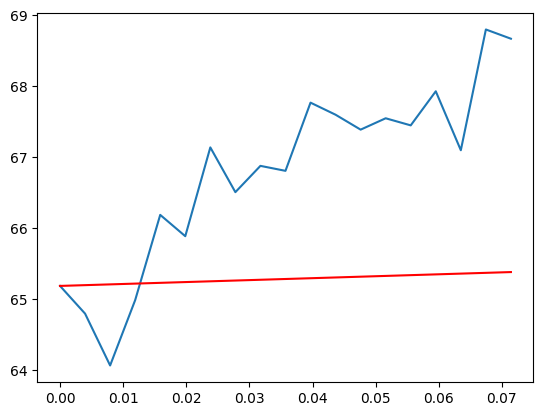

Stock = BMY
S0 =  65.1900024414


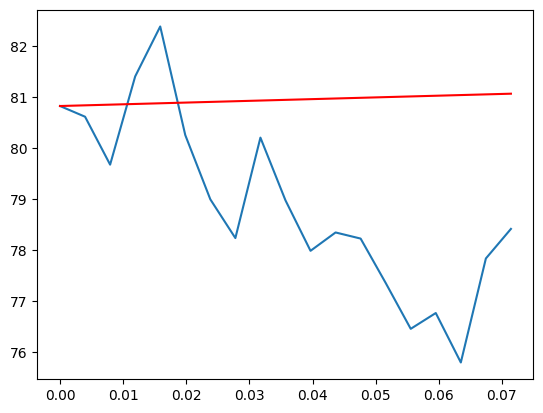

Stock = XOM
S0 =  80.8300018311


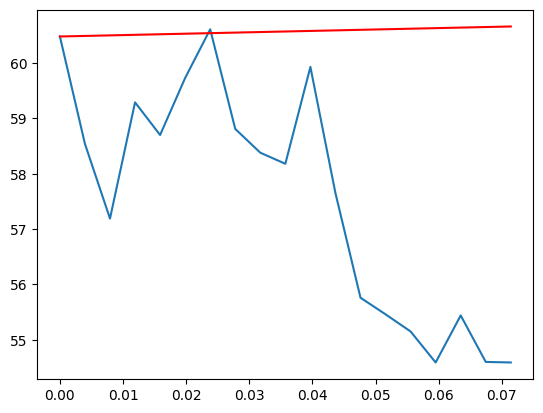

Stock = EBAY
S0 =  60.4799995422


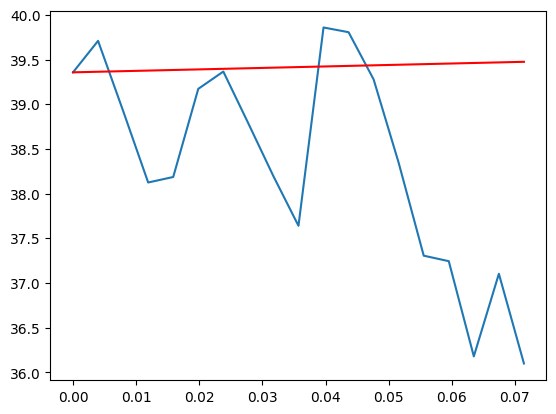

Stock = BWA
S0 =  39.3573951721


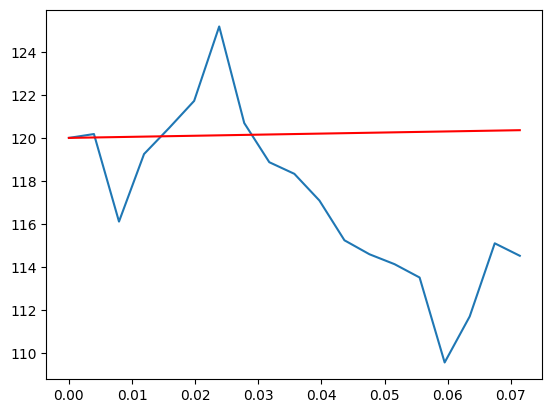

Stock = ALLE
S0 =  120.0


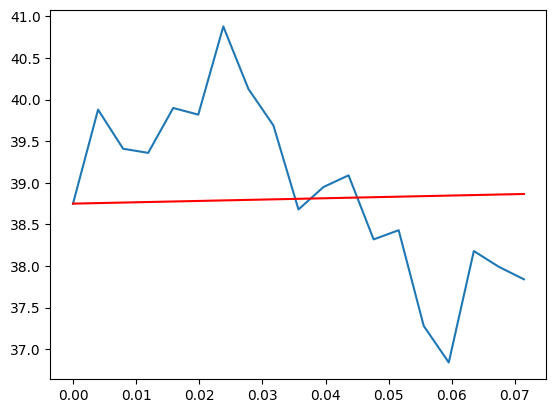

Stock = NRG
S0 =  38.75


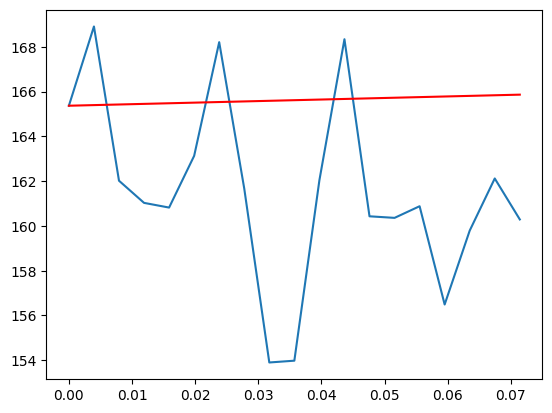

Stock = ADI
S0 =  165.3699951172


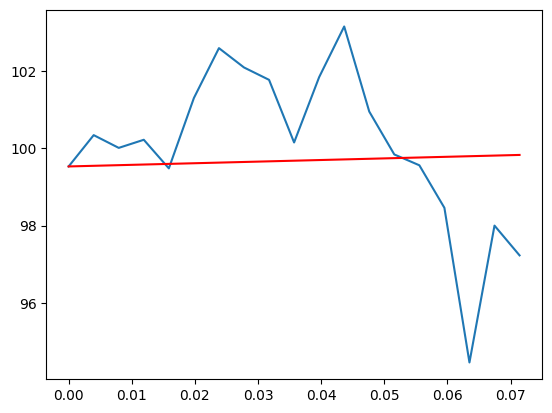

Stock = LYB
S0 =  99.5299987793


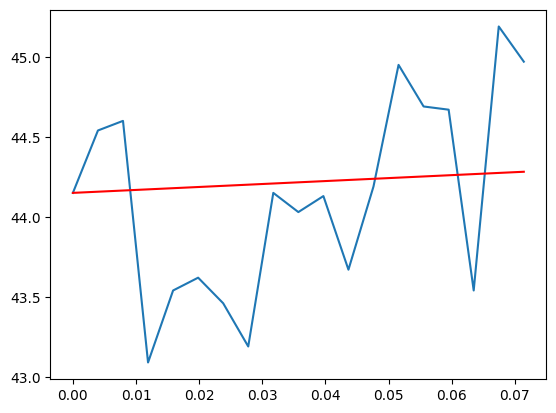

Stock = CPB
S0 =  44.1500015259


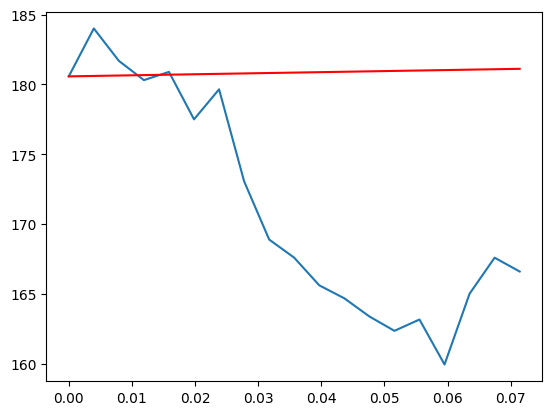

Stock = CCI
S0 =  180.5700073242


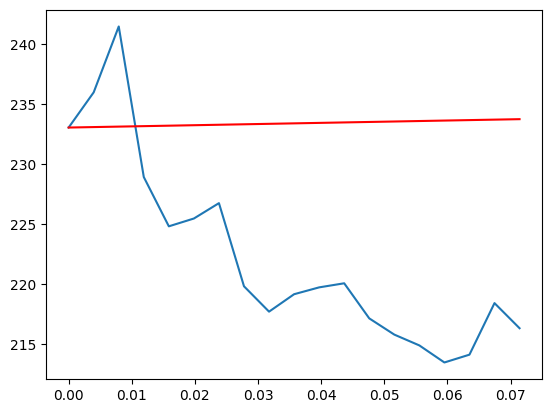

Stock = ITW
S0 =  233.0399932861


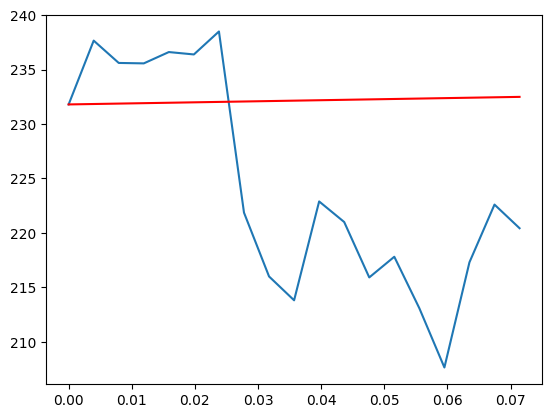

Stock = MSI
S0 =  231.8000030518


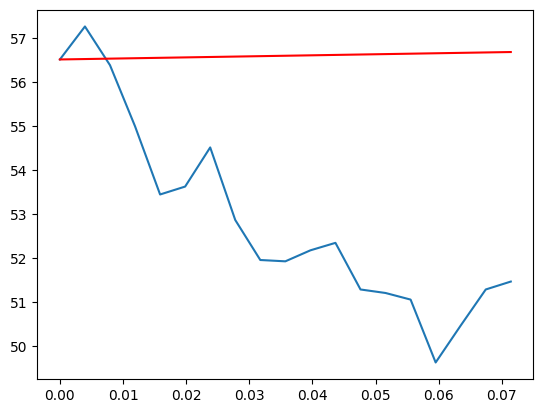

Stock = FAST
S0 =  56.5099983215


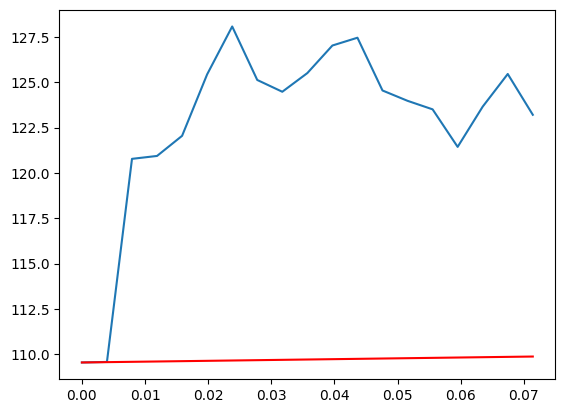

Stock = TMUS
S0 =  109.5500030518


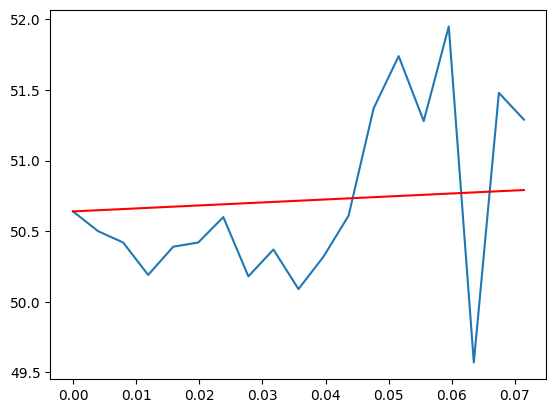

Stock = MO
S0 =  50.6399993896


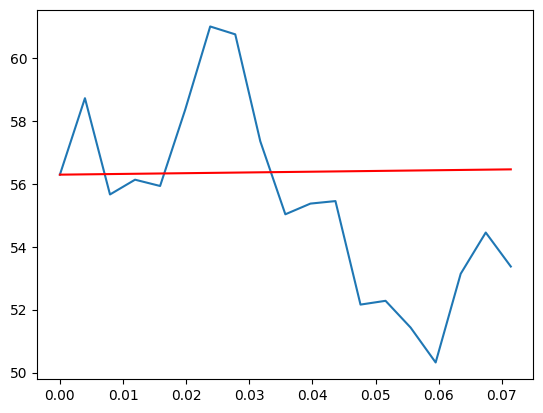

Stock = BBWI
S0 =  56.2900009155


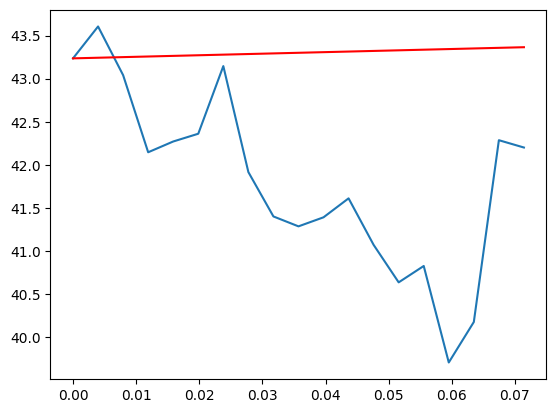

Stock = MNST
S0 =  43.2350006104


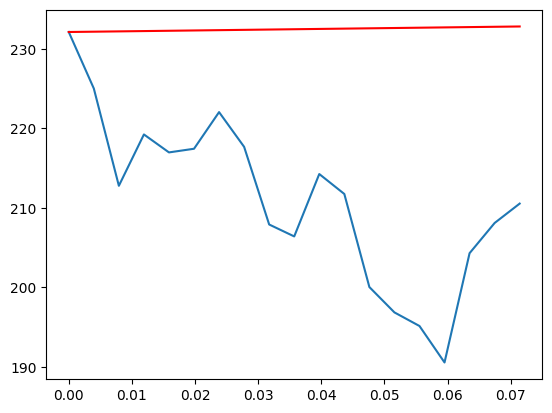

Stock = CRM
S0 =  232.1199951172


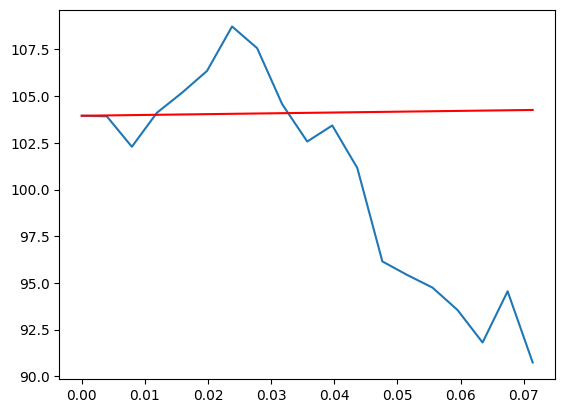

Stock = MS
S0 =  103.9499969482


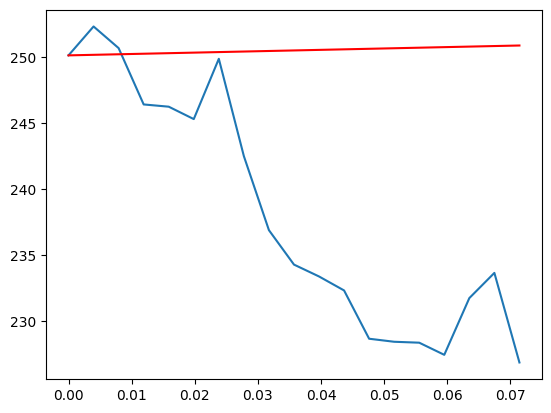

Stock = AMT
S0 =  250.1499938965


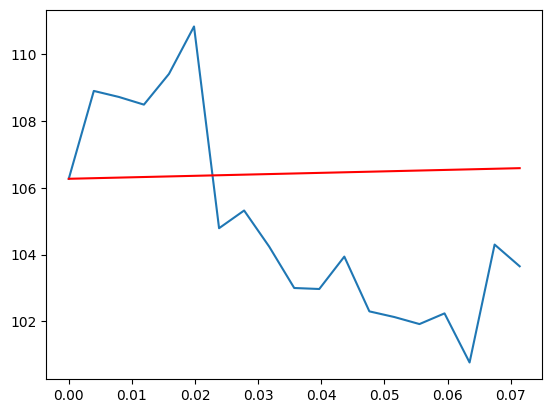

Stock = CVS
S0 =  106.2699966431


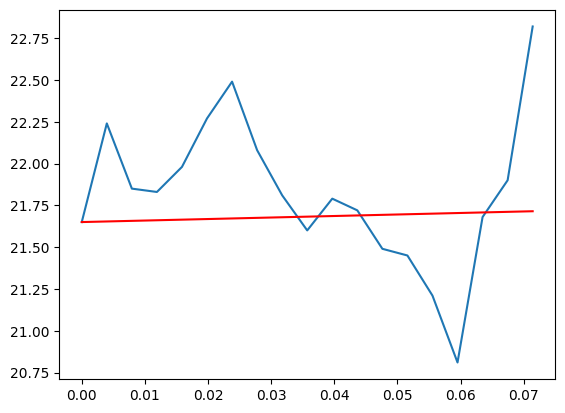

Stock = VST
S0 =  21.6499996185


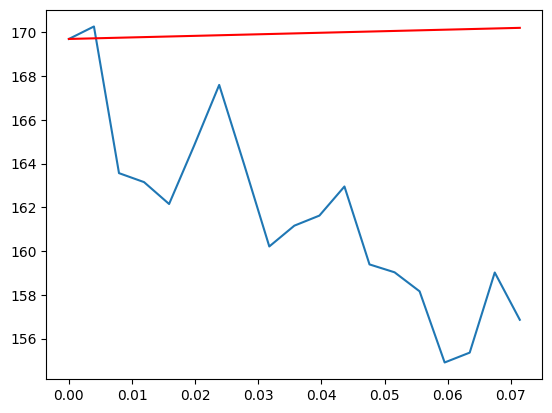

Stock = DOV
S0 =  169.6900024414


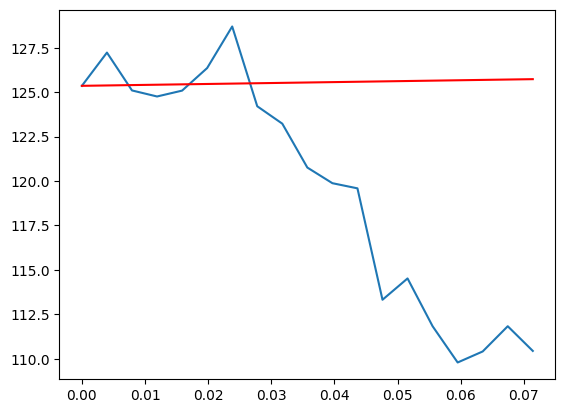

Stock = GRMN
S0 =  125.3600006104


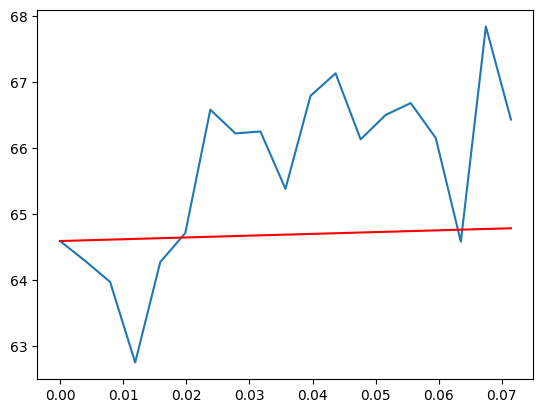

Stock = LW
S0 =  64.5899963379


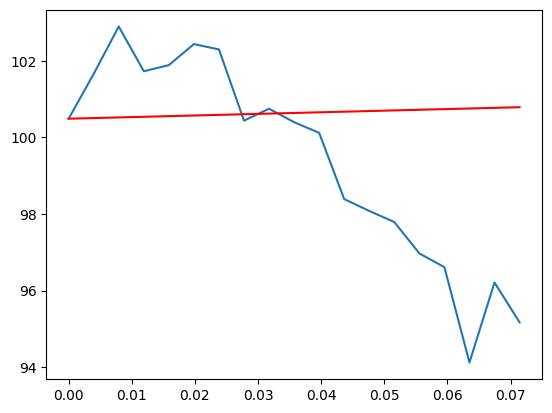

Stock = MKC
S0 =  100.4899978638


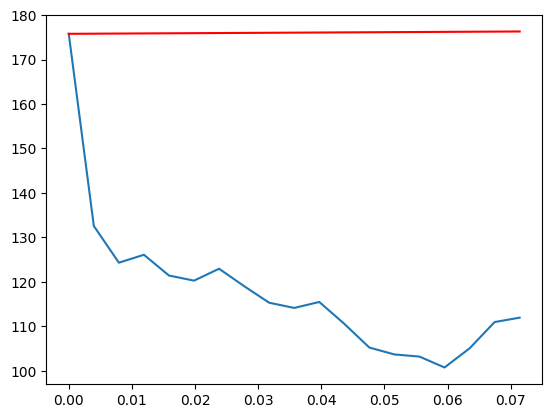

Stock = PYPL
S0 =  175.8000030518


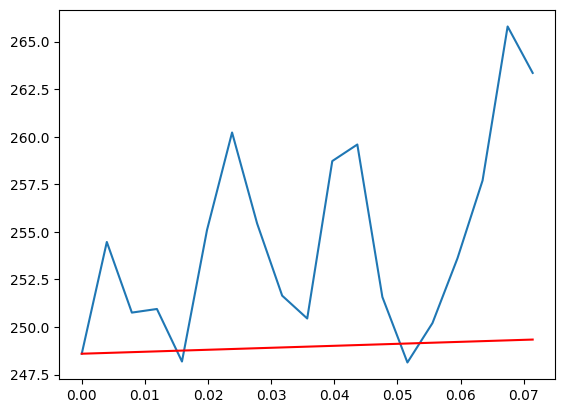

Stock = SYK
S0 =  248.6000061035


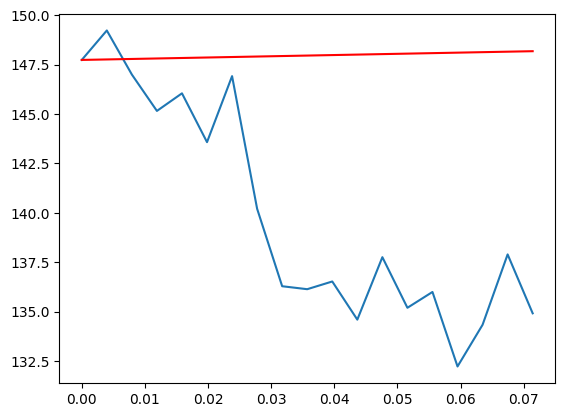

Stock = DLR
S0 =  147.7400054932


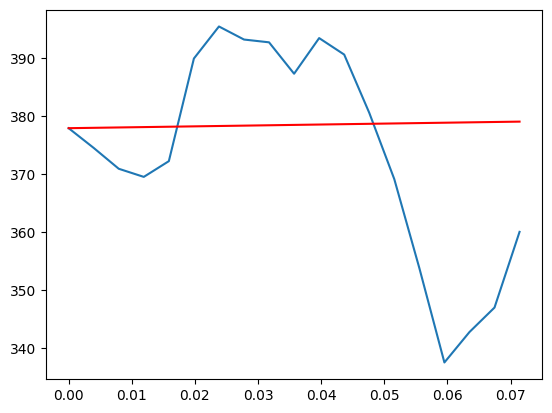

Stock = DE
S0 =  377.8800048828


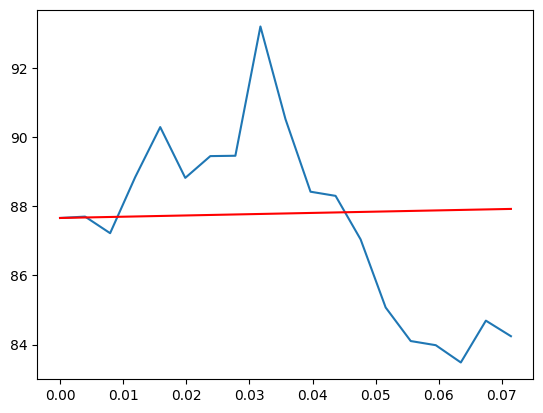

Stock = PSX
S0 =  87.6600036621


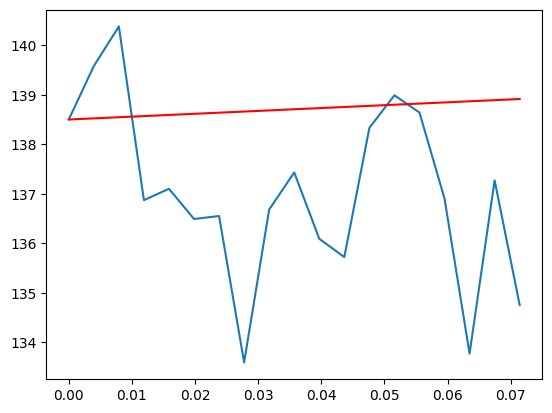

Stock = SJM
S0 =  138.5


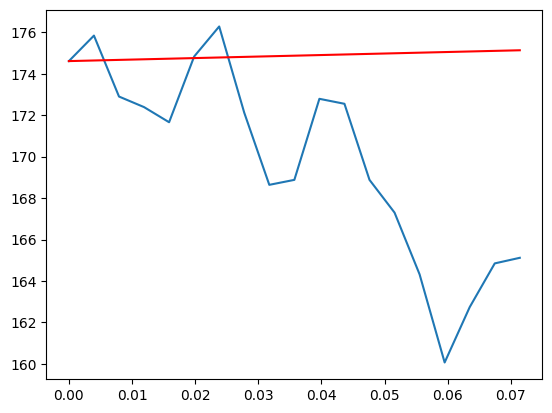

Stock = AAPL
S0 =  174.6100006104


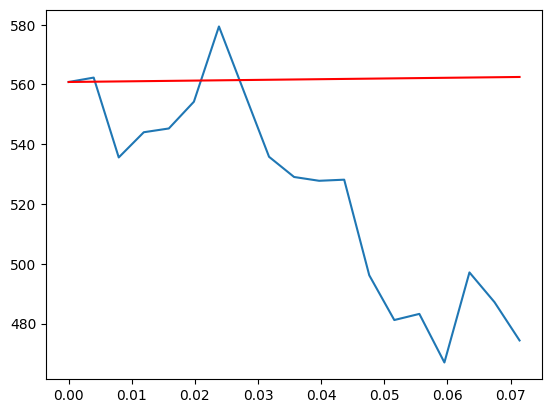

Stock = INTU
S0 =  560.8300170898


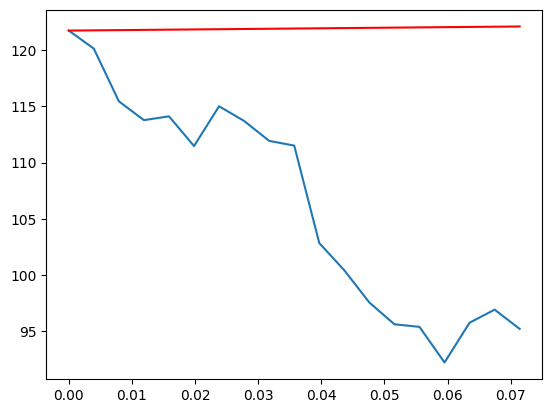

Stock = FIS
S0 =  121.7099990845


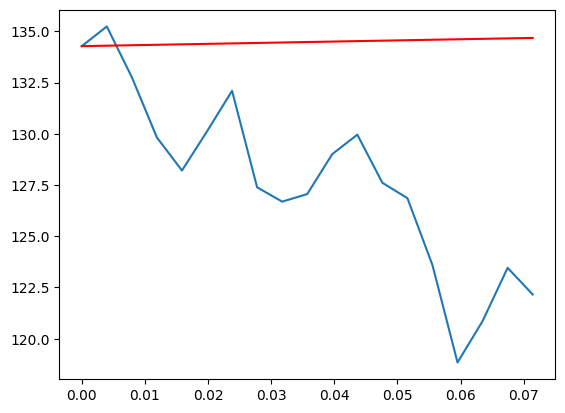

Stock = GPC
S0 =  134.2799987793


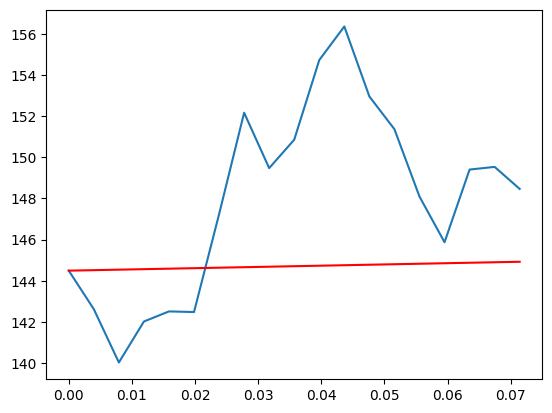

Stock = DIS
S0 =  144.4900054932


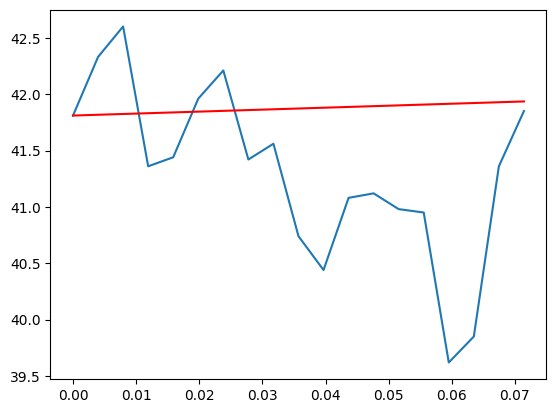

Stock = FE
S0 =  41.8100013733


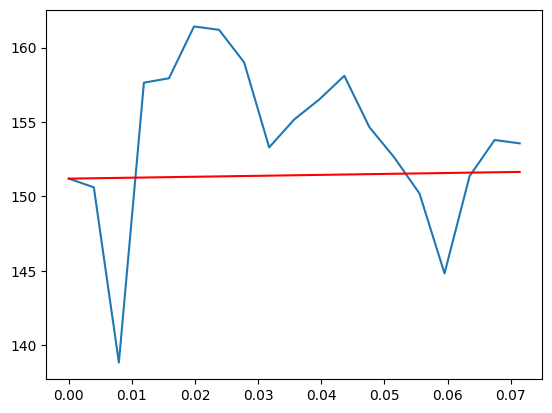

Stock = AMZN
S0 =  151.1934967041


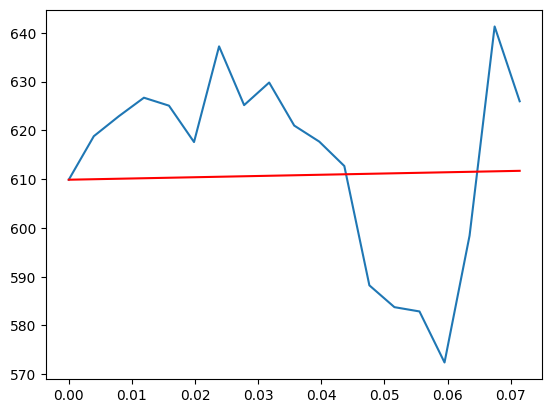

Stock = BIO
S0 =  609.8800048828


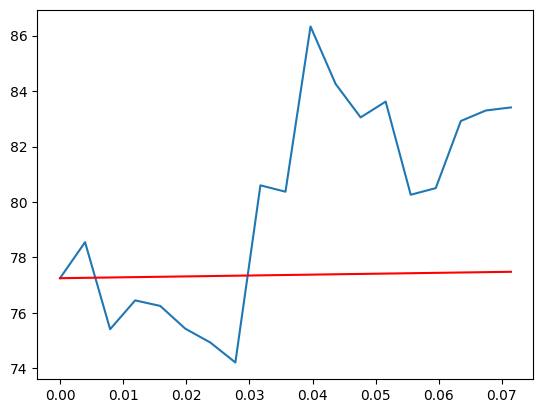

Stock = GDDY
S0 =  77.25


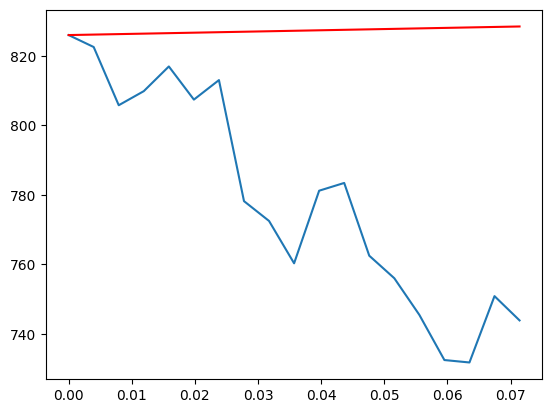

Stock = BLK
S0 =  825.950012207


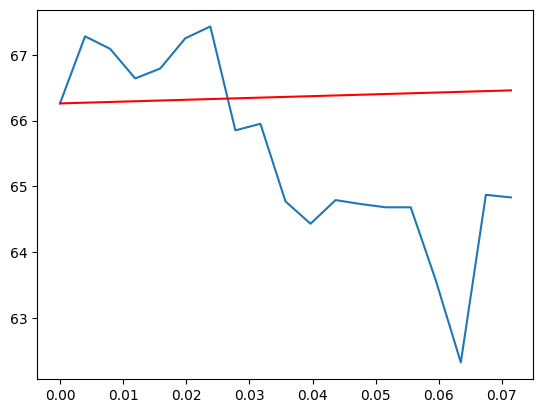

Stock = PEG
S0 =  66.2600021362


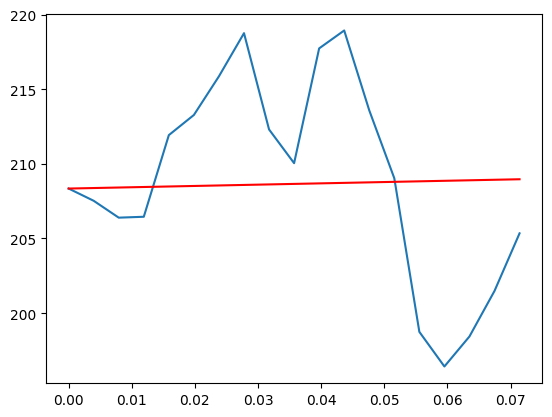

Stock = BA
S0 =  208.3399963379


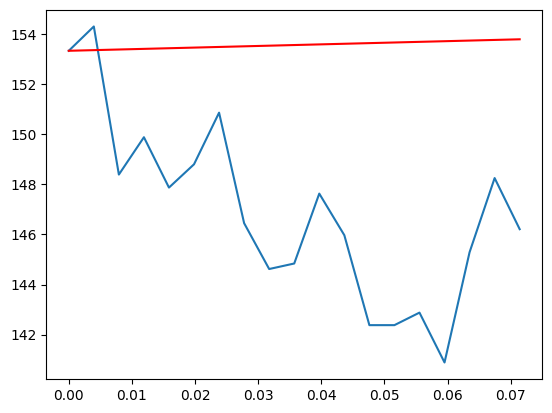

Stock = BR
S0 =  153.3300018311


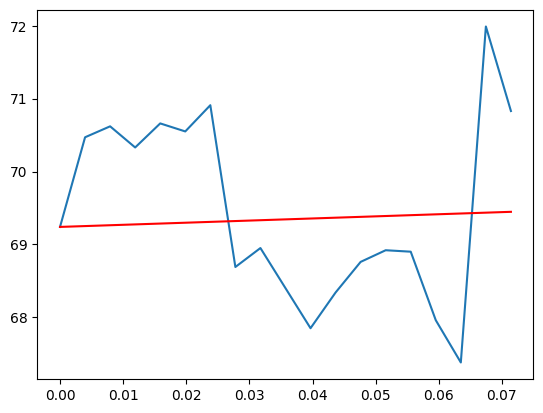

Stock = PNW
S0 =  69.2399978638


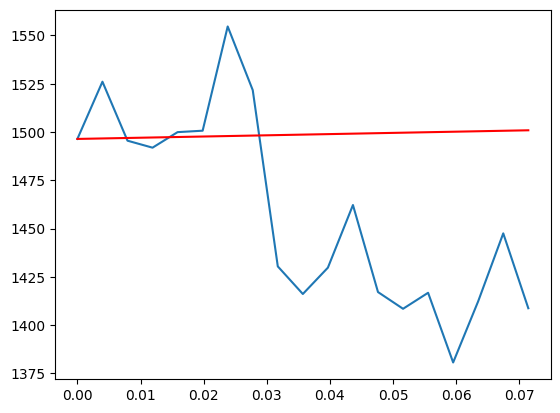

Stock = MTD
S0 =  1496.4300537109


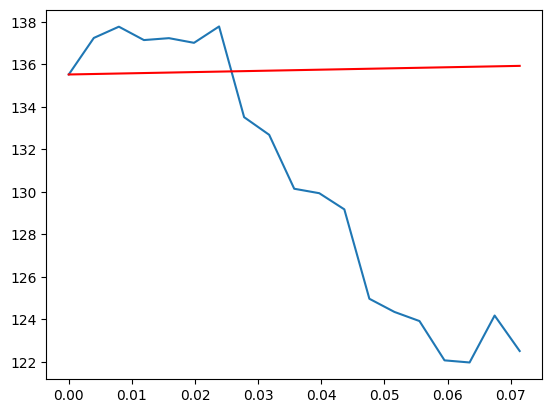

Stock = IBM
S0 =  135.5299987793


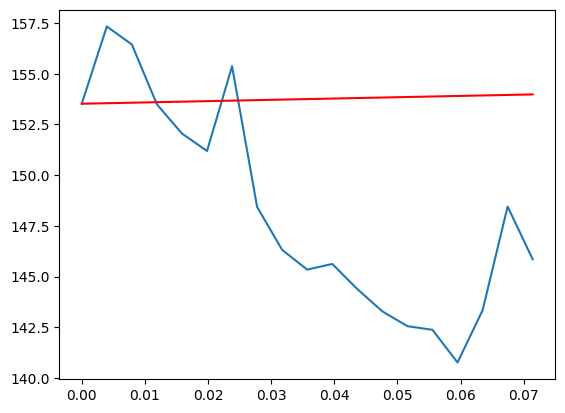

Stock = PLD
S0 =  153.5200042725


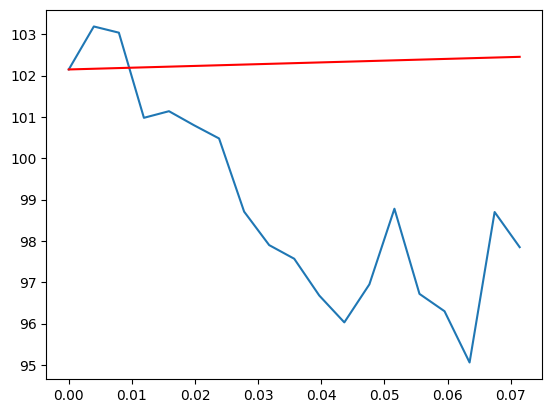

Stock = CHD
S0 =  102.1500015259


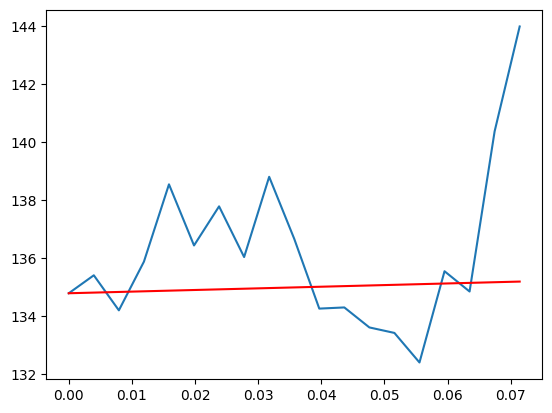

Stock = CVX
S0 =  134.7899932861


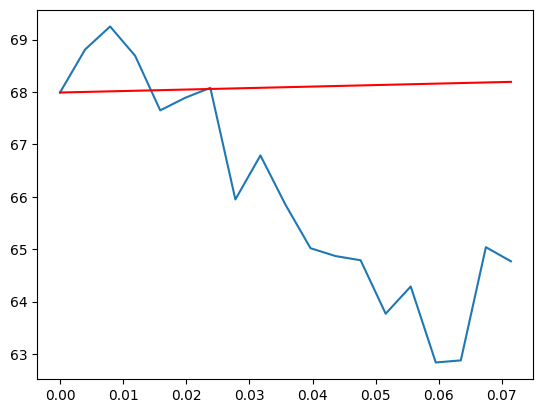

Stock = SO
S0 =  67.9899978638


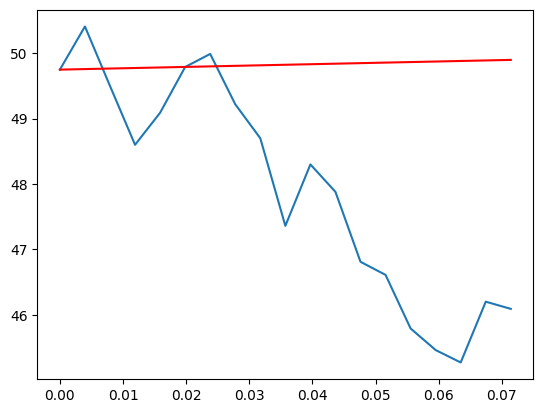

Stock = WBA
S0 =  49.75


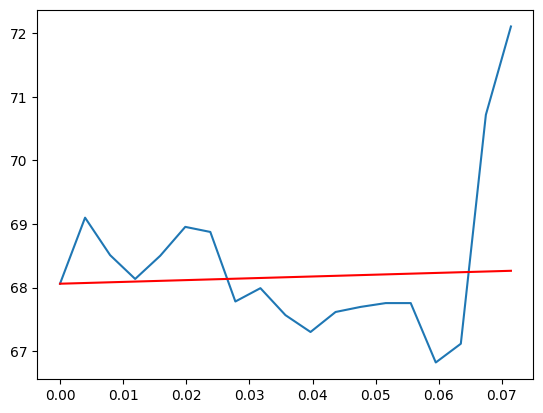

Stock = SRE
S0 =  68.0599975586


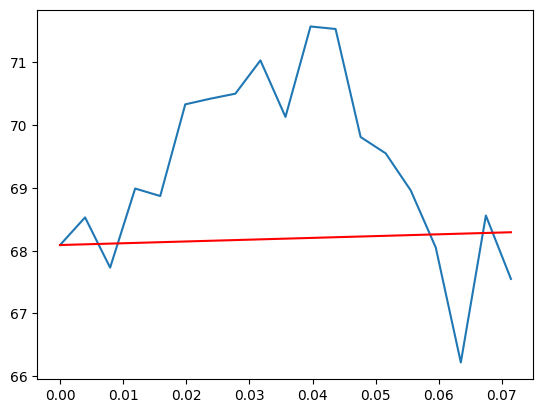

Stock = MET
S0 =  68.0899963379


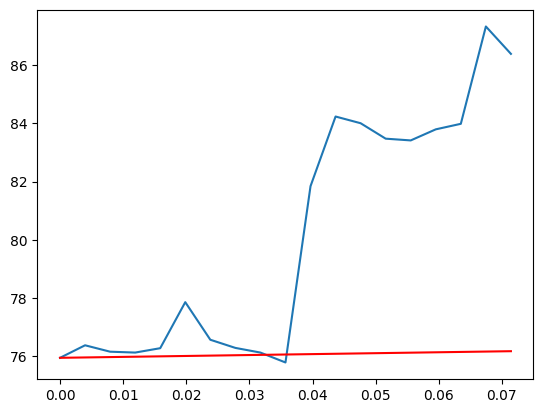

Stock = HSIC
S0 =  75.9499969482


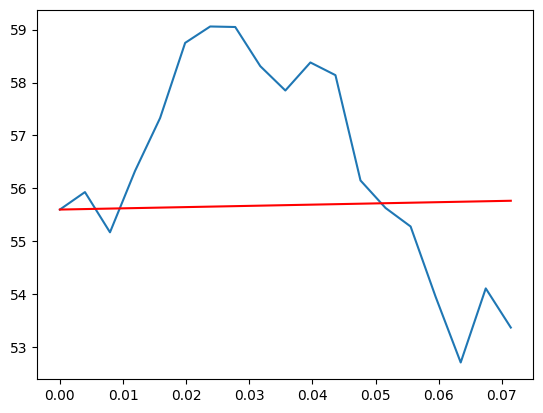

Stock = WFC
S0 =  55.5999984741


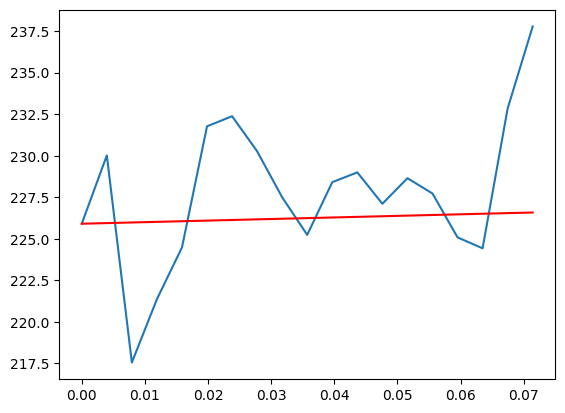

Stock = CI
S0 =  225.9100036621


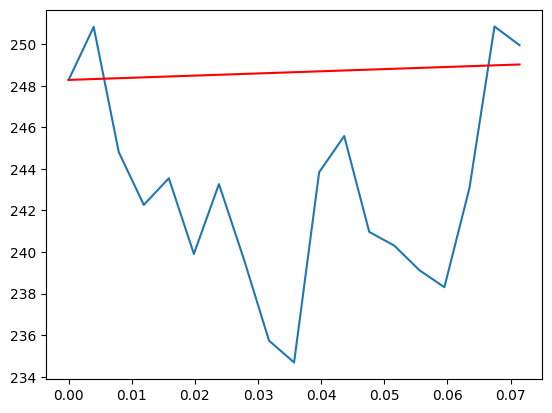

Stock = LLY
S0 =  248.2799987793


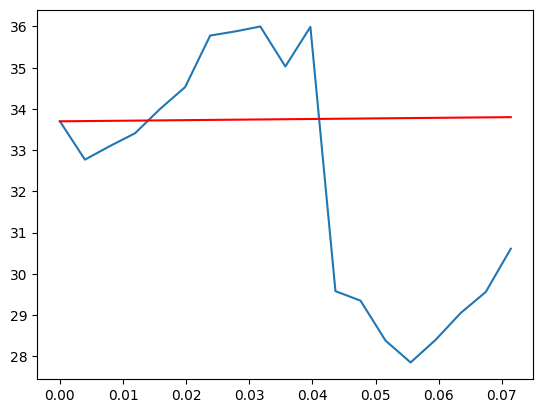

Stock = PARA
S0 =  33.7000007629


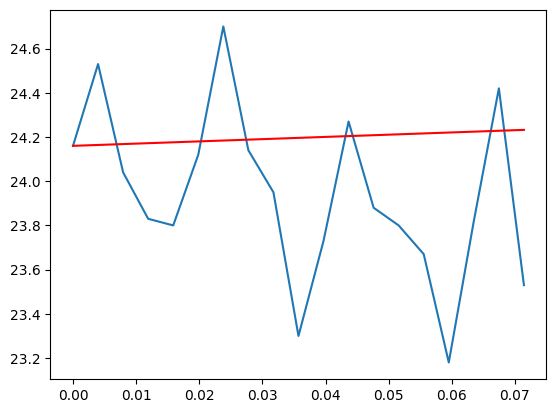

Stock = KIM
S0 =  24.1599998474


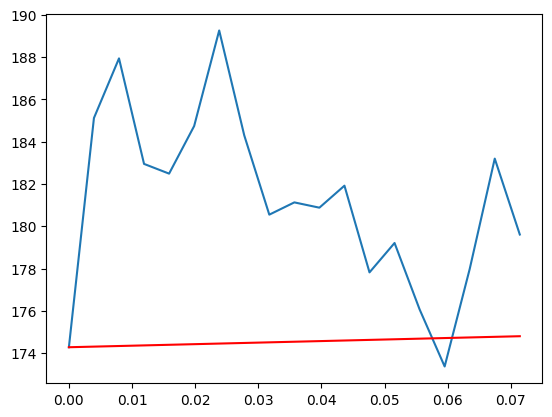

Stock = RVTY
S0 =  174.2799987793


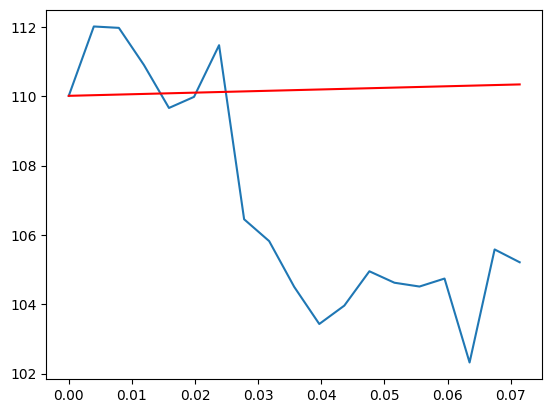

Stock = ETR
S0 =  110.0100021362


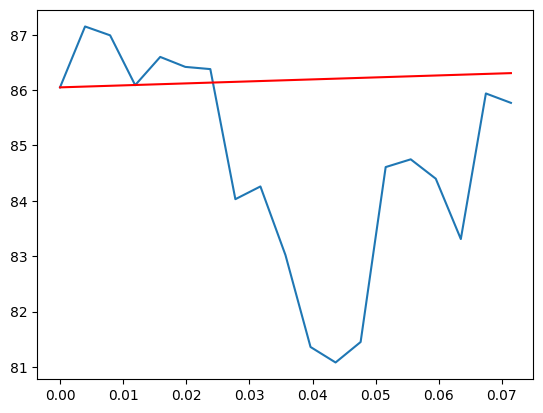

Stock = ED
S0 =  86.0500030518


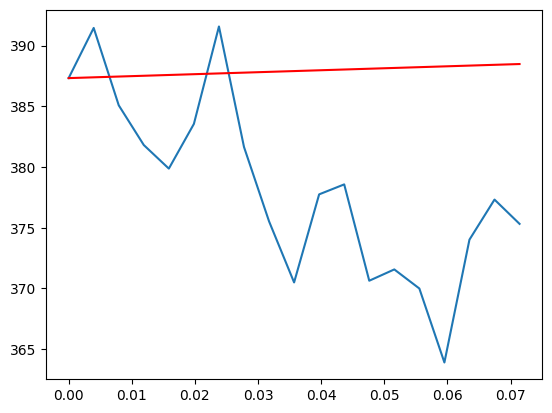

Stock = CTAS
S0 =  387.3200073242


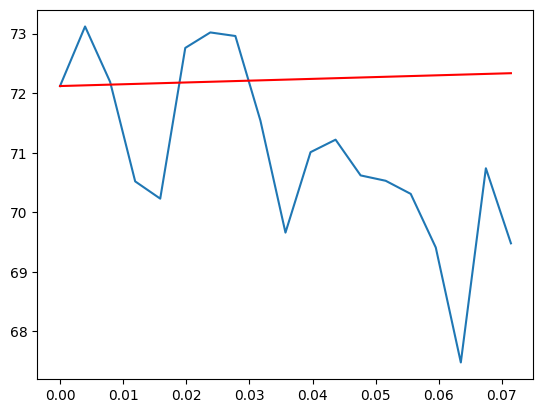

Stock = HIG
S0 =  72.1200027466


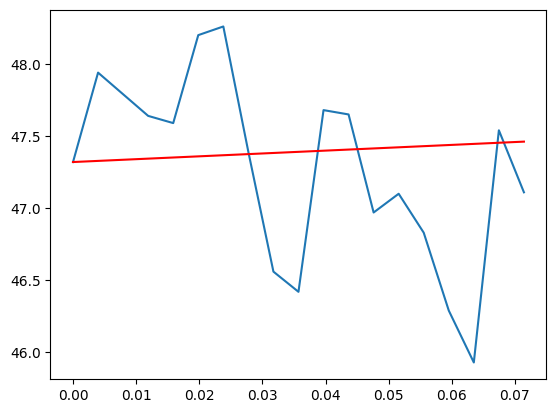

Stock = ACGL
S0 =  47.3199996948


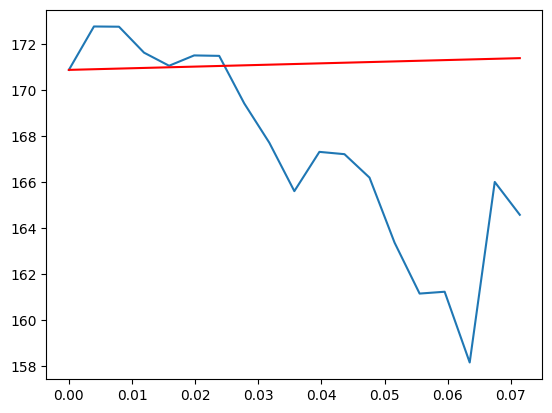

Stock = JNJ
S0 =  170.8800048828


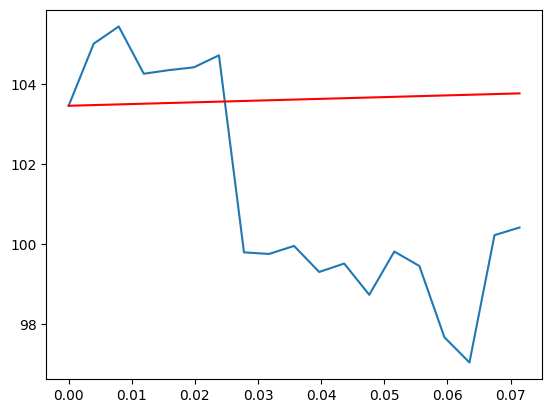

Stock = DUK
S0 =  103.4499969482


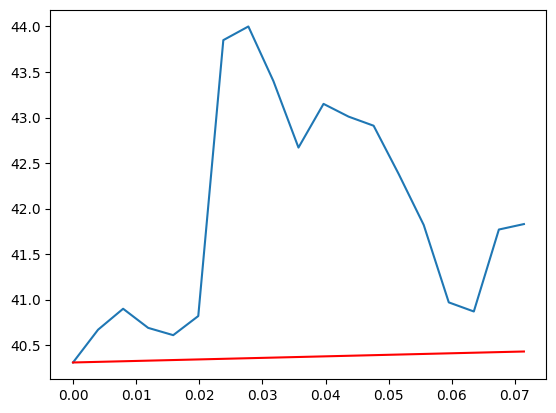

Stock = FOXA
S0 =  40.3100013733


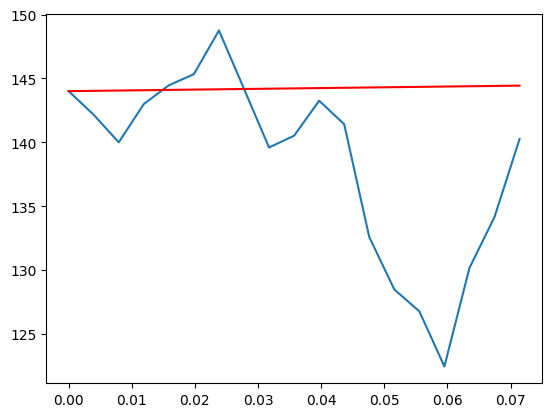

Stock = AXON
S0 =  144.0


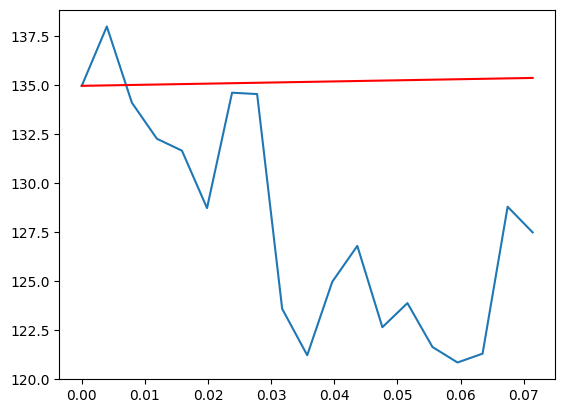

Stock = BX
S0 =  134.9499969482


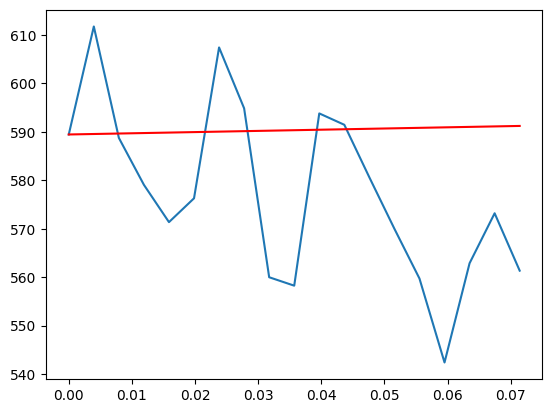

Stock = LRCX
S0 =  589.4699707031


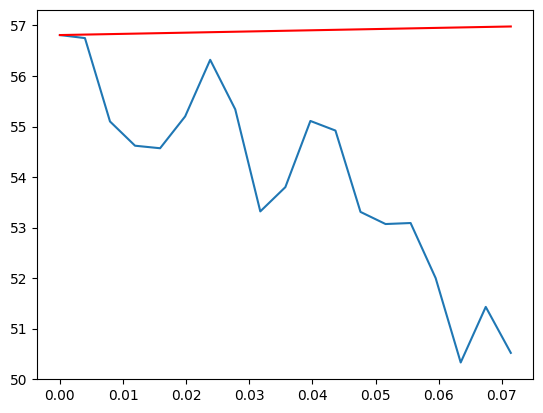

Stock = IR
S0 =  56.8100013733


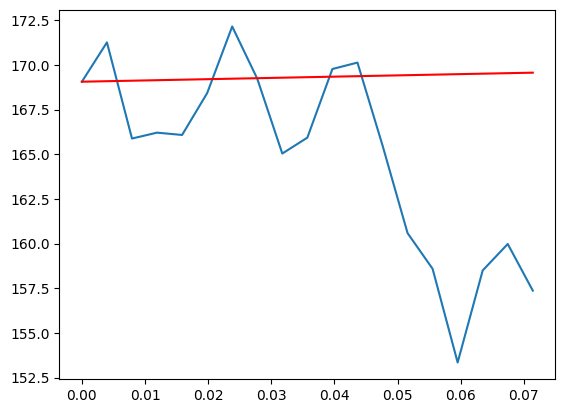

Stock = KEYS
S0 =  169.0599975586


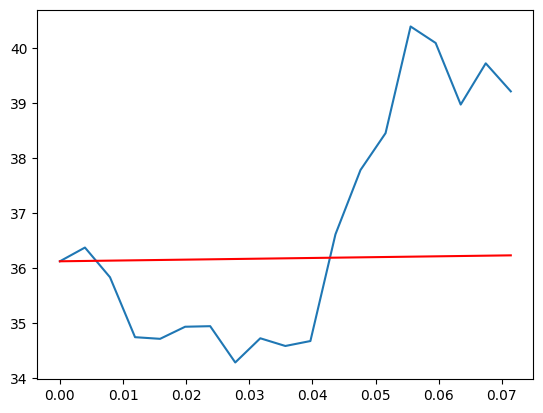

Stock = KHC
S0 =  36.1300010681


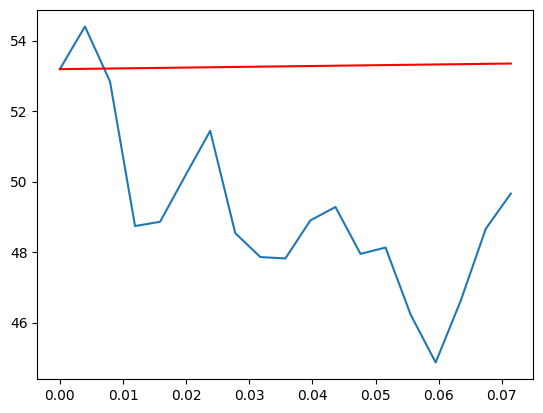

Stock = PHM
S0 =  53.1899986267


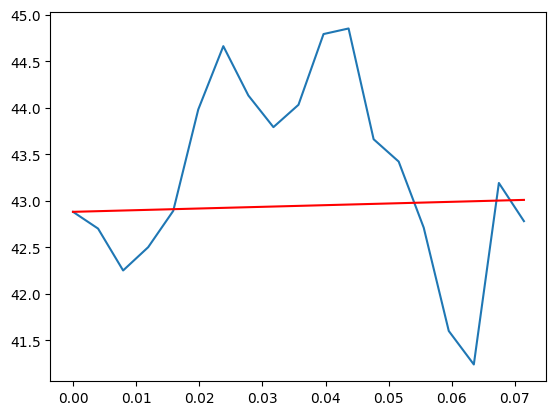

Stock = SYF
S0 =  42.8800010681


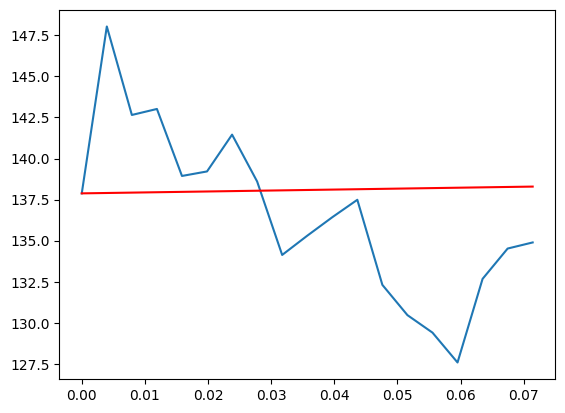

Stock = GOOG
S0 =  137.8784942627


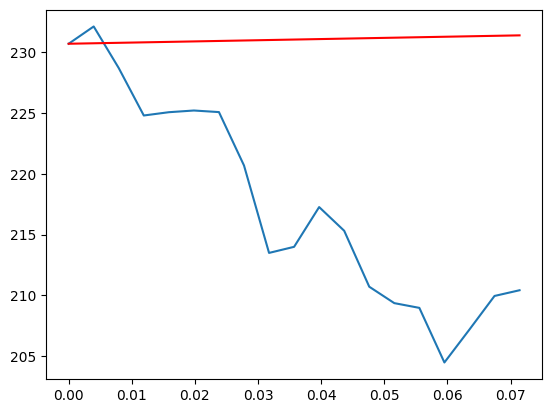

Stock = UPS
S0 =  230.6900024414


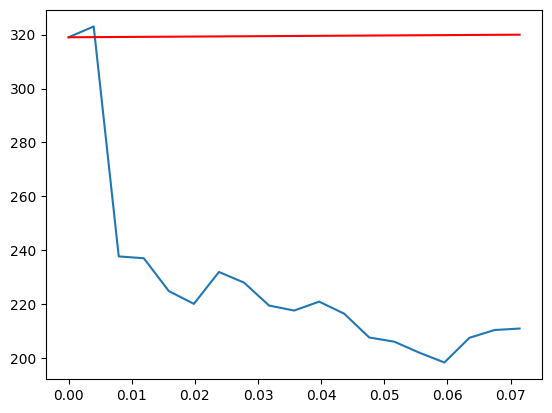

Stock = META
S0 =  319.0


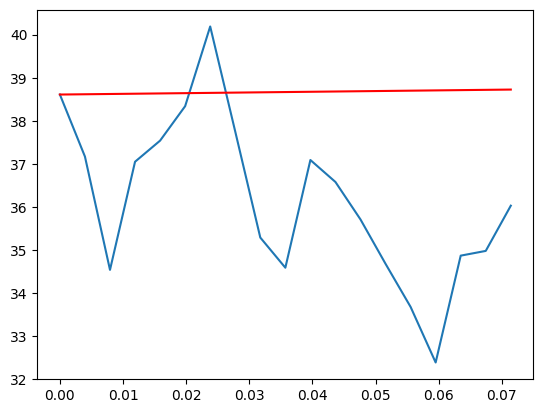

Stock = UBER
S0 =  38.6100006104


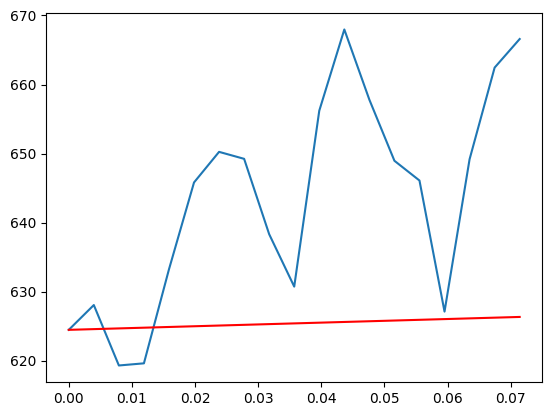

Stock = TDG
S0 =  624.4799804688


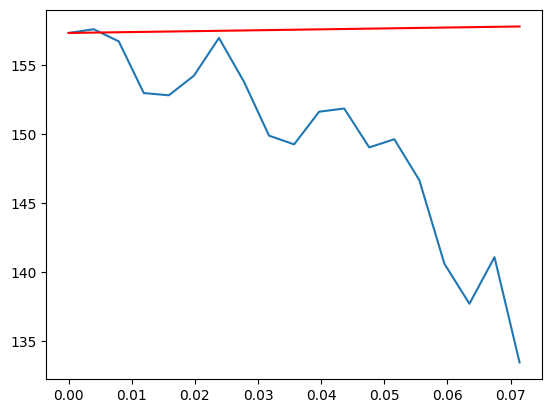

Stock = PPG
S0 =  157.3500061035


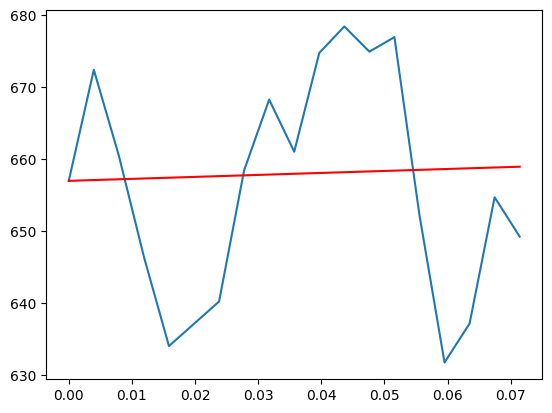

Stock = ORLY
S0 =  656.9899902344


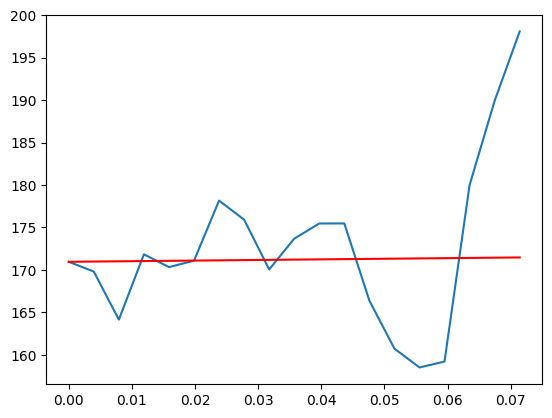

Stock = PANW
S0 =  170.953338623


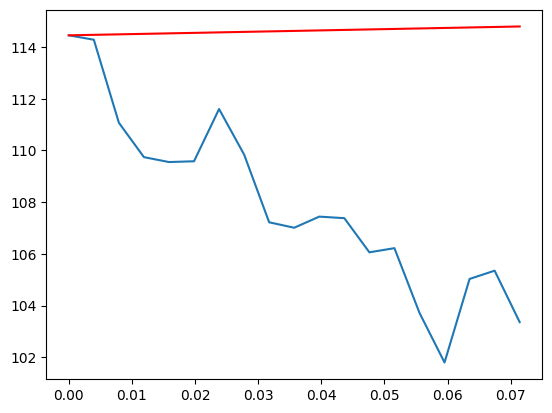

Stock = EXPD
S0 =  114.4499969482


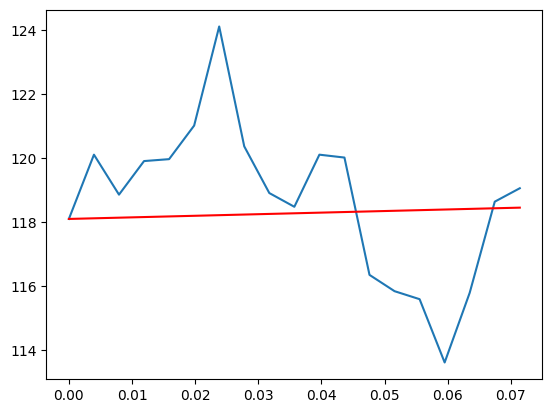

Stock = PAYX
S0 =  118.0999984741


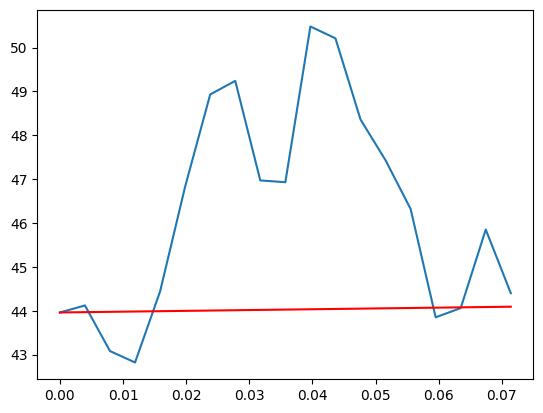

Stock = UAL
S0 =  43.9599990845


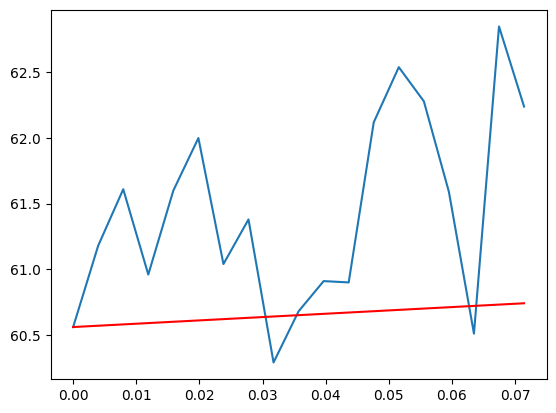

Stock = KO
S0 =  60.5600013733


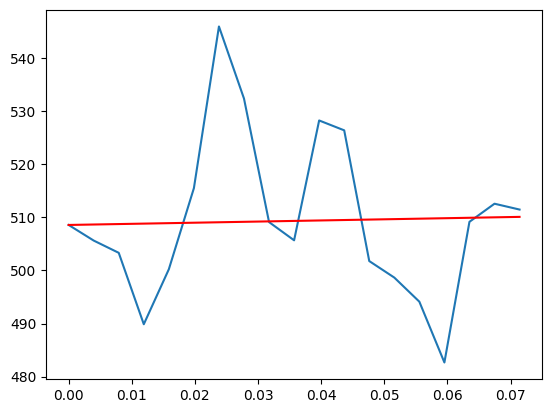

Stock = ALGN
S0 =  508.5599975586


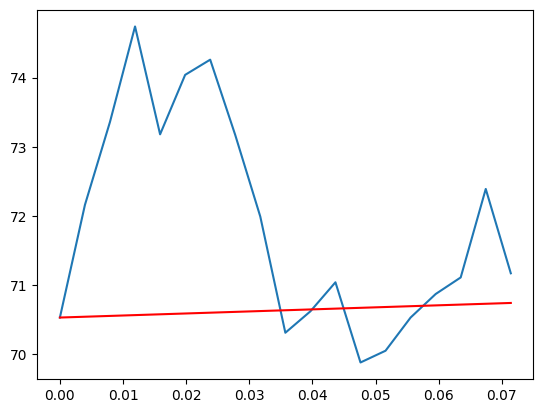

Stock = HOLX
S0 =  70.5299987793


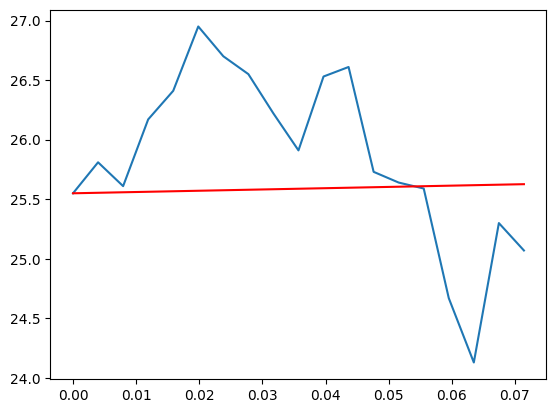

Stock = KEY
S0 =  25.5499992371


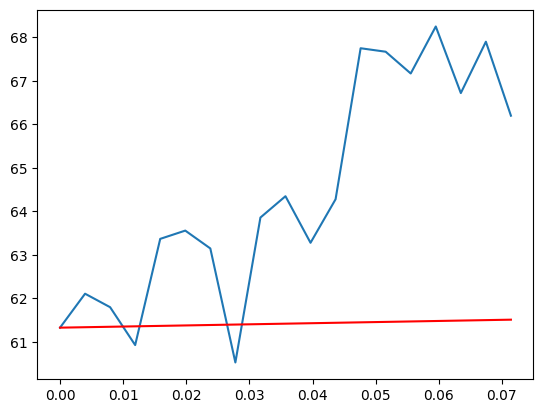

Stock = NEM
S0 =  61.3300018311


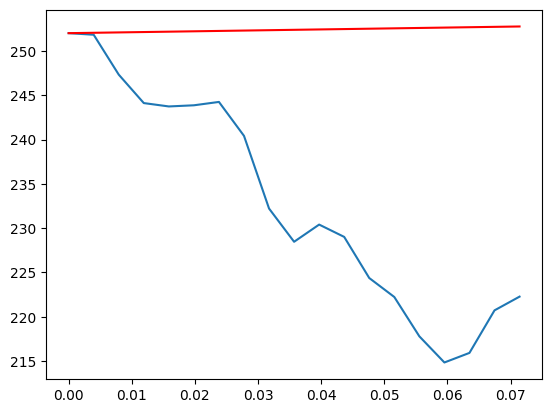

Stock = FDX
S0 =  252.0


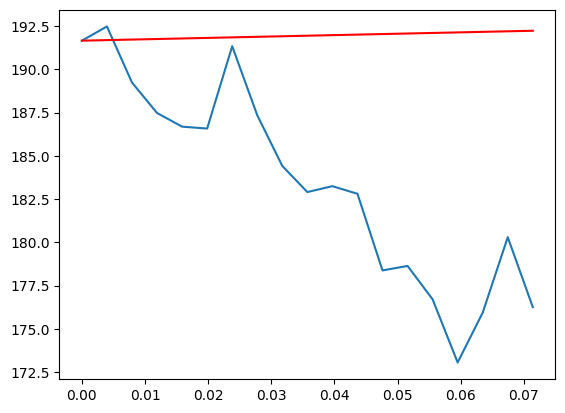

Stock = ECL
S0 =  191.6600036621


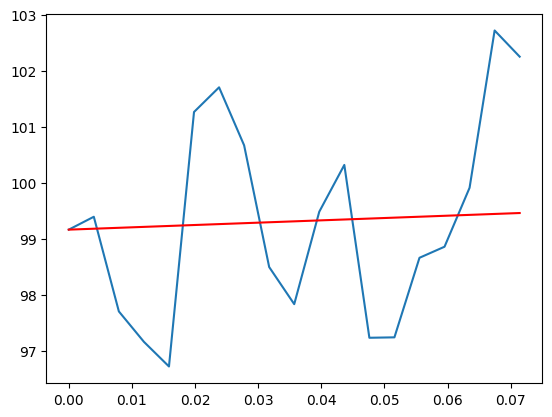

Stock = COO
S0 =  99.1675033569


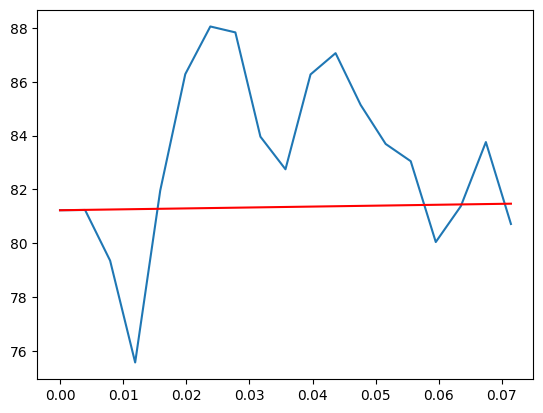

Stock = RCL
S0 =  81.2300033569


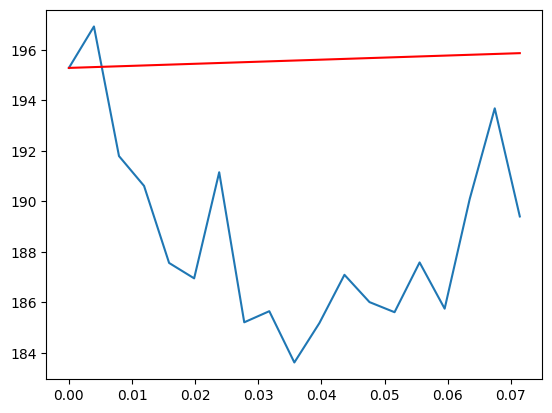

Stock = ARE
S0 =  195.2799987793


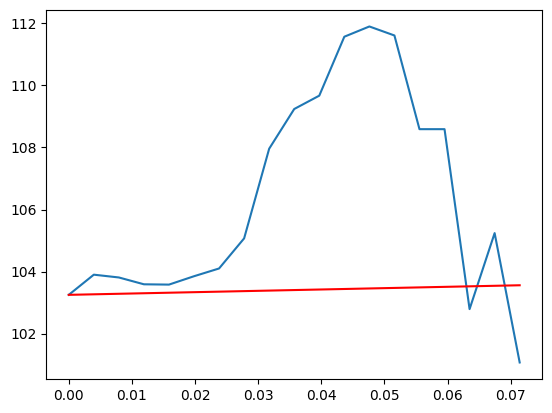

Stock = PM
S0 =  103.25


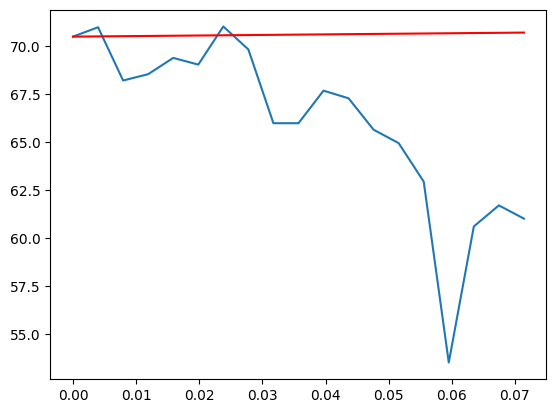

Stock = CSGP
S0 =  70.5100021362


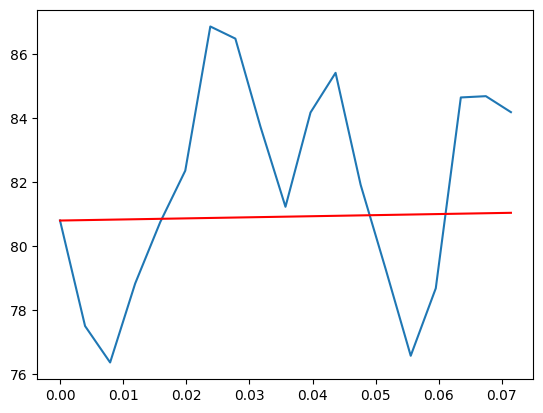

Stock = CZR
S0 =  80.8000030518


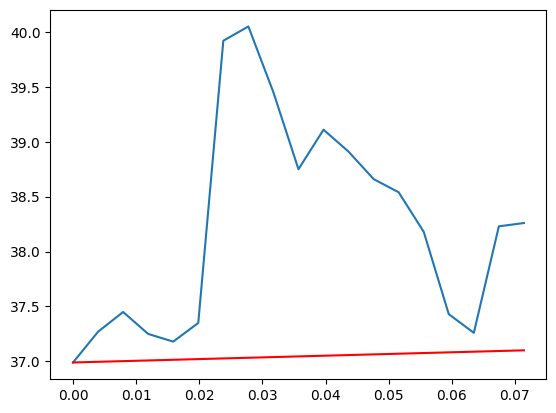

Stock = FOX
S0 =  36.9900016785


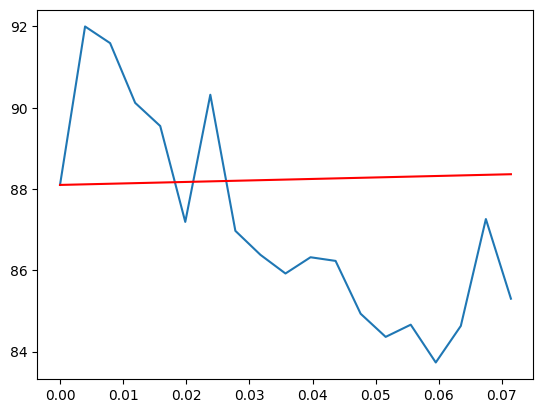

Stock = EQR
S0 =  88.0999984741


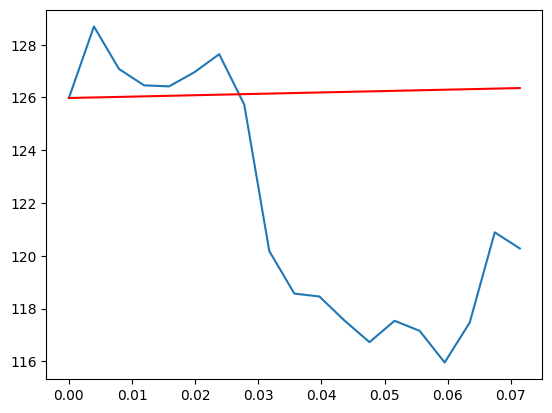

Stock = RSG
S0 =  125.9800033569


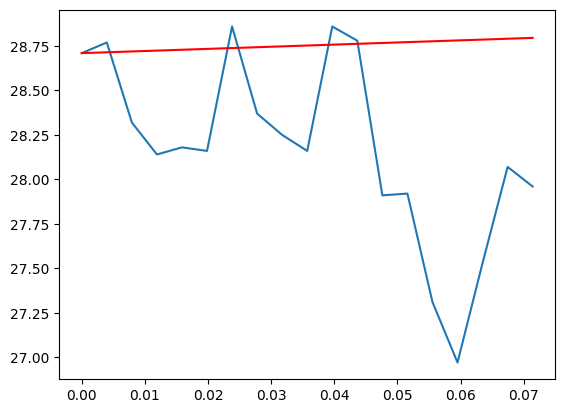

Stock = VICI
S0 =  28.7099990845


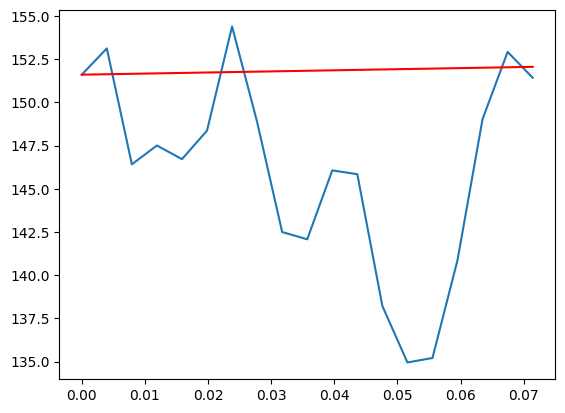

Stock = CDNS
S0 =  151.6100006104


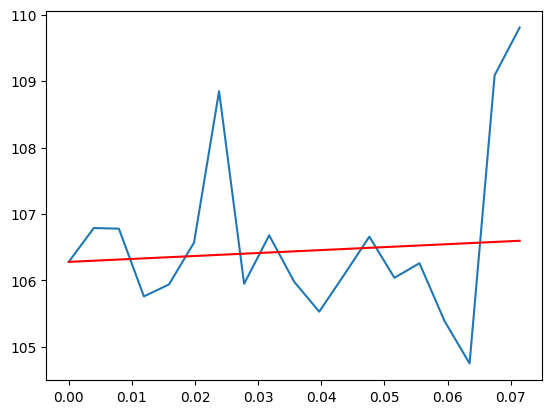

Stock = ATO
S0 =  106.2799987793


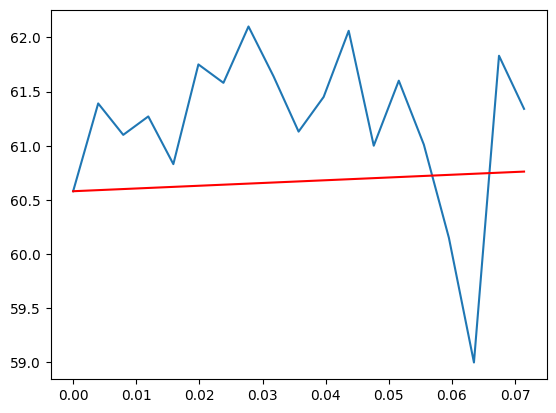

Stock = L
S0 =  60.5800018311


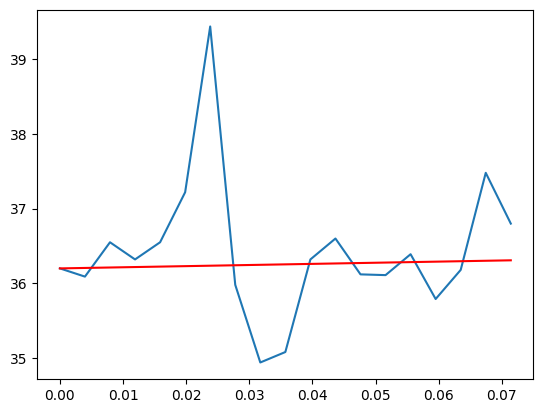

Stock = IPG
S0 =  36.2000007629


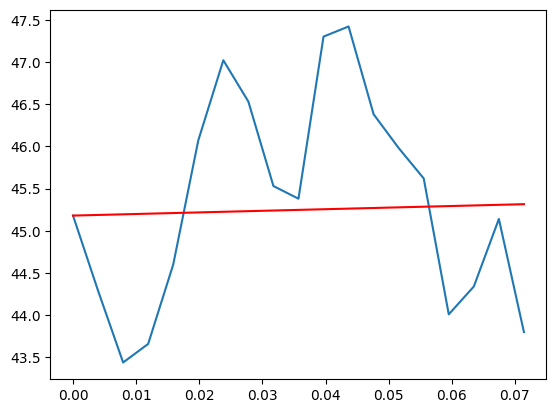

Stock = LUV
S0 =  45.1800003052


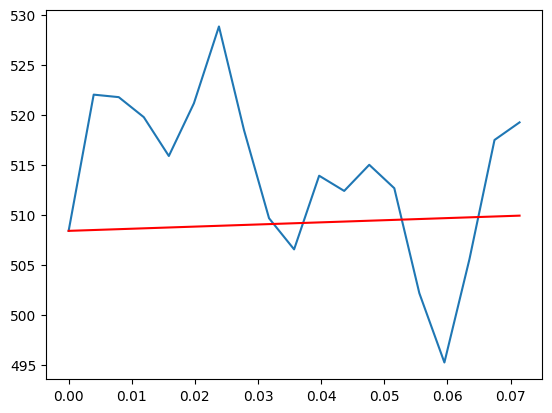

Stock = COST
S0 =  508.4100036621


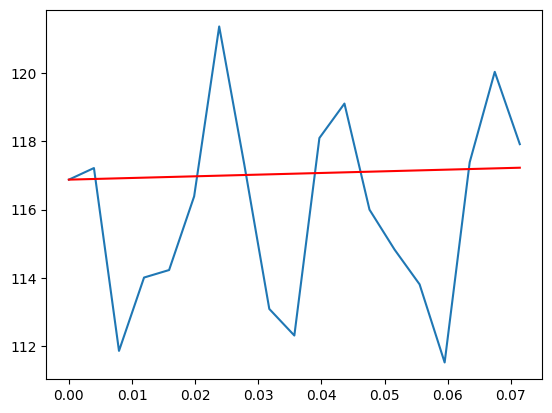

Stock = TER
S0 =  116.8799972534


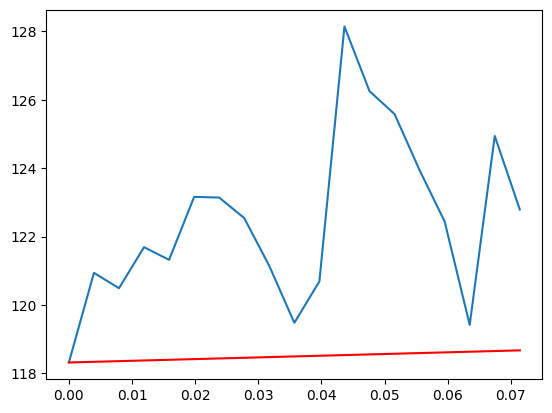

Stock = CINF
S0 =  118.3199996948


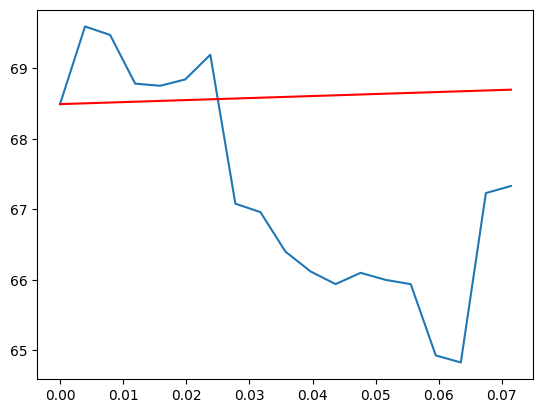

Stock = XEL
S0 =  68.4899978638


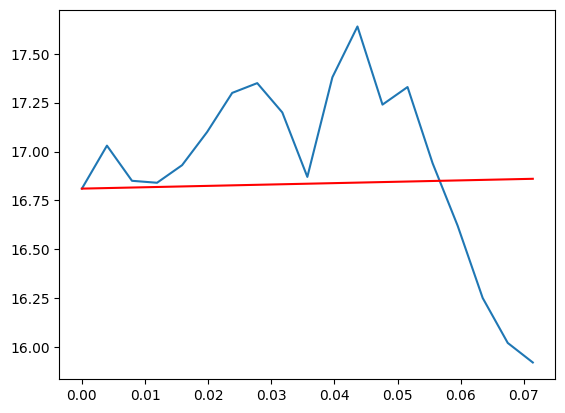

Stock = HPE
S0 =  16.8099994659


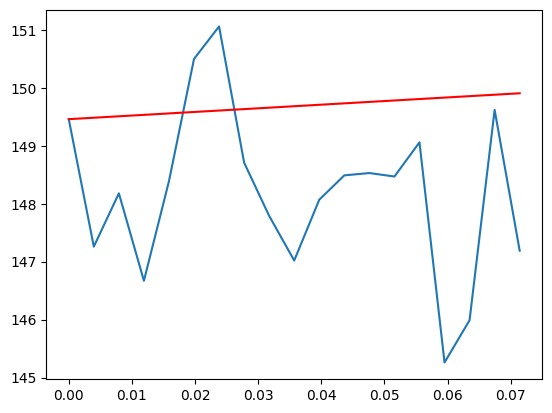

Stock = PKG
S0 =  149.4600067139


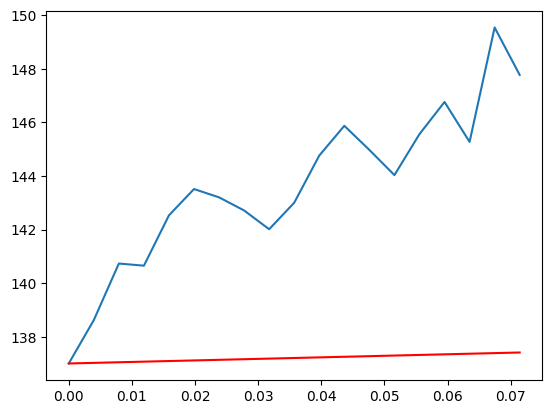

Stock = ABBV
S0 =  137.0


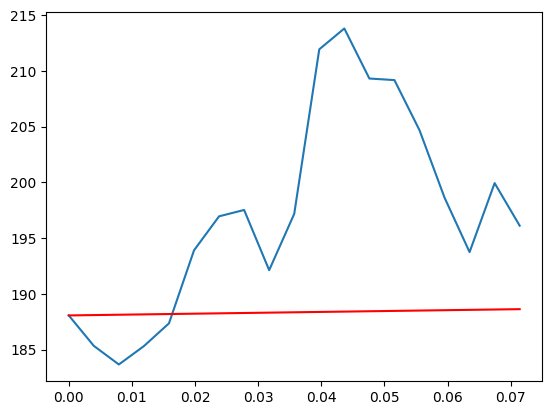

Stock = EXPE
S0 =  188.0599975586


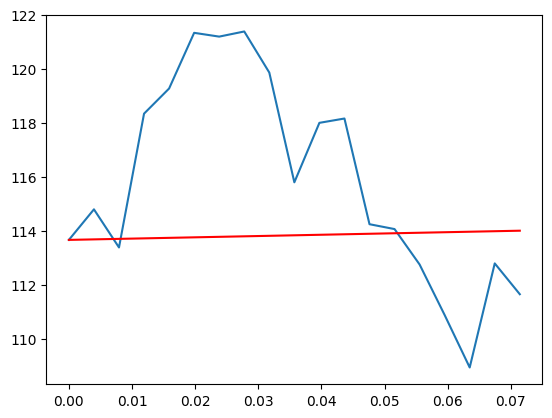

Stock = PRU
S0 =  113.6699981689


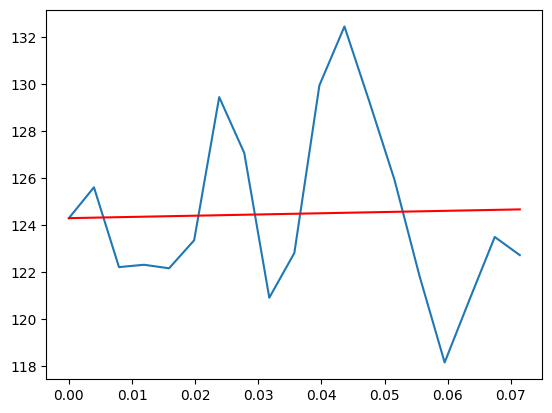

Stock = ANET
S0 =  124.3000030518


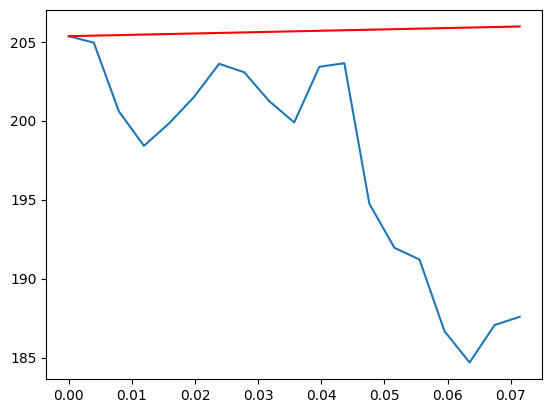

Stock = CAT
S0 =  205.3500061035


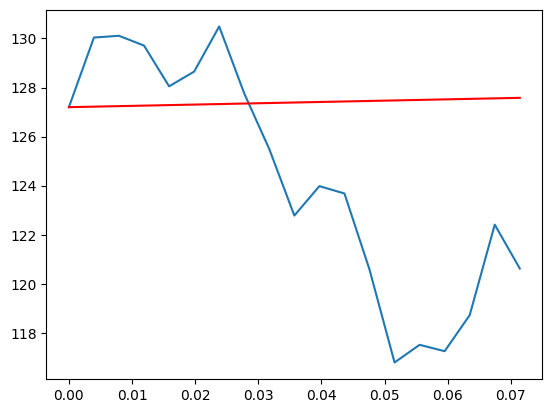

Stock = ABT
S0 =  127.1999969482


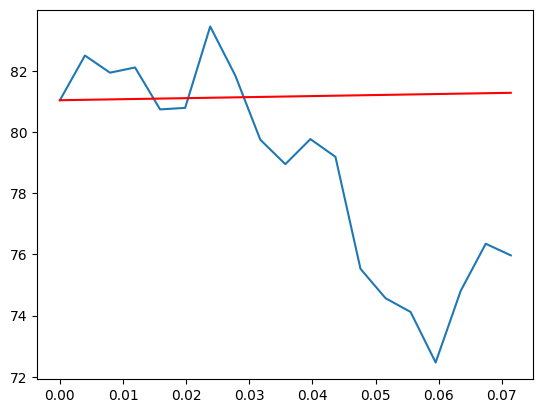

Stock = ORCL
S0 =  81.0400009155


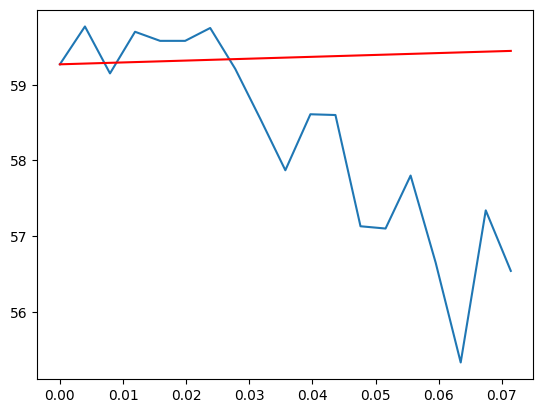

Stock = USB
S0 =  59.2700004578


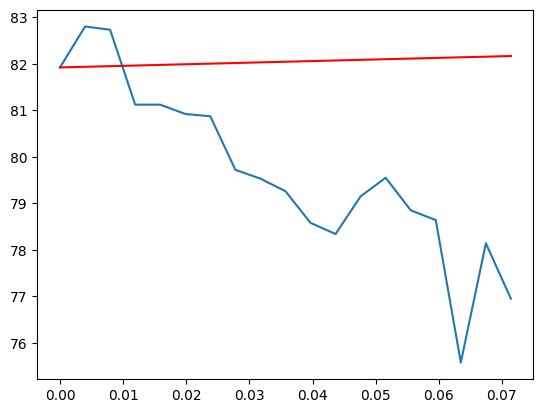

Stock = CL
S0 =  81.9199981689


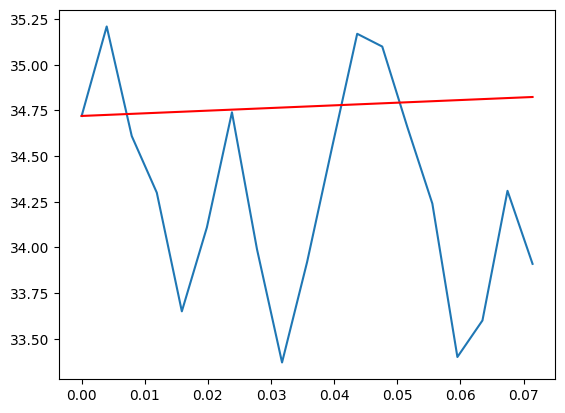

Stock = CSX
S0 =  34.7200012207


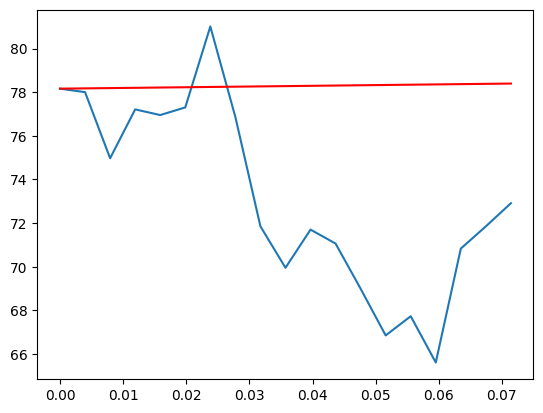

Stock = DAY
S0 =  78.1600036621


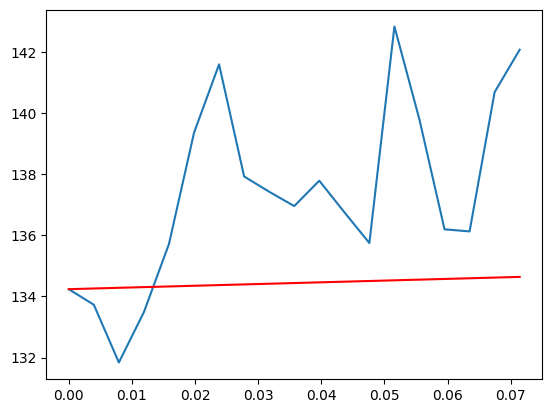

Stock = DLTR
S0 =  134.2400054932


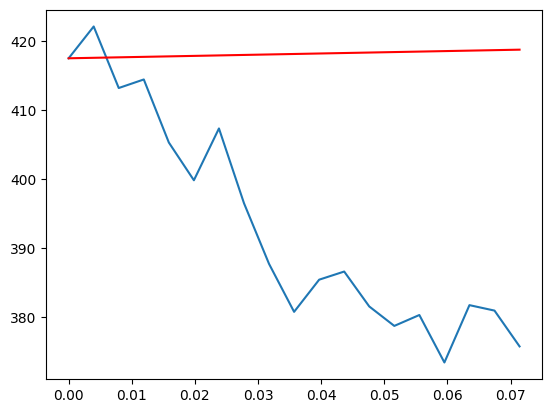

Stock = SPGI
S0 =  417.4599914551


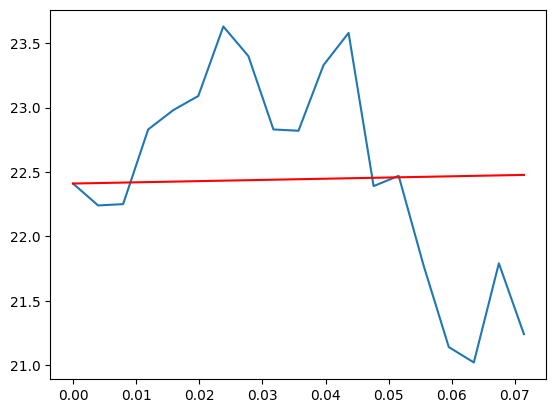

Stock = IVZ
S0 =  22.4099998474


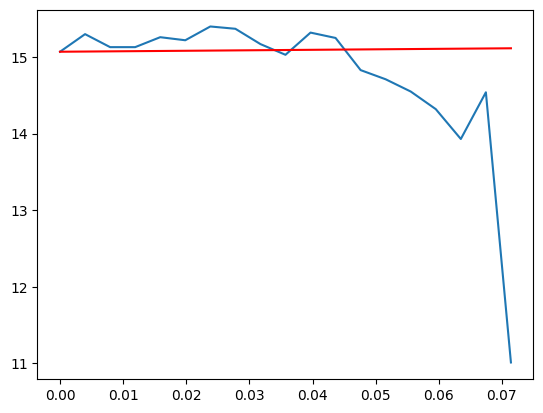

Stock = VTRS
S0 =  15.0699996948


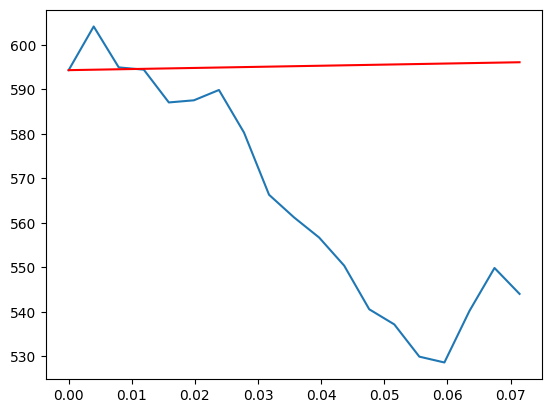

Stock = TMO
S0 =  594.3099975586


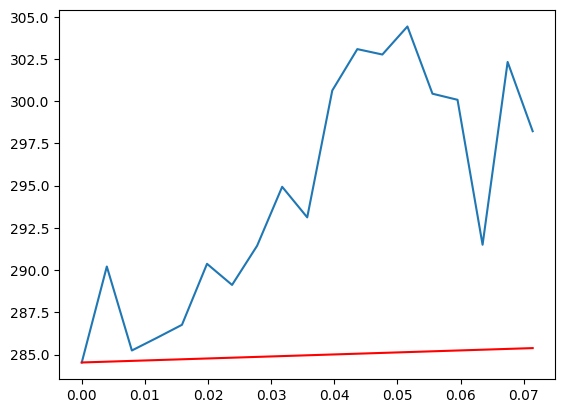

Stock = EG
S0 =  284.5299987793


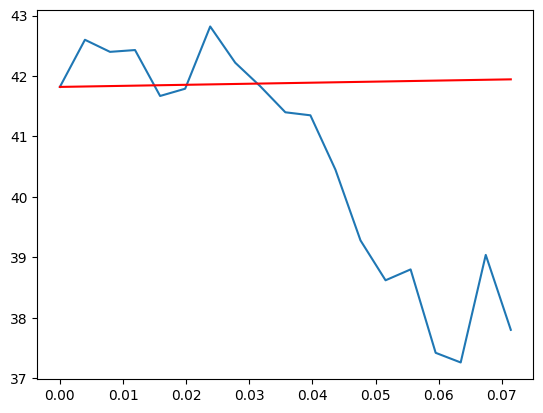

Stock = INVH
S0 =  41.8199996948


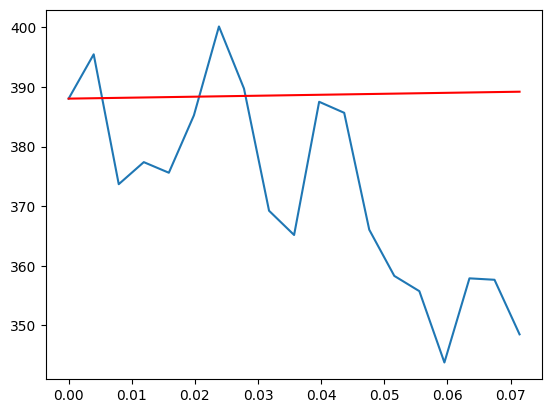

Stock = KLAC
S0 =  388.0299987793


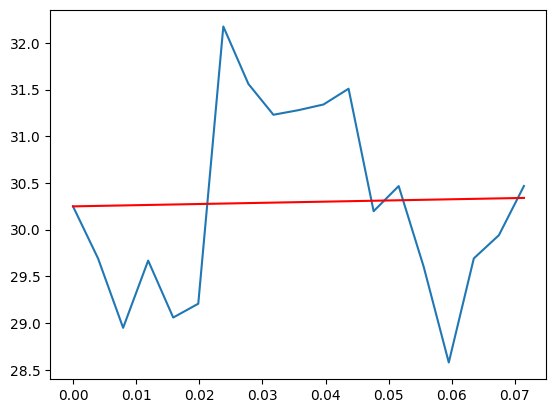

Stock = CMG
S0 =  30.2490005493


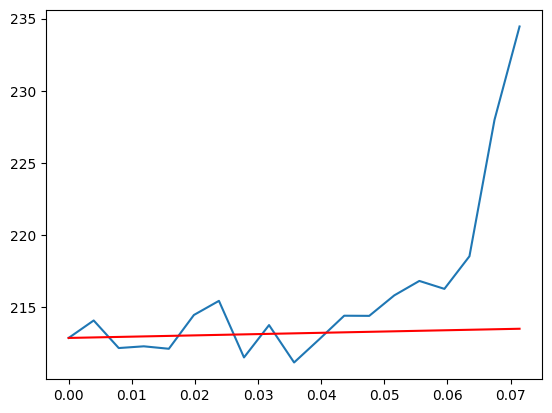

Stock = GD
S0 =  212.8699951172


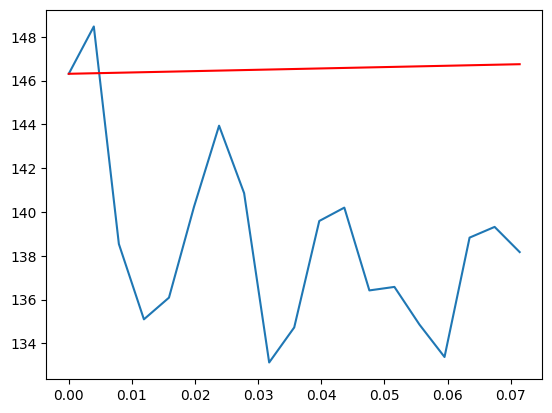

Stock = SWKS
S0 =  146.3099975586


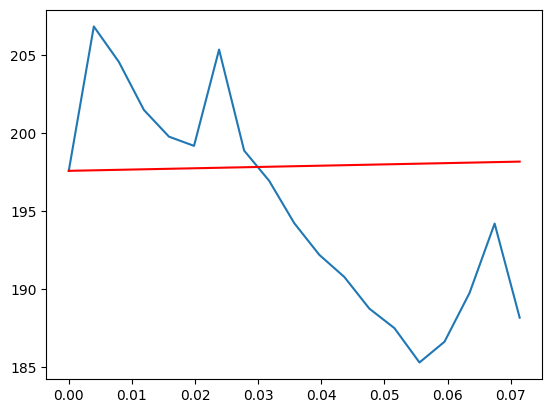

Stock = EXR
S0 =  197.5599975586


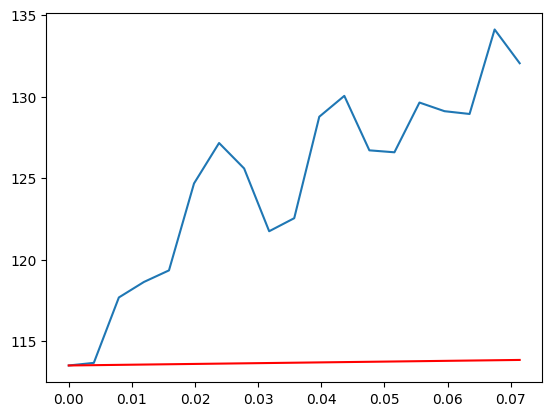

Stock = RL
S0 =  113.5100021362


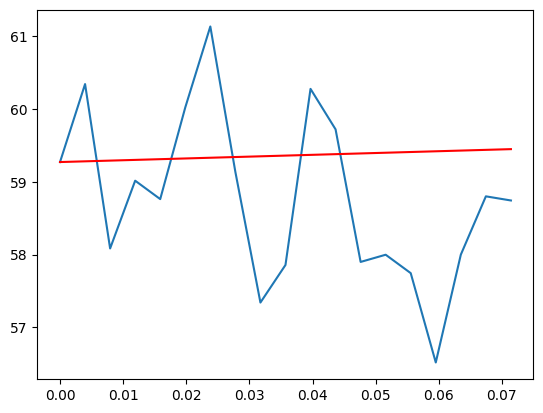

Stock = AVGO
S0 =  59.2719993591


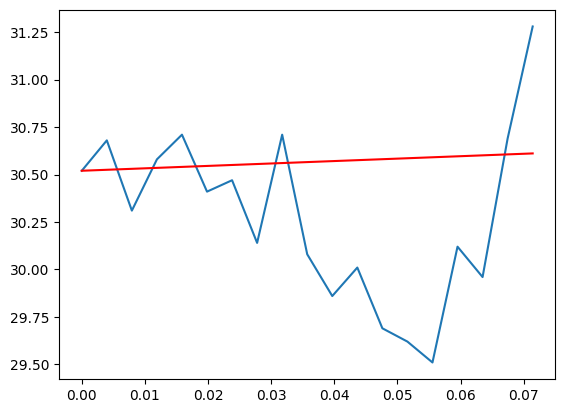

Stock = WMB
S0 =  30.5200004578


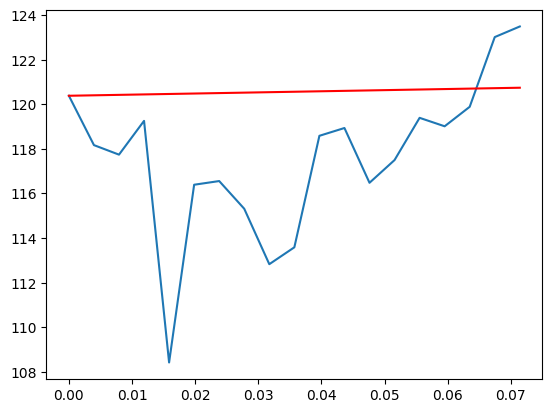

Stock = ZBH
S0 =  120.3786392212


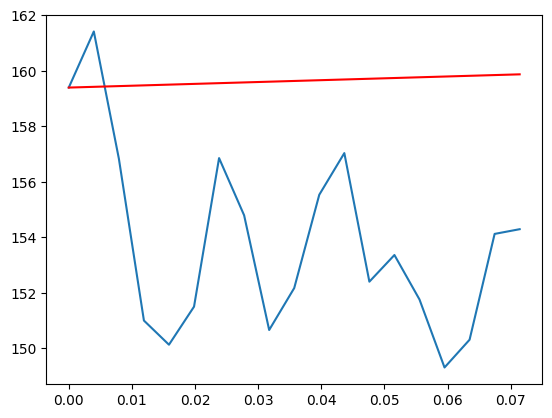

Stock = ETN
S0 =  159.3899993896


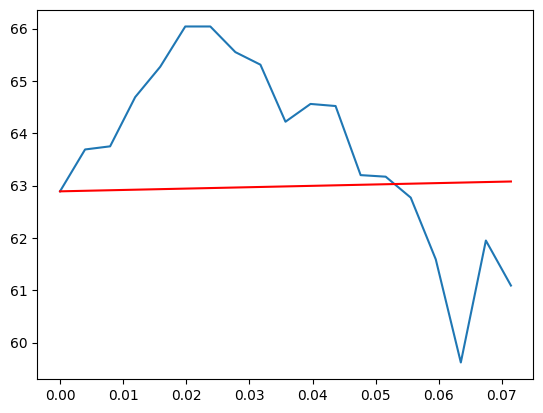

Stock = AFL
S0 =  62.8899993896


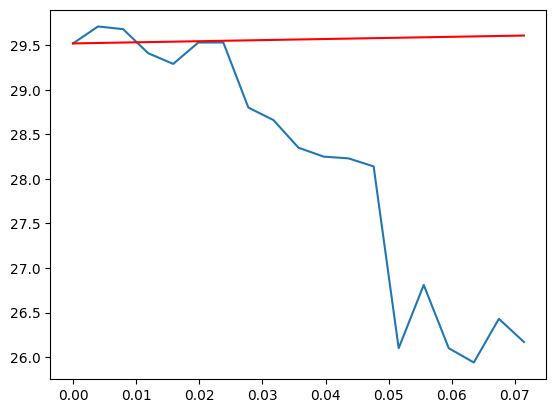

Stock = PPL
S0 =  29.5200004578


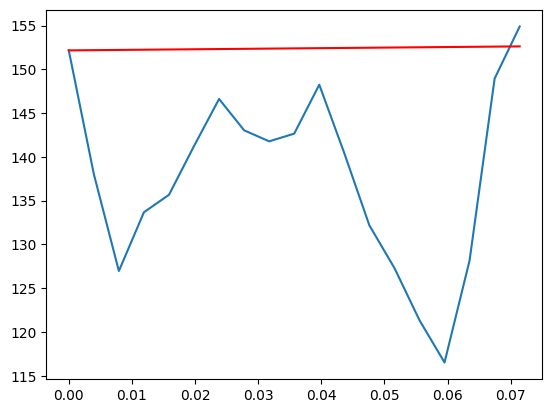

Stock = ETSY
S0 =  152.1600036621


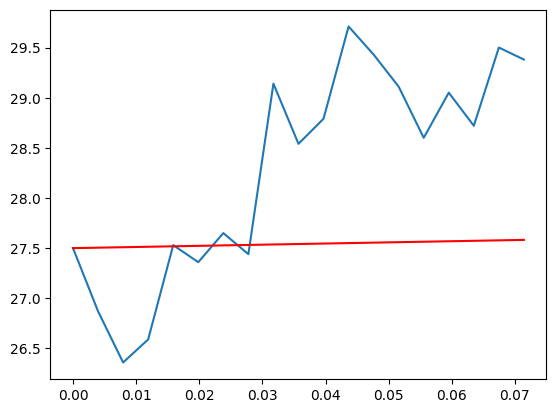

Stock = BKR
S0 =  27.5


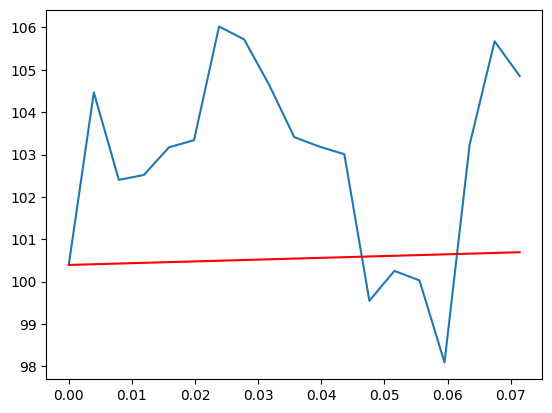

Stock = TECH
S0 =  100.3925018311


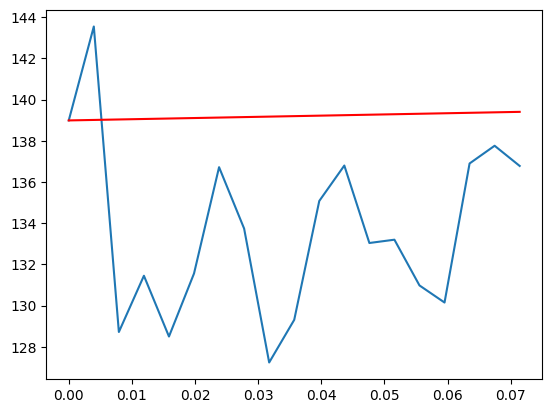

Stock = QRVO
S0 =  138.9900054932


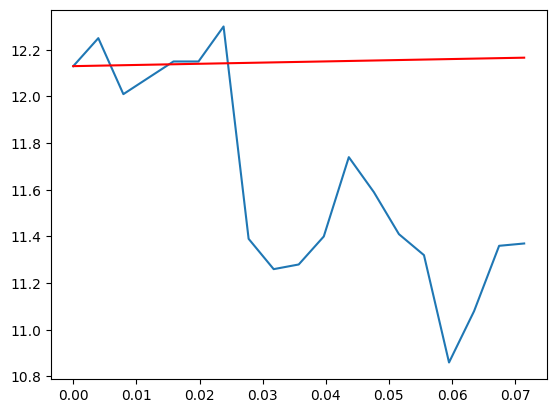

Stock = PCG
S0 =  12.1300001144


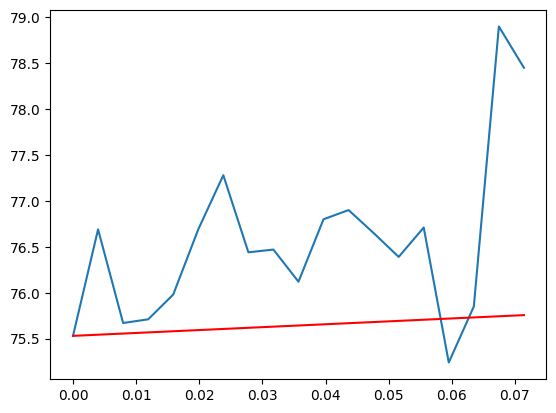

Stock = ADM
S0 =  75.5299987793


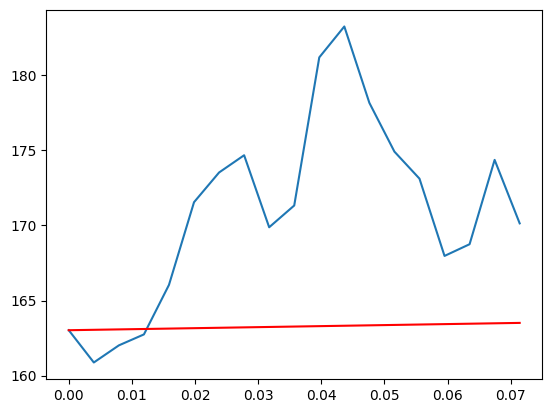

Stock = MAR
S0 =  163.0200042725


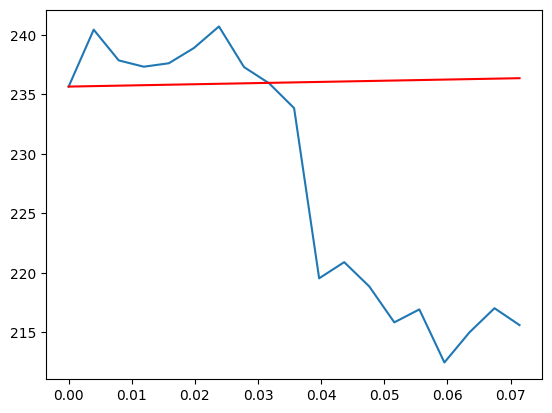

Stock = STZ
S0 =  235.6600036621


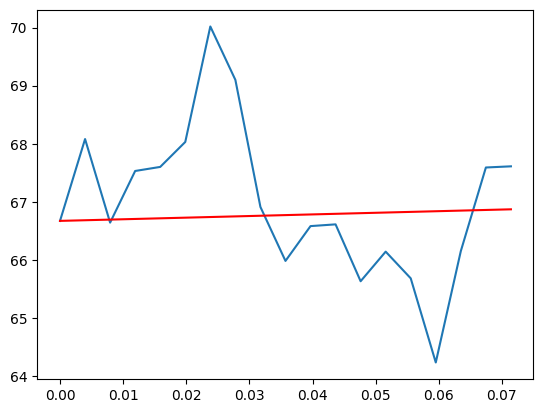

Stock = BRO
S0 =  66.6699981689


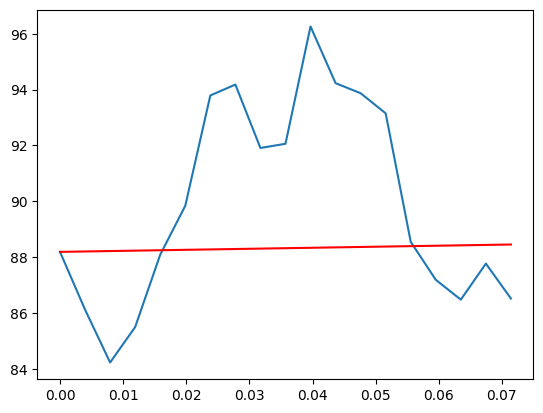

Stock = WYNN
S0 =  88.1900024414


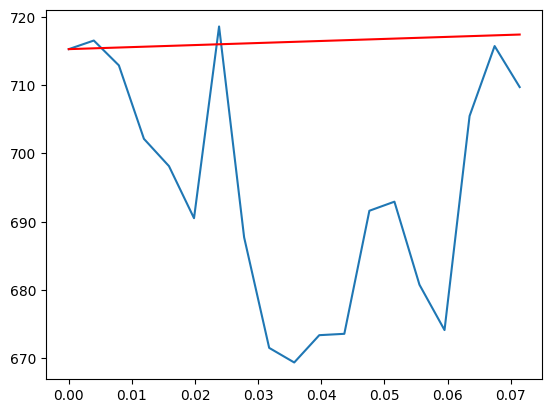

Stock = EQIX
S0 =  715.2899780273


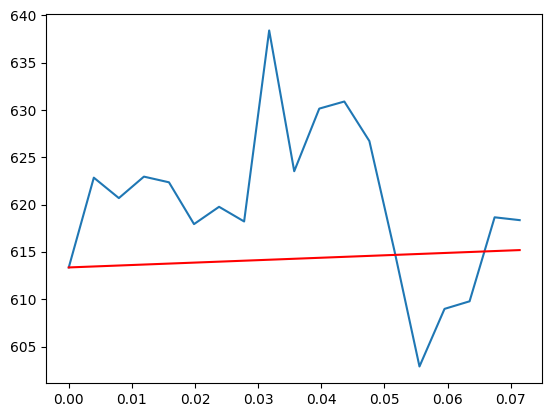

Stock = REGN
S0 =  613.3599853516


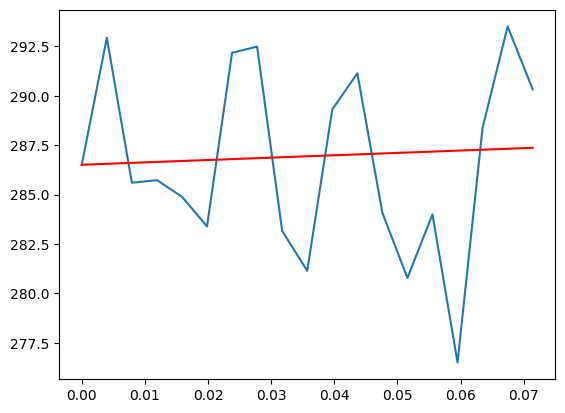

Stock = ISRG
S0 =  286.5100097656


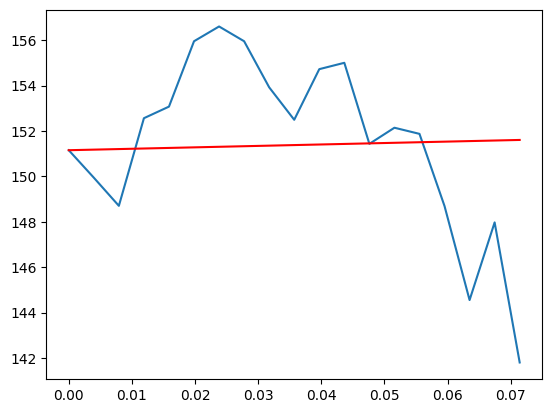

Stock = JPM
S0 =  151.1499938965


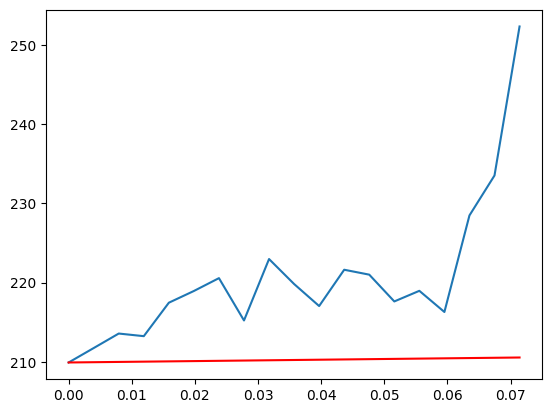

Stock = LHX
S0 =  209.9199981689


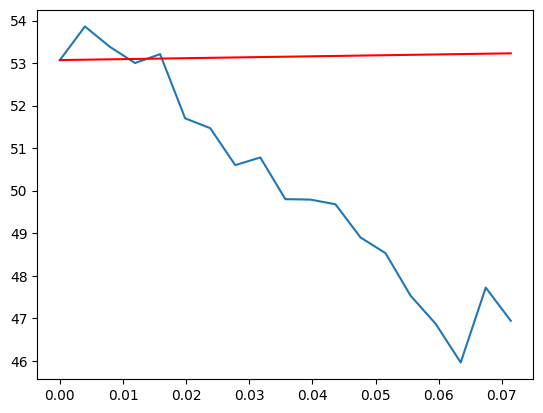

Stock = PFE
S0 =  53.0699996948


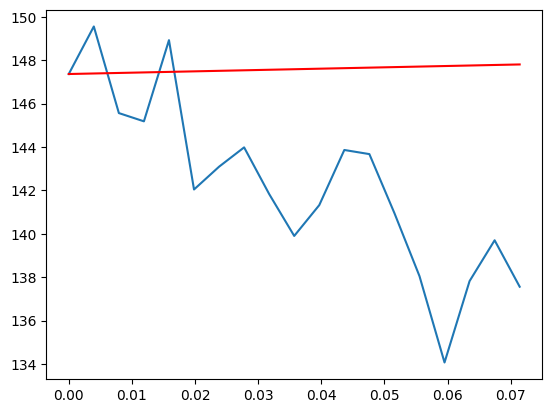

Stock = SPG
S0 =  147.3600006104


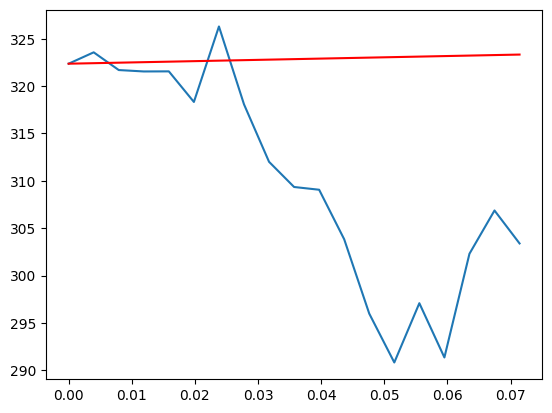

Stock = SBAC
S0 =  322.3699951172


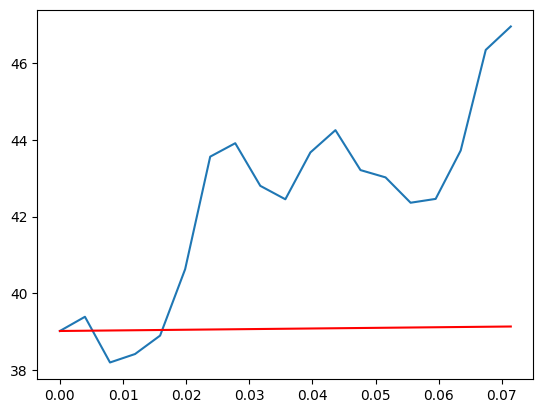

Stock = FCX
S0 =  39.0200004578


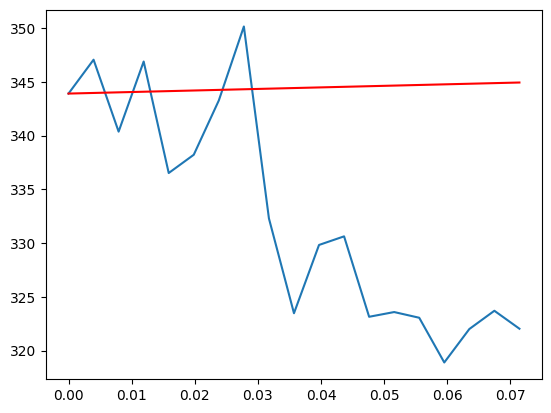

Stock = MCO
S0 =  343.8999938965


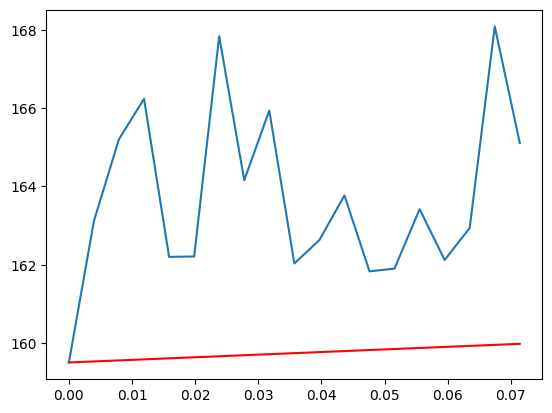

Stock = CPT
S0 =  159.5


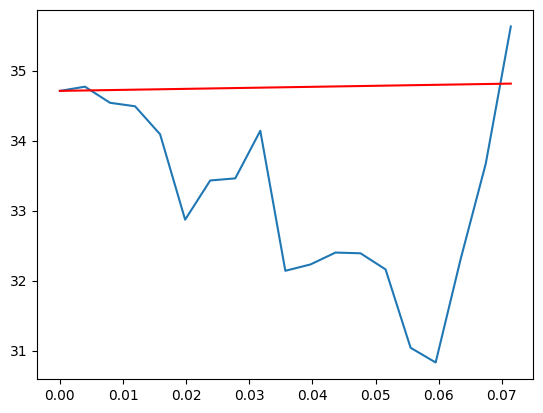

Stock = APA
S0 =  34.7099990845


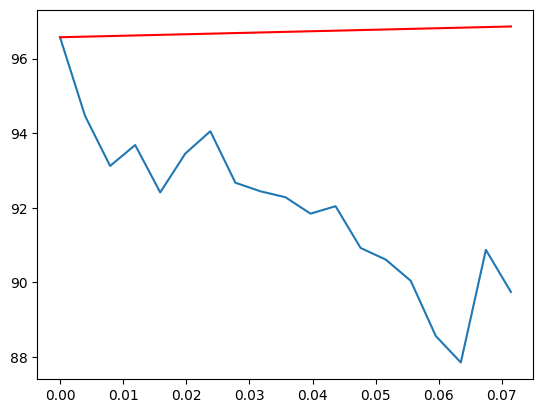

Stock = BALL
S0 =  96.5699996948


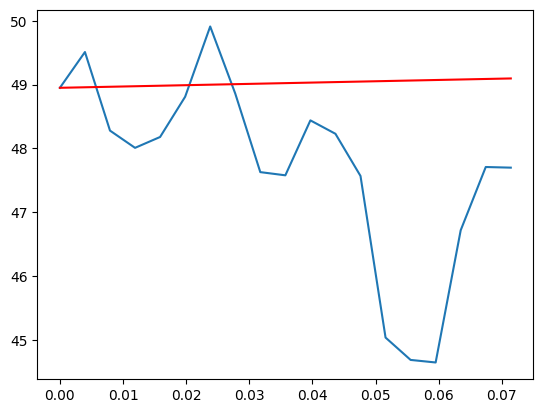

Stock = INTC
S0 =  48.9500007629


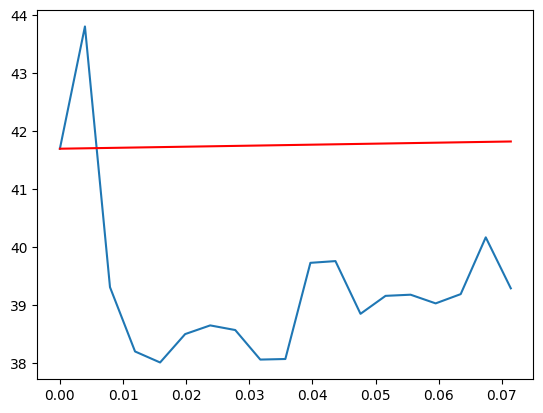

Stock = SMCI
S0 =  41.7000007629


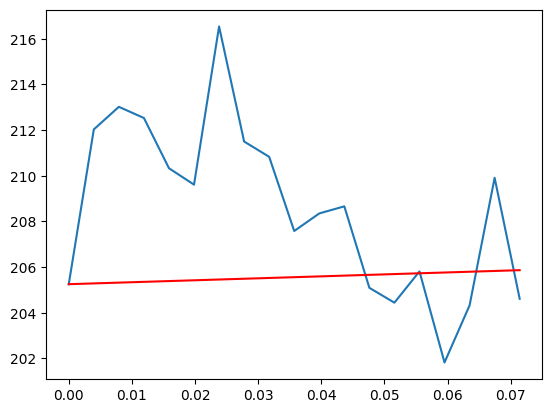

Stock = MAA
S0 =  205.25


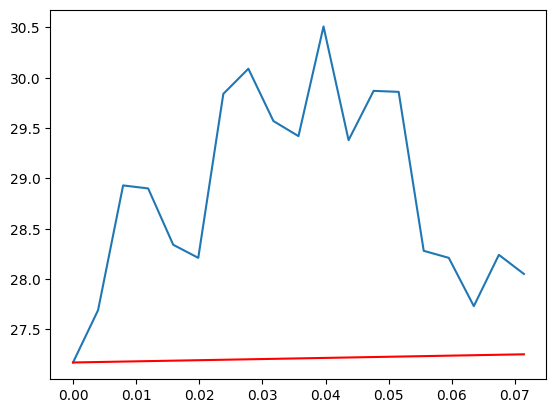

Stock = WBD
S0 =  27.1700000763


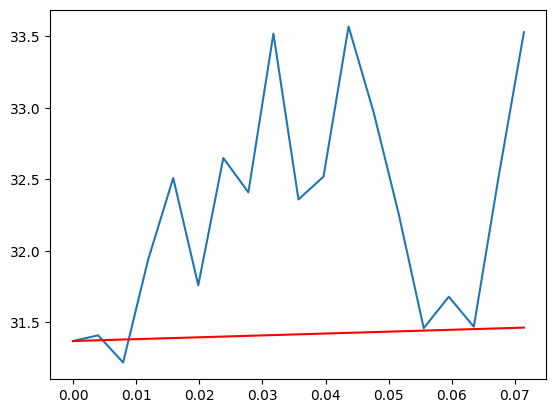

Stock = HAL
S0 =  31.3700008392


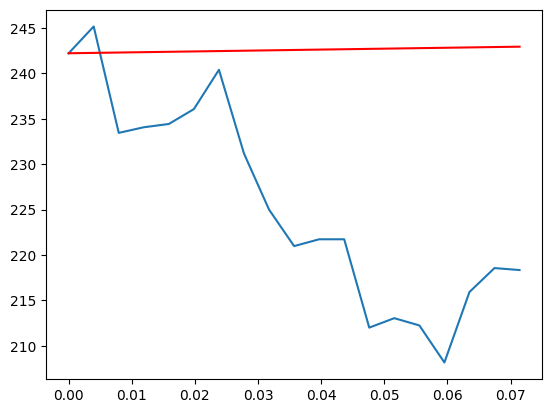

Stock = EFX
S0 =  242.2200012207


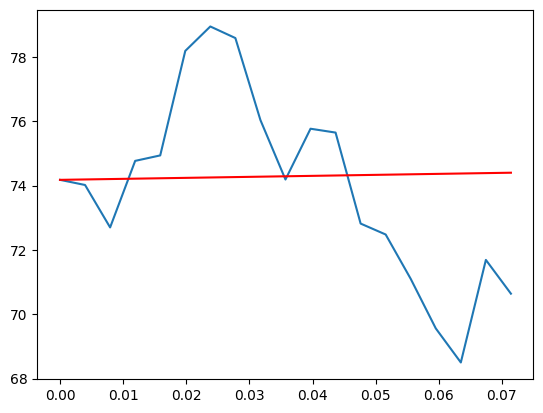

Stock = PFG
S0 =  74.1800003052


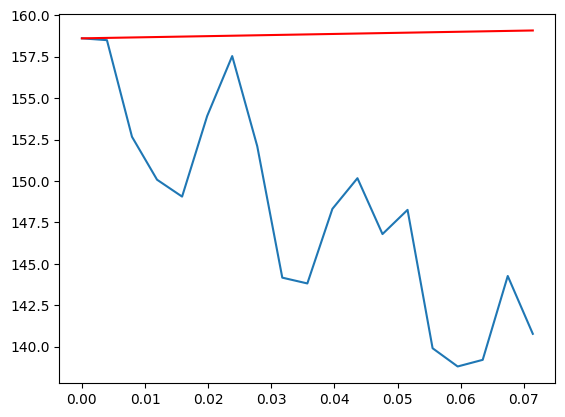

Stock = MHK
S0 =  158.6100006104


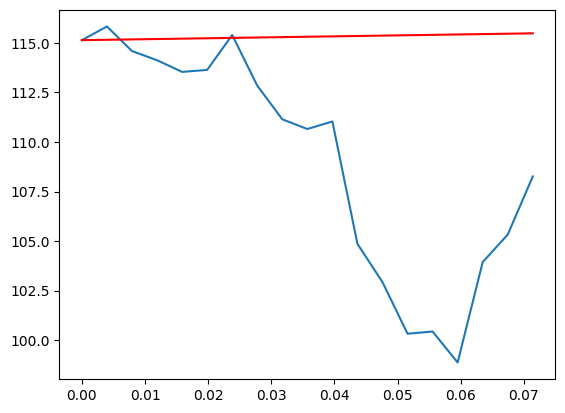

Stock = AKAM
S0 =  115.1299972534


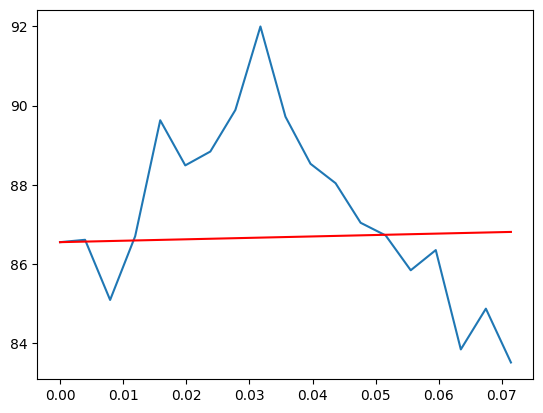

Stock = VLO
S0 =  86.5500030518


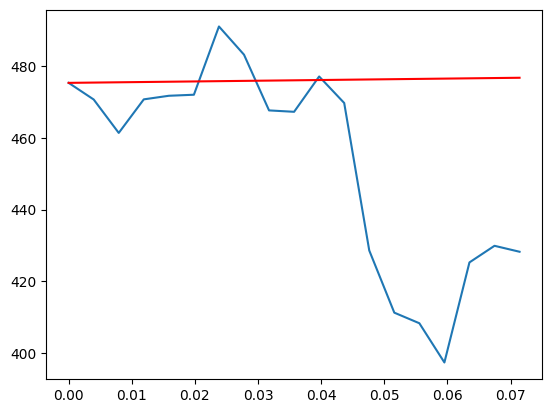

Stock = TYL
S0 =  475.3500061035


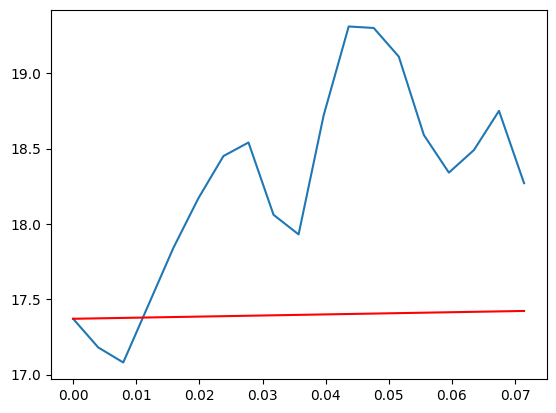

Stock = HST
S0 =  17.3700008392


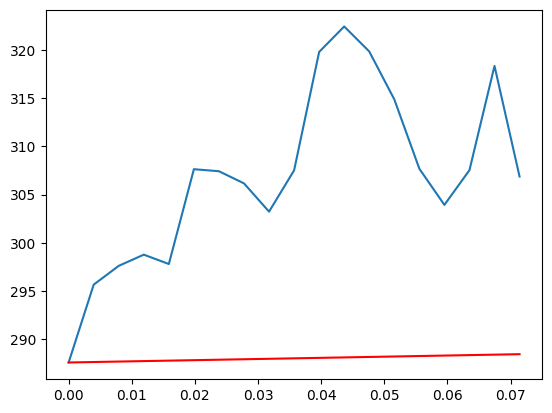

Stock = MOH
S0 =  287.5899963379


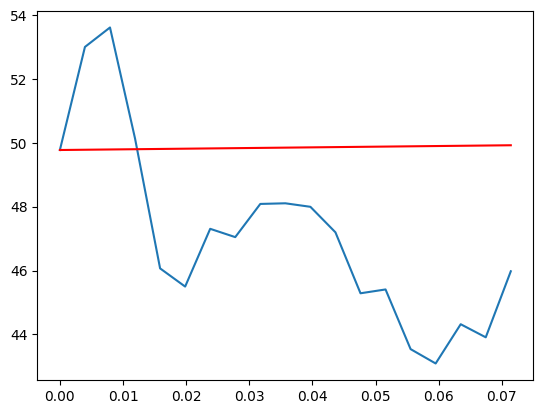

Stock = CEG
S0 =  49.7799987793


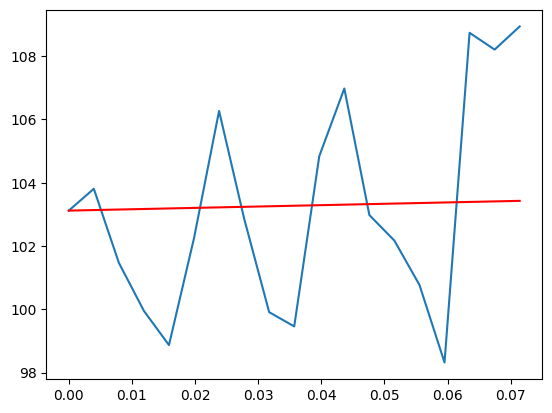

Stock = PWR
S0 =  103.1200027466


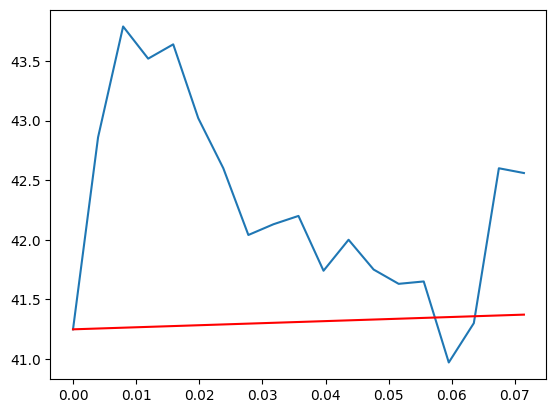

Stock = EXC
S0 =  41.2482185364


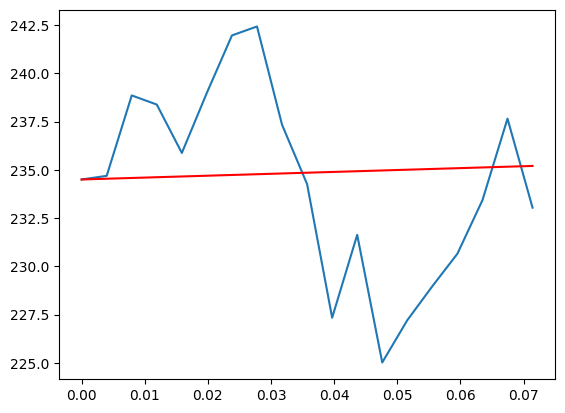

Stock = LH
S0 =  234.5017242432


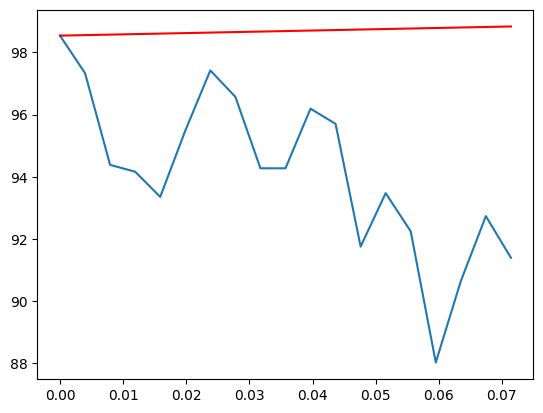

Stock = ROST
S0 =  98.5400009155


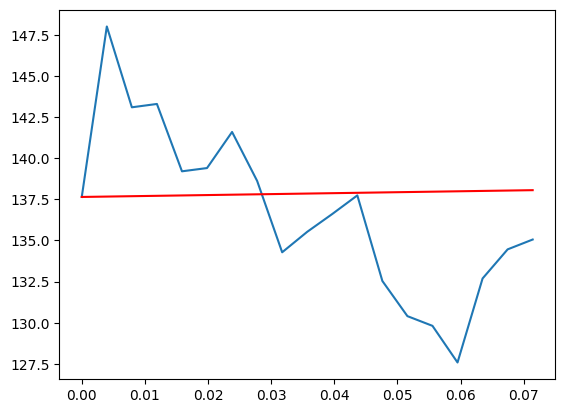

Stock = GOOGL
S0 =  137.6439971924


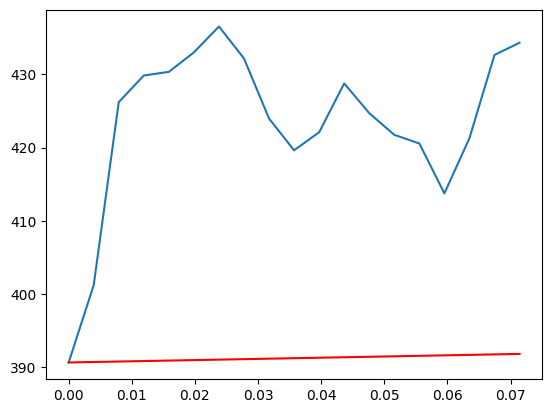

Stock = HUM
S0 =  390.6799926758


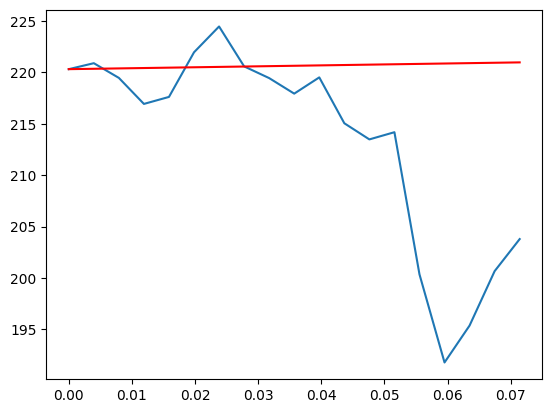

Stock = TSCO
S0 =  220.3099975586


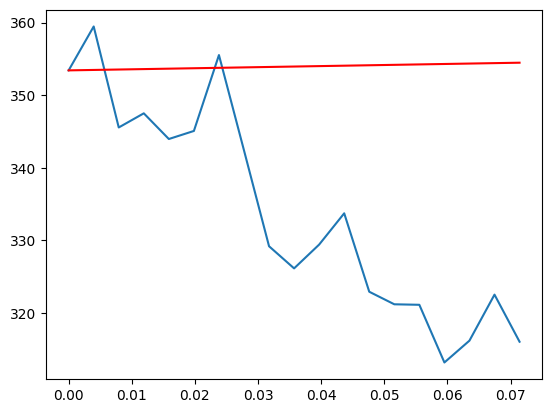

Stock = ACN
S0 =  353.4200134277


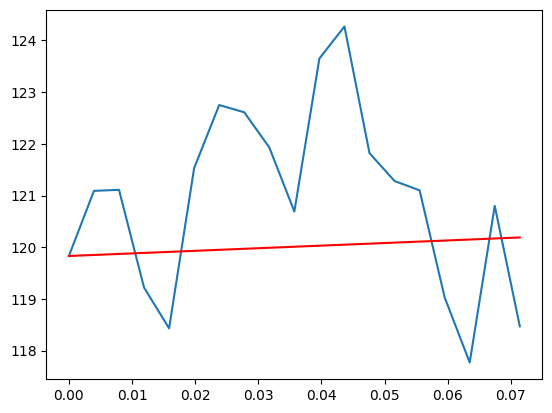

Stock = EMN
S0 =  119.8300018311


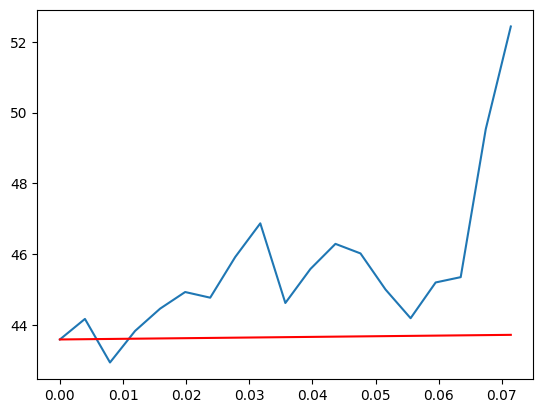

Stock = MOS
S0 =  43.5900001526


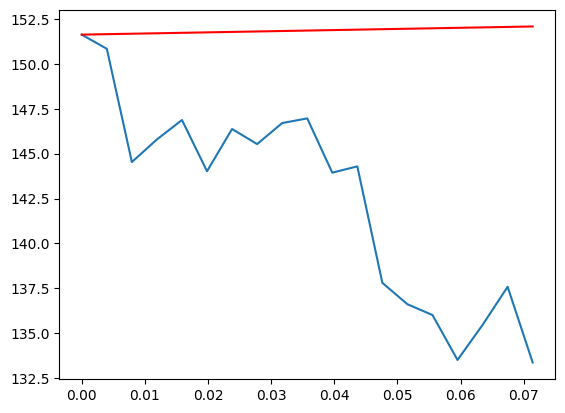

Stock = GPN
S0 =  151.6199951172


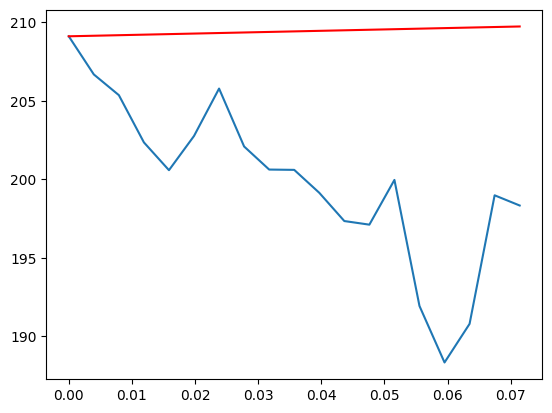

Stock = DG
S0 =  209.1199951172


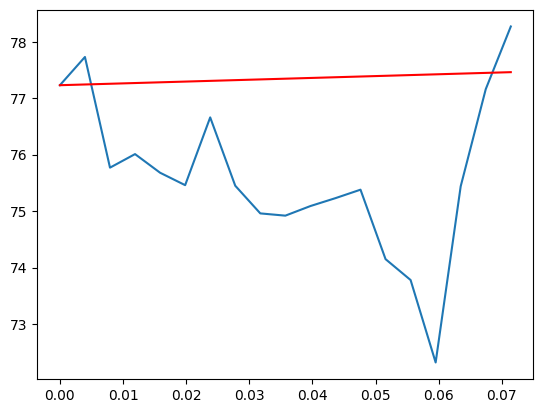

Stock = NEE
S0 =  77.2300033569


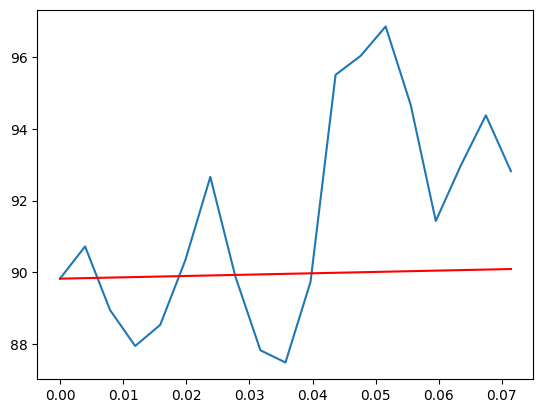

Stock = WAB
S0 =  89.8199996948


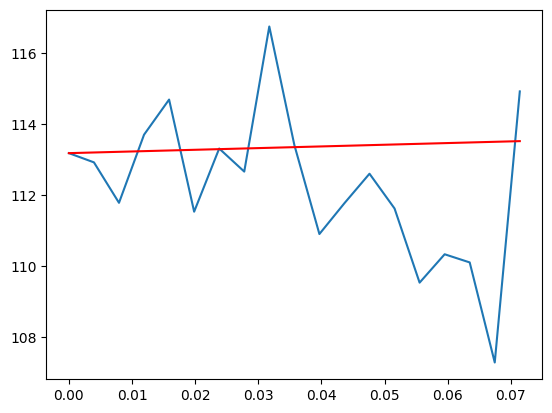

Stock = EOG
S0 =  113.1800003052


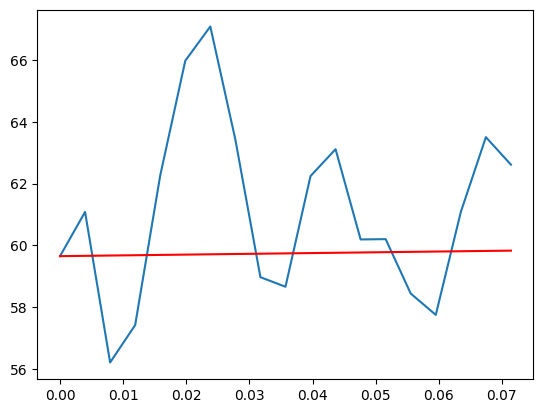

Stock = ON
S0 =  59.6500015259


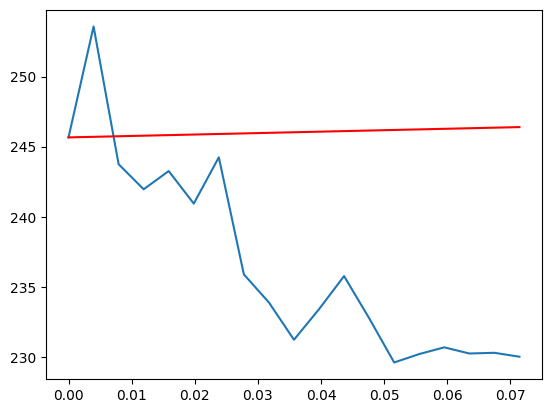

Stock = VRTX
S0 =  245.6600036621


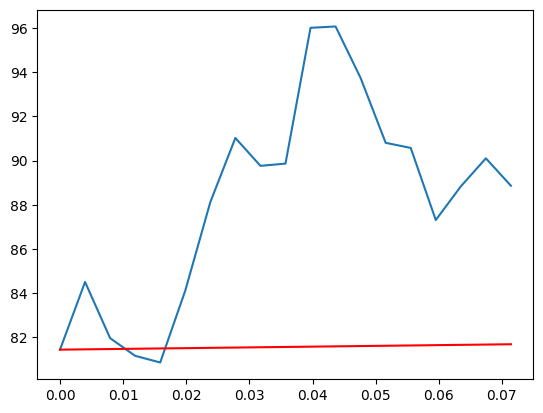

Stock = MU
S0 =  81.4499969482


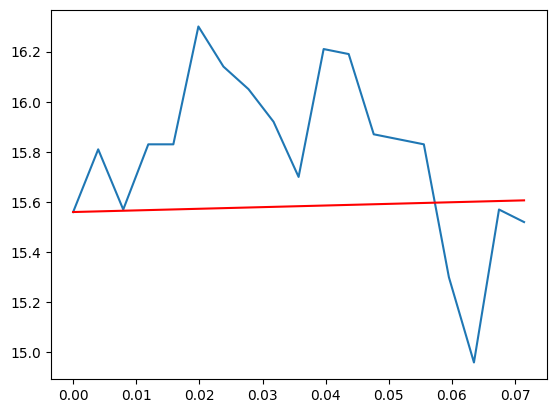

Stock = HBAN
S0 =  15.5600004196


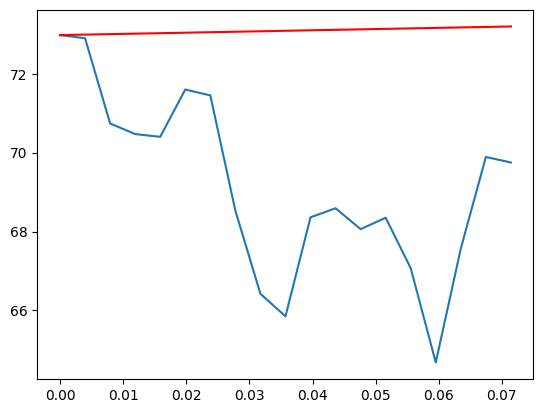

Stock = TRMB
S0 =  72.9800033569


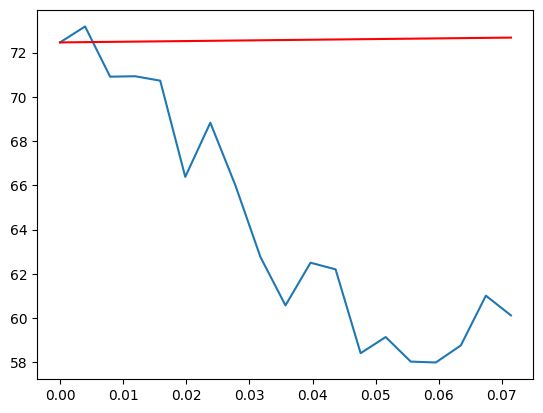

Stock = KKR
S0 =  72.4599990845


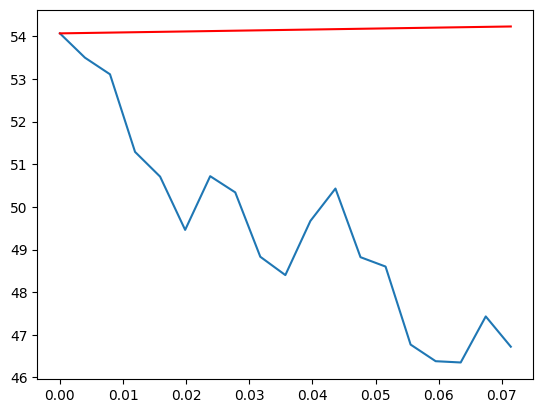

Stock = GM
S0 =  54.0699996948


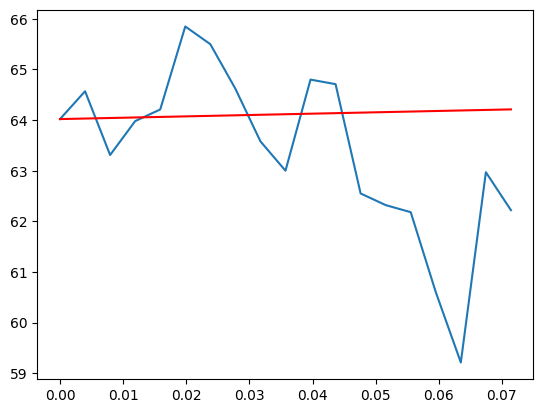

Stock = TFC
S0 =  64.0199966431


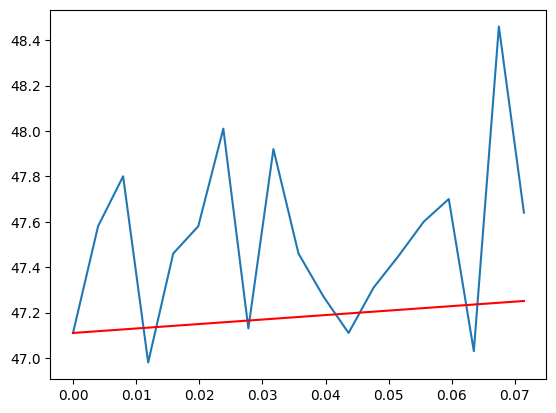

Stock = HRL
S0 =  47.1100006104


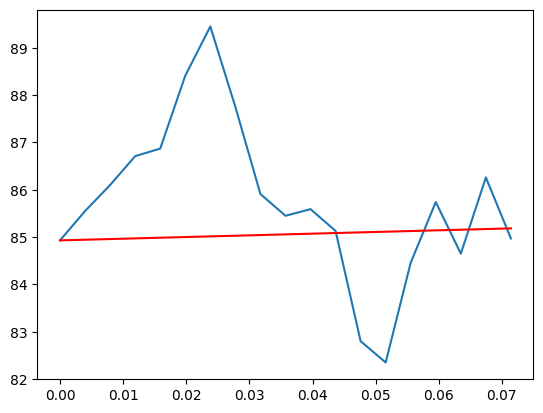

Stock = BAX
S0 =  84.9300003052


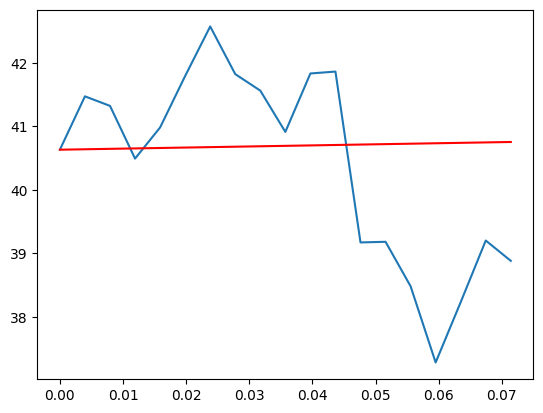

Stock = WY
S0 =  40.6300010681


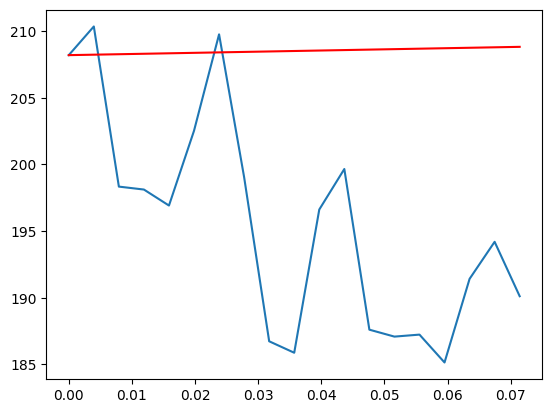

Stock = NXPI
S0 =  208.1999969482


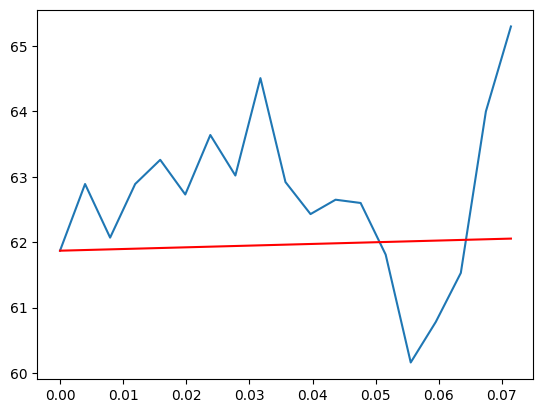

Stock = OKE
S0 =  61.8699989319


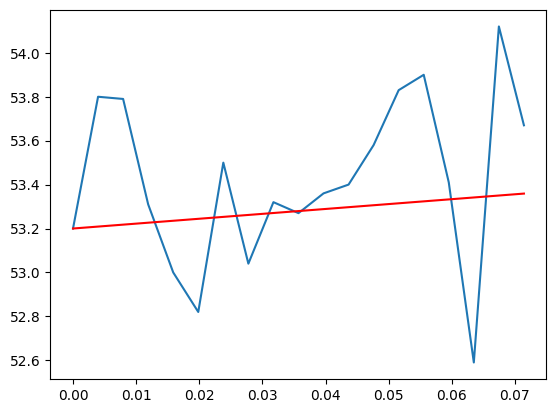

Stock = VZ
S0 =  53.2000007629


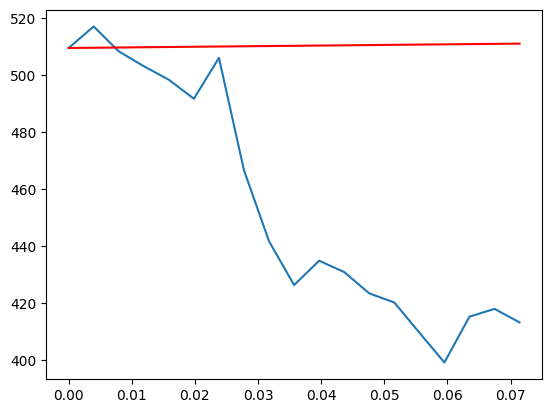

Stock = ZBRA
S0 =  509.4800109863


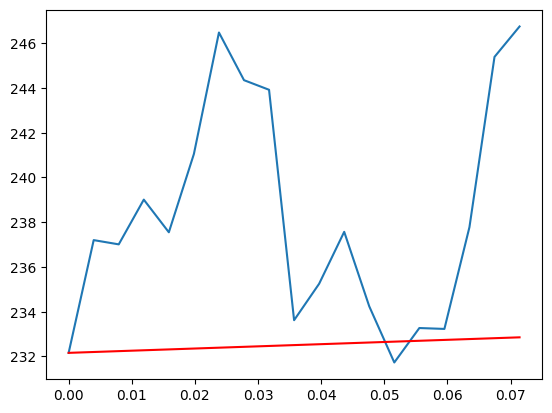

Stock = RMD
S0 =  232.1600036621


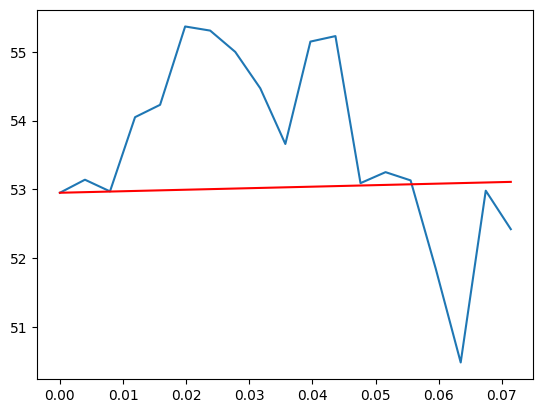

Stock = CFG
S0 =  52.9500007629


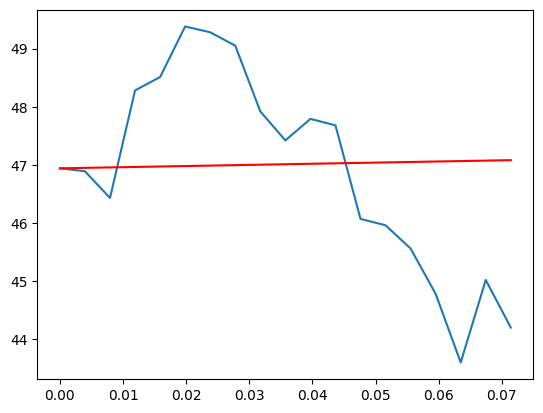

Stock = BAC
S0 =  46.9399986267


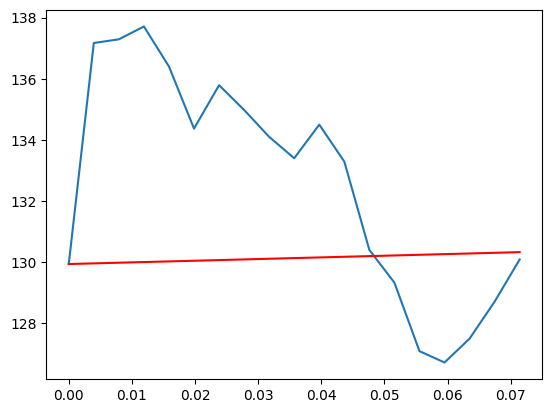

Stock = EA
S0 =  129.9400024414


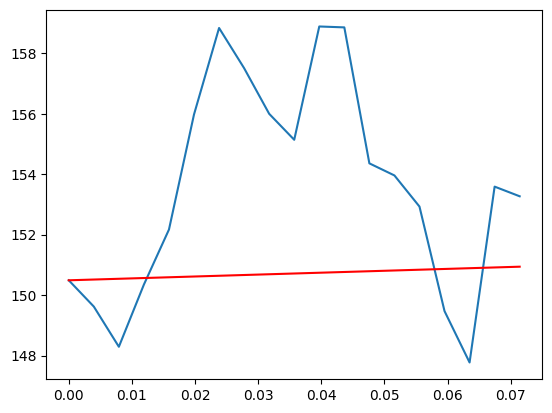

Stock = COF
S0 =  150.4900054932


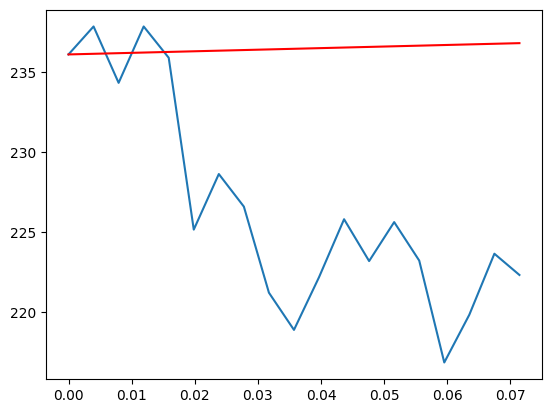

Stock = WTW
S0 =  236.1100006104


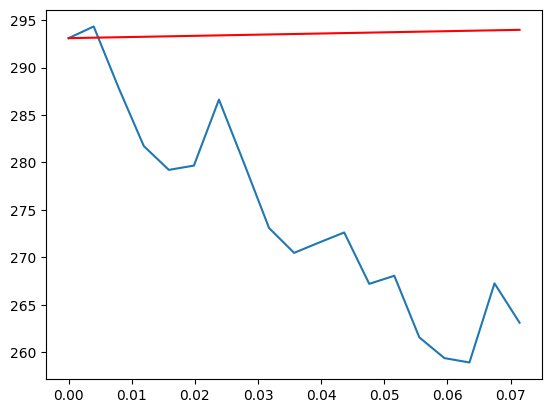

Stock = SHW
S0 =  293.0899963379


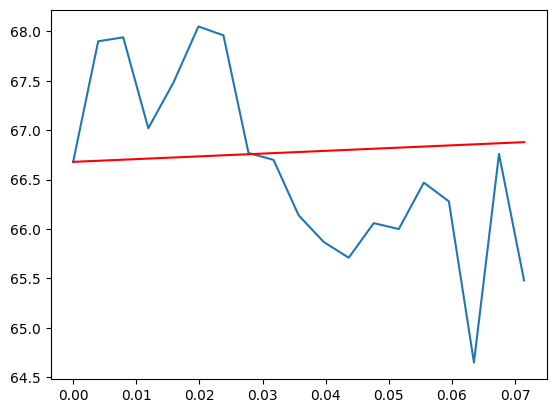

Stock = MDLZ
S0 =  66.6800003052


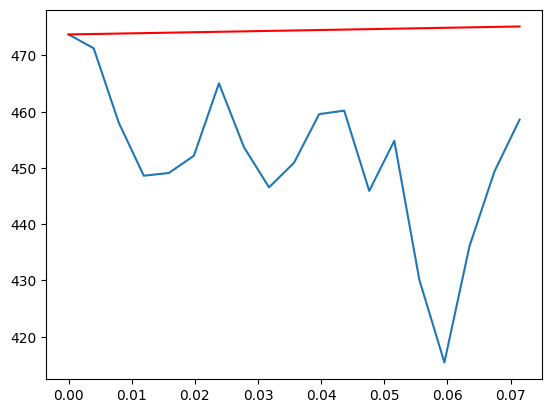

Stock = POOL
S0 =  473.7300109863


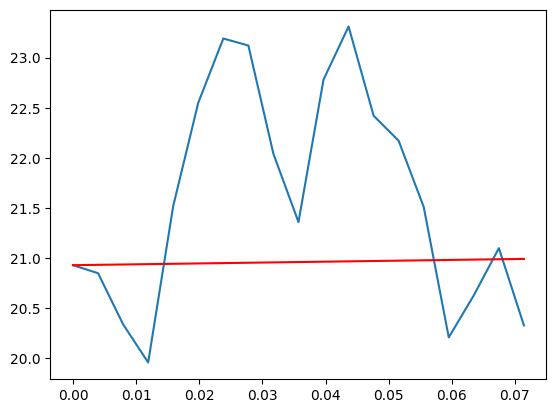

Stock = CCL
S0 =  20.9300003052


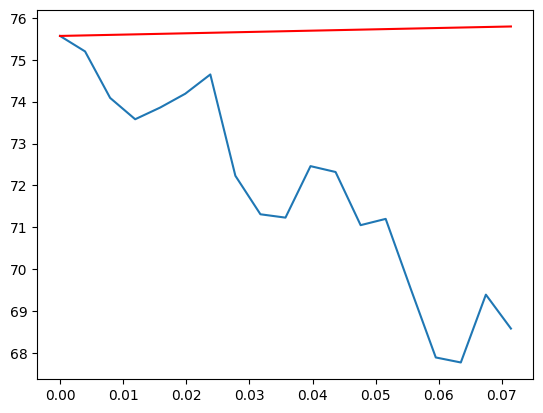

Stock = AOS
S0 =  75.5699996948


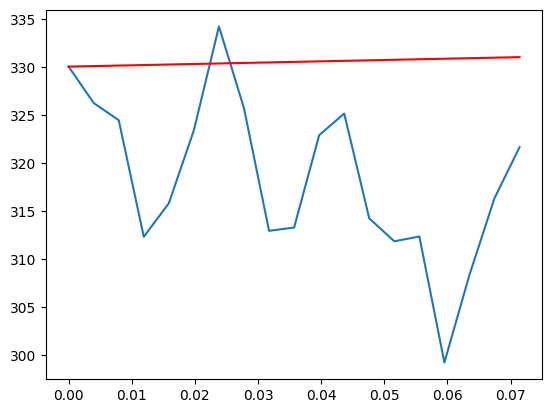

Stock = URI
S0 =  330.0100097656


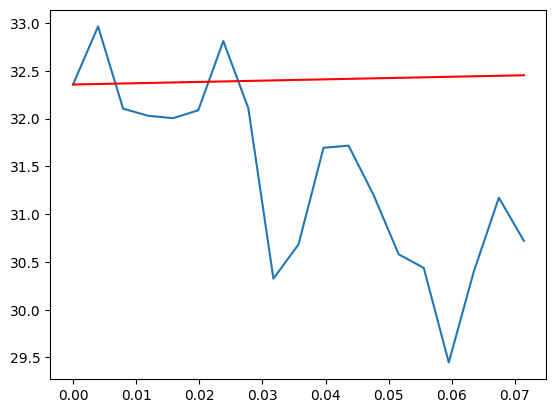

Stock = CPRT
S0 =  32.3574981689


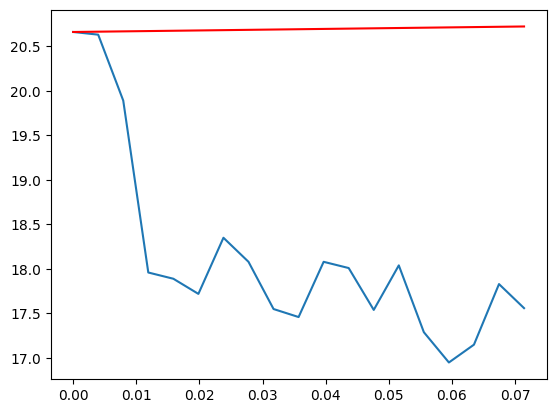

Stock = F
S0 =  20.6599998474


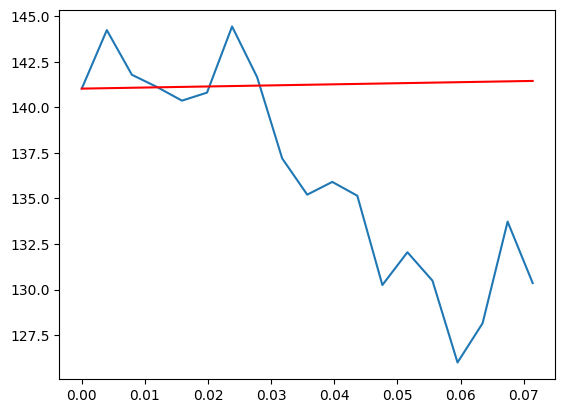

Stock = A
S0 =  141.0299987793


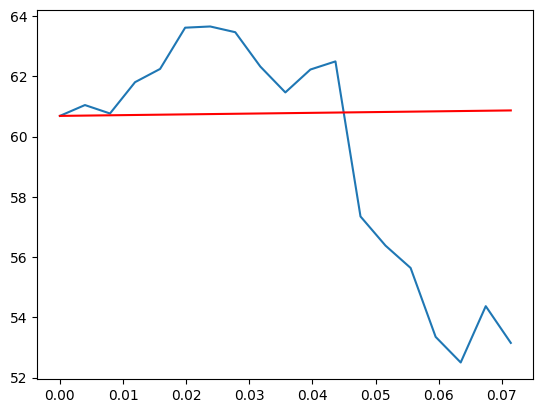

Stock = BK
S0 =  60.6899986267


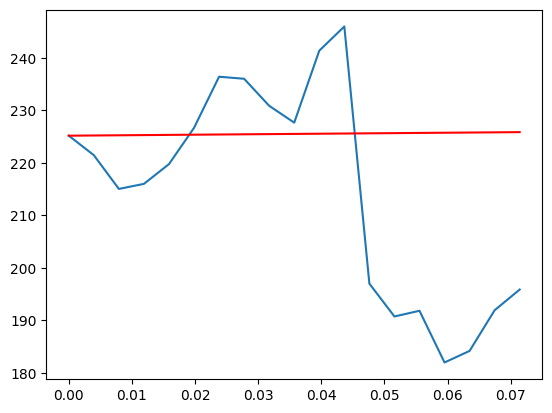

Stock = ALB
S0 =  225.1999969482


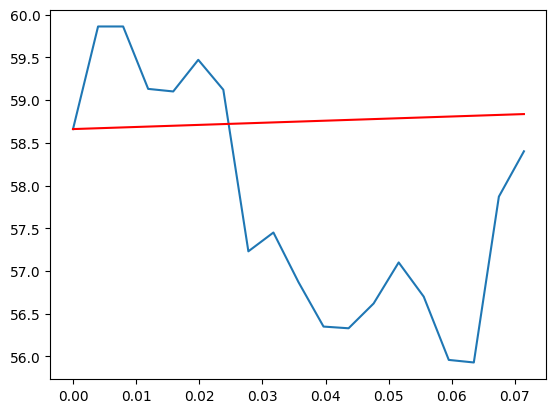

Stock = LNT
S0 =  58.6599998474


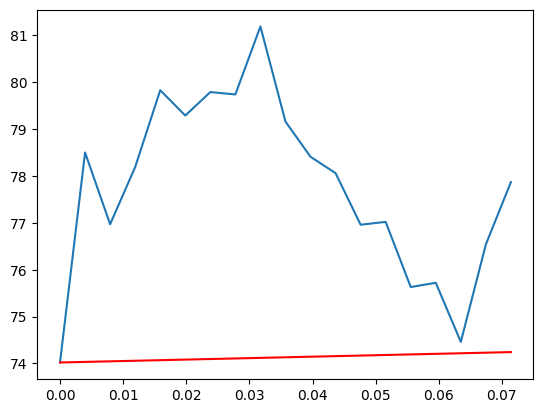

Stock = MPC
S0 =  74.0199966431


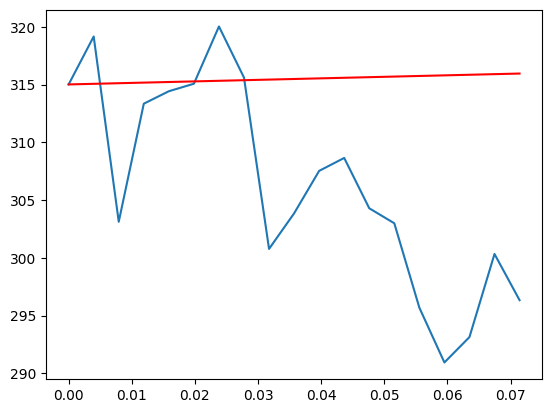

Stock = EL
S0 =  315.0199890137


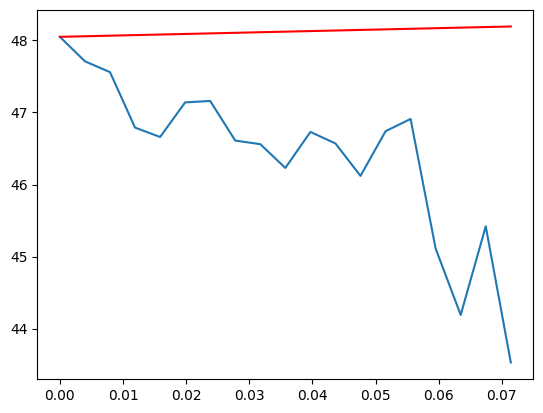

Stock = IP
S0 =  48.0499992371


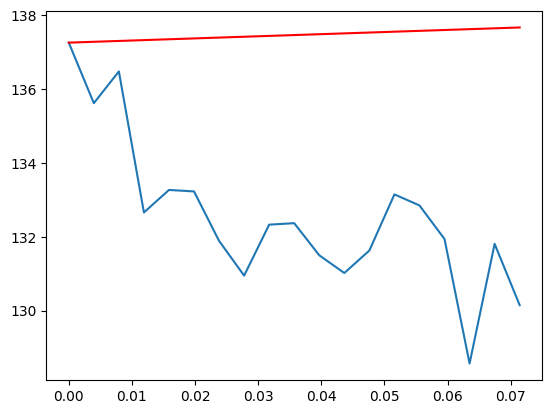

Stock = KMB
S0 =  137.2599945068


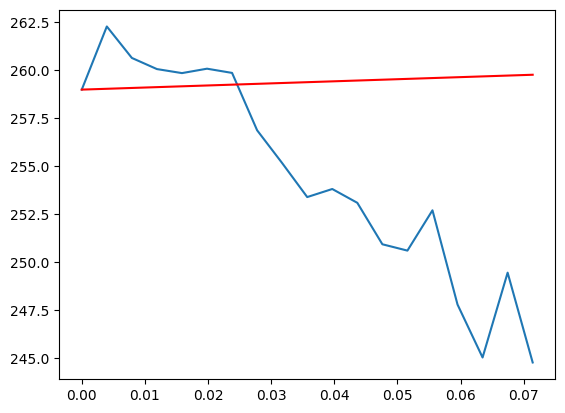

Stock = MCD
S0 =  258.9899902344


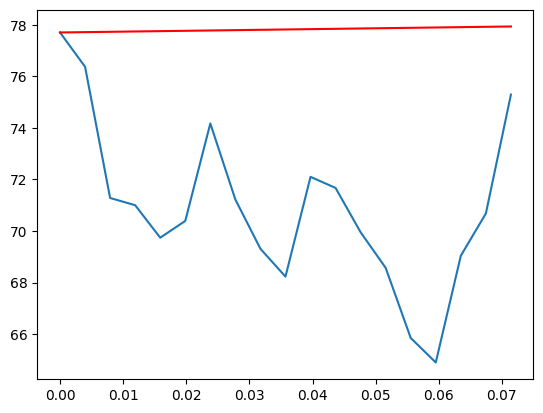

Stock = FSLR
S0 =  77.6999969482


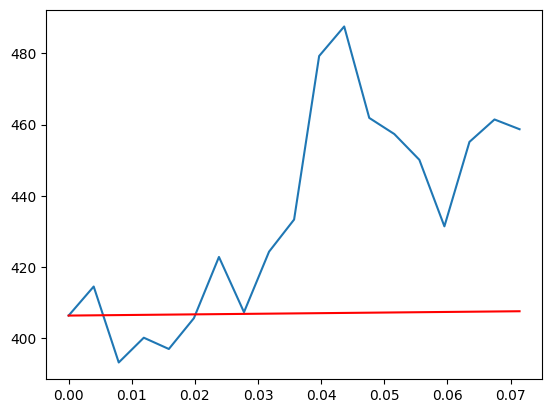

Stock = MPWR
S0 =  406.3399963379


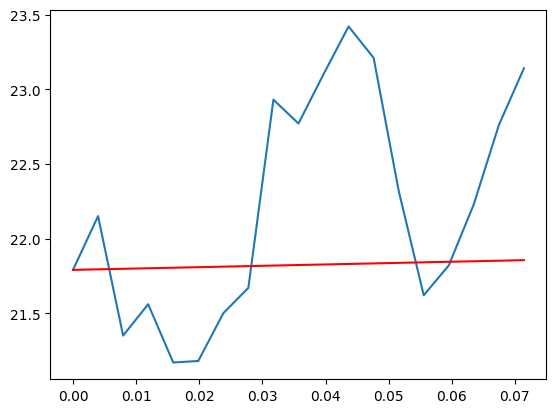

Stock = EQT
S0 =  21.7900009155


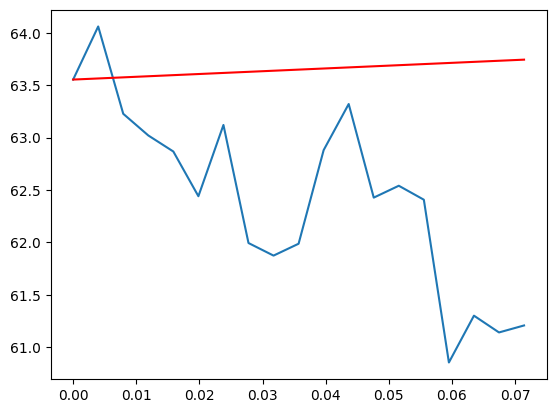

Stock = PCAR
S0 =  63.5533332825


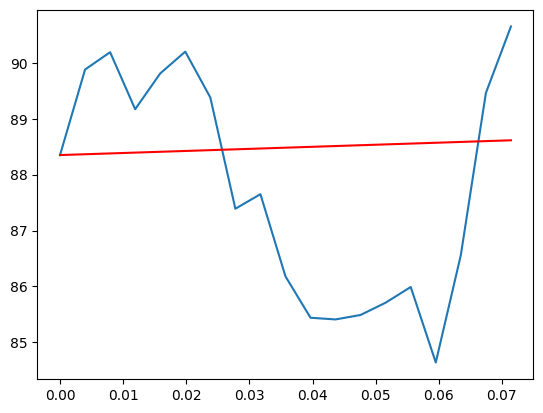

Stock = AEP
S0 =  88.3499984741


In [ ]:
# Plot real data
S_mids = []
for i, ticker in enumerate(data.columns):
  y1 = data[ticker].dropna()
  t = np.array(list(range(len(y1))))/252
  S0 = y1.iloc[0]
  y2 = S0*np.exp(risk_free_rate*t)      # Risk free interest rate
  plt.plot(t,y1)
  plt.plot(t, y2, color='red')
  plt.show()
  print("Stock =", ticker)
  print("S0 = ", S0)
  i = len(data)-1
  S_mids.append(y1.iloc[len(y1)-1])

Finally, we use the same code as the above with simulated stocks to find the efficient frontier.

In [ ]:
num_portfolios = 1000000
num_decimal_points = 10
tolerance = 10**(-15)
boundary_polynomial_degree = 6
efficient_frontier_granularity = 50
calculate_analytic_solution = False # Kinda glitches out a little if there are more than like 15 stocks :/
num_days_to_estimate_into_future=252

max_sharpe, min_vol, w_mk, (target, efficient_portfolio_means), boundary_poly_coefs_saved = display_calculated_ef_with_random(
                                         data=data.dropna(), num_portfolios=num_portfolios, risk_free_rate=risk_free_rate,
                                         number_of_decimals=num_decimal_points, T=num_days_to_estimate_into_future, tolerance=tolerance,
                                         boundary_polynomial_degree=boundary_polynomial_degree,
                                         efficient_frontier_granularity=efficient_frontier_granularity,
                                         calculate_analytic_solution=calculate_analytic_solution)


Simulating portfolios...
Finished simulating portfolios! This took 289.52760577201843 seconds.
Finding portfolio with maximum Sharpe ratio...
Portfolio found! This took 52.75379943847656 seconds.
Finding portfolio with minumum volatility...
Portfolio found! This took 45.79905414581299 seconds.
Finding efficient frontier...


KeyboardInterrupt: 

The portfolio with the maximum Sharpe ratio is the one that we would like to select since it has the highest ratio of expected rate of return to volatility. The minimum volatility portfolio is also of interest. Same with the market portfolio if we are able to compute it analytically.

Here, we grab the rest of the stock information up until the specified stop time. We first will graph this data to see how it performs visually.

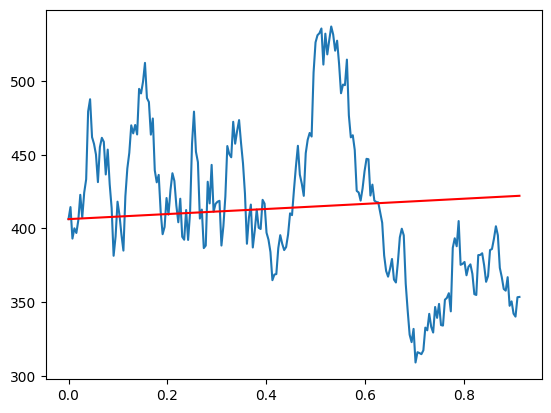

Stock = MPWR
S0 =  406.3399963379


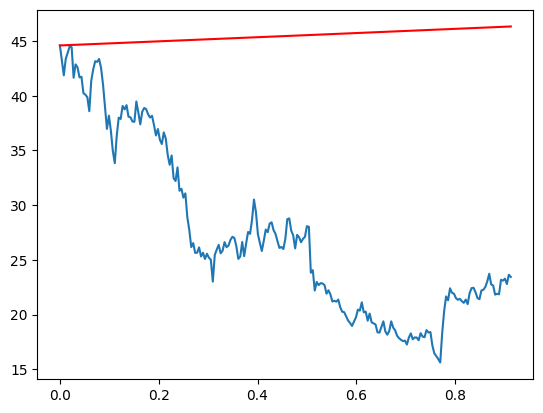

Stock = RAMP
S0 =  44.5999984741


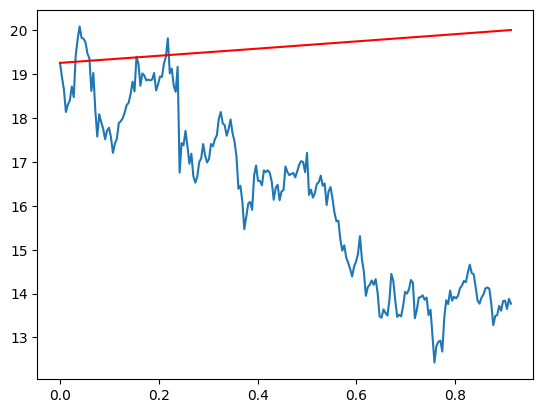

Stock = WU
S0 =  19.2600002289


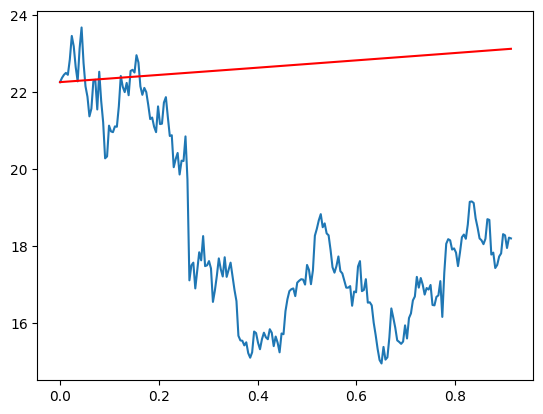

Stock = NWSA
S0 =  22.2600002289


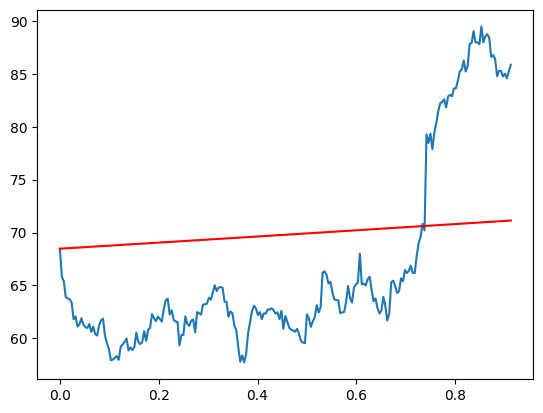

Stock = GILD
S0 =  68.4700012207


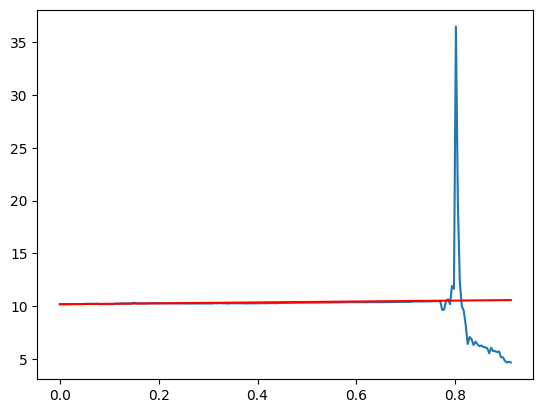

Stock = GRND
S0 =  10.1700000763


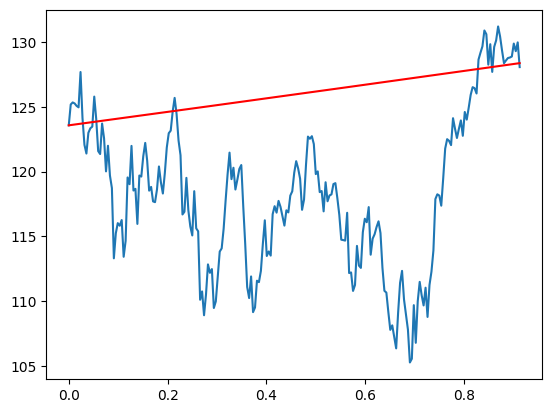

Stock = YUM
S0 =  123.5800018311


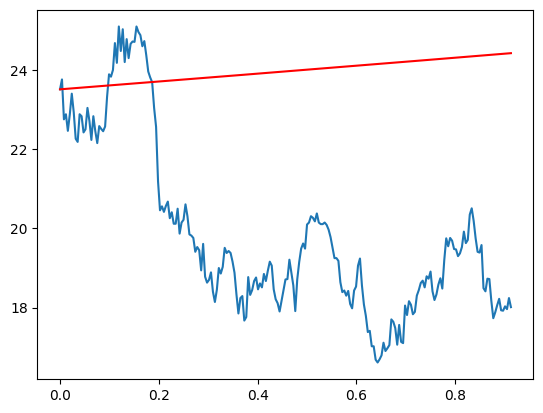

Stock = INFY
S0 =  23.5200004578


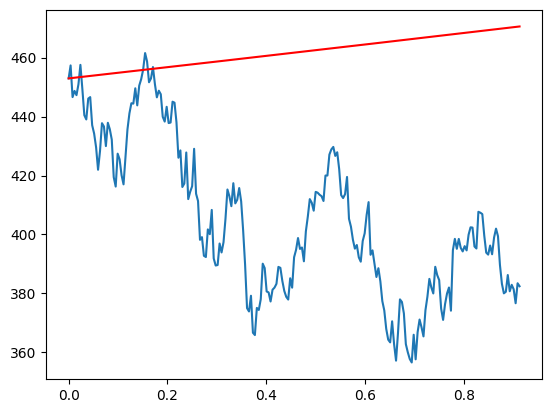

Stock = SPY
S0 =  452.950012207


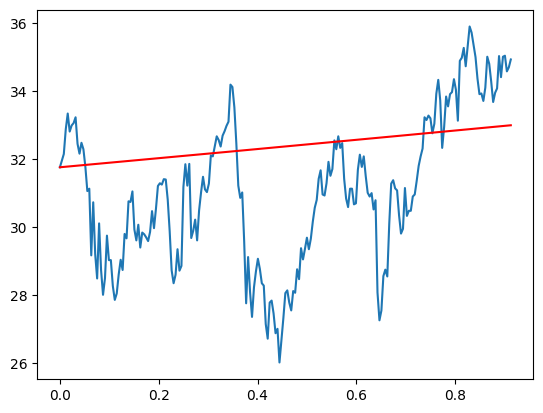

Stock = BP
S0 =  31.7600002289


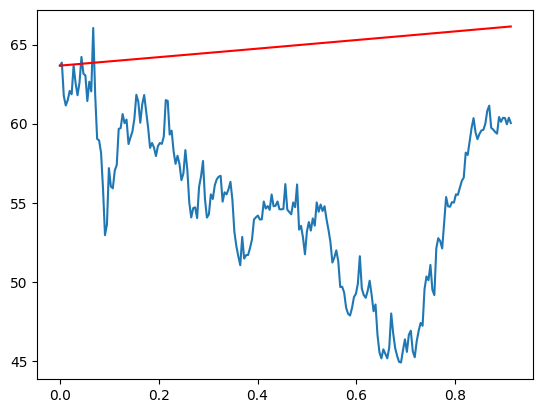

Stock = BUD
S0 =  63.6699981689


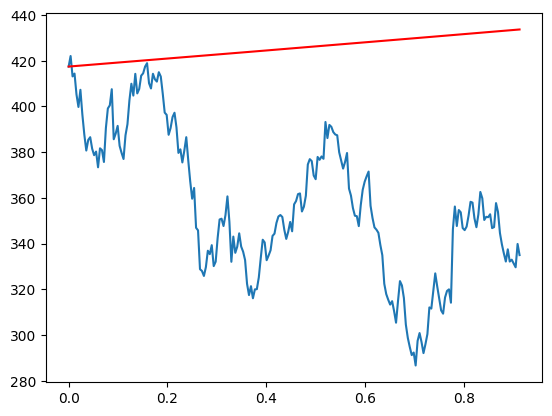

Stock = SPGI
S0 =  417.4599914551


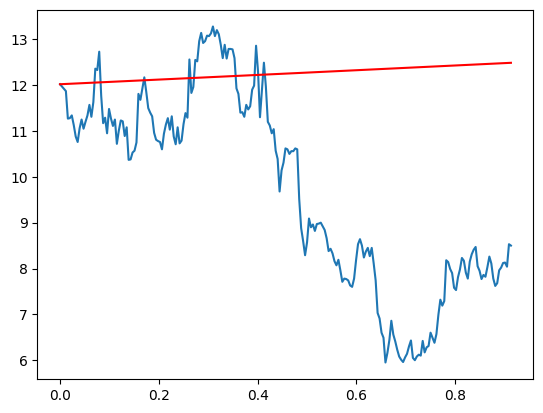

Stock = GRFS
S0 =  12.0200004578


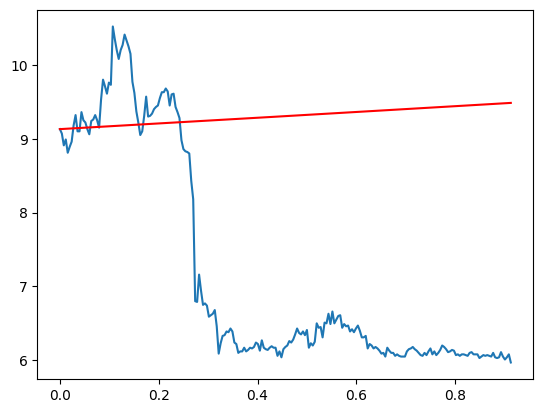

Stock = WVVI
S0 =  9.1300001144


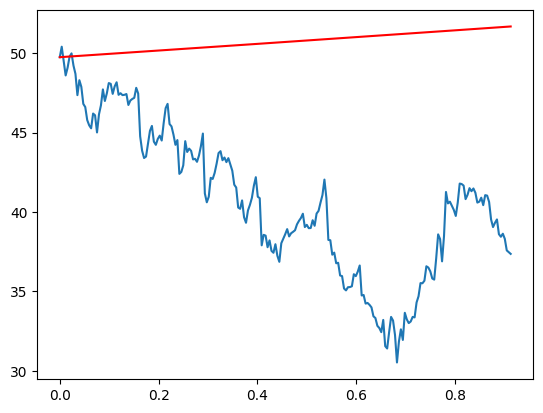

Stock = WBA
S0 =  49.75


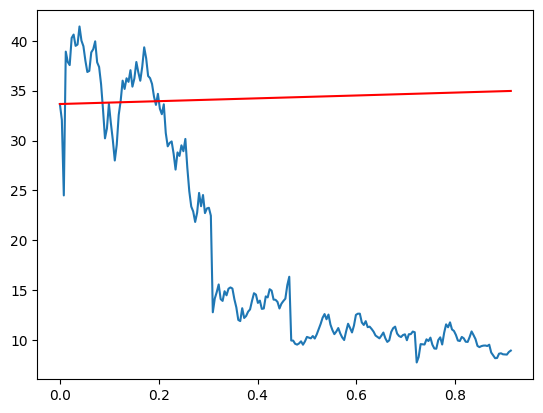

Stock = SNAP
S0 =  33.6599998474


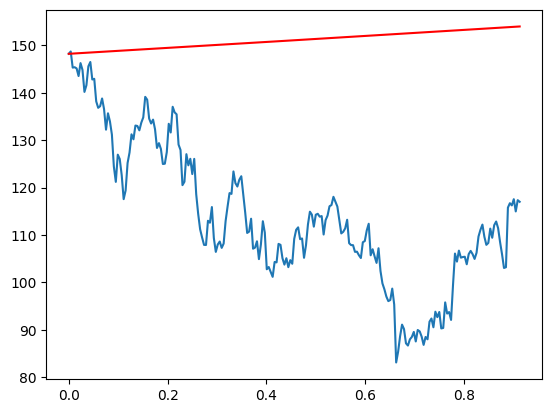

Stock = NKE
S0 =  148.2200012207


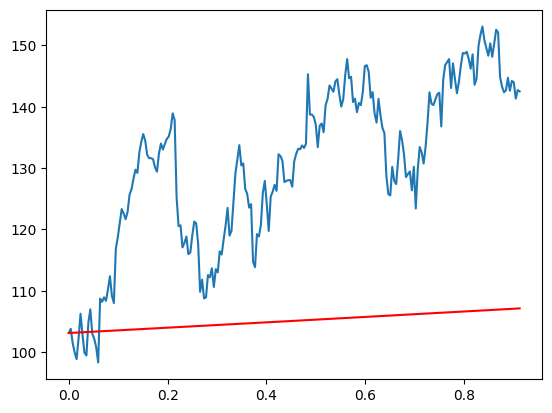

Stock = PWR
S0 =  103.1200027466


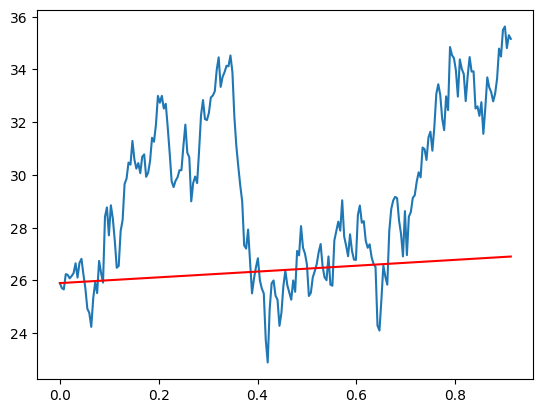

Stock = TS
S0 =  25.8999996185


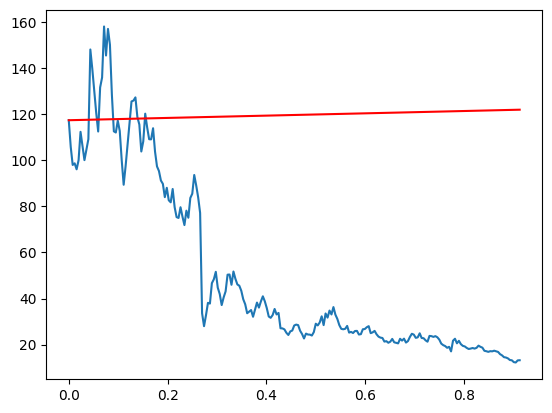

Stock = UPST
S0 =  117.3300018311


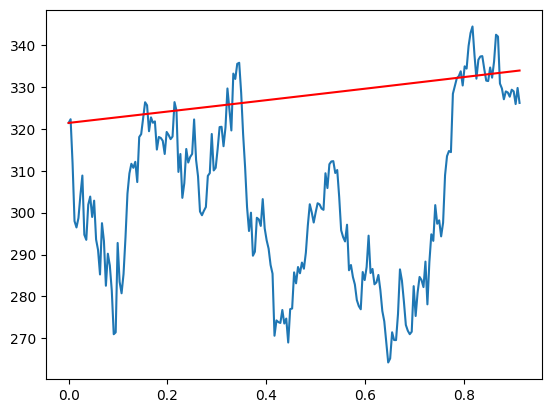

Stock = LIN
S0 =  321.4100036621


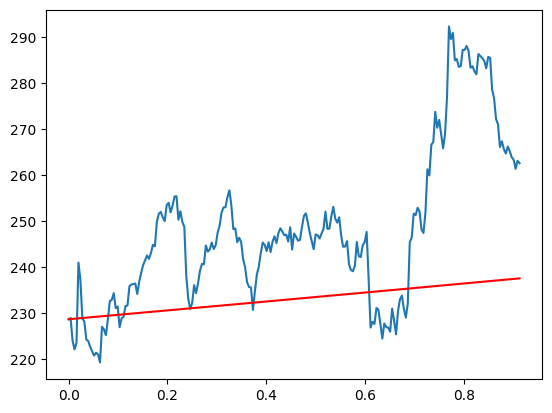

Stock = AMGN
S0 =  228.6799926758


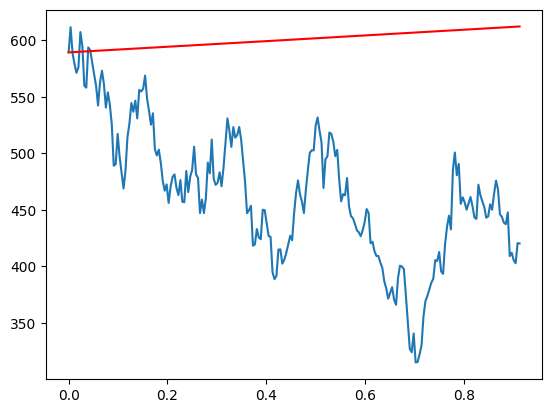

Stock = LRCX
S0 =  589.4699707031


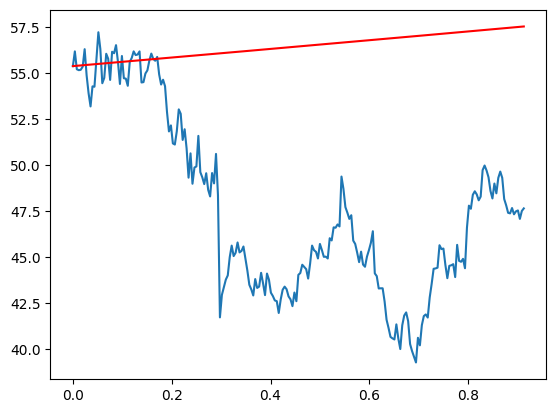

Stock = CSCO
S0 =  55.3699989319


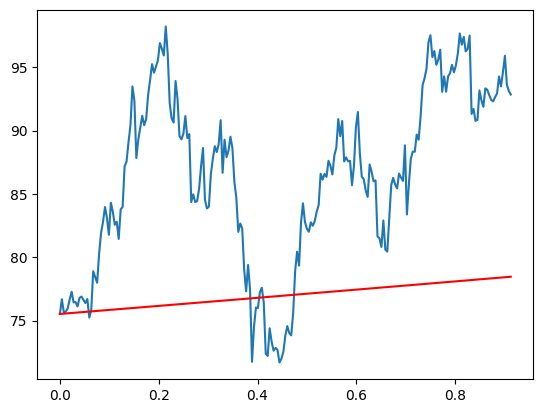

Stock = ADM
S0 =  75.5299987793


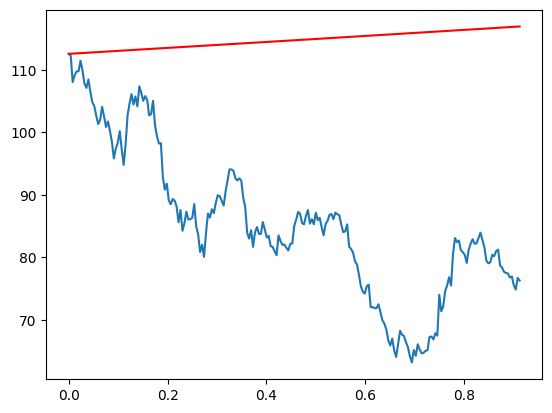

Stock = SONY
S0 =  112.5599975586


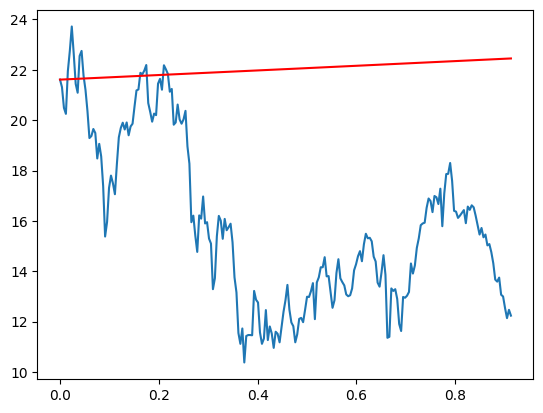

Stock = NCLH
S0 =  21.6100006104


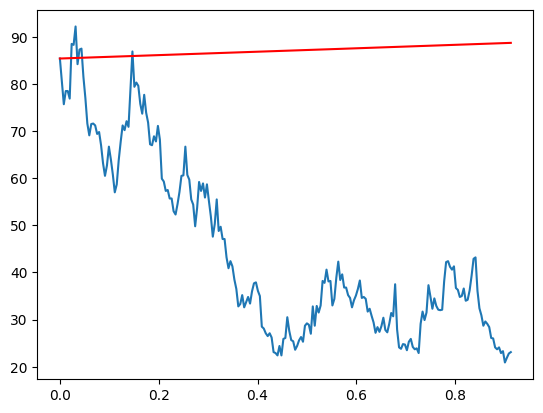

Stock = CGC
S0 =  85.4000015259


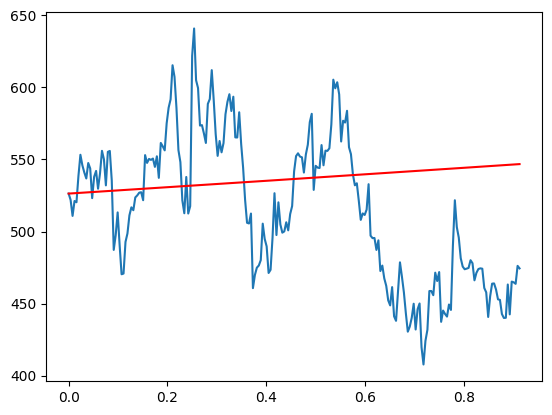

Stock = CACC
S0 =  526.3200073242


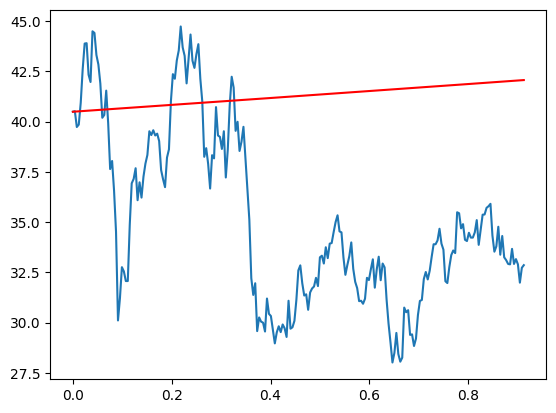

Stock = DAL
S0 =  40.4900016785


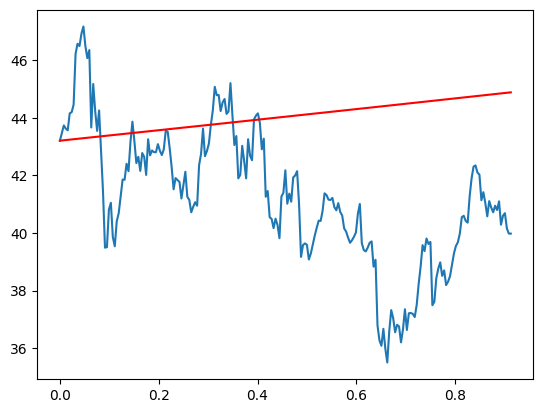

Stock = BTI
S0 =  43.2099990845


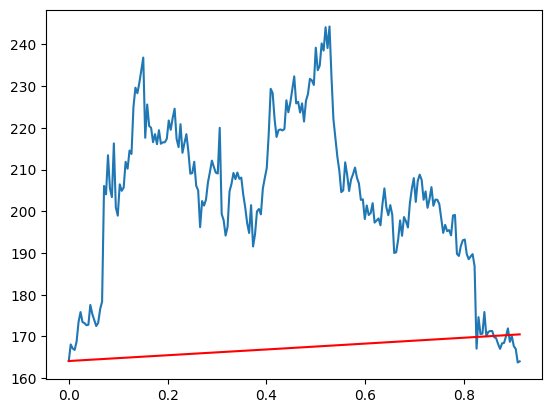

Stock = ESLT
S0 =  164.1199951172


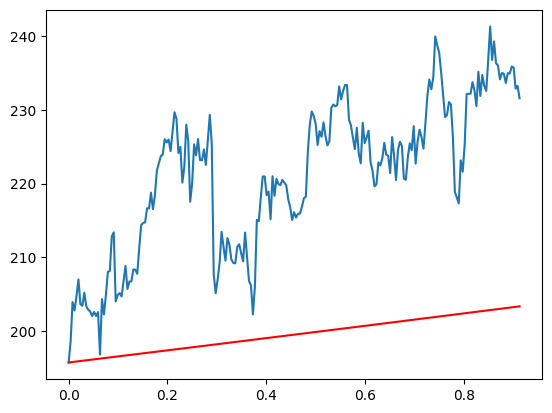

Stock = HSY
S0 =  195.7299957275


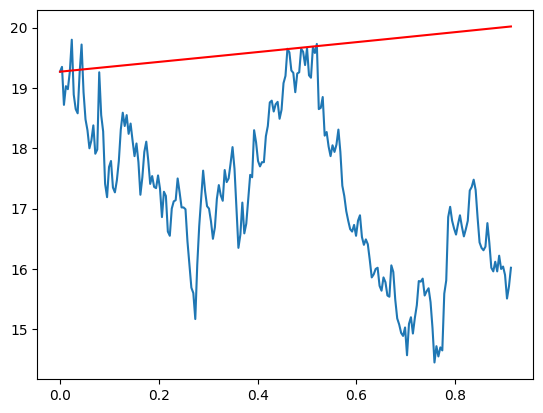

Stock = MGIC
S0 =  19.2700004578


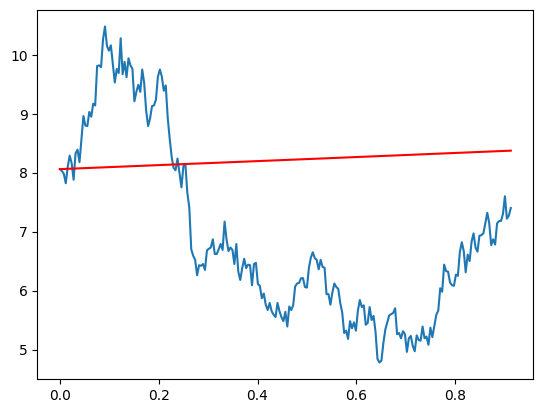

Stock = DRD
S0 =  8.0600004196


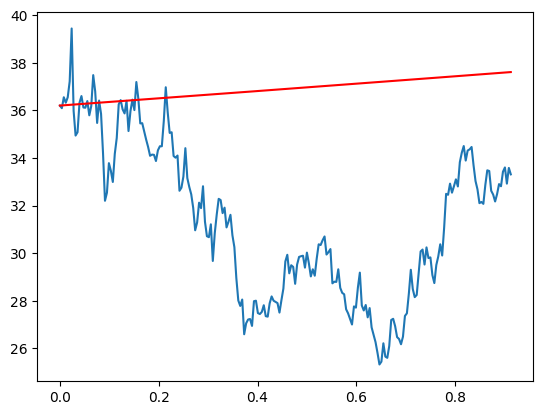

Stock = IPG
S0 =  36.2000007629


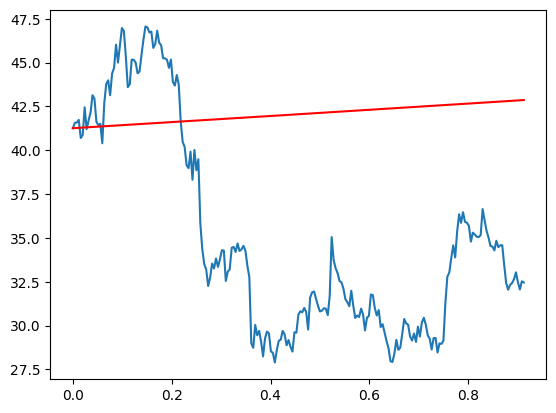

Stock = NYT
S0 =  41.2599983215


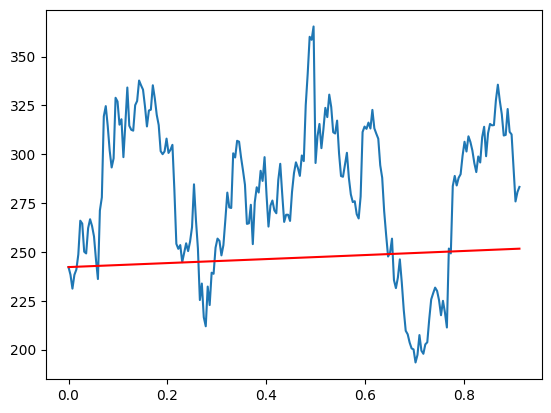

Stock = SEDG
S0 =  242.2299957275


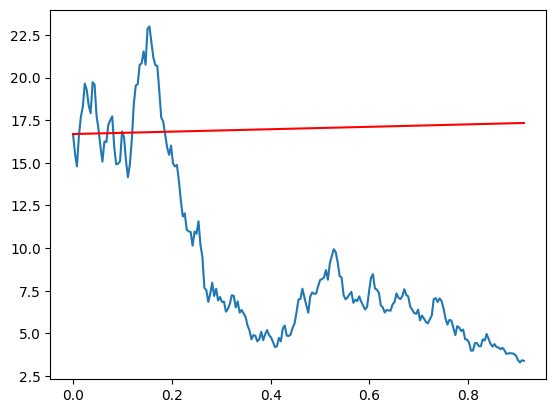

Stock = RIOT
S0 =  16.6900005341


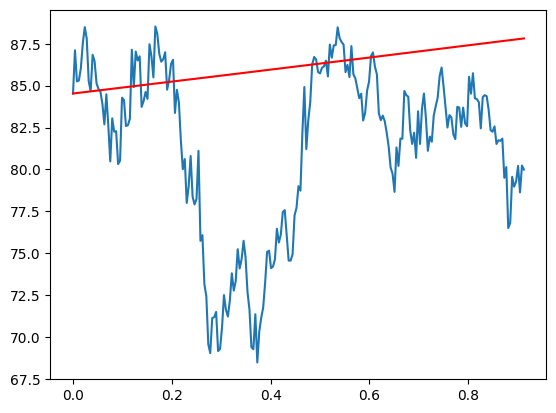

Stock = WNS
S0 =  84.5299987793


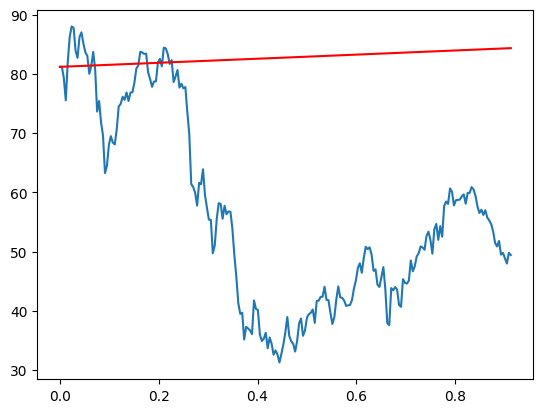

Stock = RCL
S0 =  81.2300033569


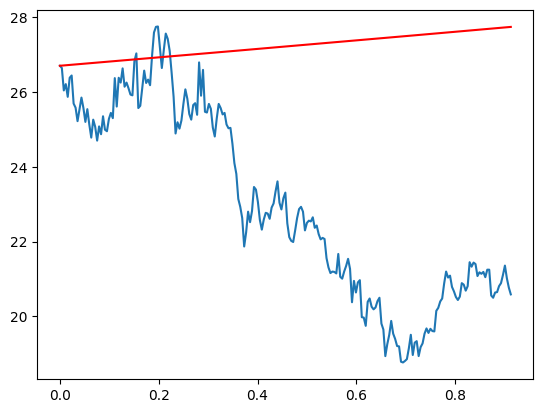

Stock = SKM
S0 =  26.7000007629


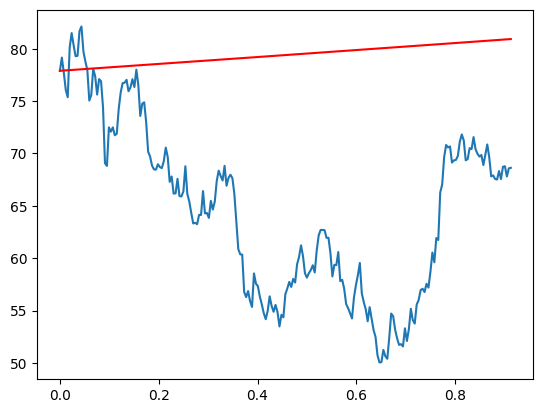

Stock = DD
S0 =  77.8899993896


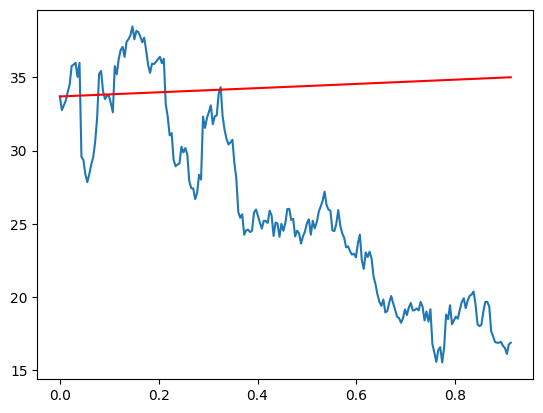

Stock = PARA
S0 =  33.7000007629


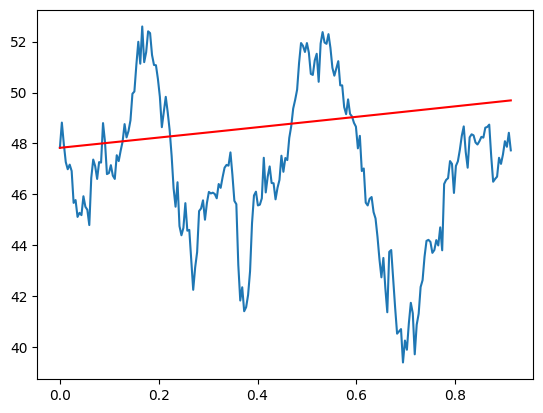

Stock = WTRG
S0 =  47.8300018311


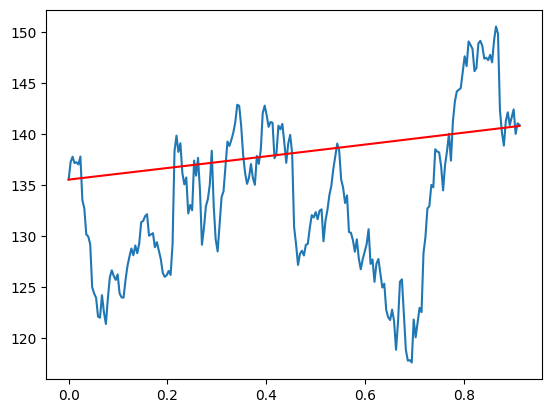

Stock = IBM
S0 =  135.5299987793


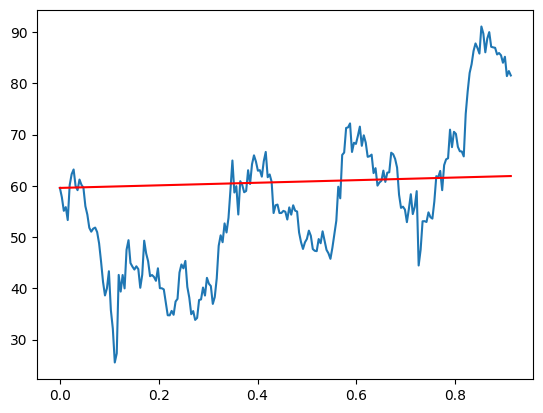

Stock = PDD
S0 =  59.5999984741


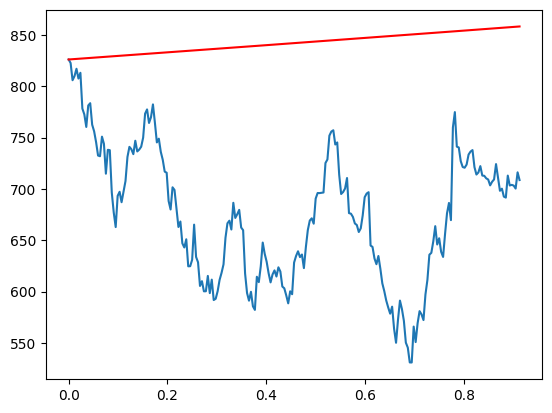

Stock = BLK
S0 =  825.950012207


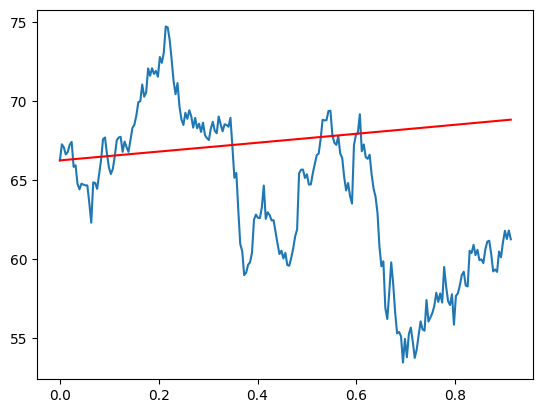

Stock = PEG
S0 =  66.2600021362


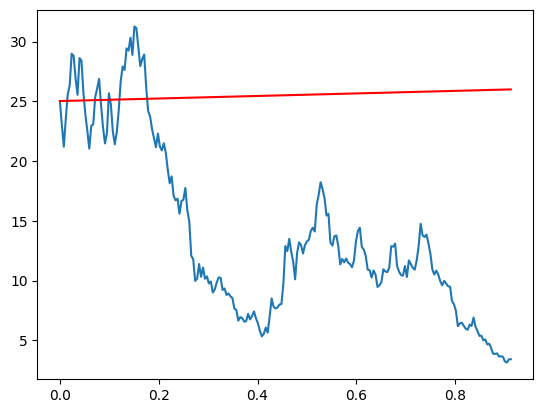

Stock = MARA
S0 =  25.0300006866


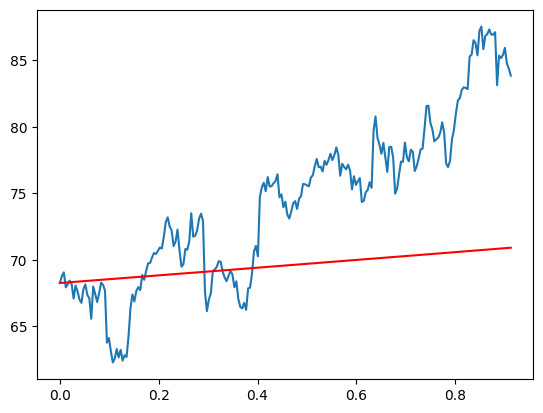

Stock = GIS
S0 =  68.25


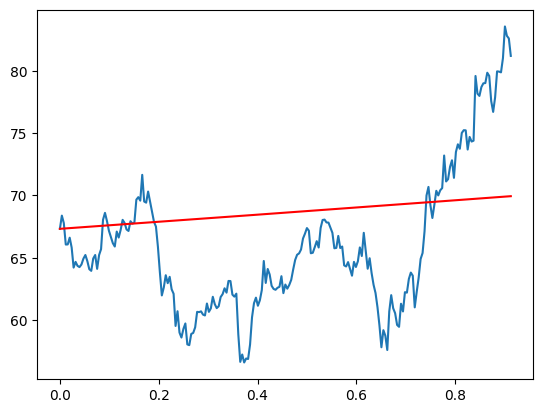

Stock = SJW
S0 =  67.3199996948


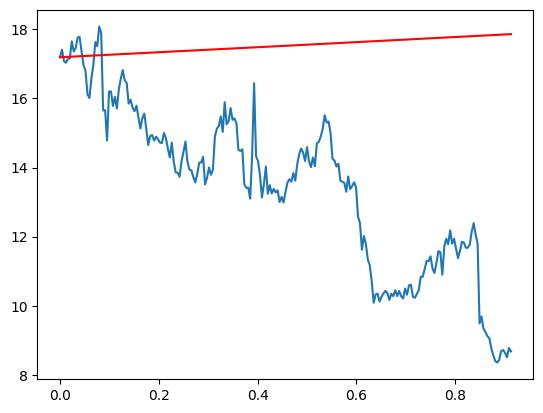

Stock = SWBI
S0 =  17.1900005341


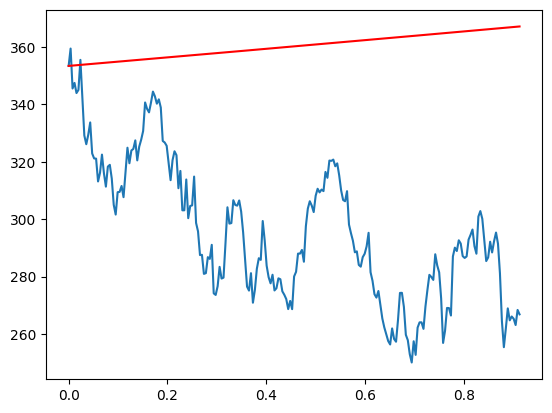

Stock = ACN
S0 =  353.4200134277


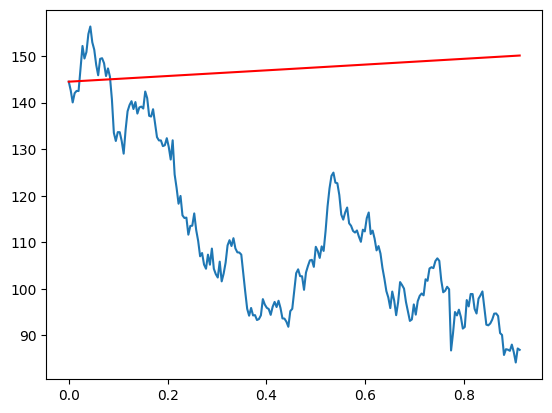

Stock = DIS
S0 =  144.4900054932


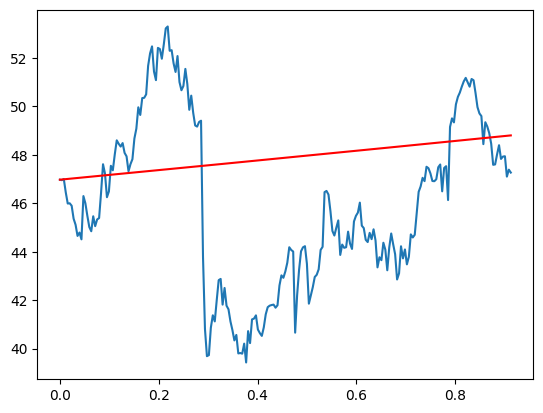

Stock = WMT
S0 =  46.9700012207


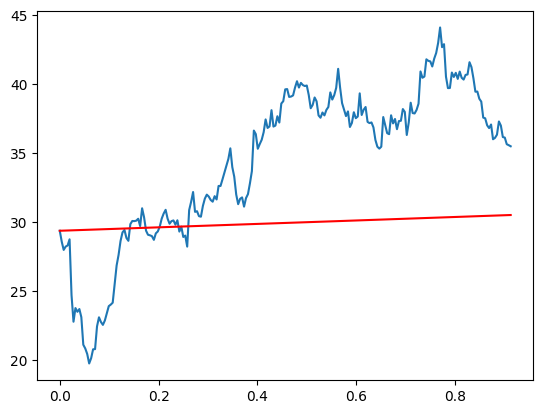

Stock = ATGE
S0 =  29.3700008392


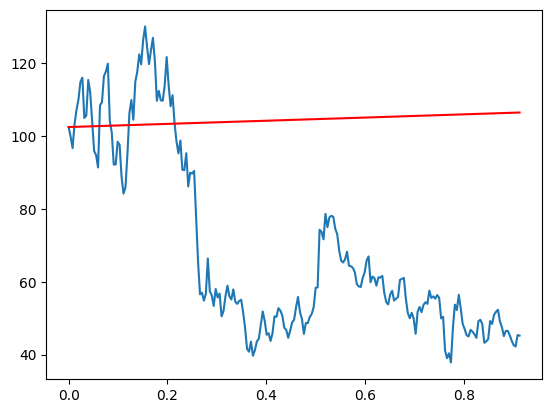

Stock = NET
S0 =  102.4300003052


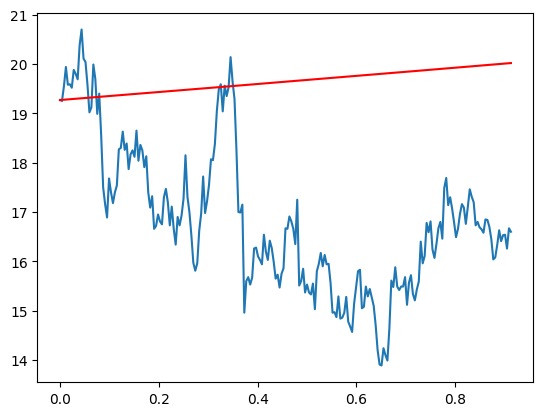

Stock = SLM
S0 =  19.2700004578


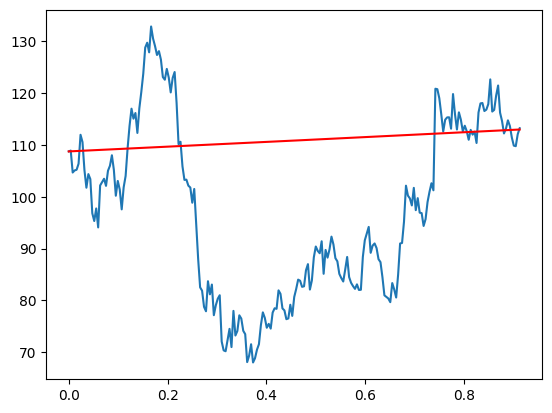

Stock = DXCM
S0 =  108.7600021362


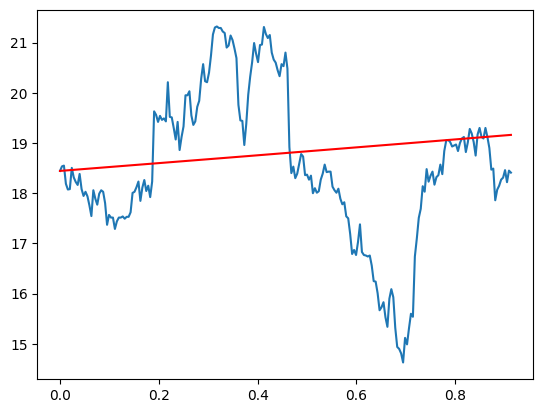

Stock = T
S0 =  18.444108963


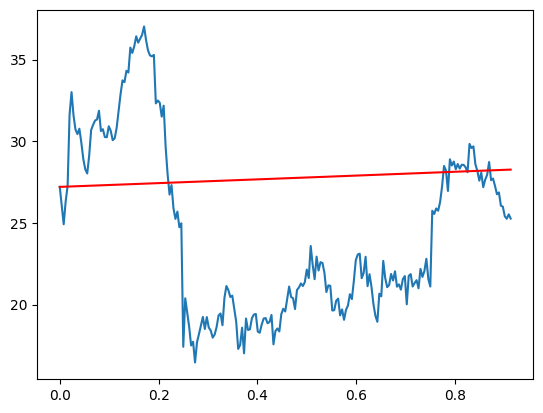

Stock = CHGG
S0 =  27.2099990845


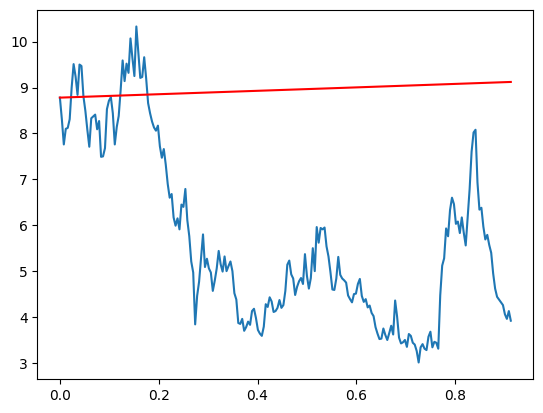

Stock = GRWG
S0 =  8.779999733


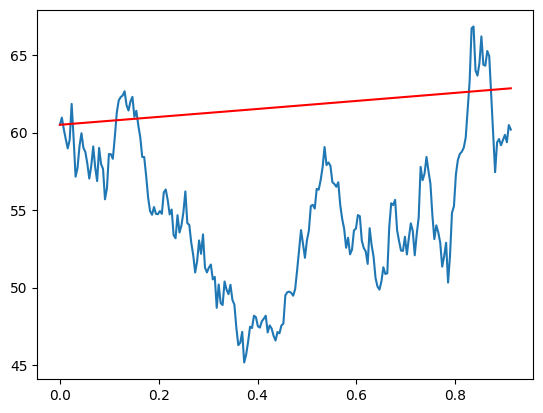

Stock = UHAL
S0 =  60.4990005493


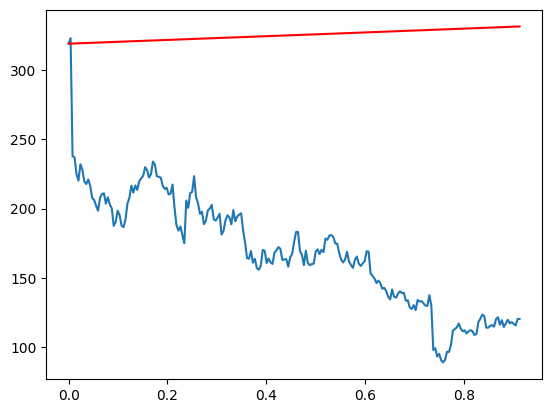

Stock = META
S0 =  319.0


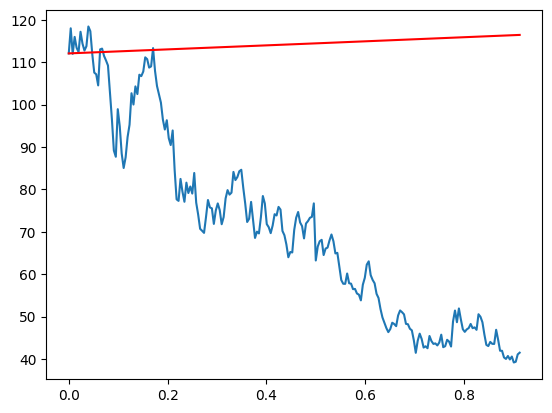

Stock = MTCH
S0 =  112.0899963379


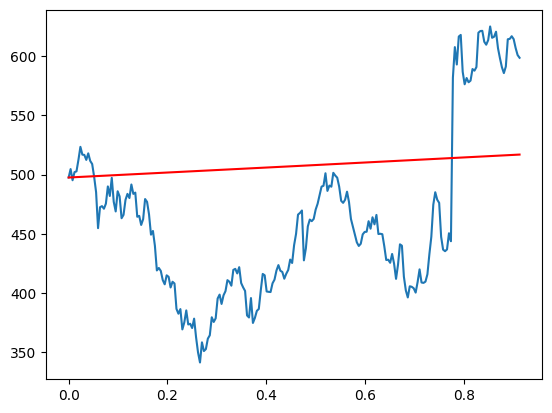

Stock = FICO
S0 =  497.5400085449


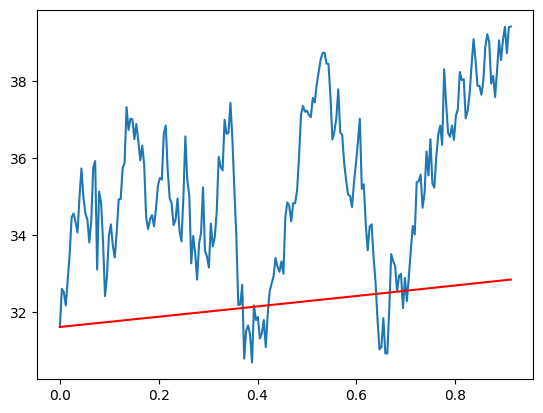

Stock = HWM
S0 =  31.6200008392


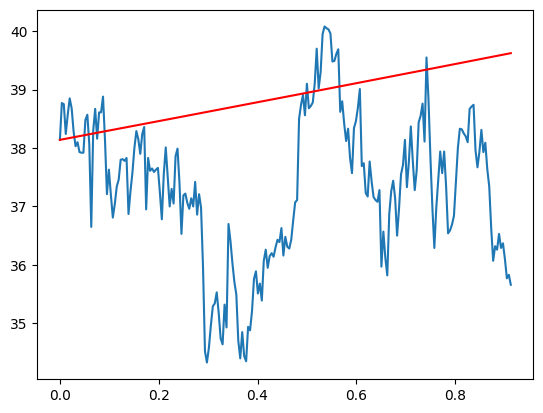

Stock = KDP
S0 =  38.1399993896


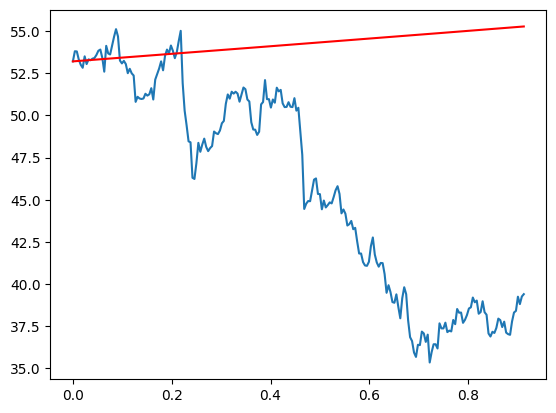

Stock = VZ
S0 =  53.2000007629


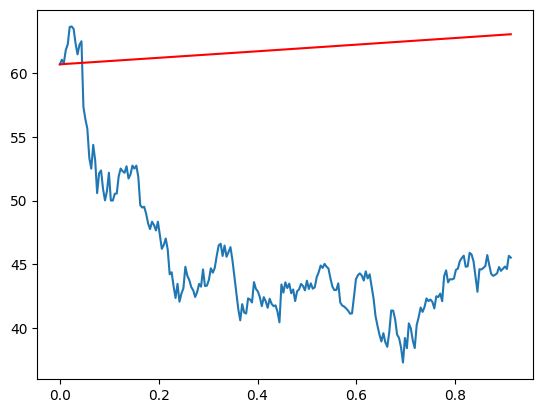

Stock = BK
S0 =  60.6899986267


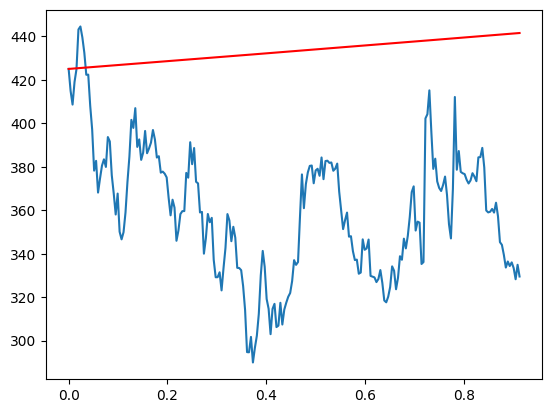

Stock = SAM
S0 =  425.0700073242


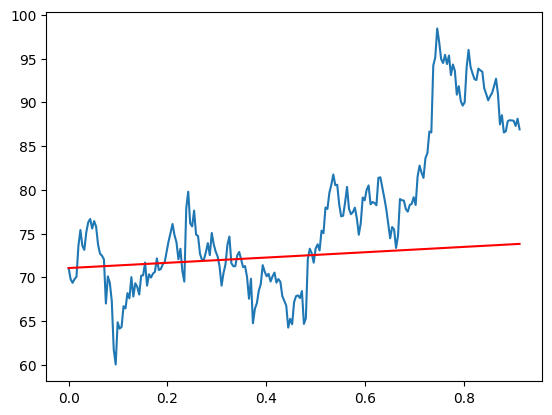

Stock = FCFS
S0 =  71.0500030518


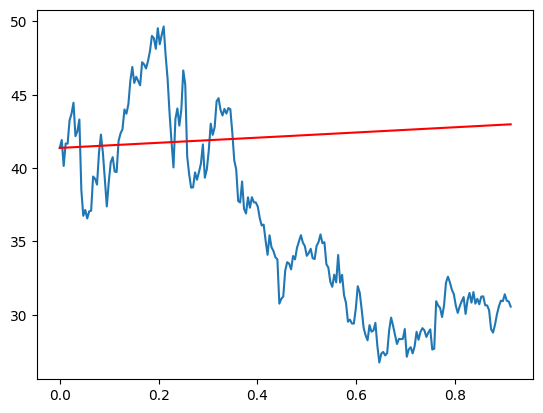

Stock = TX
S0 =  41.3800010681


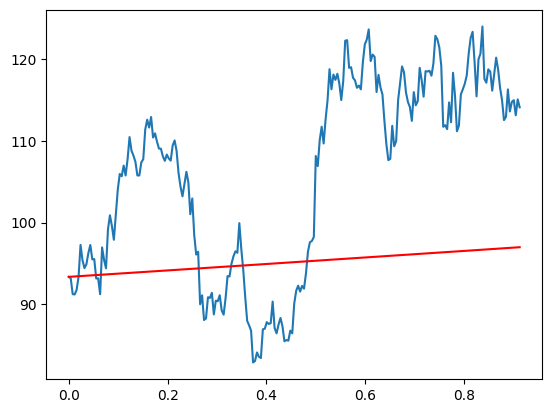

Stock = CLH
S0 =  93.3499984741


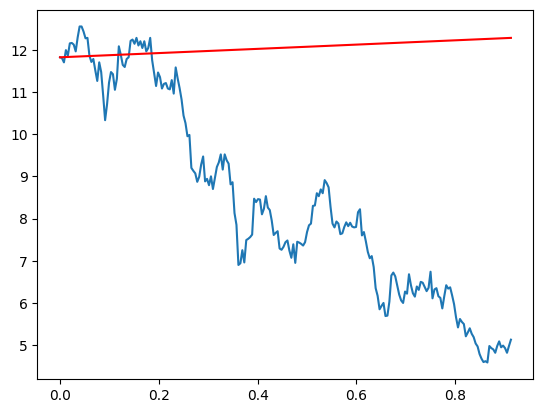

Stock = DESP
S0 =  11.8199996948


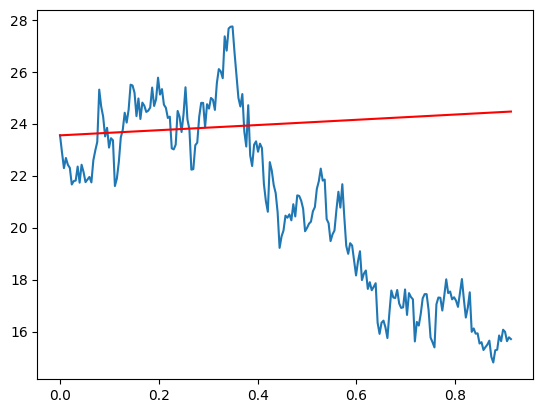

Stock = SSL
S0 =  23.5499992371


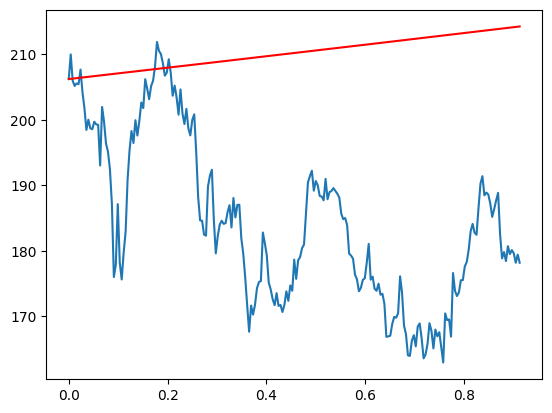

Stock = DEO
S0 =  206.1999969482


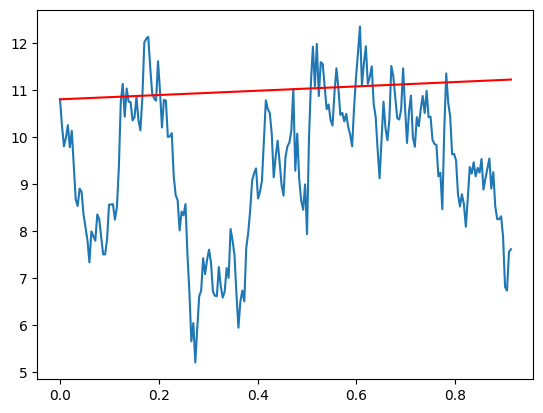

Stock = BBIO
S0 =  10.8100004196


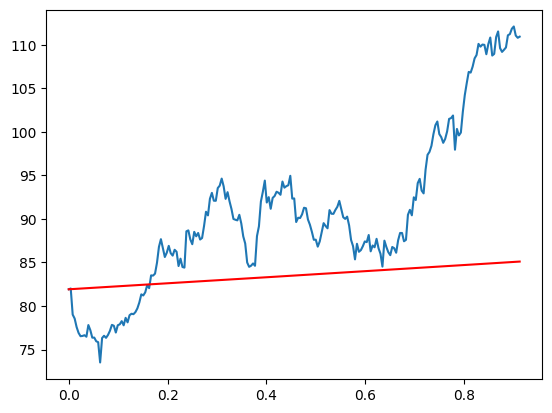

Stock = MRK
S0 =  81.9199981689


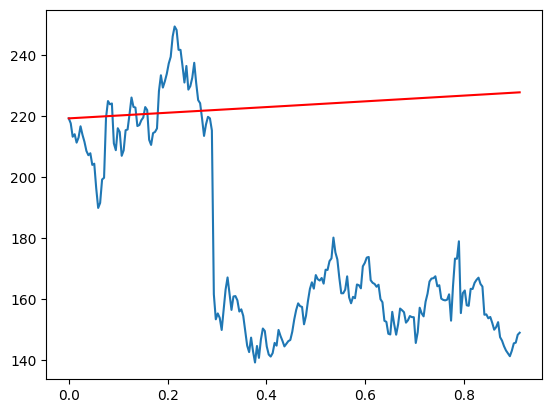

Stock = TGT
S0 =  219.2299957275


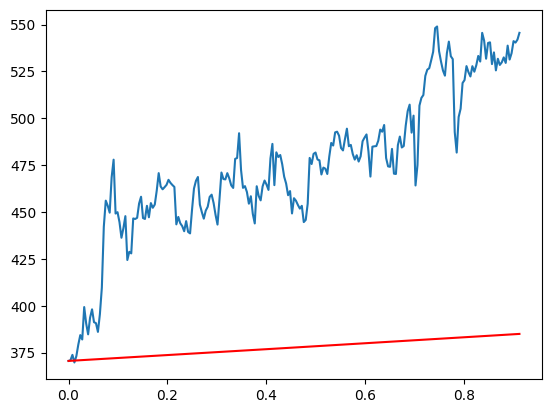

Stock = NOC
S0 =  370.5799865723


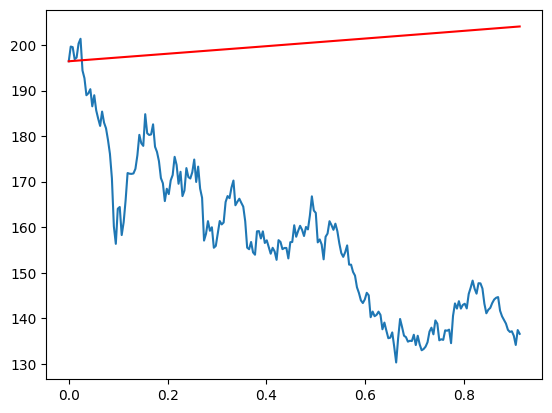

Stock = TM
S0 =  196.4299926758


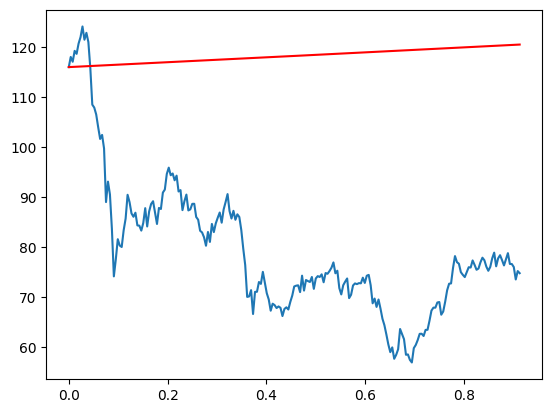

Stock = RYAAY
S0 =  116.0


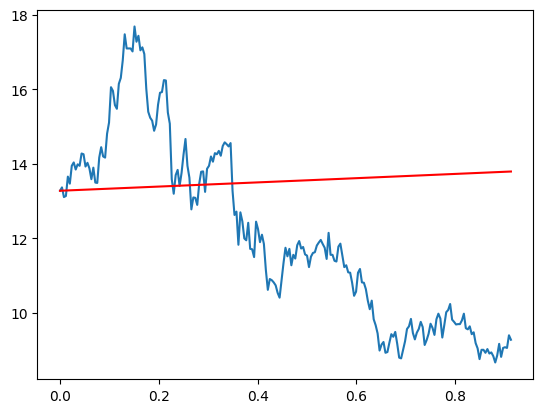

Stock = CMRE
S0 =  13.279999733


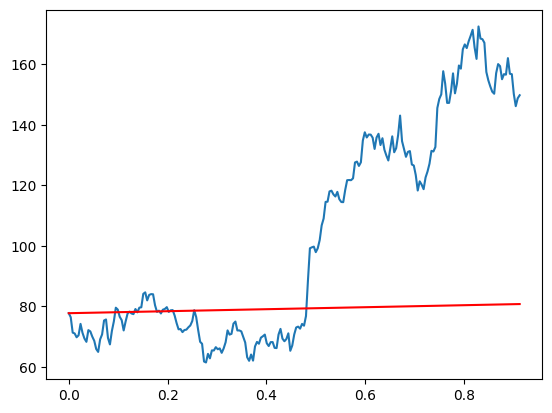

Stock = FSLR
S0 =  77.6999969482


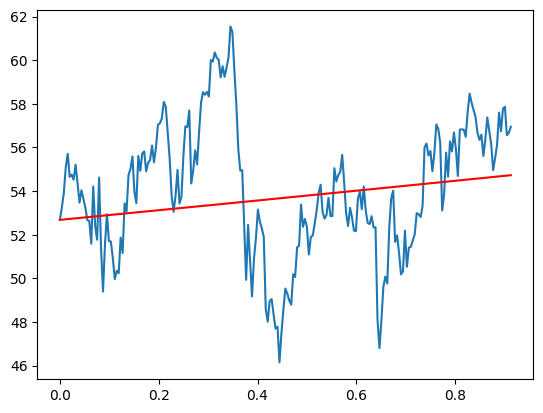

Stock = SHEL
S0 =  52.6800003052


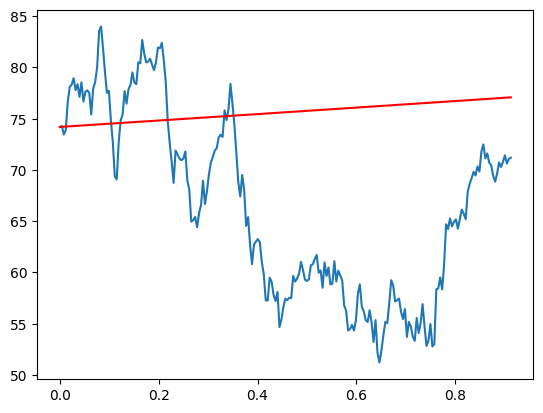

Stock = RIO
S0 =  74.1999969482


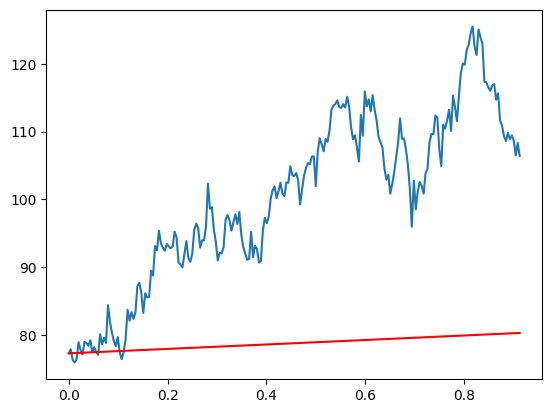

Stock = MGPI
S0 =  77.2900009155


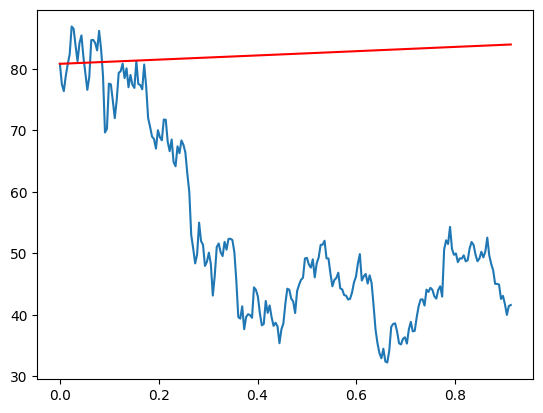

Stock = CZR
S0 =  80.8000030518


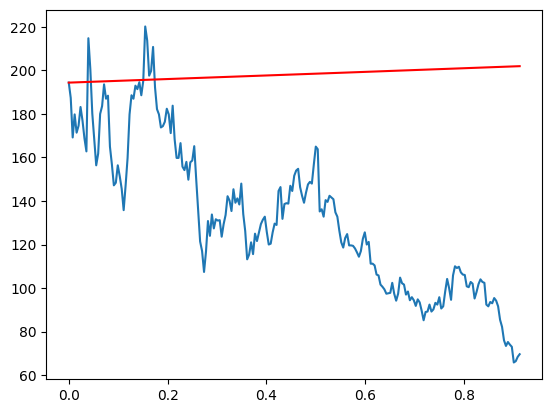

Stock = SPCE
S0 =  194.3999938965


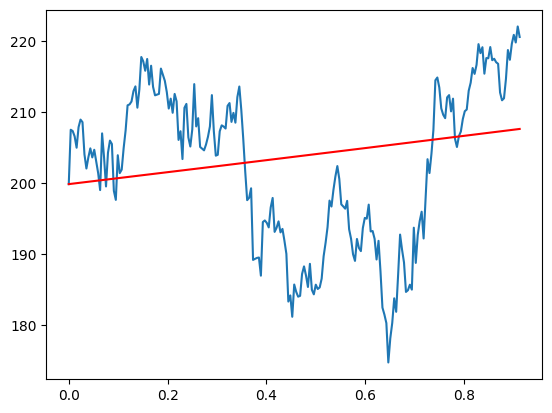

Stock = CB
S0 =  199.8699951172


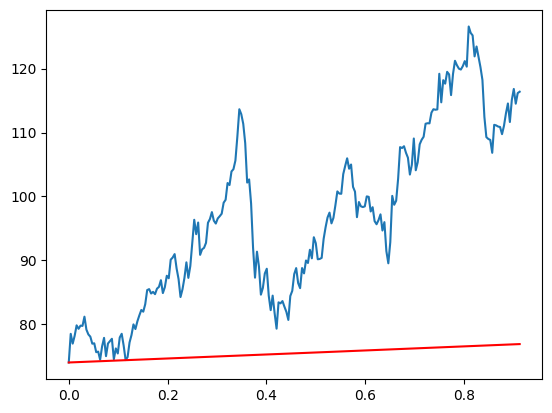

Stock = MPC
S0 =  74.0199966431


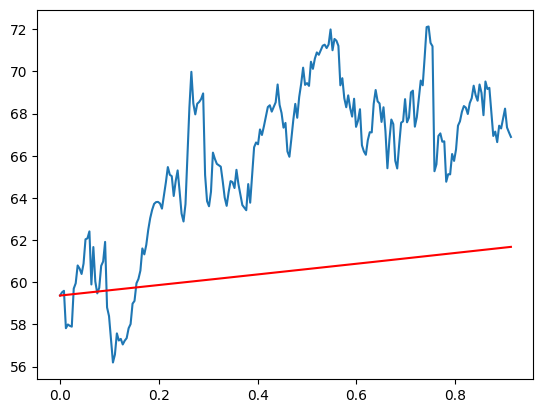

Stock = K
S0 =  59.370891571


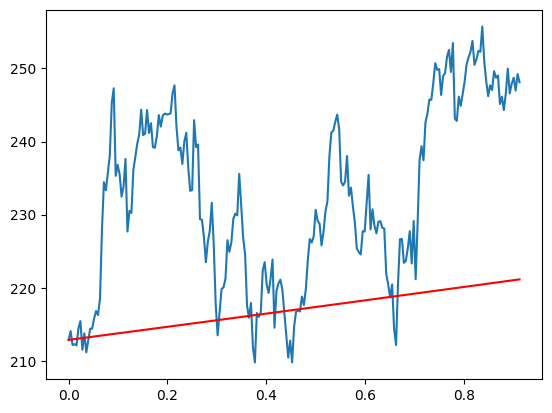

Stock = GD
S0 =  212.8699951172


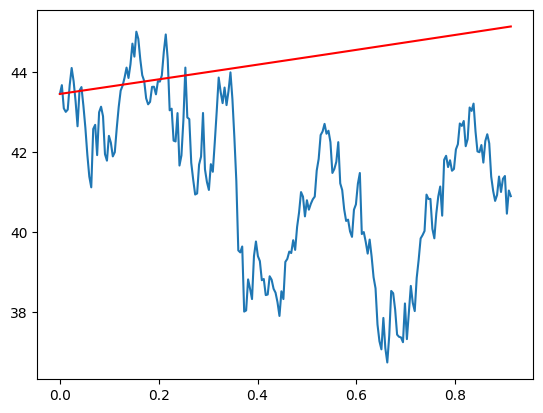

Stock = PY
S0 =  43.4599990845


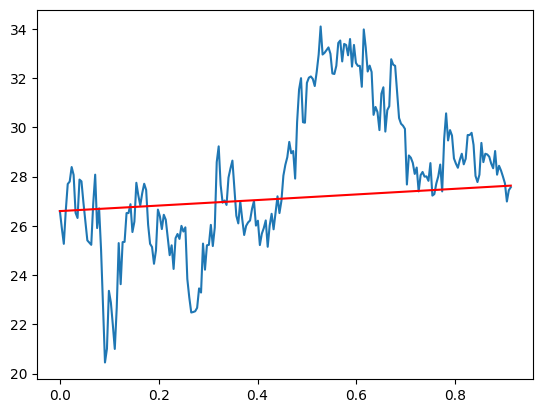

Stock = MMYT
S0 =  26.6000003815


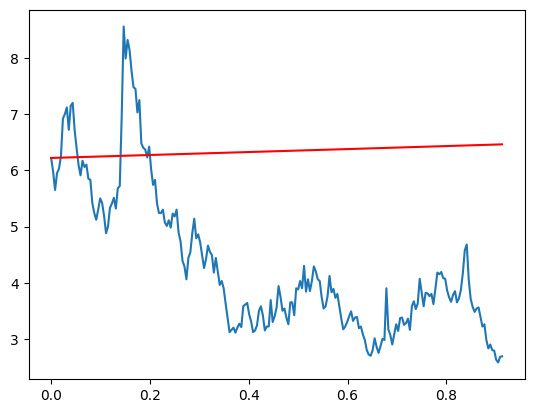

Stock = TLRY
S0 =  6.2199997902


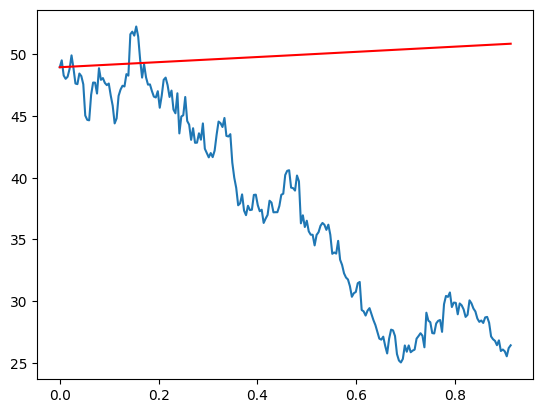

Stock = INTC
S0 =  48.9500007629


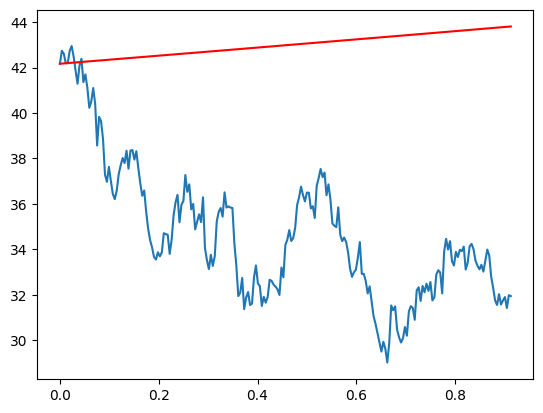

Stock = GLW
S0 =  42.1699981689


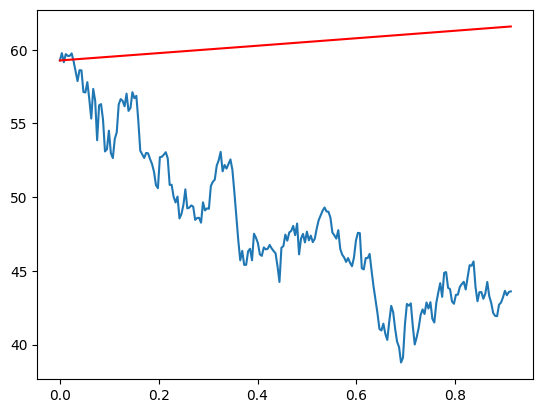

Stock = USB
S0 =  59.2700004578


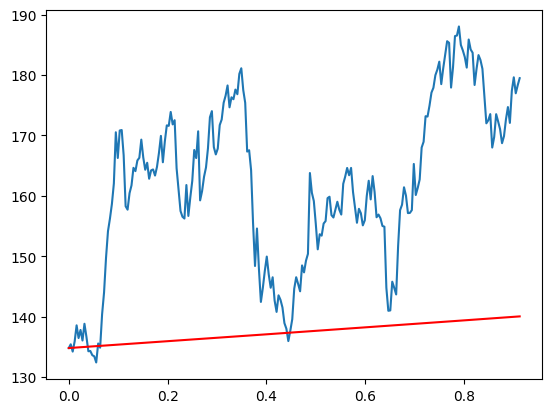

Stock = CVX
S0 =  134.7899932861


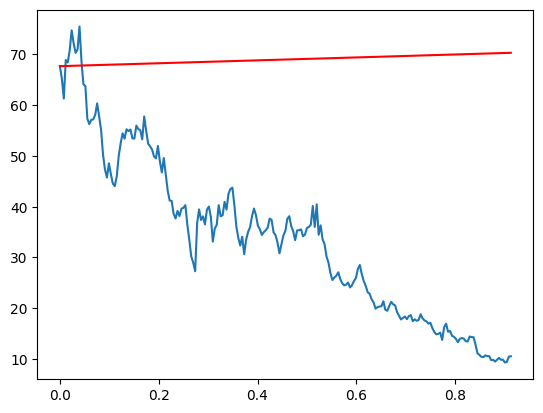

Stock = APP
S0 =  67.6900024414


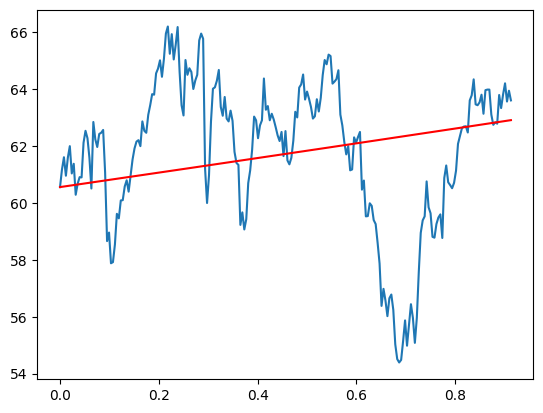

Stock = KO
S0 =  60.5600013733


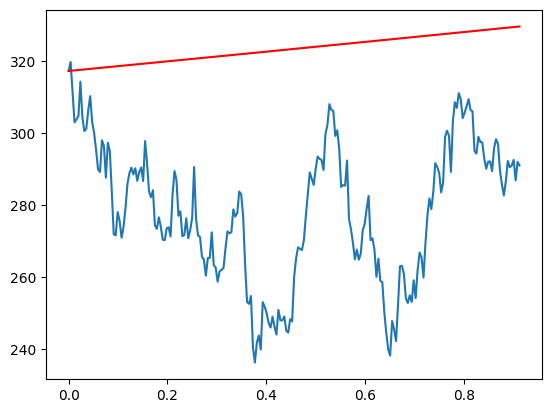

Stock = PH
S0 =  317.2099914551


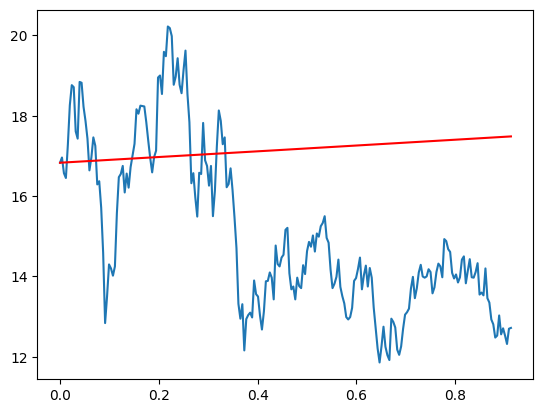

Stock = AAL
S0 =  16.8299999237


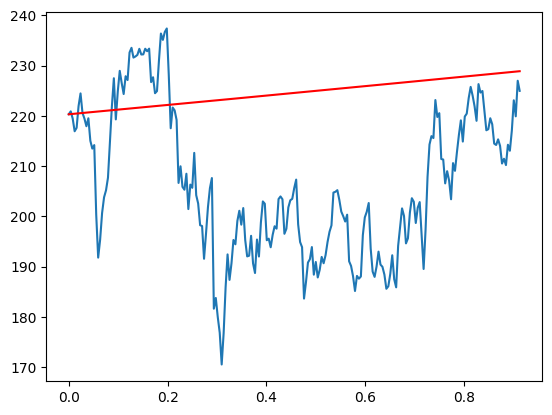

Stock = TSCO
S0 =  220.3099975586


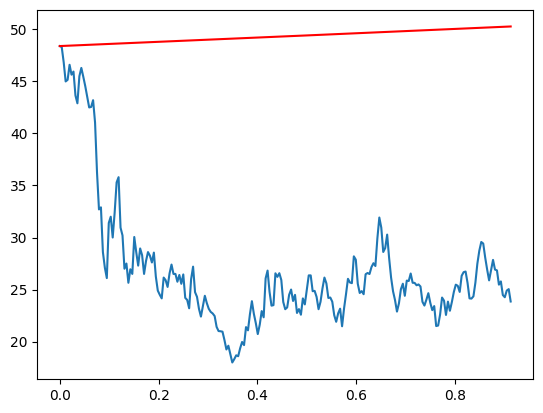

Stock = SCO
S0 =  48.4000015259


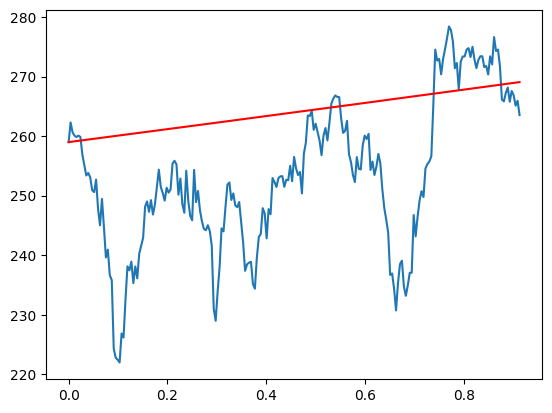

Stock = MCD
S0 =  258.9899902344


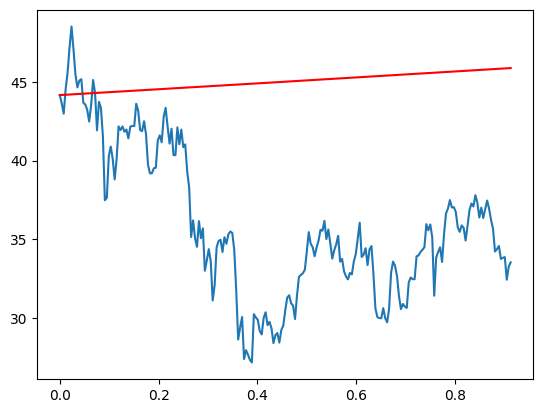

Stock = MGM
S0 =  44.1599998474


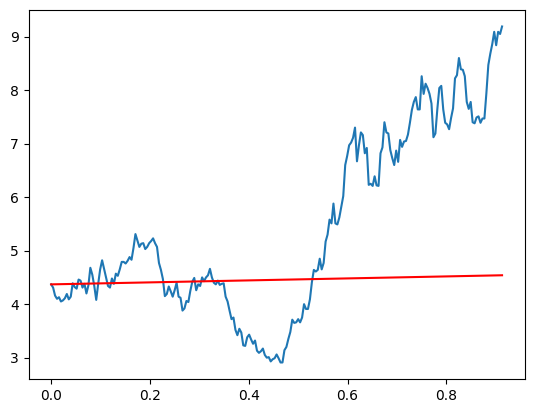

Stock = YPF
S0 =  4.3699998856


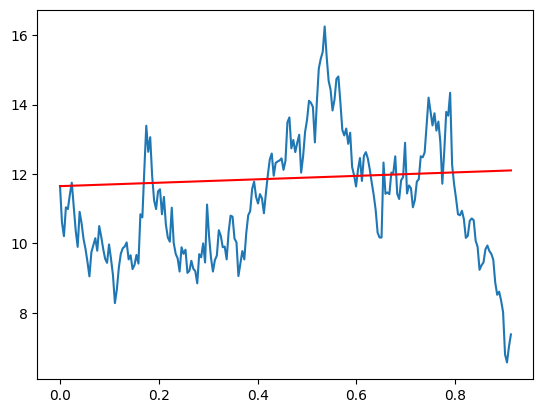

Stock = NNOX
S0 =  11.6499996185


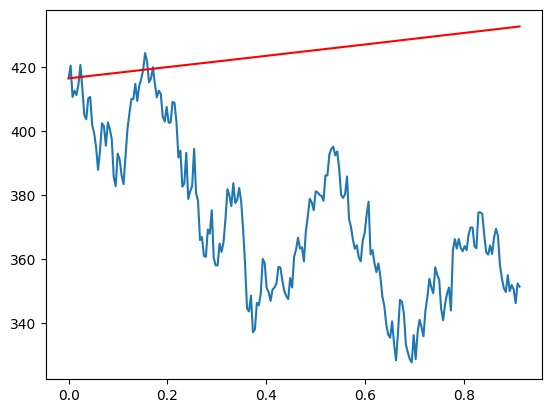

Stock = VOO
S0 =  416.3900146484


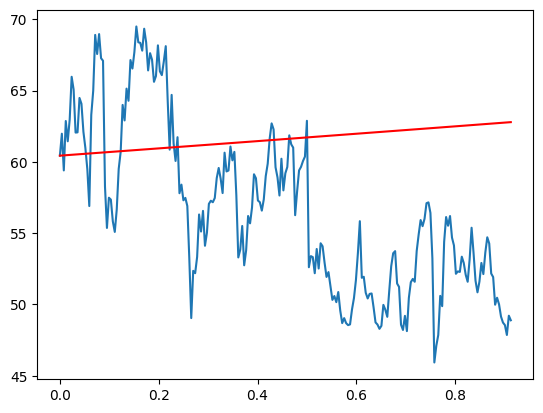

Stock = FTNT
S0 =  60.436000824


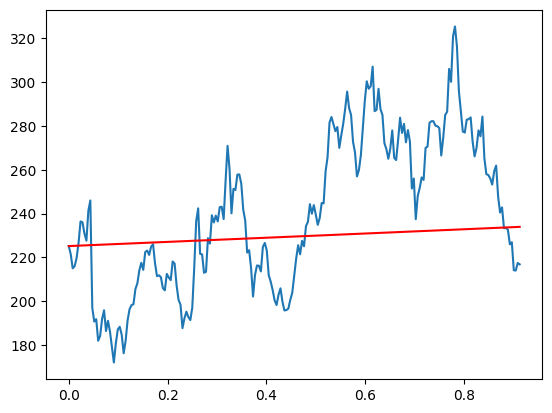

Stock = ALB
S0 =  225.1999969482


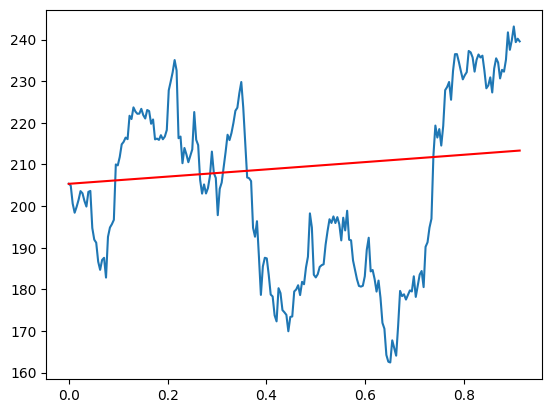

Stock = CAT
S0 =  205.3500061035


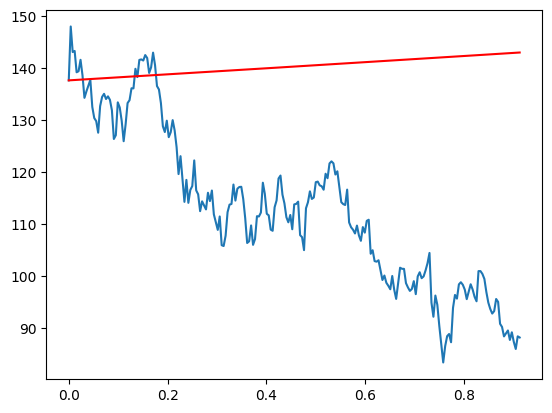

Stock = GOOGL
S0 =  137.6439971924


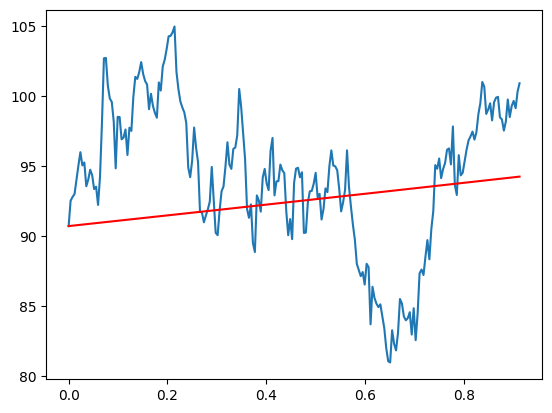

Stock = RTX
S0 =  90.7300033569


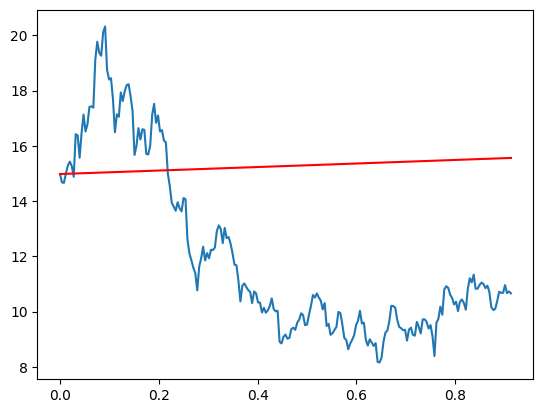

Stock = SBSW
S0 =  14.9799995422


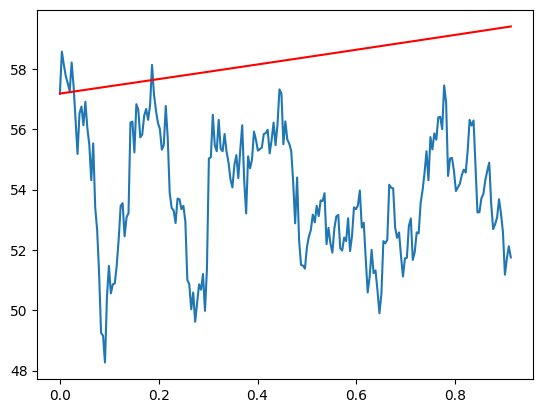

Stock = RDY
S0 =  57.1800003052


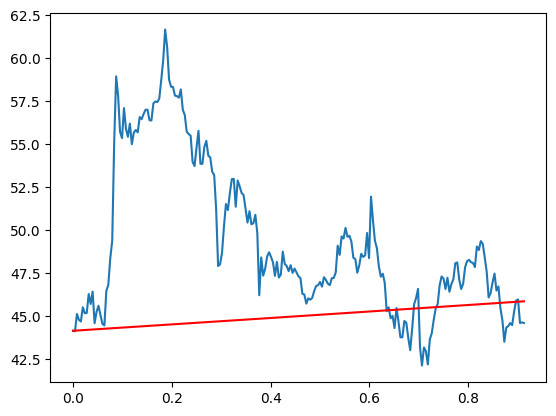

Stock = KR
S0 =  44.1300010681


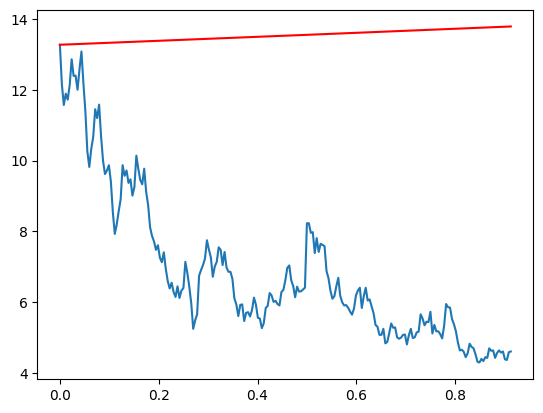

Stock = SOFI
S0 =  13.2700004578


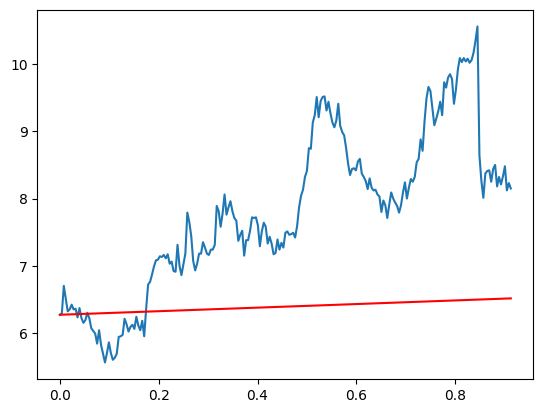

Stock = EZPW
S0 =  6.2699999809


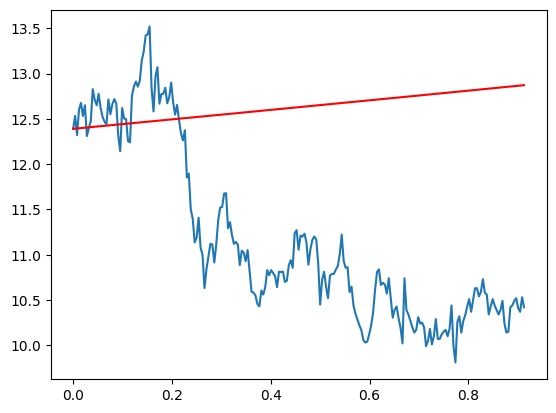

Stock = NTDOY
S0 =  12.3900003433


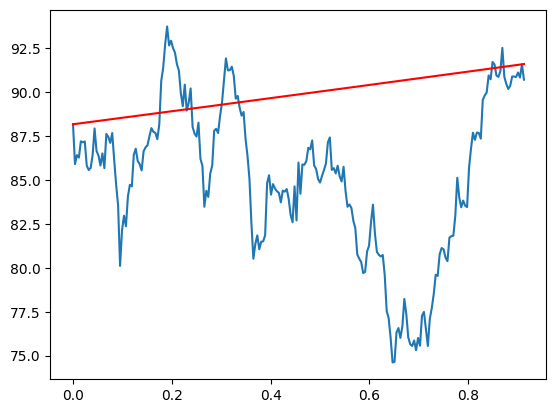

Stock = NVS
S0 =  88.1800003052


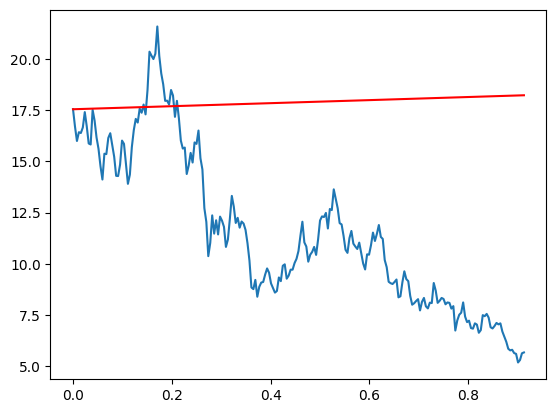

Stock = QS
S0 =  17.5400009155


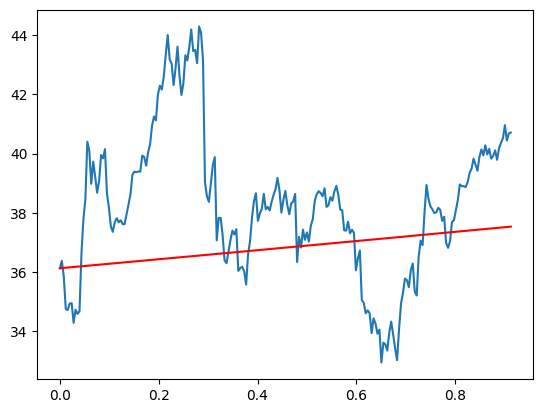

Stock = KHC
S0 =  36.1300010681


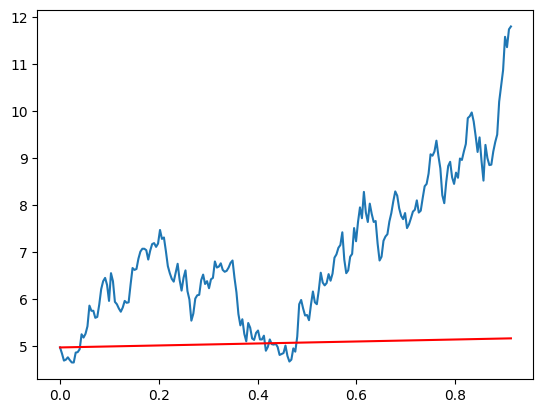

Stock = TGS
S0 =  4.9699997902


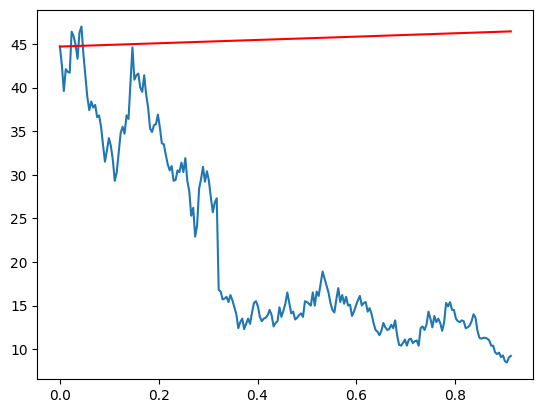

Stock = ACB
S0 =  44.7000007629


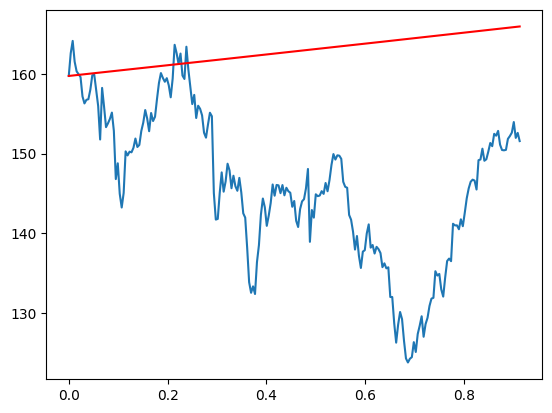

Stock = PG
S0 =  159.7400054932


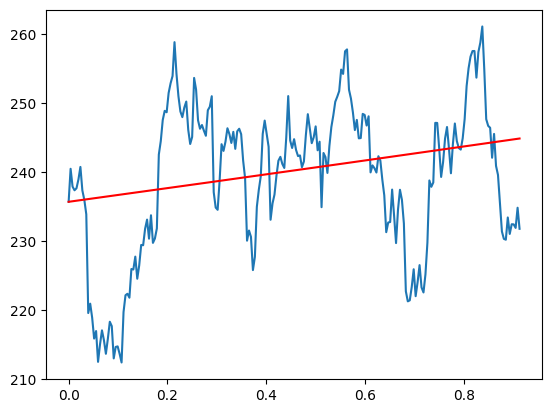

Stock = STZ
S0 =  235.6600036621


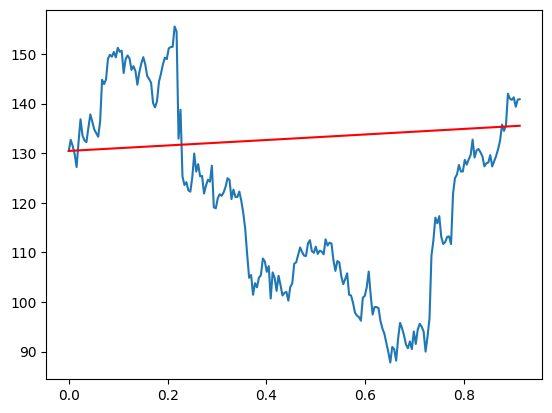

Stock = UHS
S0 =  130.4600067139


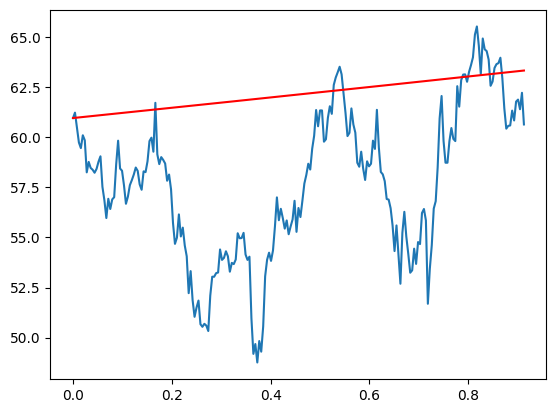

Stock = CWT
S0 =  60.9599990845


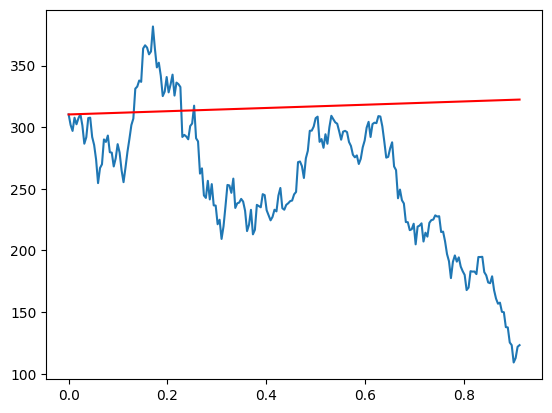

Stock = TSLA
S0 =  310.4166564941


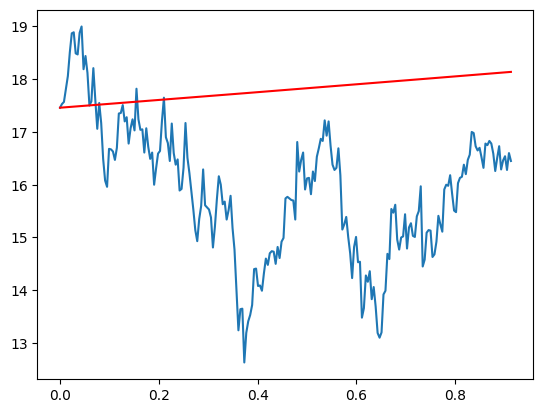

Stock = NAVI
S0 =  17.4599990845


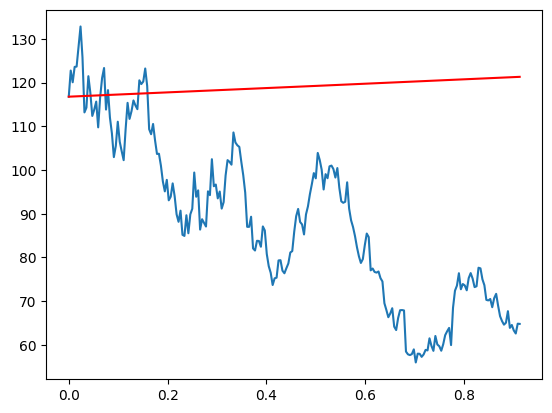

Stock = AMD
S0 =  116.7799987793


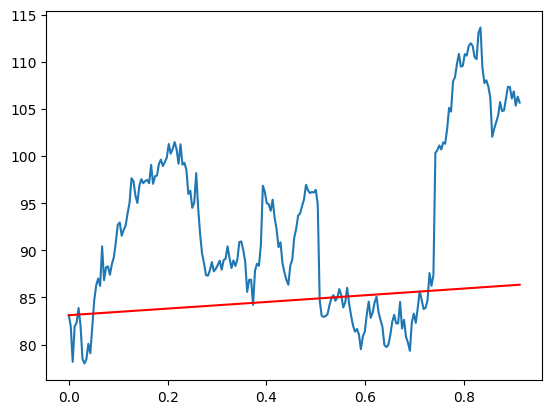

Stock = LOPE
S0 =  83.1200027466


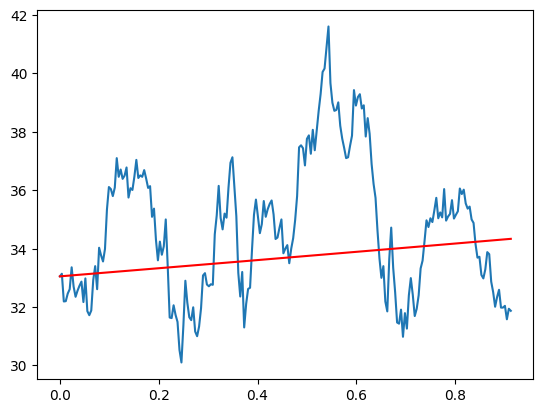

Stock = CWEN
S0 =  33.0499992371


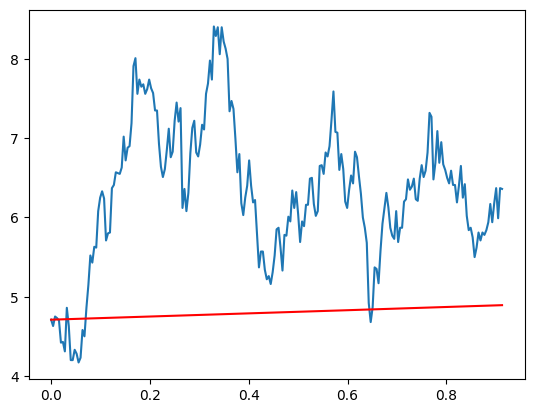

Stock = KOS
S0 =  4.7100000381000005


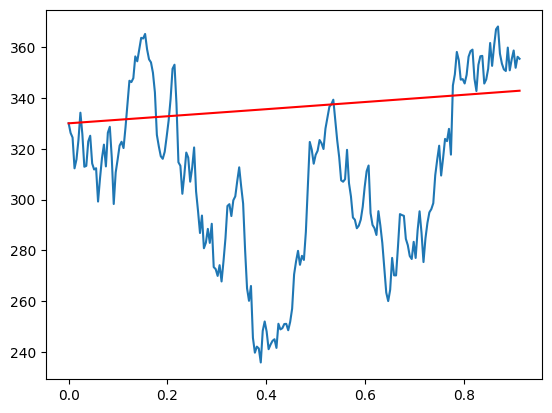

Stock = URI
S0 =  330.0100097656


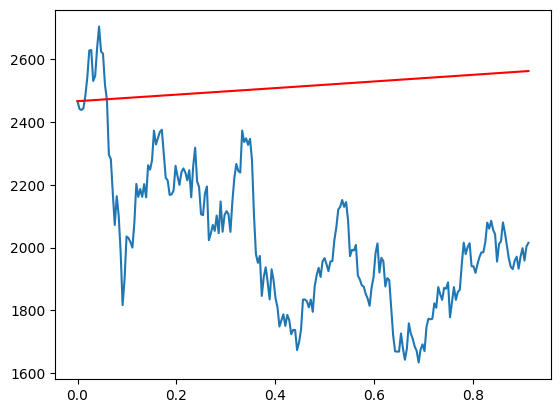

Stock = BKNG
S0 =  2465.6398925781


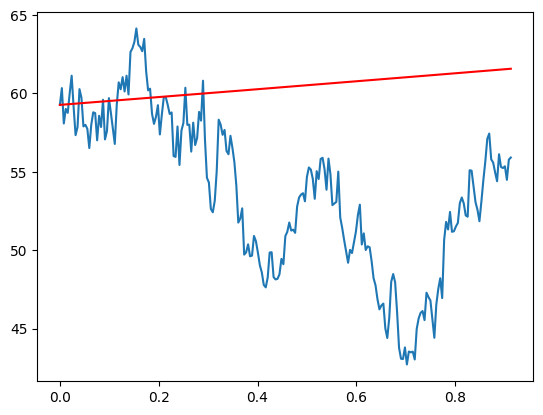

Stock = AVGO
S0 =  59.2719993591


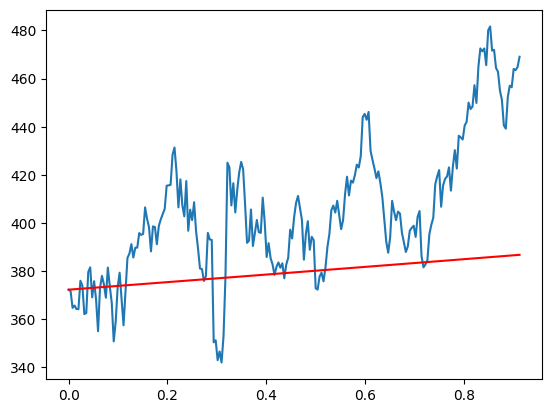

Stock = ULTA
S0 =  372.3200073242


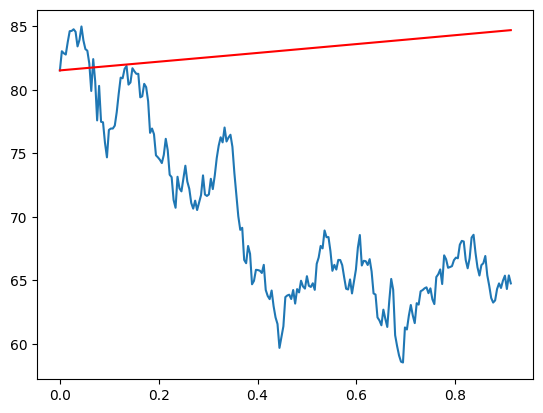

Stock = TD
S0 =  81.5400009155


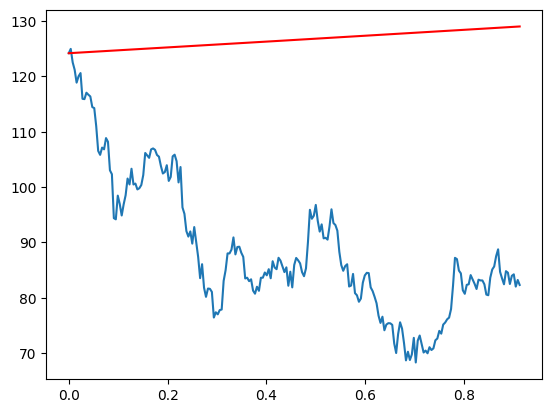

Stock = PZZA
S0 =  124.1900024414


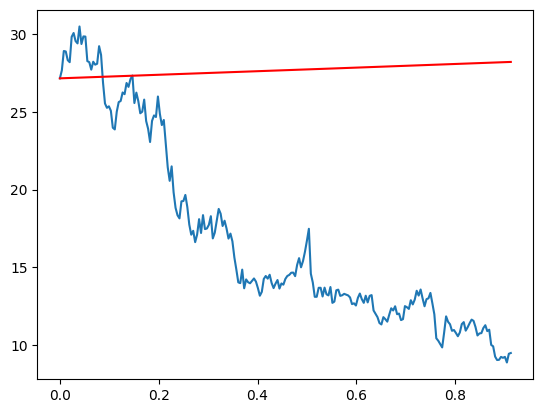

Stock = WBD
S0 =  27.1700000763


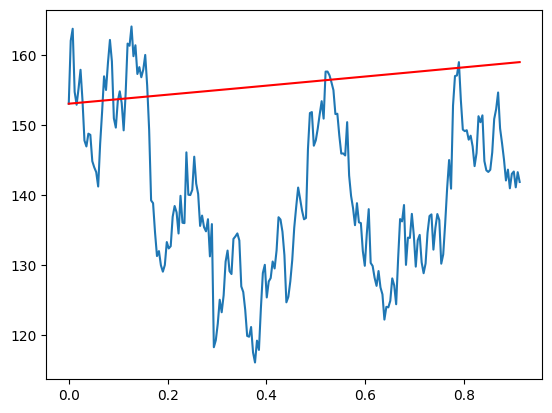

Stock = ODFL
S0 =  153.0950012207


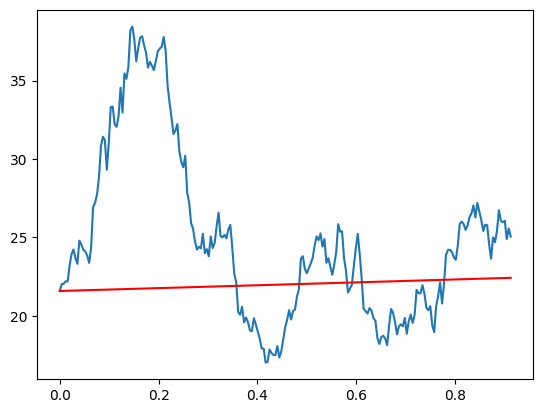

Stock = X
S0 =  21.5799999237


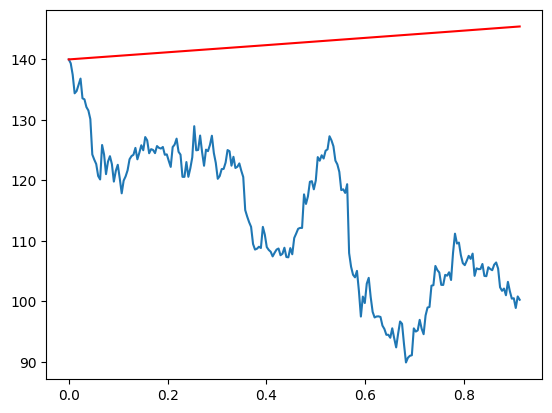

Stock = MMM
S0 =  139.9916381836


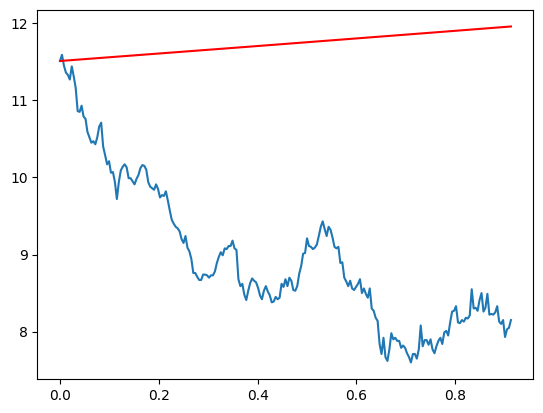

Stock = BWG
S0 =  11.5100002289


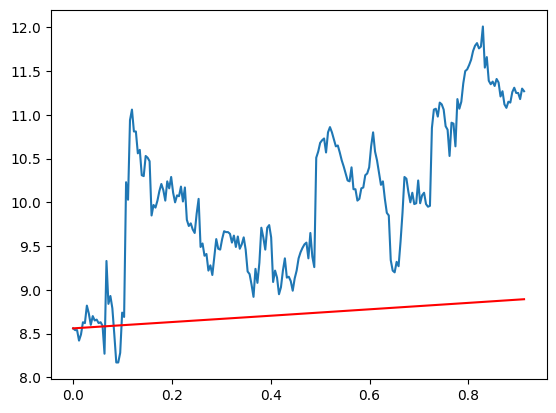

Stock = PSO
S0 =  8.5600004196


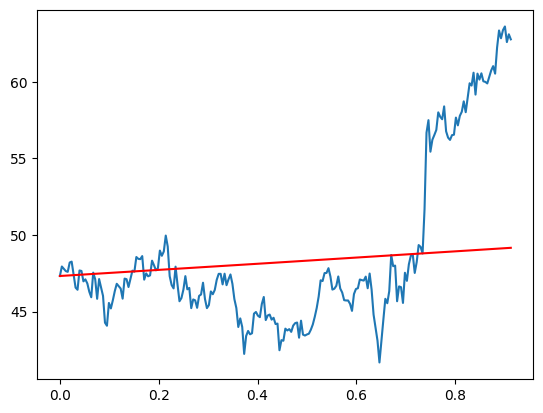

Stock = ACGL
S0 =  47.3199996948


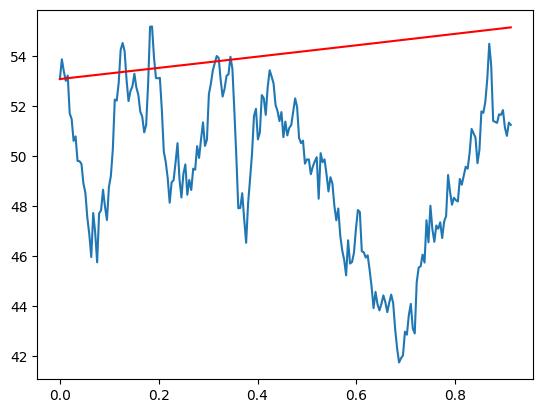

Stock = PFE
S0 =  53.0699996948


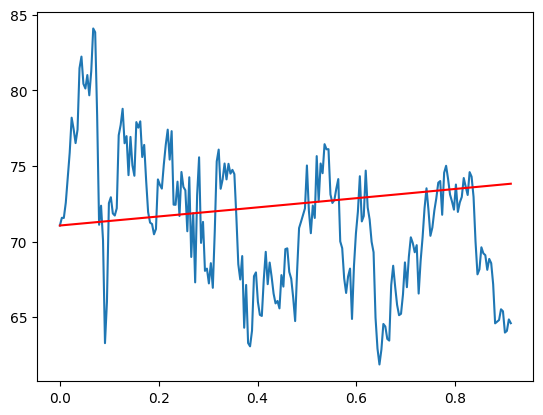

Stock = DIN
S0 =  71.0599975586


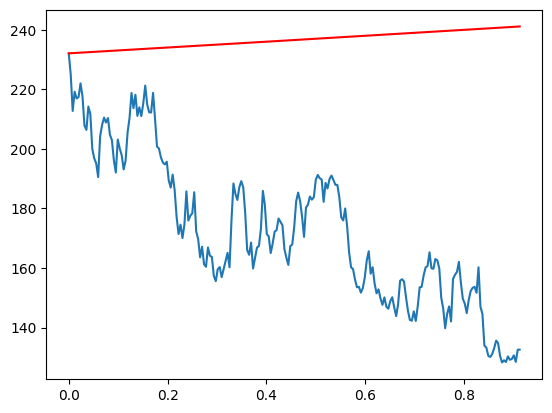

Stock = CRM
S0 =  232.1199951172


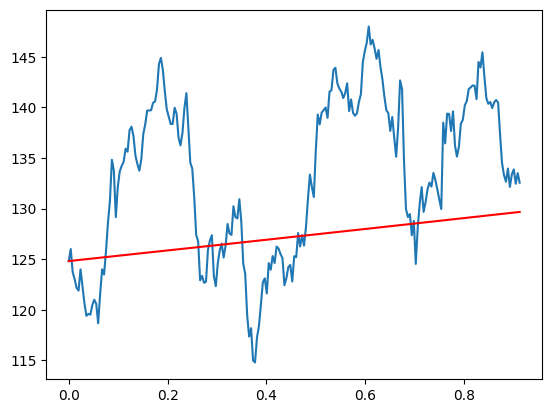

Stock = WCN
S0 =  124.8199996948


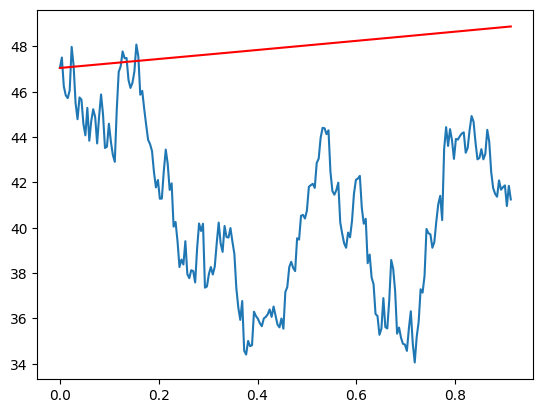

Stock = CARR
S0 =  47.0499992371


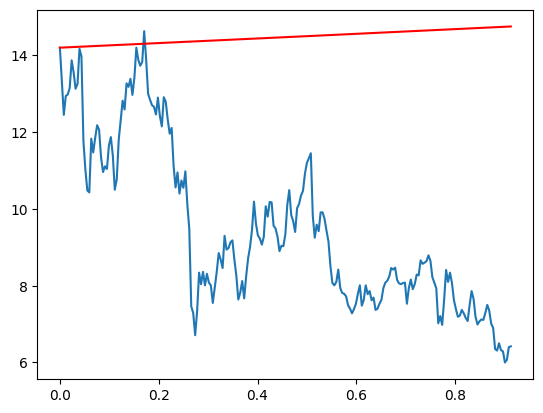

Stock = PLTR
S0 =  14.1999998093


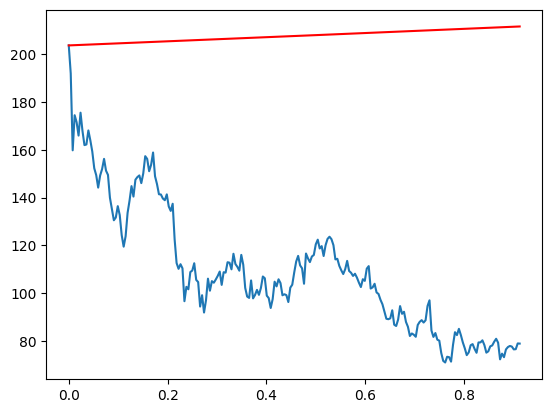

Stock = SPOT
S0 =  203.6199951172


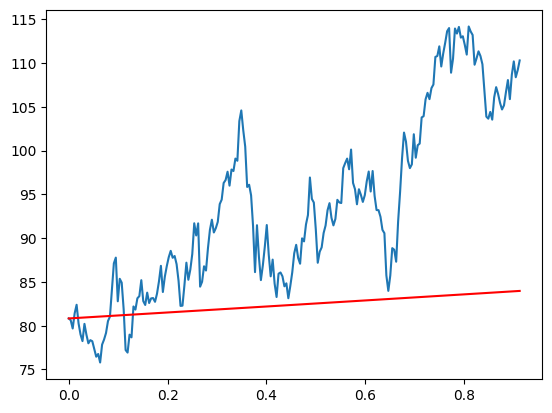

Stock = XOM
S0 =  80.8300018311


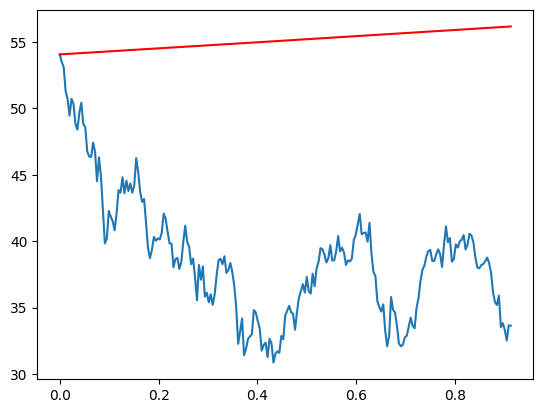

Stock = GM
S0 =  54.0699996948


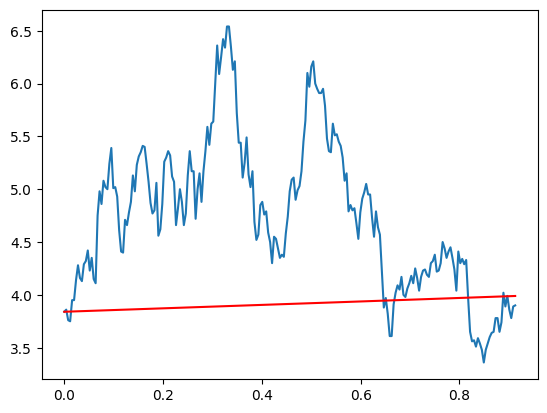

Stock = DSX
S0 =  3.8399999142


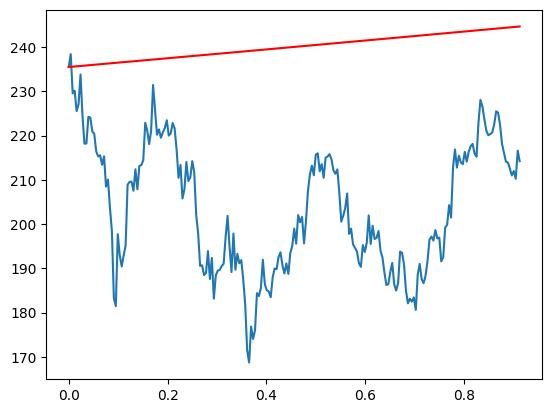

Stock = RACE
S0 =  235.4900054932


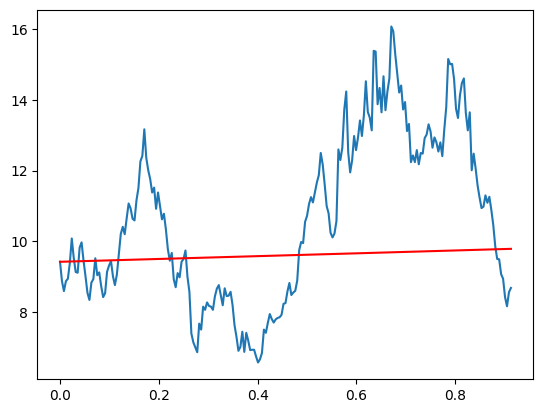

Stock = FREY
S0 =  9.4200000763


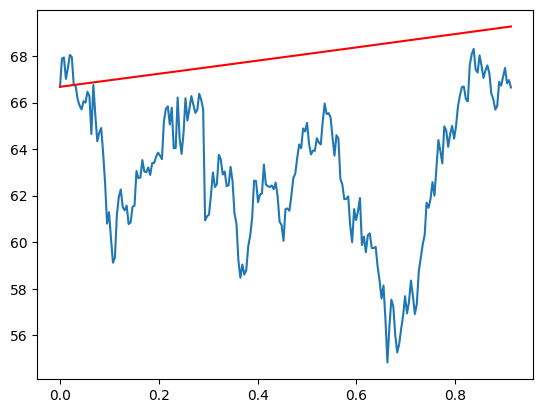

Stock = MDLZ
S0 =  66.6800003052


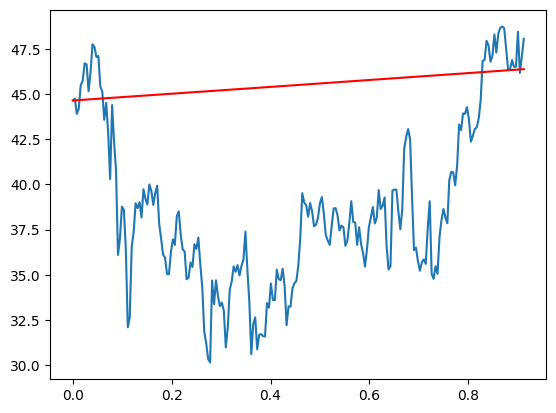

Stock = LVS
S0 =  44.6500015259


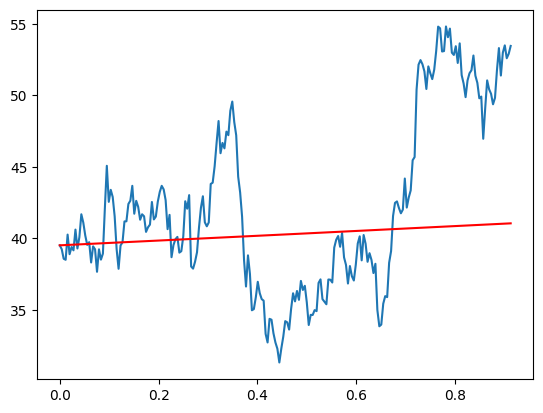

Stock = SLB
S0 =  39.5200004578


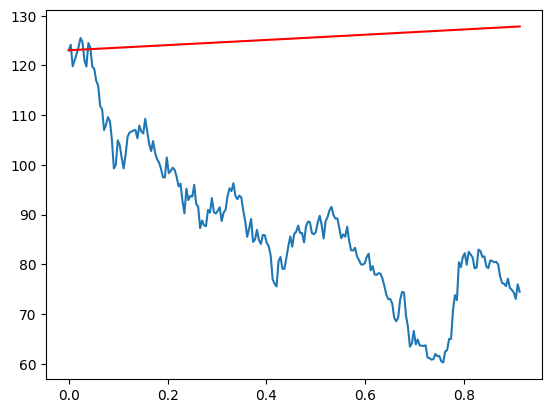

Stock = TSM
S0 =  123.0500030518


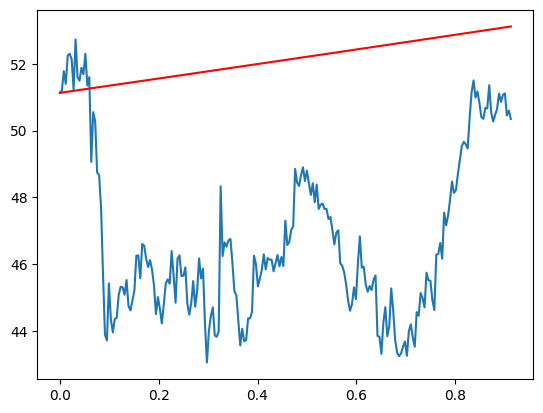

Stock = UL
S0 =  51.1300010681


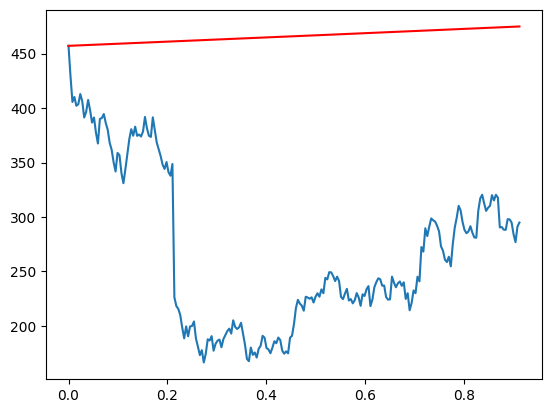

Stock = NFLX
S0 =  457.1300048828


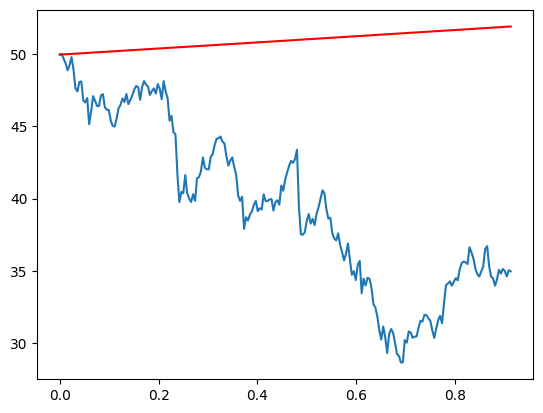

Stock = CMCSA
S0 =  49.9399986267


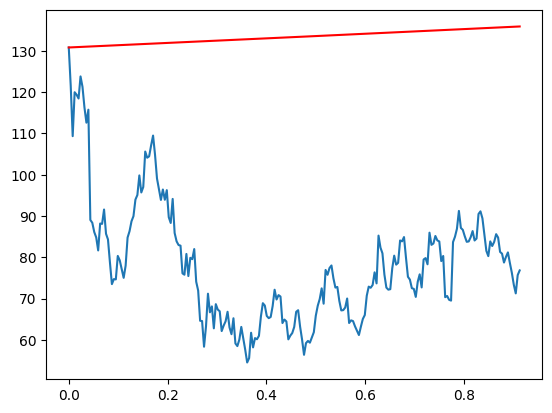

Stock = WIX
S0 =  130.8300018311


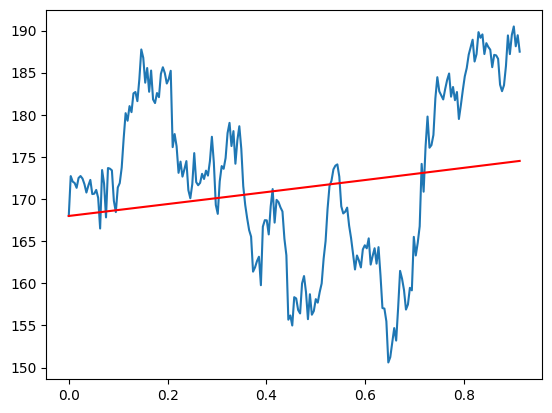

Stock = TRV
S0 =  167.9900054932


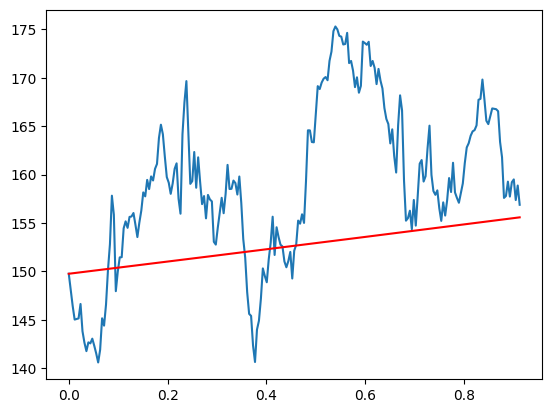

Stock = WM
S0 =  149.7599945068


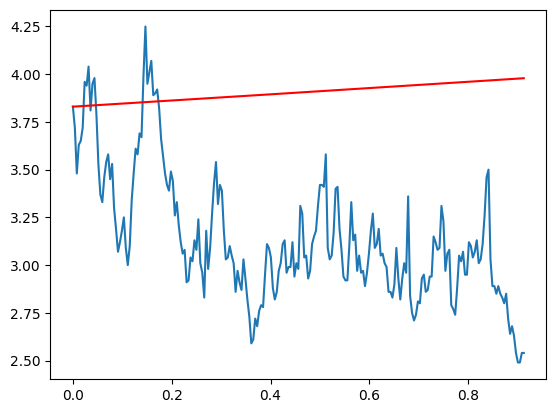

Stock = CRON
S0 =  3.8299999237


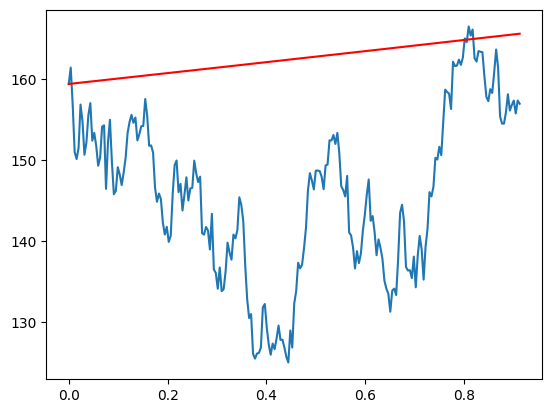

Stock = ETN
S0 =  159.3899993896


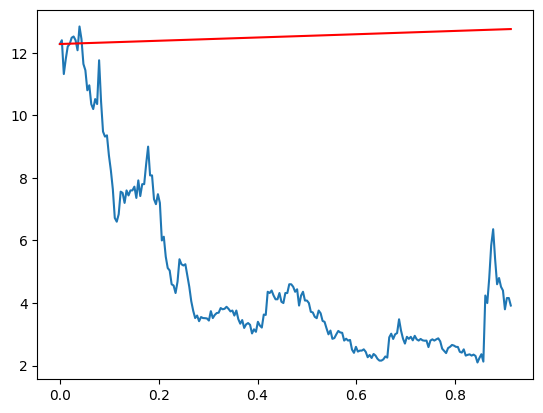

Stock = GAME
S0 =  12.279999733


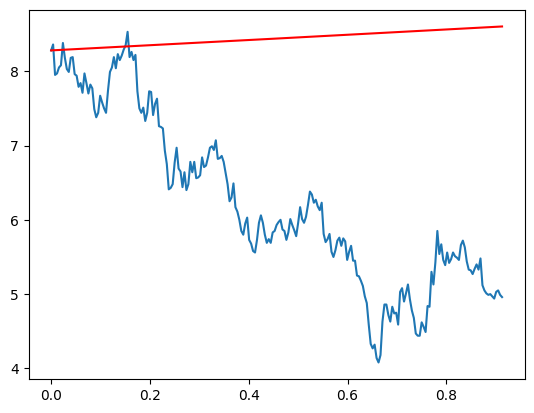

Stock = LPL
S0 =  8.279999733


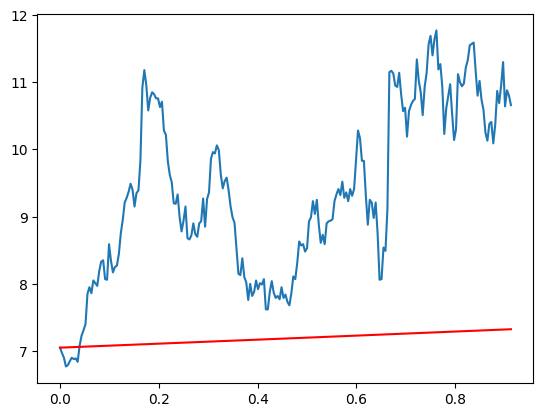

Stock = SBS
S0 =  7.0500001907


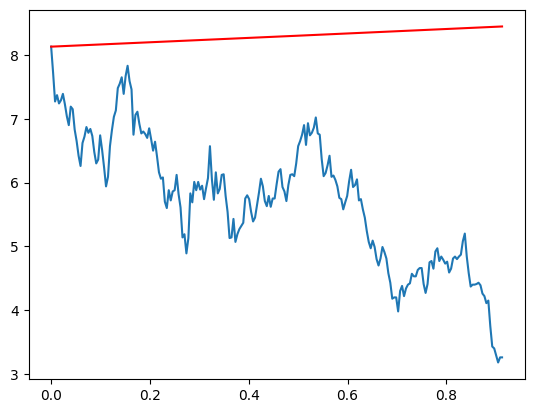

Stock = BB
S0 =  8.1300001144


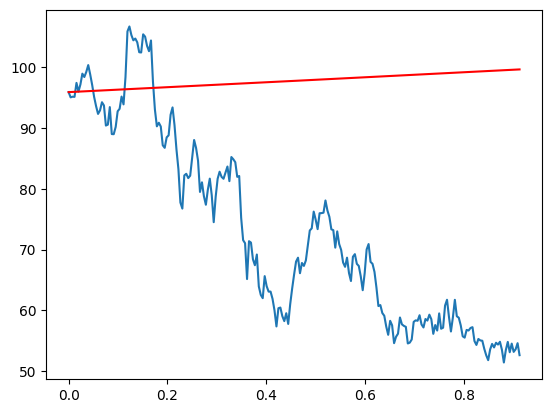

Stock = DAC
S0 =  95.8600006104


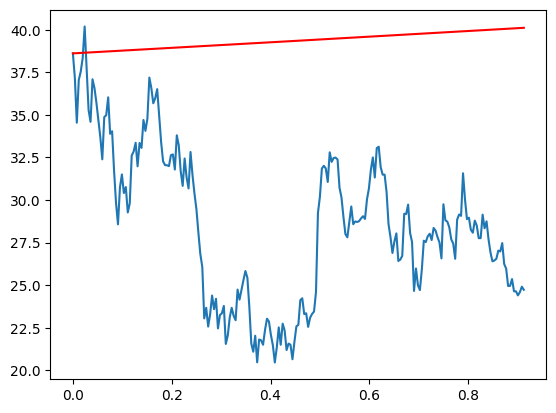

Stock = UBER
S0 =  38.6100006104


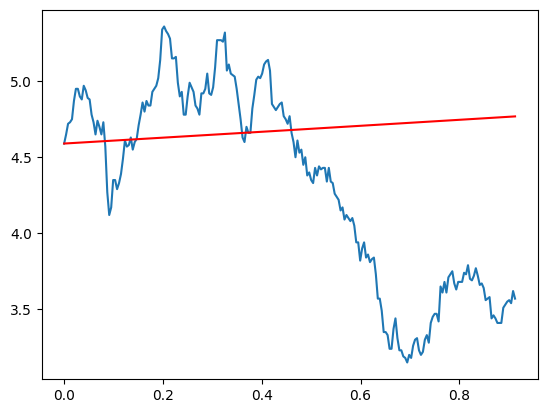

Stock = TEF
S0 =  4.5900001526


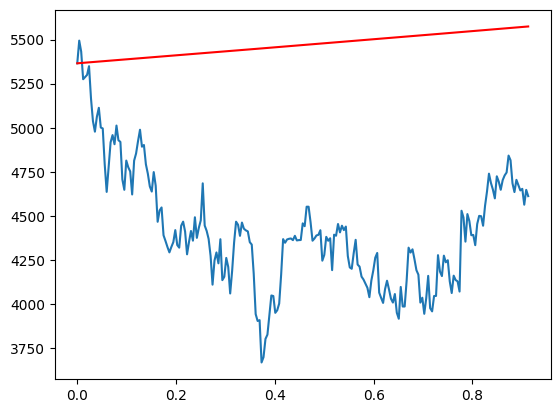

Stock = NVR
S0 =  5365.2700195312


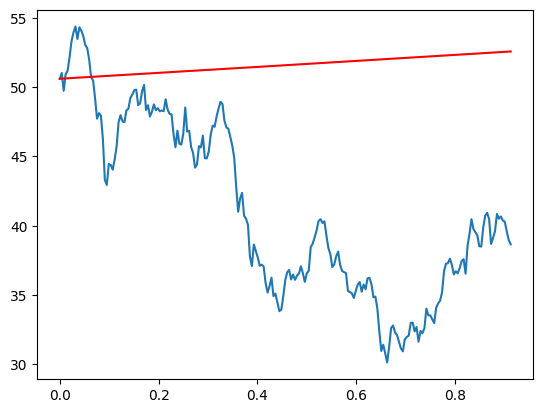

Stock = KB
S0 =  50.5999984741


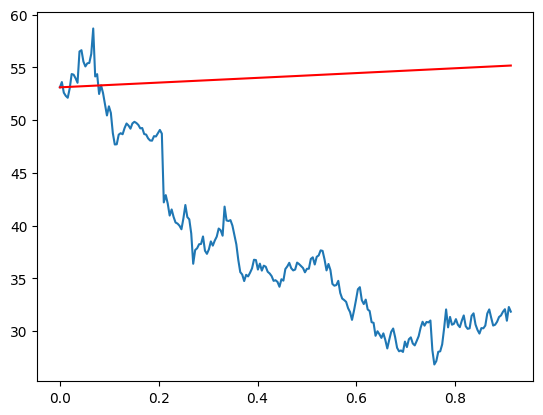

Stock = XRAY
S0 =  53.1100006104


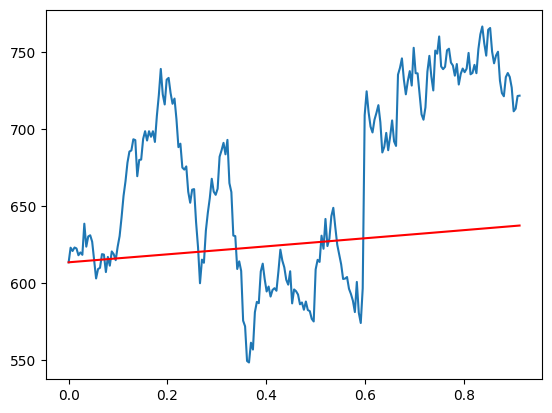

Stock = REGN
S0 =  613.3599853516


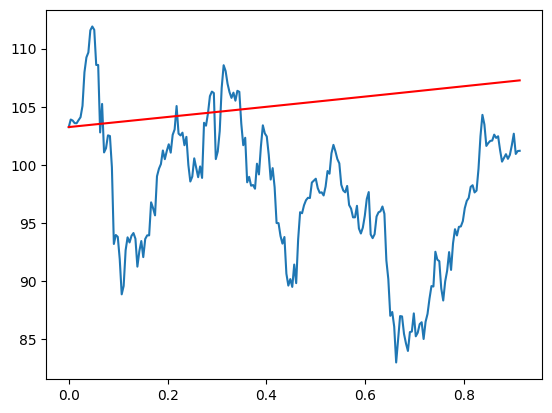

Stock = PM
S0 =  103.25


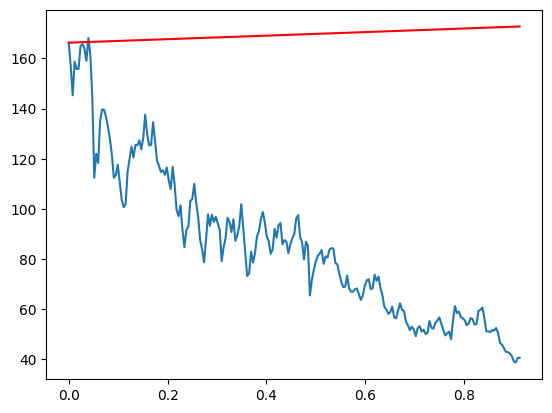

Stock = ROKU
S0 =  166.2599945068


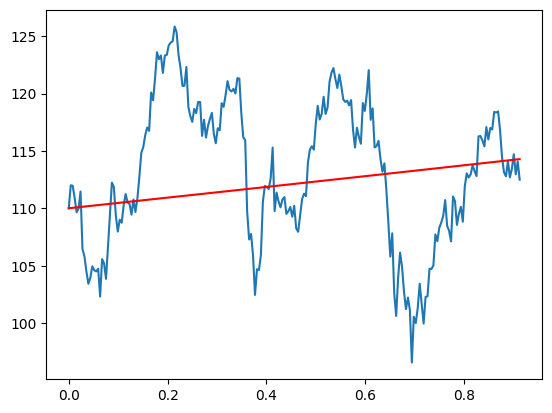

Stock = ETR
S0 =  110.0100021362


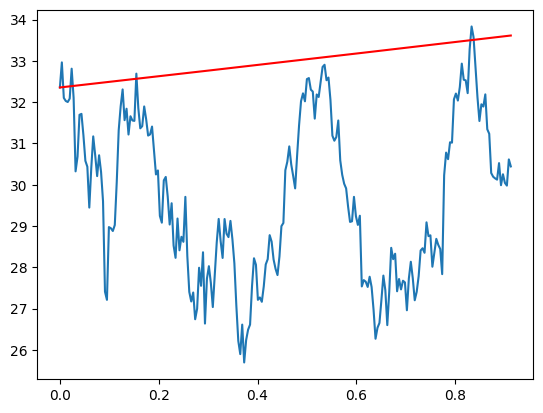

Stock = CPRT
S0 =  32.3574981689


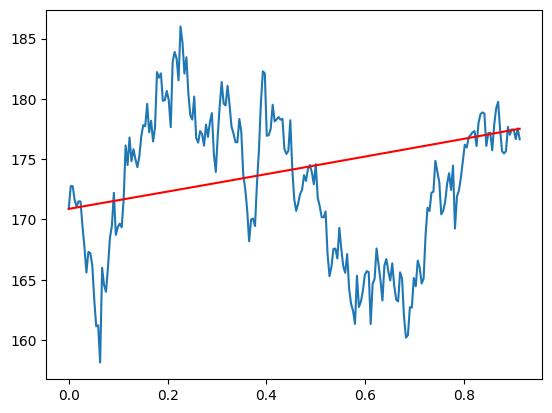

Stock = JNJ
S0 =  170.8800048828


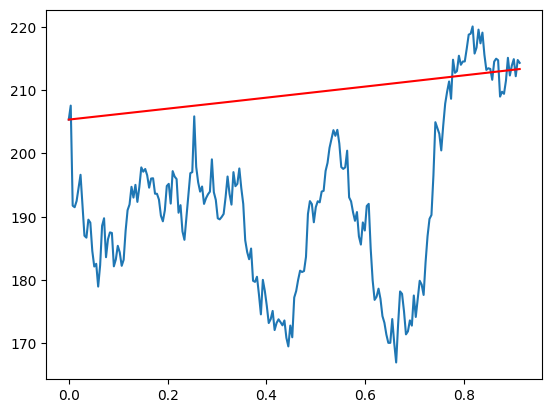

Stock = HON
S0 =  205.3399963379


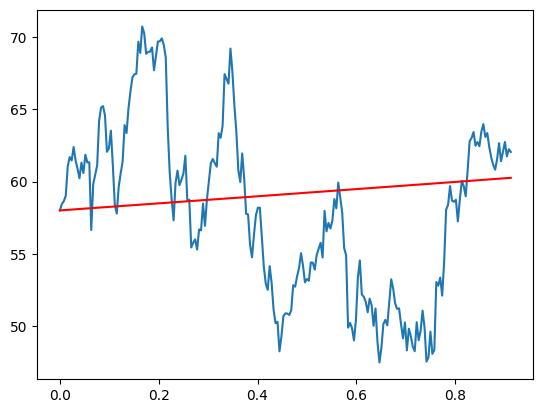

Stock = BHP
S0 =  58.0017852783


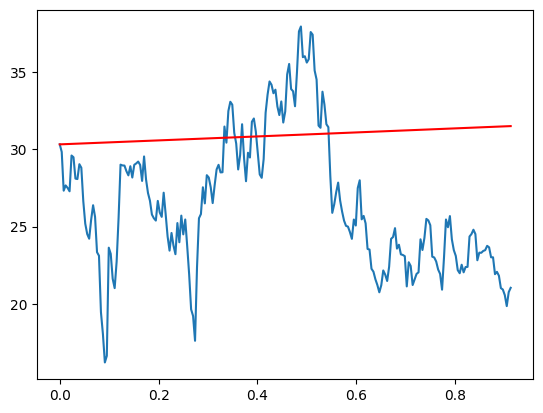

Stock = BMBL
S0 =  30.3099994659


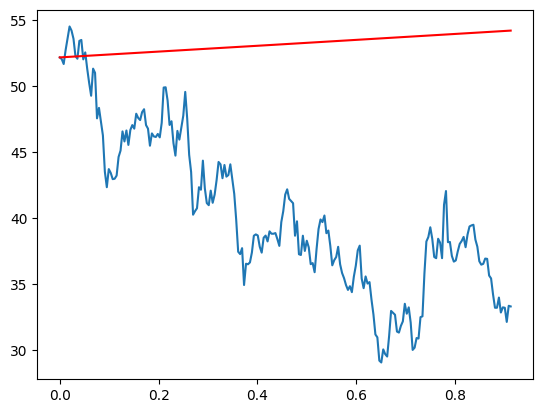

Stock = OMF
S0 =  52.1500015259


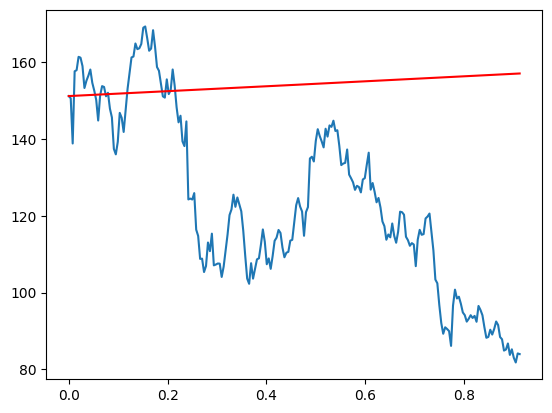

Stock = AMZN
S0 =  151.1934967041


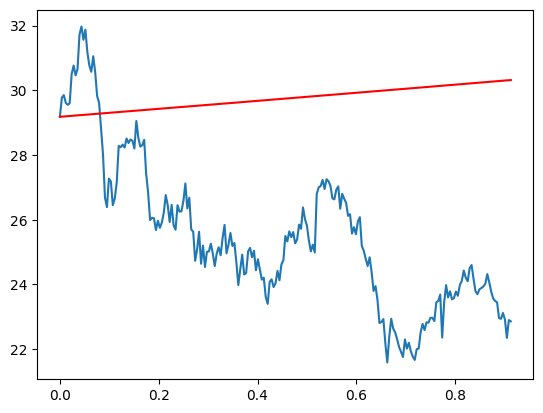

Stock = HMC
S0 =  29.1800003052


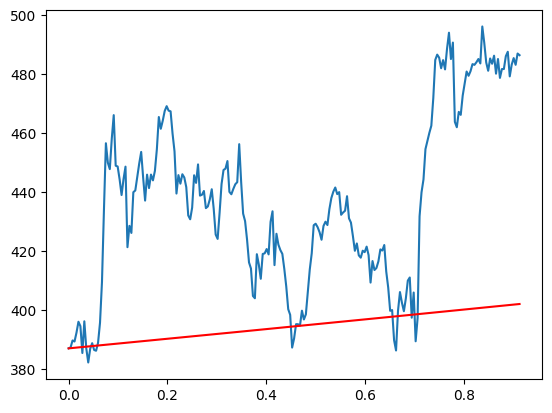

Stock = LMT
S0 =  387.0100097656


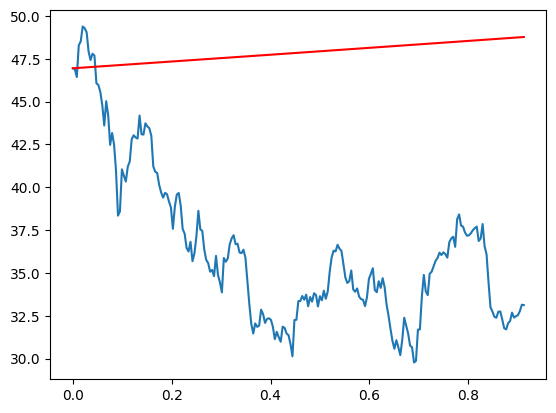

Stock = BAC
S0 =  46.9399986267


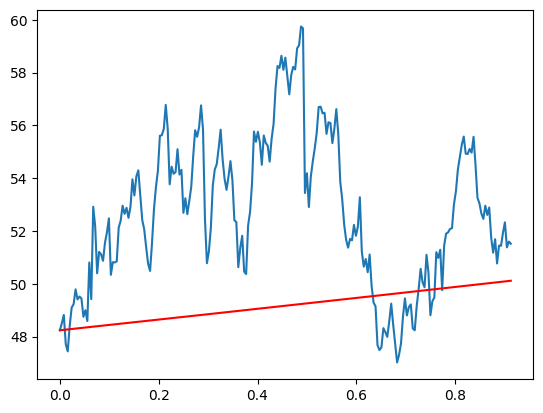

Stock = TAP
S0 =  48.2400016785


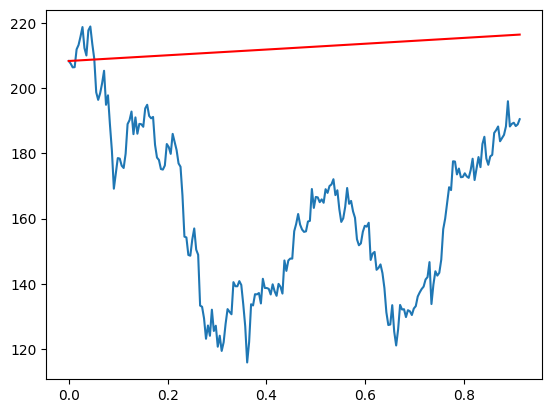

Stock = BA
S0 =  208.3399963379


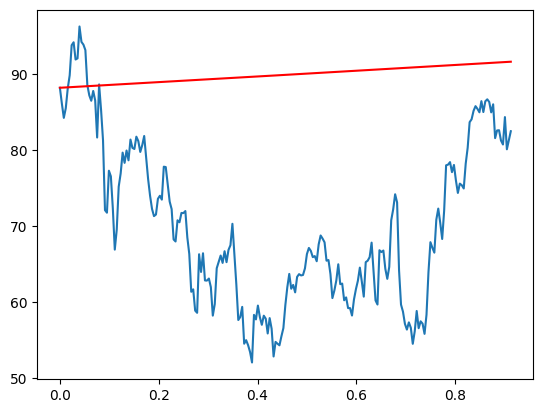

Stock = WYNN
S0 =  88.1900024414


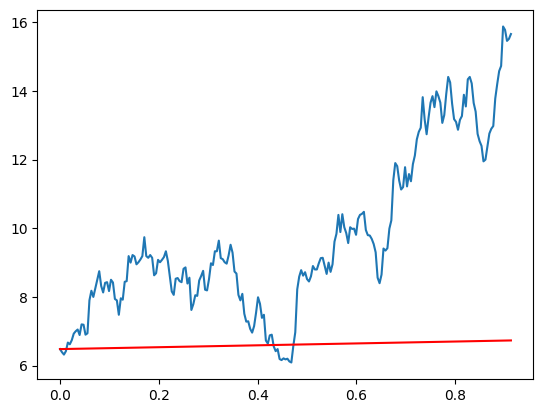

Stock = VIST
S0 =  6.4800000191


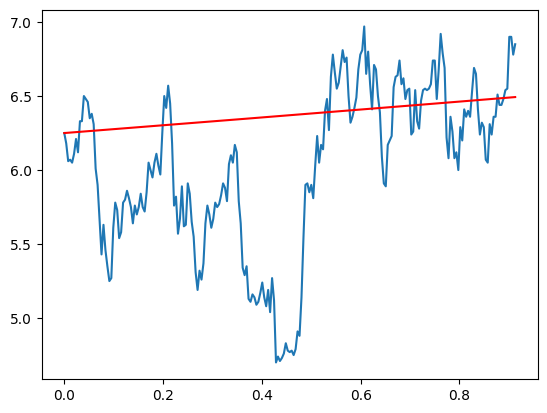

Stock = LOMA
S0 =  6.25


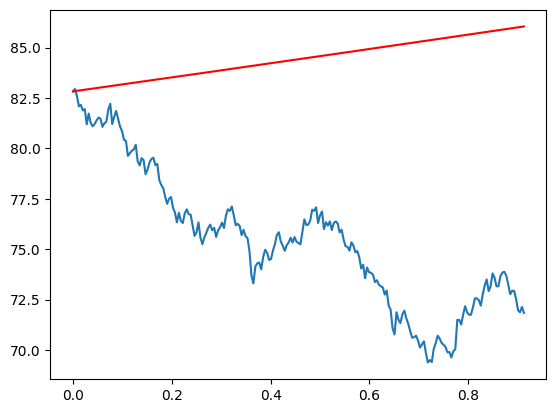

Stock = BND
S0 =  82.8300018311


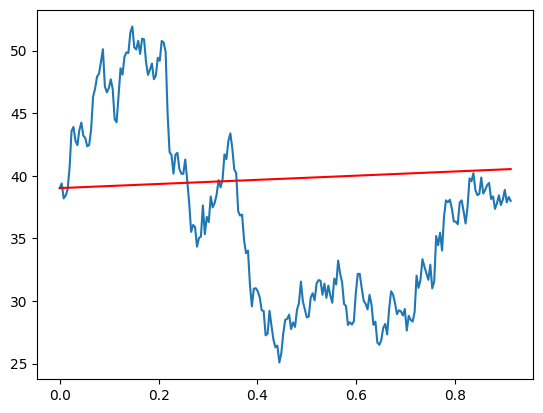

Stock = FCX
S0 =  39.0200004578


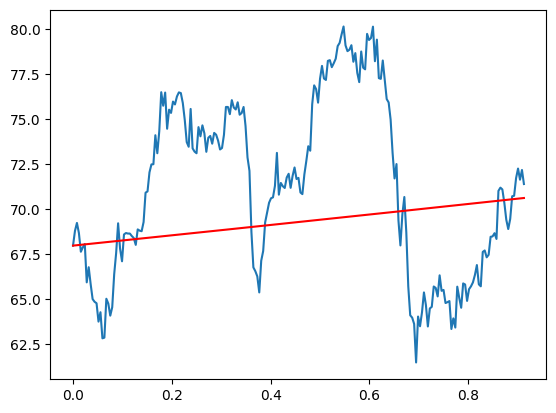

Stock = SO
S0 =  67.9899978638


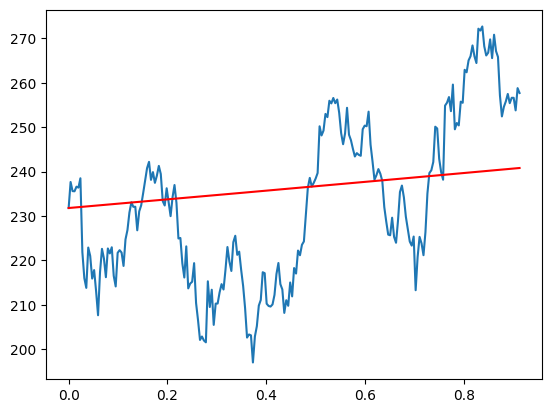

Stock = MSI
S0 =  231.8000030518


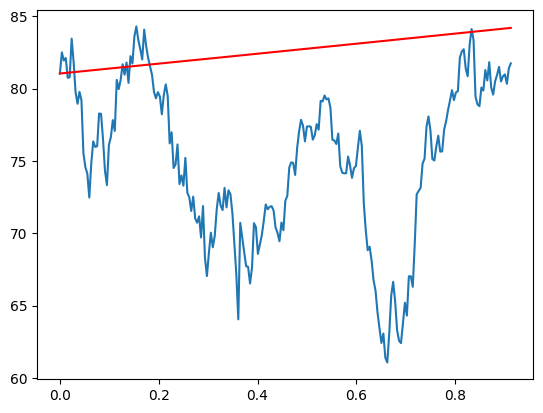

Stock = ORCL
S0 =  81.0400009155


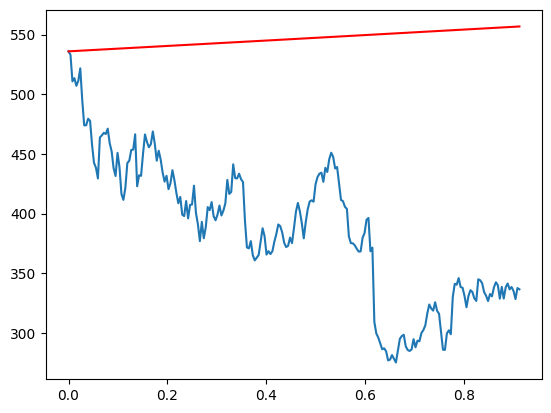

Stock = ADBE
S0 =  535.9799804688


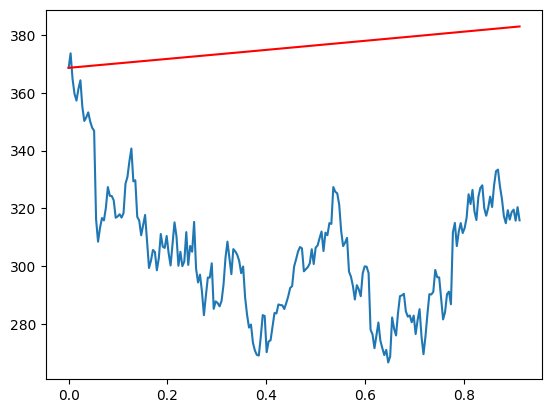

Stock = HD
S0 =  368.700012207


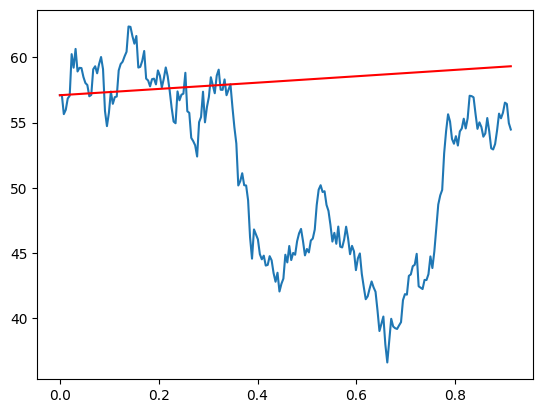

Stock = PKX
S0 =  57.0999984741


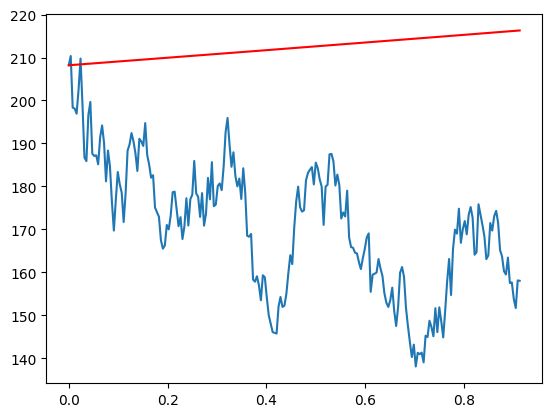

Stock = NXPI
S0 =  208.1999969482


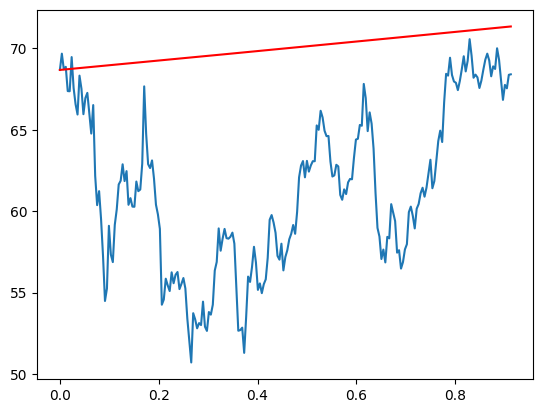

Stock = HDB
S0 =  68.6800003052


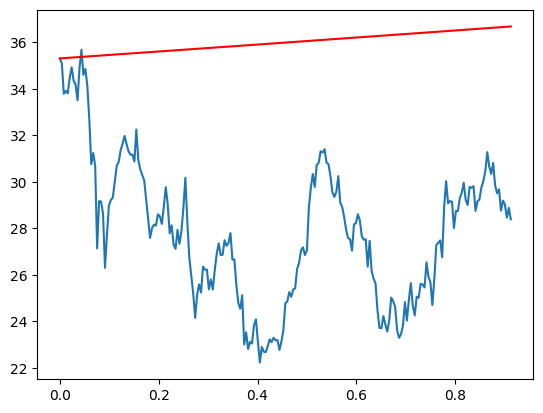

Stock = SUM
S0 =  35.3097343445


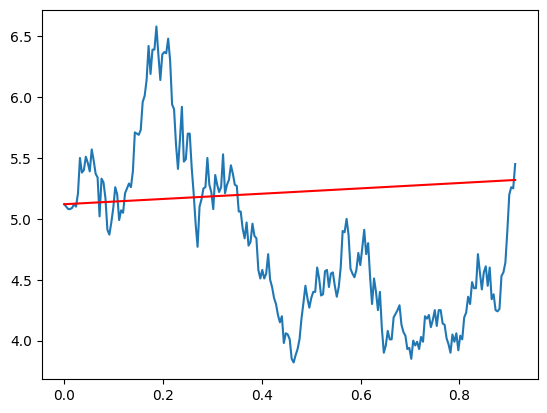

Stock = TEO
S0 =  5.1199998856


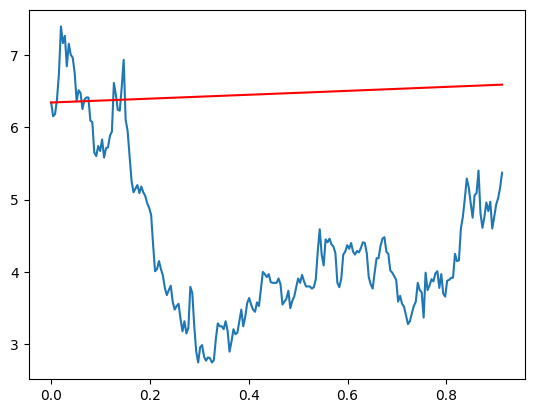

Stock = VLN
S0 =  6.3400001526


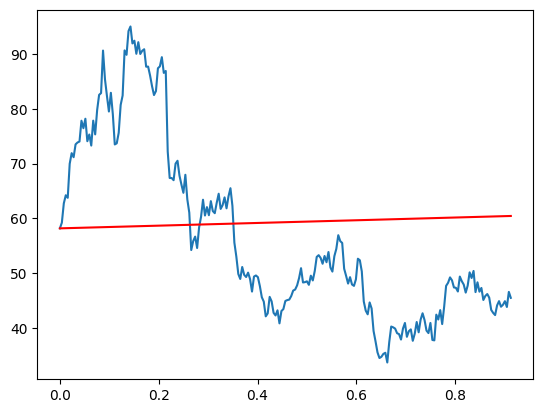

Stock = AA
S0 =  58.1699981689


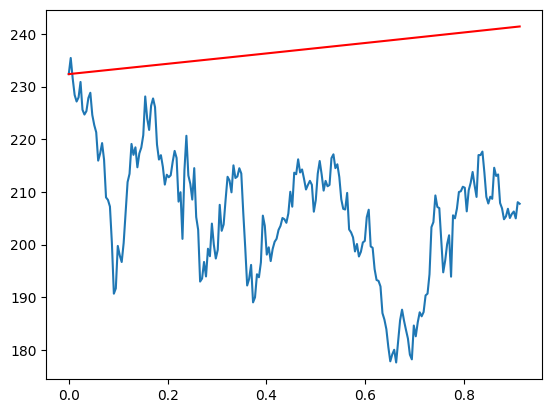

Stock = V
S0 =  232.3600006104


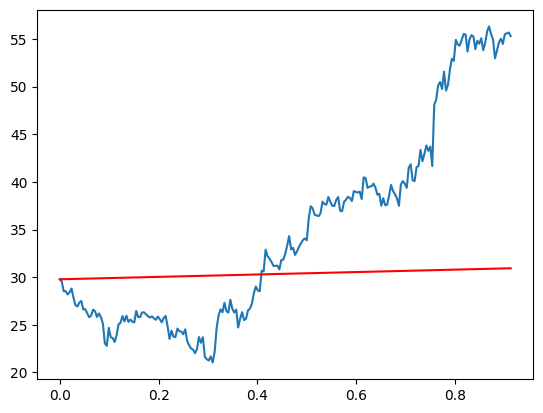

Stock = ELF
S0 =  29.7800006866


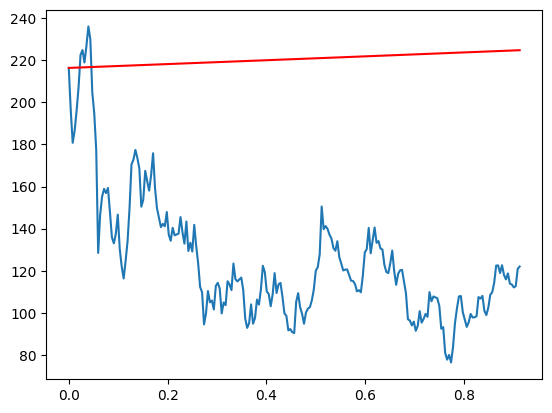

Stock = MNDY
S0 =  216.3099975586


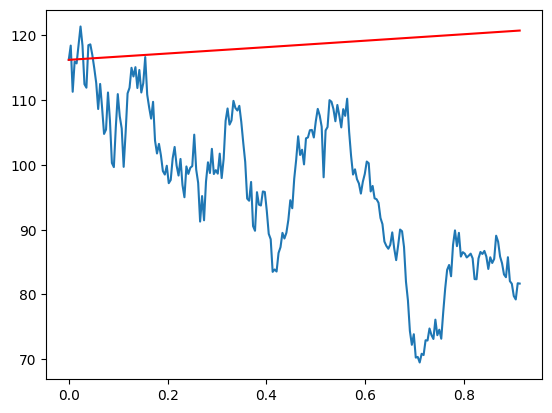

Stock = NVMI
S0 =  116.2200012207


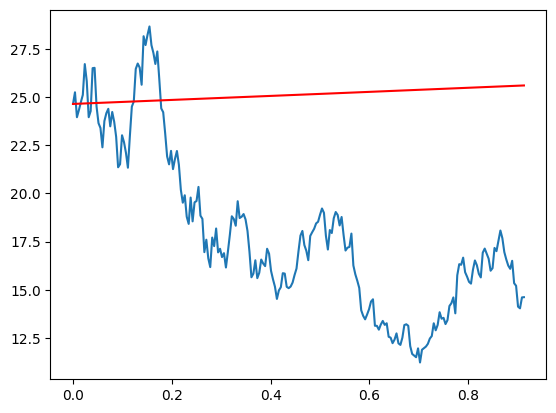

Stock = NVDA
S0 =  24.6380004883


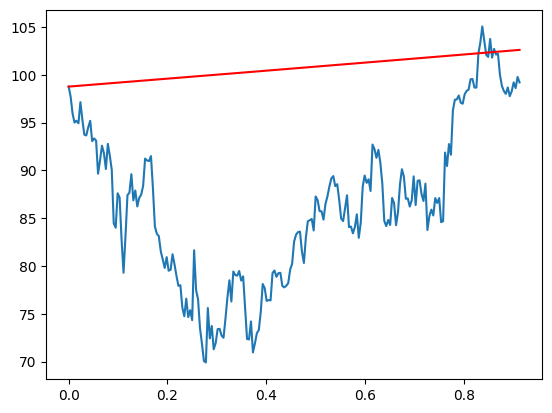

Stock = SBUX
S0 =  98.7600021362


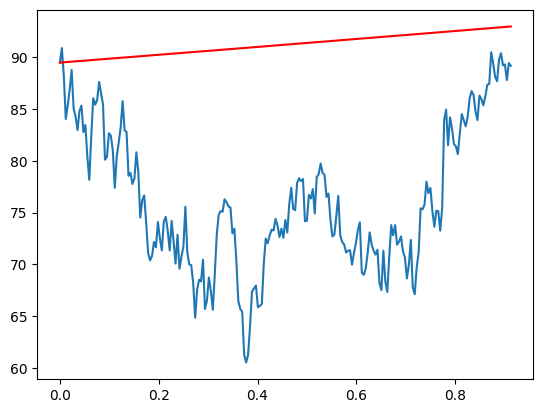

Stock = DHI
S0 =  89.4499969482


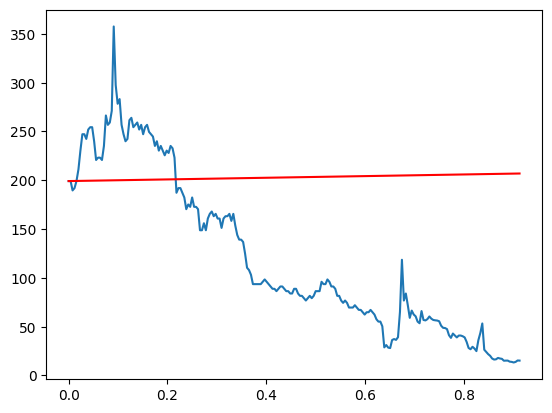

Stock = TOPS
S0 =  199.1999969482


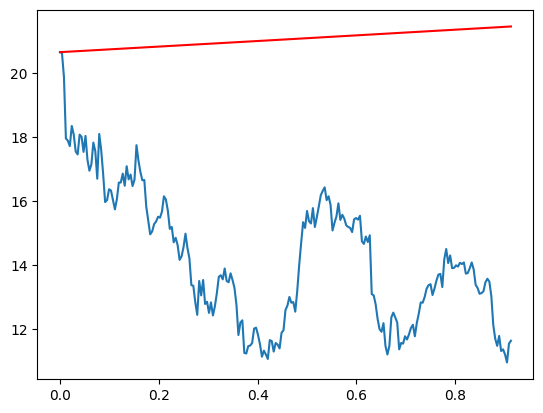

Stock = F
S0 =  20.6599998474


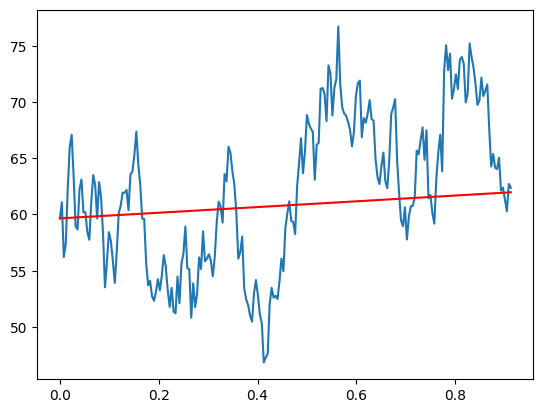

Stock = ON
S0 =  59.6500015259


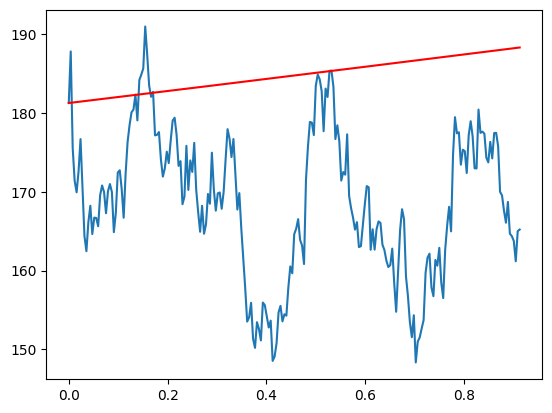

Stock = TXN
S0 =  181.2899932861


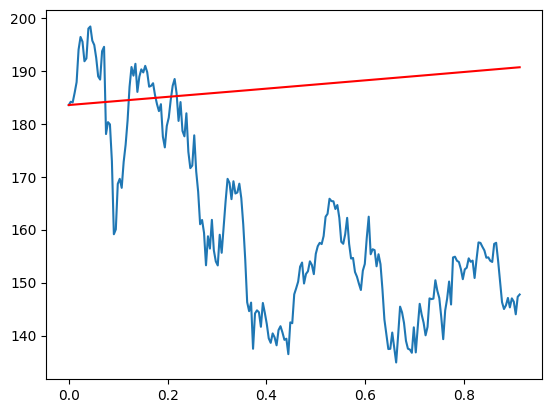

Stock = AXP
S0 =  183.5399932861


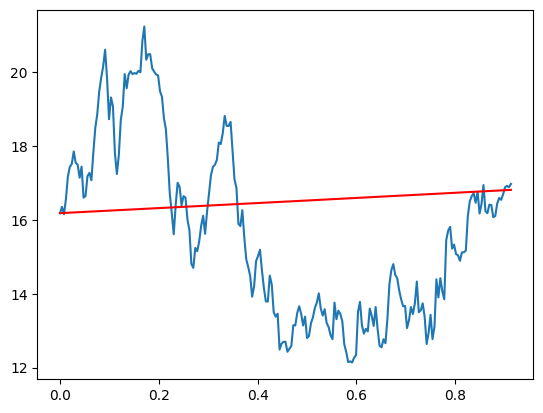

Stock = VALE
S0 =  16.1800003052


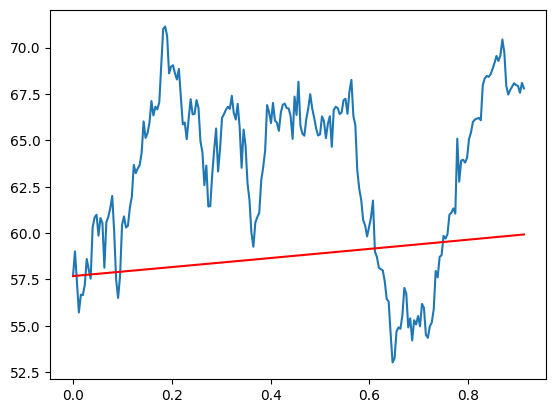

Stock = AZN
S0 =  57.6800003052


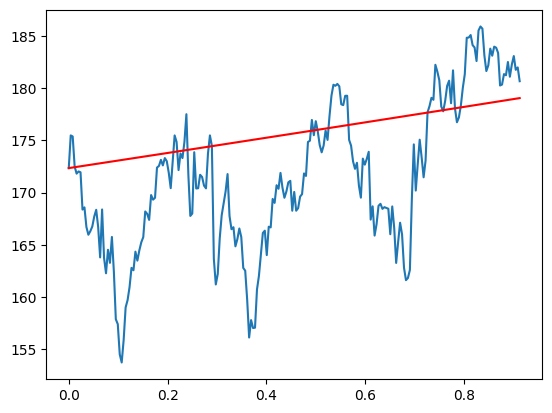

Stock = PEP
S0 =  172.3399963379


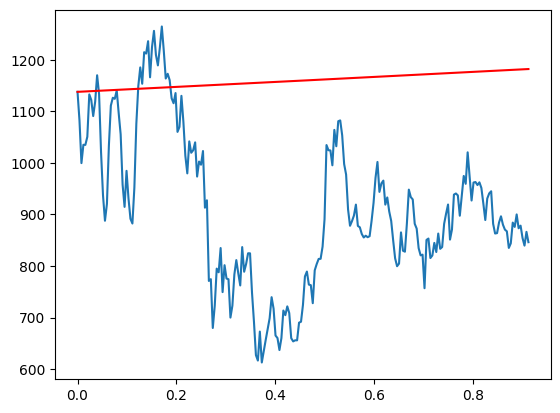

Stock = MELI
S0 =  1138.1099853516


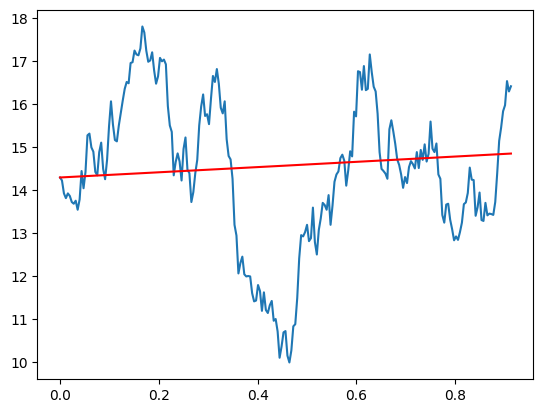

Stock = BMA
S0 =  14.3000001907


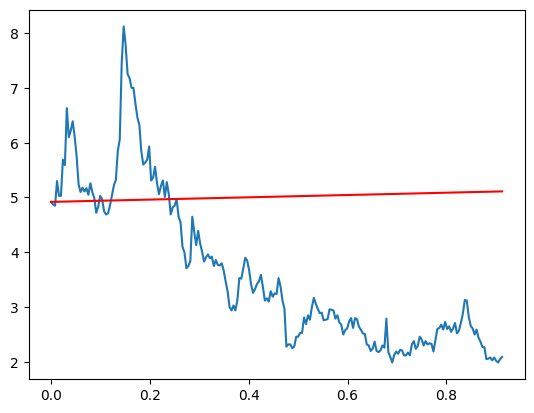

Stock = SNDL
S0 =  4.9200000763


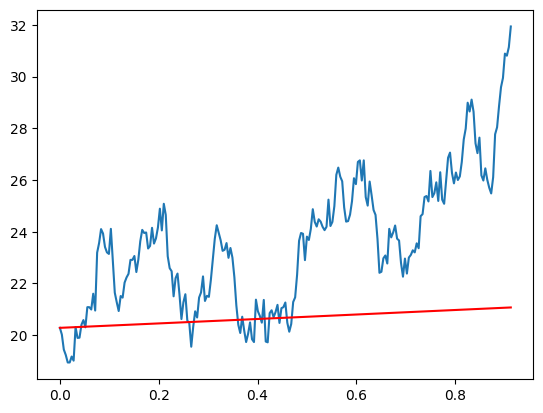

Stock = PAM
S0 =  20.2800006866


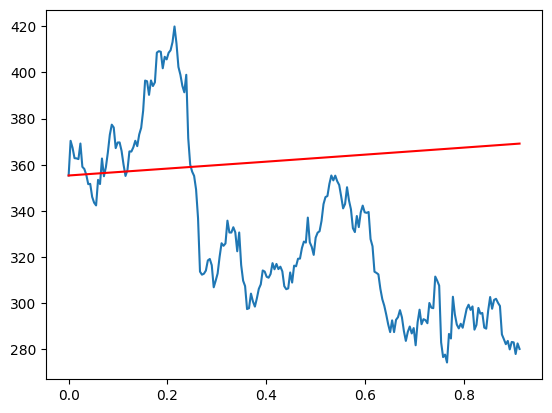

Stock = PSA
S0 =  355.3399963379


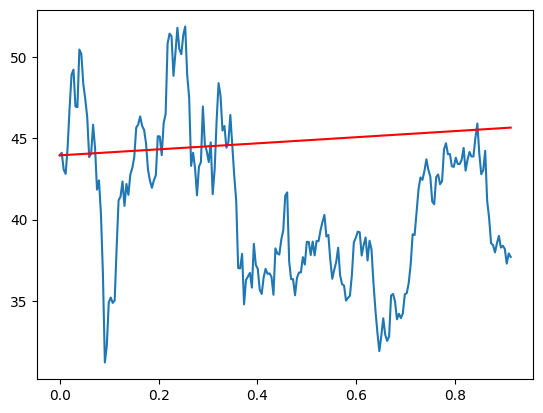

Stock = UAL
S0 =  43.9599990845


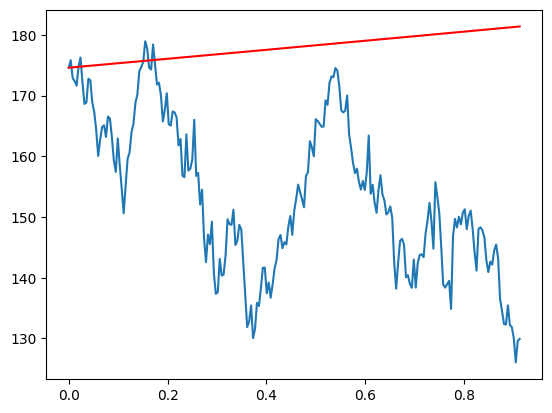

Stock = AAPL
S0 =  174.6100006104


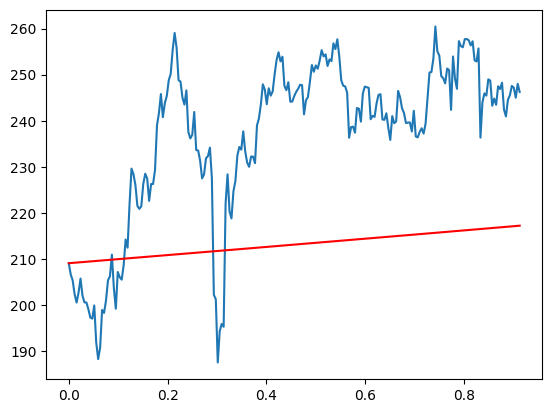

Stock = DG
S0 =  209.1199951172


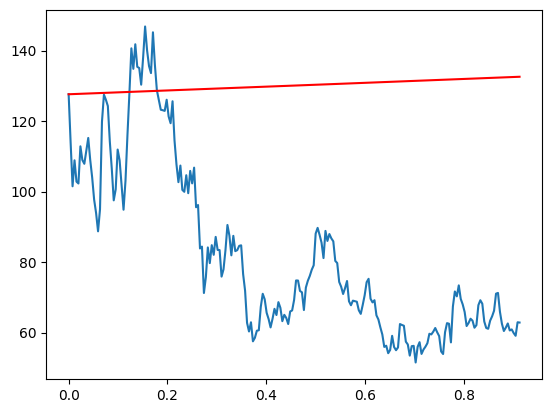

Stock = SQ
S0 =  127.6100006104


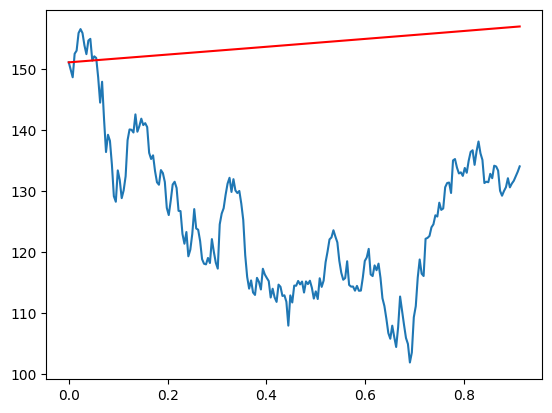

Stock = JPM
S0 =  151.1499938965


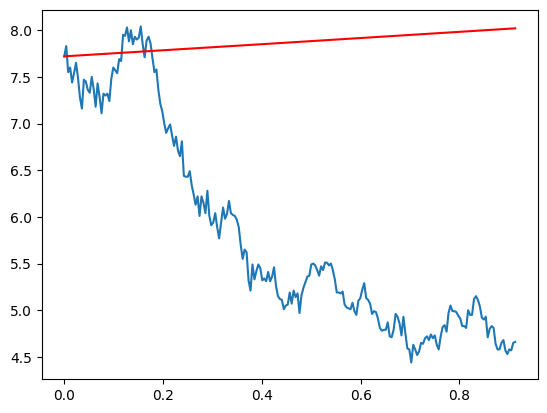

Stock = WIT
S0 =  7.7199997902


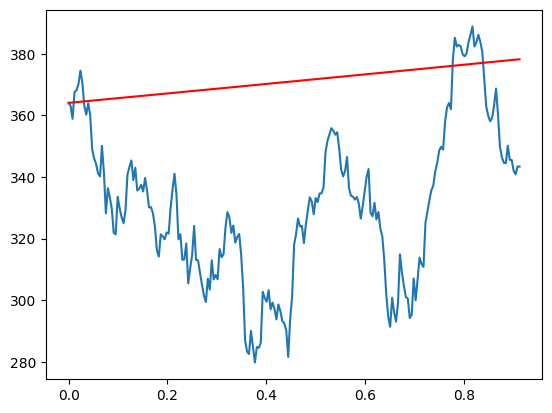

Stock = GS
S0 =  364.0599975586


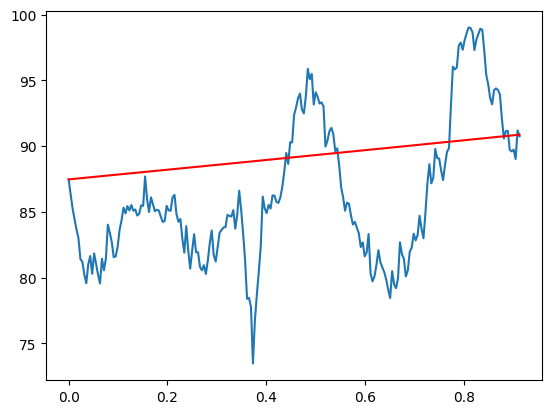

Stock = NNI
S0 =  87.4700012207


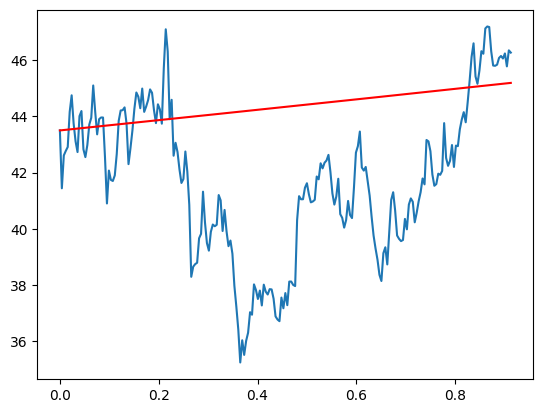

Stock = BSX
S0 =  43.5


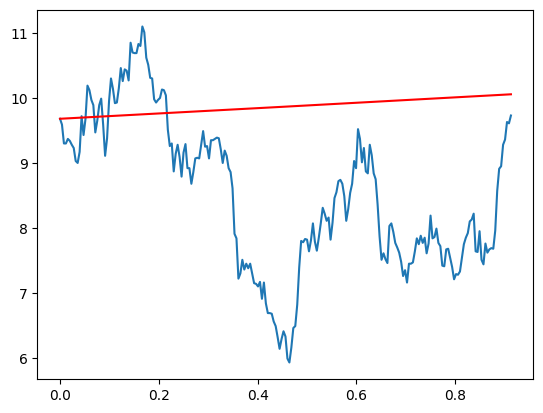

Stock = GGAL
S0 =  9.6800003052


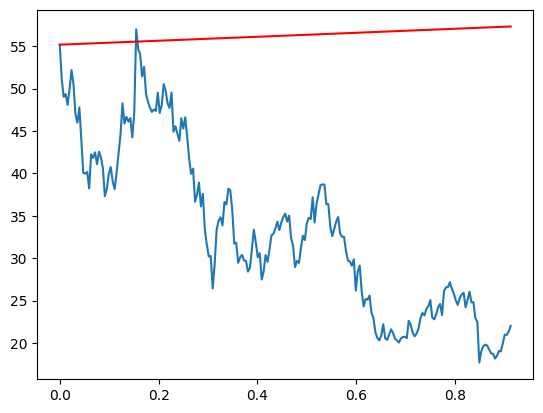

Stock = LOVE
S0 =  55.1800003052


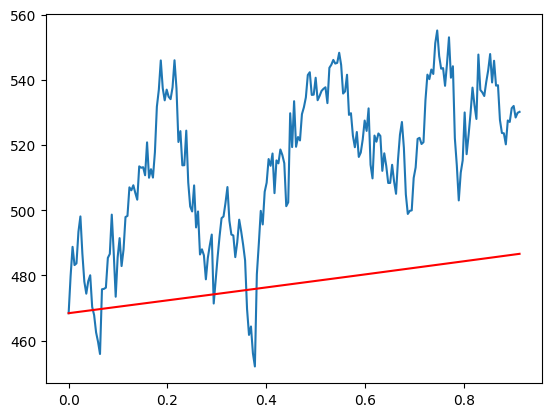

Stock = UNH
S0 =  468.4100036621


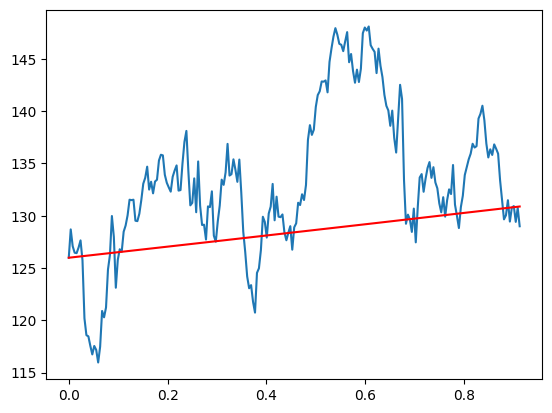

Stock = RSG
S0 =  125.9800033569


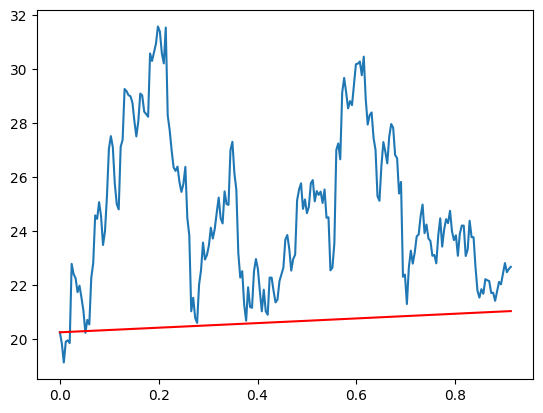

Stock = CCJ
S0 =  20.2399997711


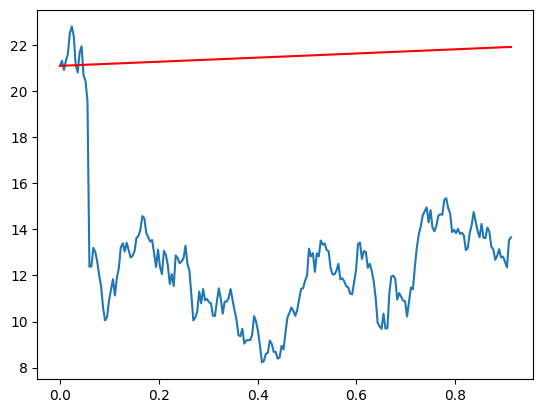

Stock = VRT
S0 =  21.1100006104


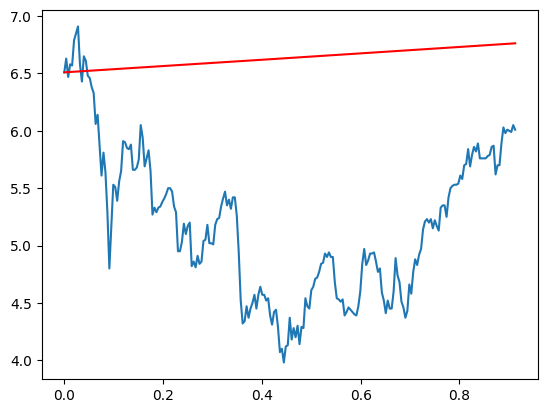

Stock = BBVA
S0 =  6.5100002289


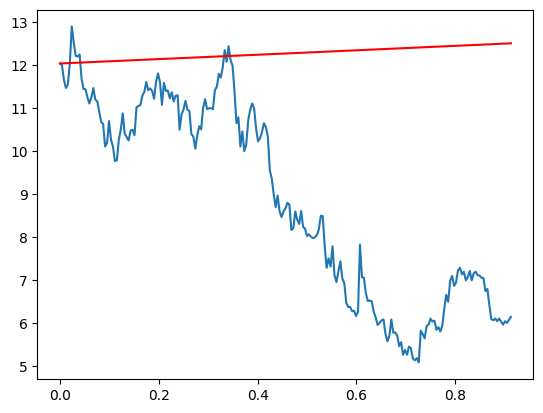

Stock = IHS
S0 =  12.0399999619


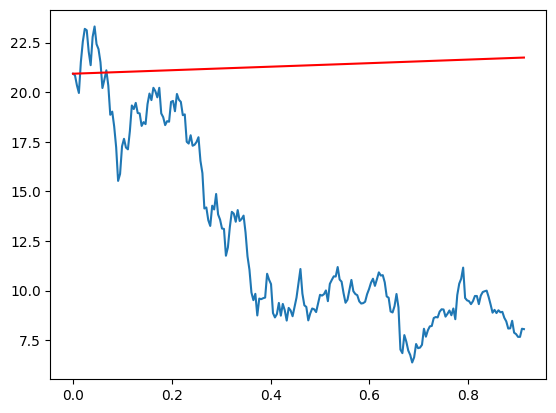

Stock = CCL
S0 =  20.9300003052


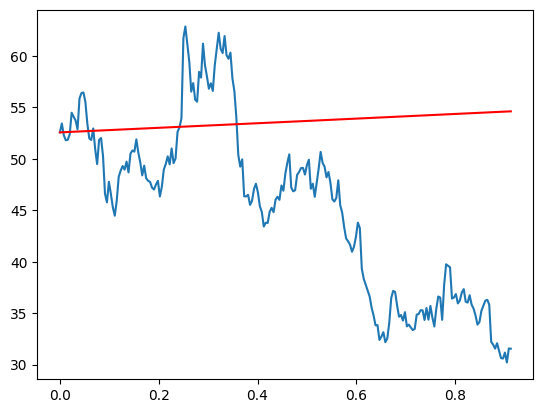

Stock = WDC
S0 =  52.5699996948


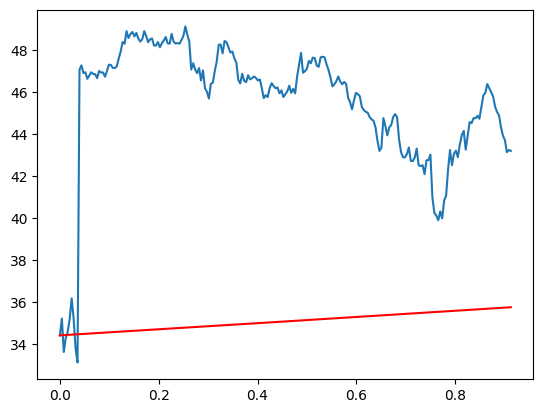

Stock = TSEM
S0 =  34.4199981689


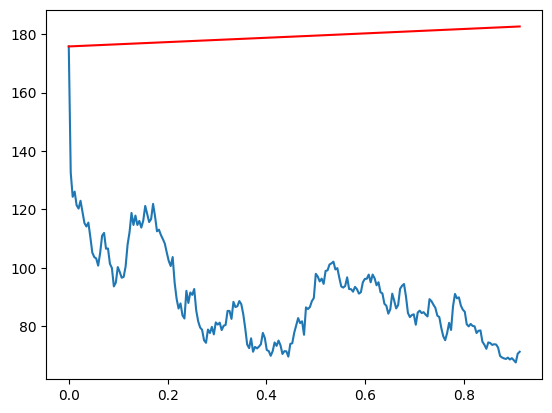

Stock = PYPL
S0 =  175.8000030518


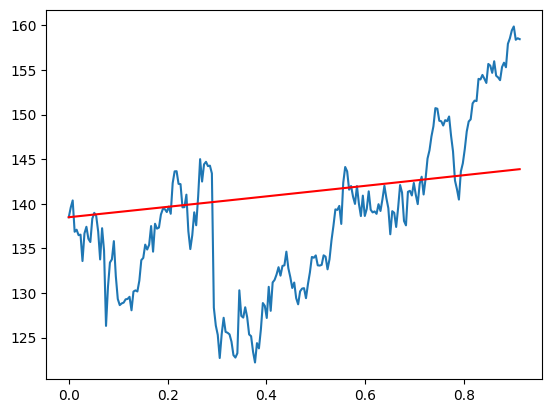

Stock = SJM
S0 =  138.5


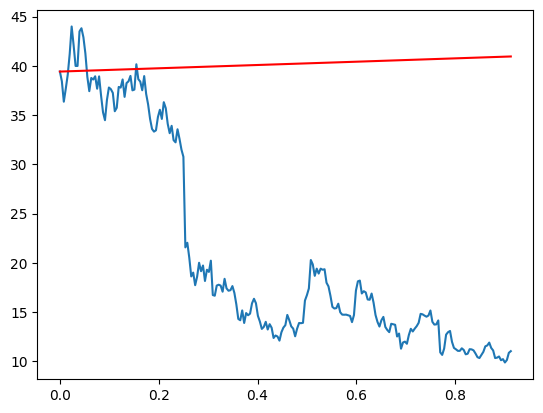

Stock = LYFT
S0 =  39.4199981689


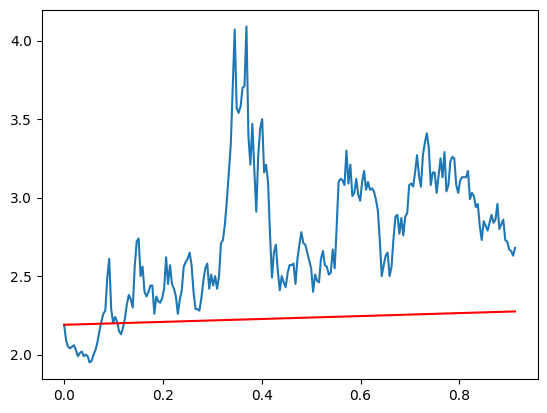

Stock = GASS
S0 =  2.1900000572


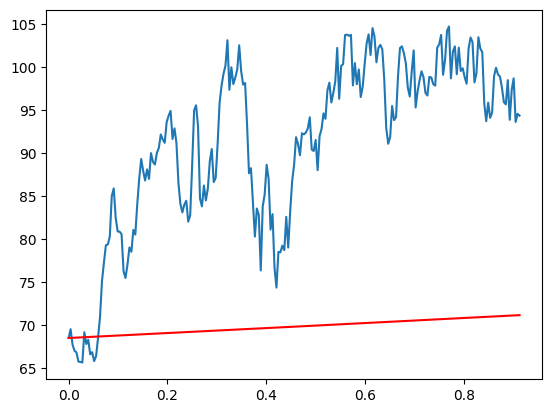

Stock = CHK
S0 =  68.4700012207


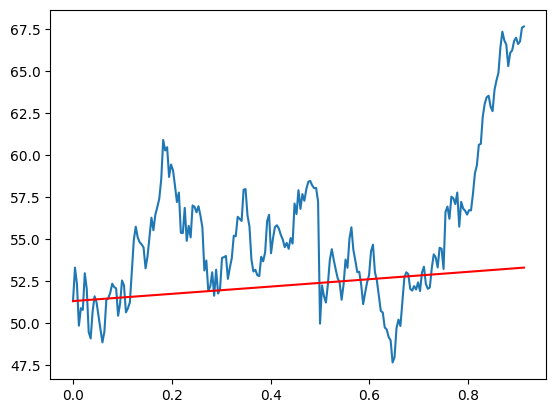

Stock = NVO
S0 =  51.2999992371


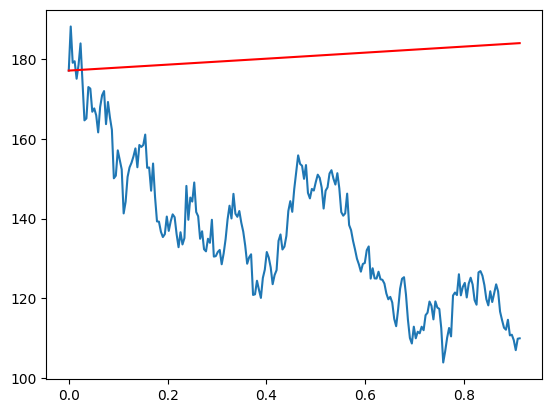

Stock = QCOM
S0 =  177.1300048828


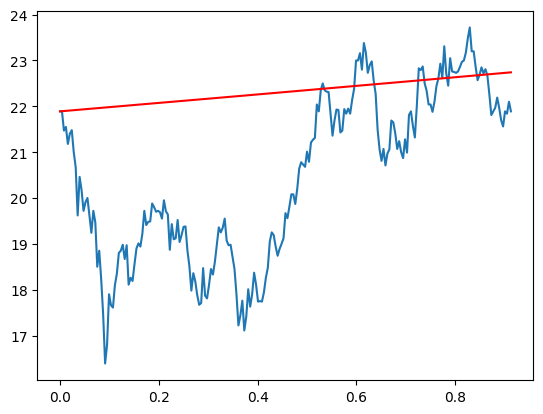

Stock = IBN
S0 =  21.8899993896


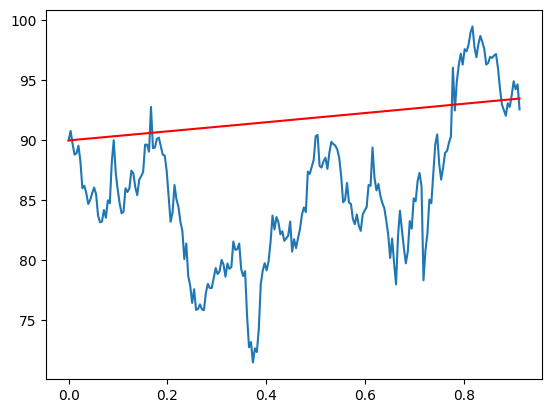

Stock = AWR
S0 =  89.9599990845


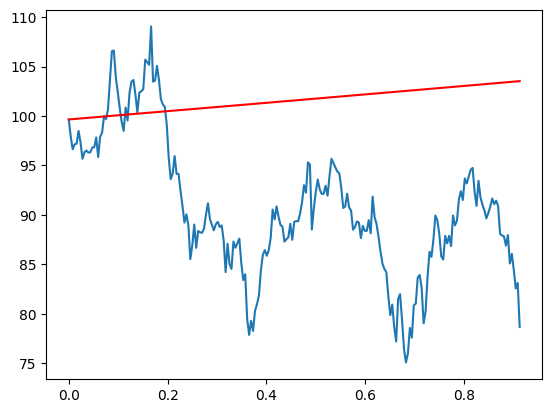

Stock = MSEX
S0 =  99.6500015259


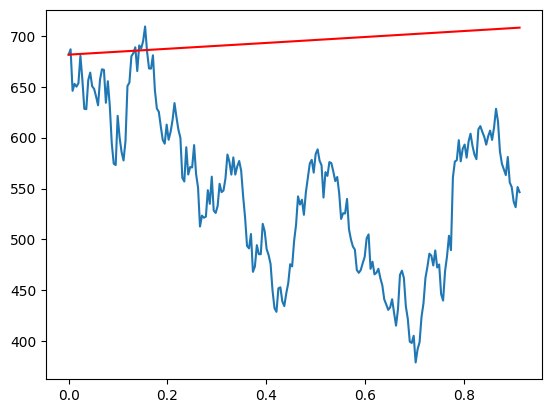

Stock = ASML
S0 =  681.4799804688


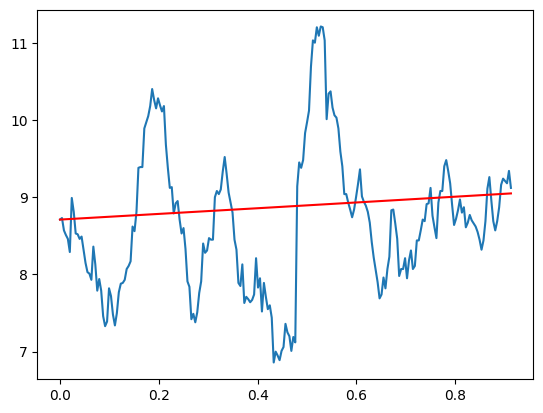

Stock = TEVA
S0 =  8.7100000381


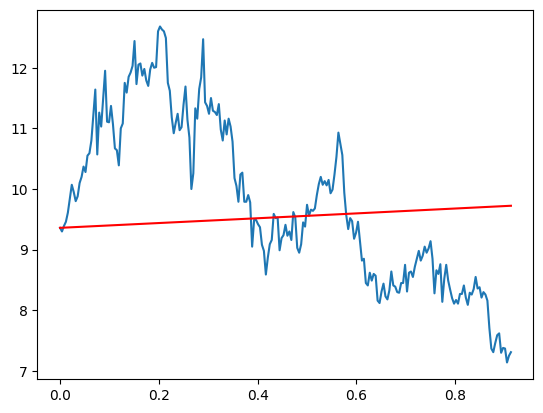

Stock = ICL
S0 =  9.3599996567


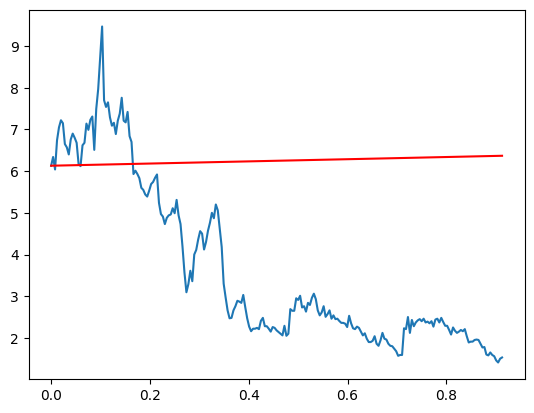

Stock = MVST
S0 =  6.1300001144


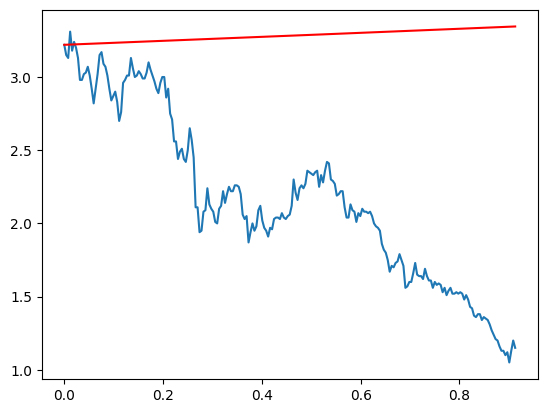

Stock = SIFY
S0 =  3.2200000286


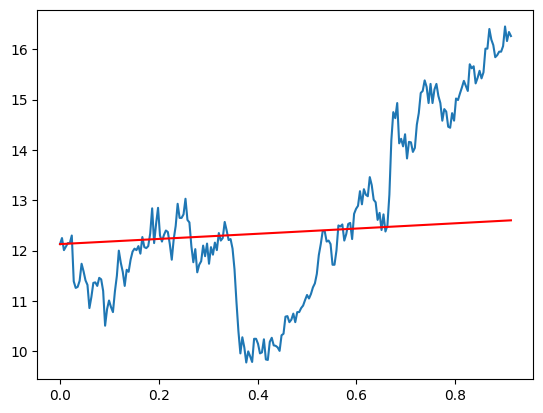

Stock = PCG
S0 =  12.1300001144


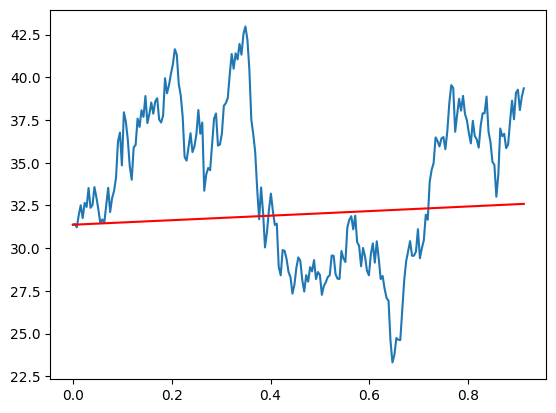

Stock = HAL
S0 =  31.3700008392


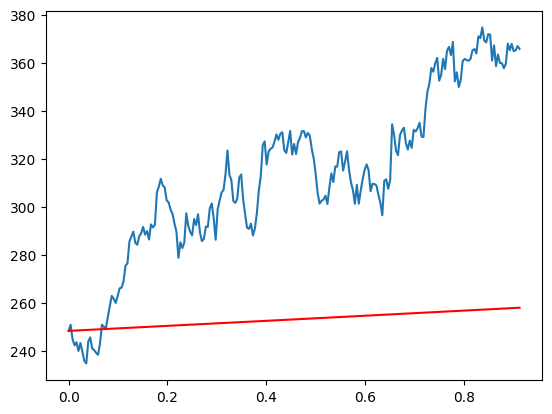

Stock = LLY
S0 =  248.2799987793


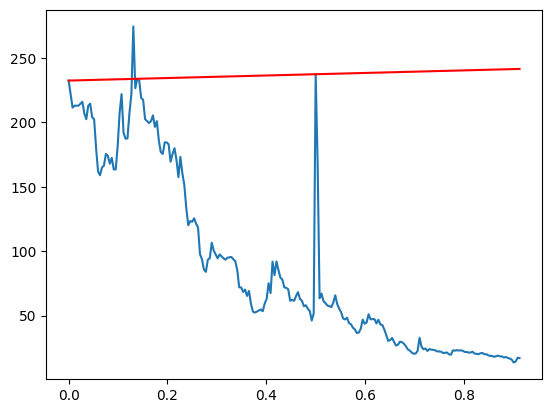

Stock = QNRX
S0 =  232.5


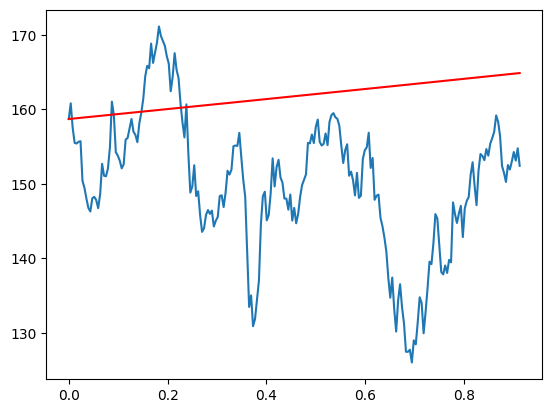

Stock = AWK
S0 =  158.7100067139


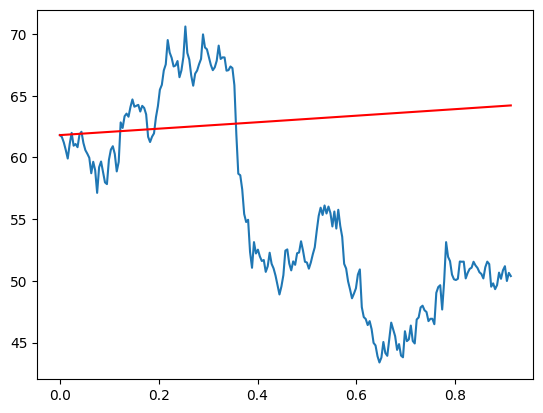

Stock = DOW
S0 =  61.8100013733


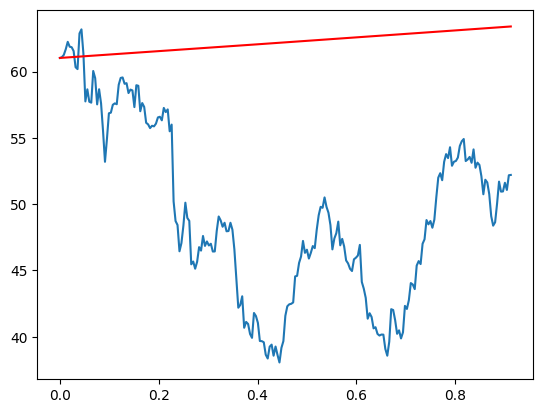

Stock = GE
S0 =  61.0245018005


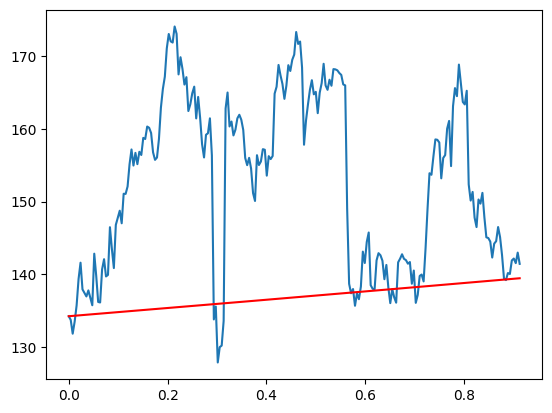

Stock = DLTR
S0 =  134.2400054932


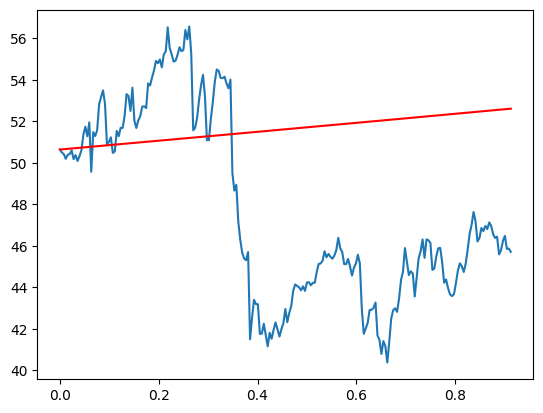

Stock = MO
S0 =  50.6399993896


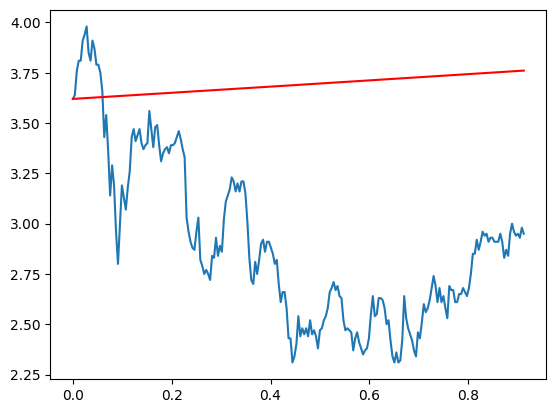

Stock = SAN
S0 =  3.6199998856


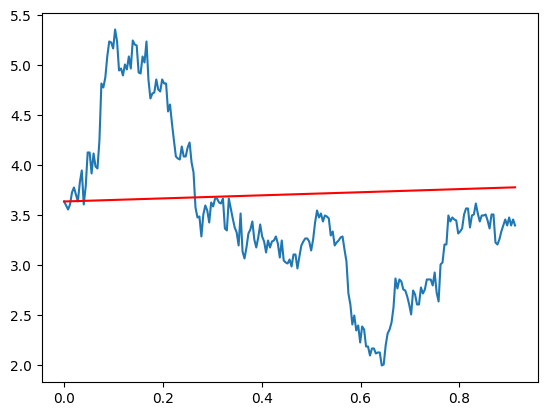

Stock = HMY
S0 =  3.6400001049


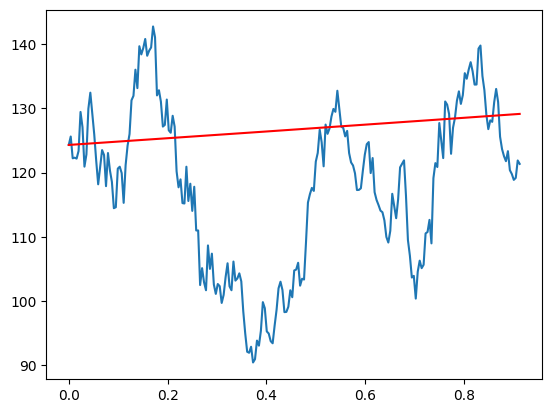

Stock = ANET
S0 =  124.3000030518


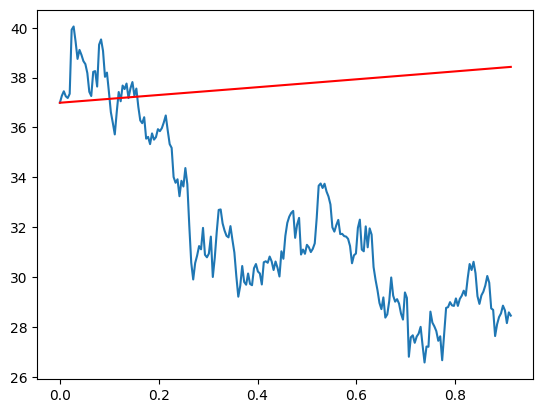

Stock = FOX
S0 =  36.9900016785


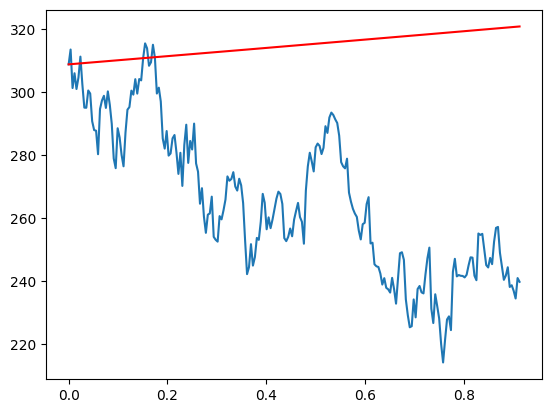

Stock = MSFT
S0 =  308.7600097656


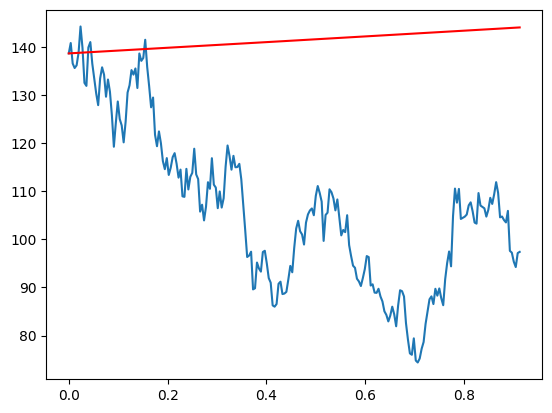

Stock = AMAT
S0 =  138.6100006104


In [ ]:
i1, i2 = get_partition_timeseries_indices(start_time_historical, final_time_observed)
if desired_stocks == "all":
  data = json_data
else:
  data = use_only_desired_stocks(json_data, desired_stocks)
if not(banned_stocks is None):
  data = remove_banned_stocks(data, banned_stocks)
data = remove_stocks_without_enough_data(data, i1, i2)
data = data.iloc[i1:i2]
S_finals = []

for i, ticker in enumerate(data.columns):
  y1 = data[ticker].dropna()
  t = np.array(list(range(len(y1))))/252
  S0 = y1.iloc[0]
  y2 = S0*np.exp(risk_free_rate*t)      # Risk free interest rate
  plt.plot(t,y1)
  plt.plot(t, y2, color='red')
  plt.show()
  print("Stock =", ticker)
  print("S0 = ", S0)
  S_finals.append(y1.iloc[len(y1)-1])

Finally, we can compute the true return on our stock if we decided to invest $1000 into our given portfolios. We determine the total profit and rates of return.

In [ ]:
money_to_spend = 1000
print("Max Sharpe Profit\n")
weights = (money_to_spend / np.dot(max_sharpe, S_mids))
print("Money spent in initial investment:", money_to_spend)
print("Money made after time has passed:", weights*np.dot(max_sharpe, S_finals))
print("Profit:", weights*(np.dot(max_sharpe, S_finals) - np.dot(max_sharpe, S_mids)))
print("Rate of Return:", (np.dot(max_sharpe, S_finals)/np.dot(max_sharpe, S_mids) - 1)*100)
print('\n')
print("-"*80)
print("Minimum Volatility Profit\n")
weights = (money_to_spend / np.dot(min_vol, S_mids))
print("Money spent in initial investment:", weights * np.dot(min_vol, S_mids))
print("Money made after time has passed:", weights*np.dot(min_vol, S_finals))
print("Profit:", weights*(np.dot(min_vol, S_finals) - np.dot(min_vol, S_mids)))
print("Rate of Return:", (np.dot(min_vol, S_finals)/np.dot(min_vol, S_mids) - 1)*100)

Max Sharpe Profit

Money spent in initial investment: 1000
Money made after time has passed: 891.6264449297472
Profit: -108.37355507025276
Rate of Return: -10.837355507025281


--------------------------------------------------------------------------------
Minimum Volatility Profit

Money spent in initial investment: 1000.0
Money made after time has passed: 702.2424966219655
Profit: -297.7575033780346
Rate of Return: -29.77575033780345


## What about repeatedly recomputing the portfolios?

One interesting question is what happens if you recompute the portfolios every specified amount of time and see the total/average profit/rate of return. A simple modification of the code does just that!

As before, we select our desired stocks and set our starting date. We also select our lookback period (i.e. how much historical data we want to consider when choosing our stocks) and then how far into the future we wish to predict.

In [ ]:
desired_stocks = "all" # This can either be the string "all" for all stocks in our database, or it can be a selection of stocks, for example ['MMM', 'AAPL', 'AMZN', 'GOOG', 'TSLA', 'NVDA', 'MSFT', 'INTC', 'CAT', 'BA']
banned_stocks = ['GASS', 'SHIP', 'TEO', 'TOPS', 'TGS', 'MARA', 'UPST', 'RIOT', 'GRND'] # None for no banned stocks, or a list of the stocks you wish not to include, for example ['GASS', 'SHIP', 'TEO', 'TOPS', 'TGS', 'MARA', 'UPST', 'RIOT', 'GRND']
start_day, start_month, start_year = 1, 1, 2010 # For example, the input (1, 4, 2020) corresponds to the date April 1, 2020
number_of_time_units_per_iteration = 2
number_of_time_units_lookback = 6
unit_of_time = "month" # "day", "month", or "year"
risk_free_rate = 0.0418
money_to_spend = 1000

The following is simply some setup for the final product

In [ ]:
# Do not change, rerun to reset
if desired_stocks == "all":
  data = json_data
else:
  data = use_only_desired_stocks(json_data, desired_stocks)
if not(banned_stocks is None):
  data = remove_banned_stocks(data, banned_stocks)
current_rate_of_return = None
total_profit = 0
tolerance = 10**(-15)
max_sharpe = None
max_sharpe_allocation = None
i1 = np.inf
i4 = -1
i1_day, i1_month, i1_year = start_day, start_month, start_year
next_day, next_month, next_year = add_days_months_or_years_to_date(start_day, start_month, start_year, unit_of_time, number_of_time_units_lookback)
start_time, end_time = get_unix_time_from_date(start_day, start_month, start_year), get_unix_time_from_date(next_day, next_month, next_year)
i2, i3 = get_partition_timeseries_indices(start_time, end_time)

Rerun the following code to repeatedly run our algoritm!

Current funds: 1000
Calculated portfolio with maximum Sharpe Ratio of 6.192008575682891:
               SPGI     WVVI     LRCX     CACC      DRD     SWBI     FICO  \
allocation  4.38355  1.97568  0.26236  0.07603  3.18881  1.20959  5.35807   

               FCFS      CLH      DEO  ...      STZ     BKNG     ACGL  \
allocation  9.28963  1.06246  0.38519  ...  6.17534  1.16632  0.77743   

                WCN     CPRT        SO     NVDA       PSA      CCJ      NVO  
allocation  1.83047  0.10918  16.18578  2.89671  15.04126  4.83534  4.41996  

[1 rows x 23 columns]
--------------------------------------------------------------------------------



Stock = SPGI
total profit for this stock =  4.700000762899997
rate of return =  0.16563879340616738


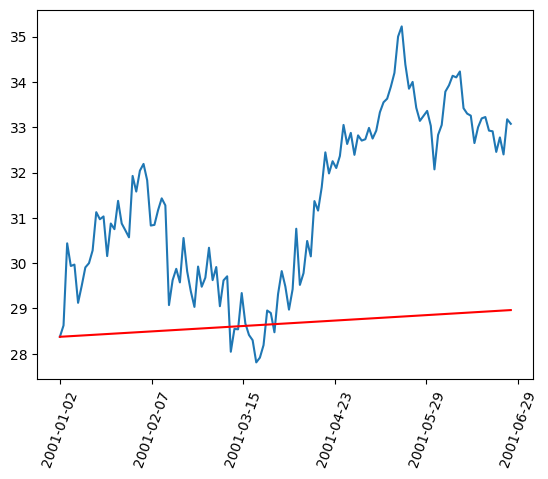



Stock = WVVI
total profit for this stock =  0.5924999714000001
rate of return =  0.41217389314782626


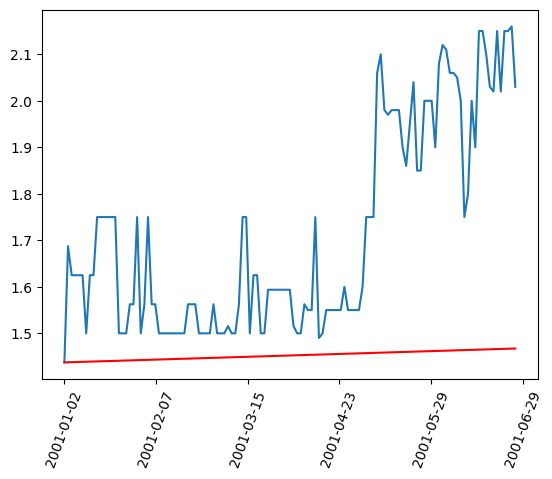



Stock = LRCX
total profit for this stock =  15.2749996185
rate of return =  1.0626086691130436


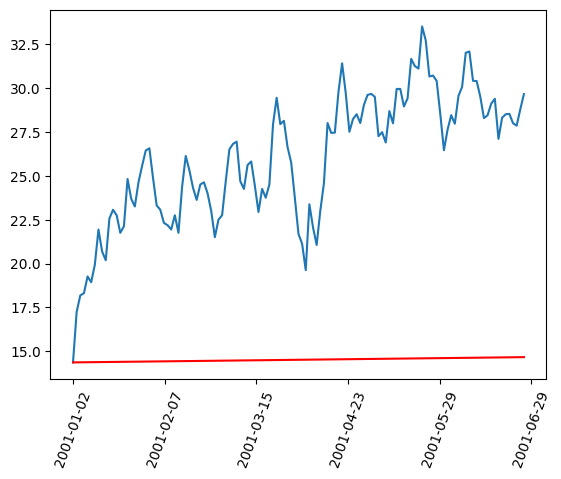



Stock = CACC
total profit for this stock =  1.7937498093000004
rate of return =  0.3037036714158732


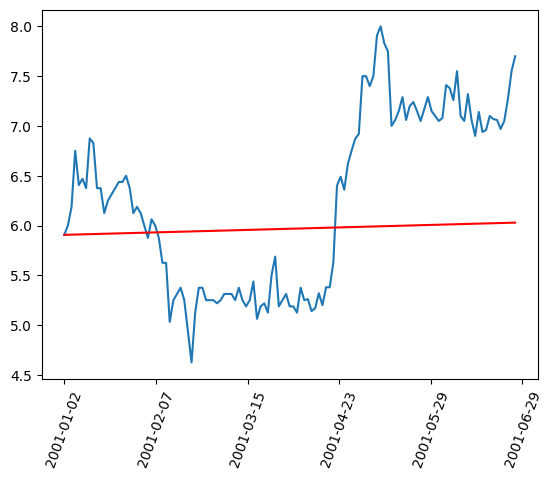



Stock = DRD
total profit for this stock =  4.9375
rate of return =  0.7523809523809524


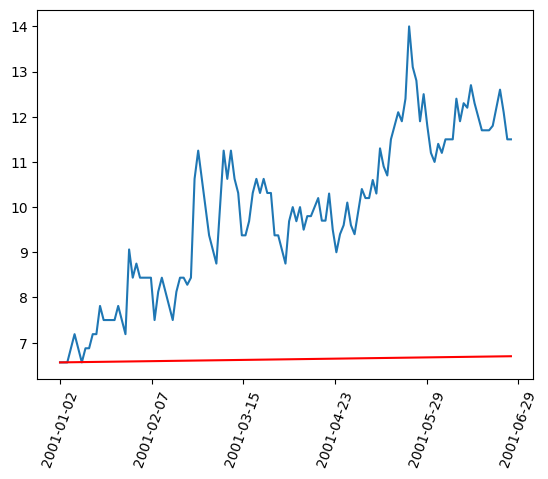



Stock = SWBI
total profit for this stock =  0.4486929998
rate of return =  3.7359950336052874


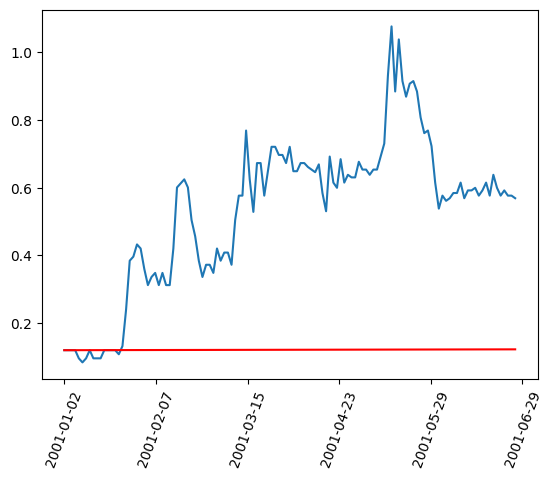



Stock = FICO
total profit for this stock =  13.031111717200002
rate of return =  0.9021539344408387


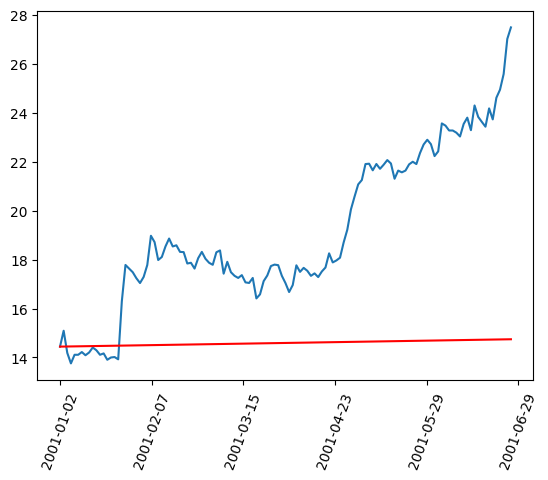



Stock = FCFS
total profit for this stock =  1.5374999046000002
rate of return =  2.108570378352262


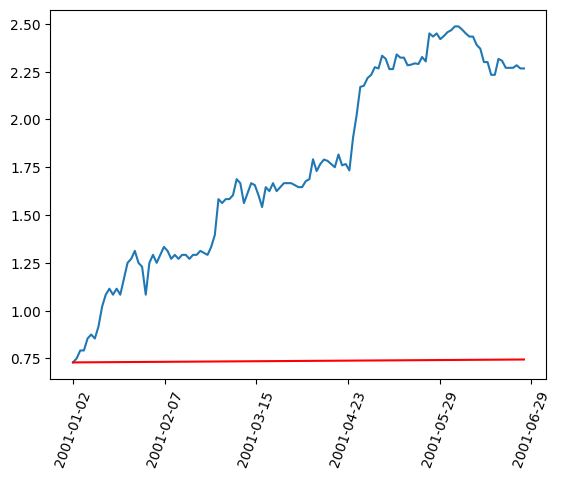



Stock = CLH
total profit for this stock =  0.5
rate of return =  0.5714285714285714


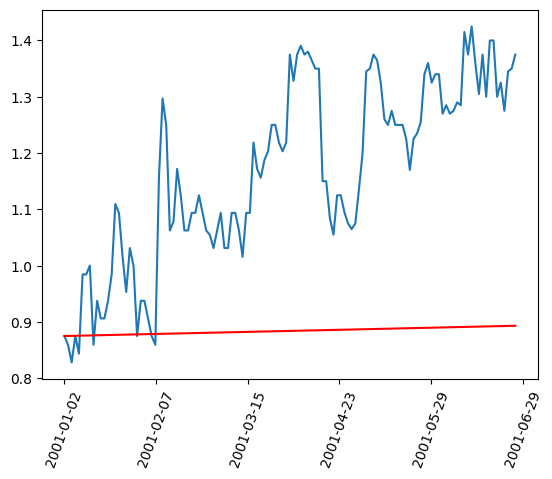



Stock = DEO
total profit for this stock =  -0.7374992371000033
rate of return =  -0.01650347943160846


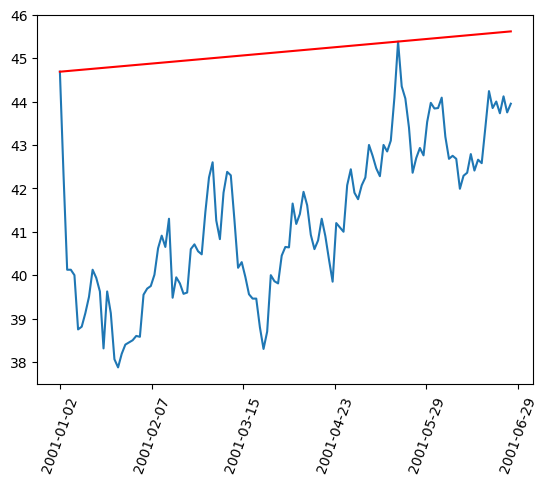



Stock = MGPI
total profit for this stock =  1.1937499045999997
rate of return =  0.27092196416453884


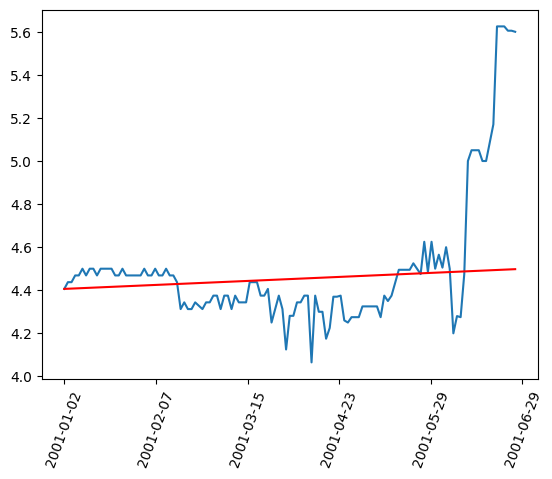



Stock = TSCO
total profit for this stock =  0.4642189741
rate of return =  0.8674460606582486


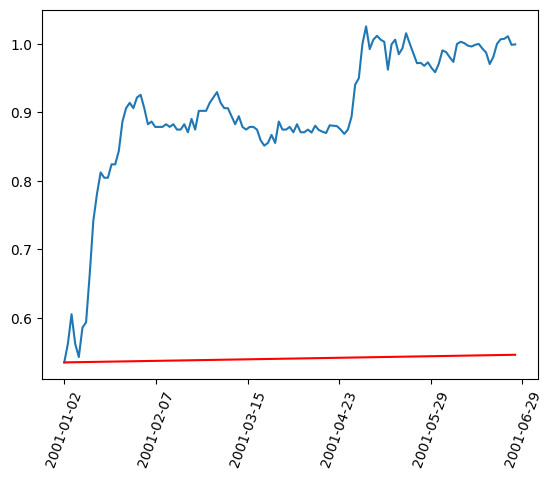



Stock = EZPW
total profit for this stock =  0.4441670179
rate of return =  1.42133445728


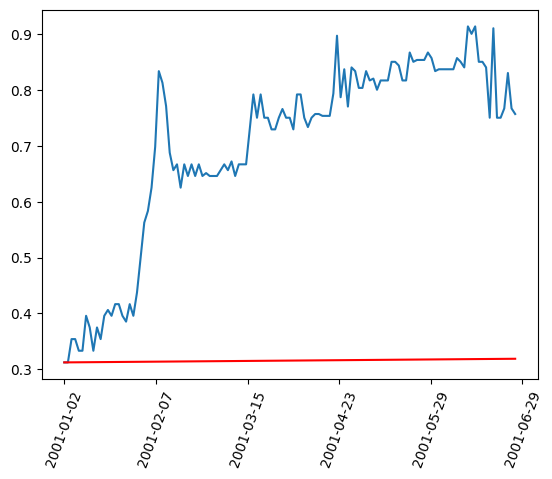



Stock = STZ
total profit for this stock =  3.125
rate of return =  0.4385964912280702


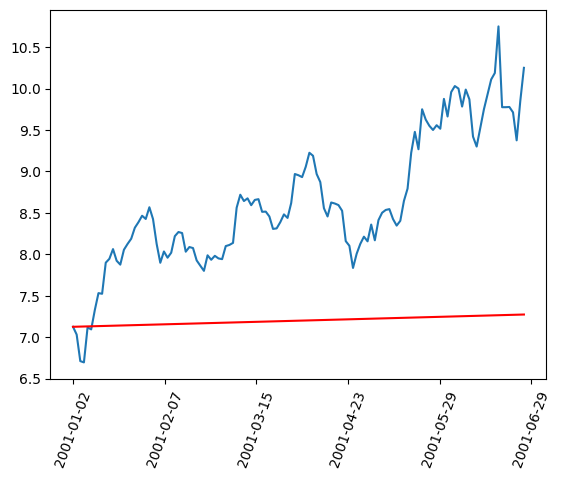



Stock = BKNG
total profit for this stock =  45.8624992371
rate of return =  5.435555465137778


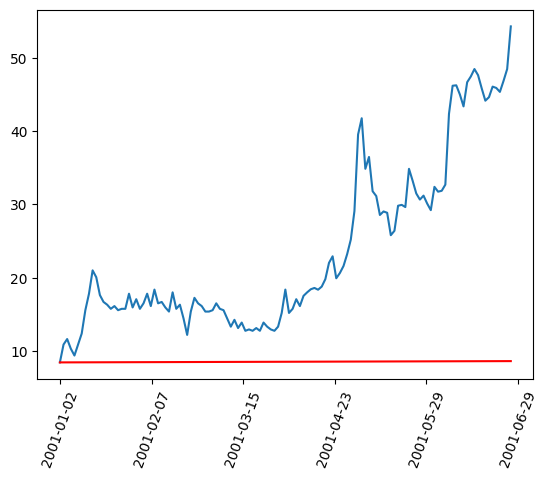



Stock = ACGL
total profit for this stock =  0.1388889551000001
rate of return =  0.08620694119108396


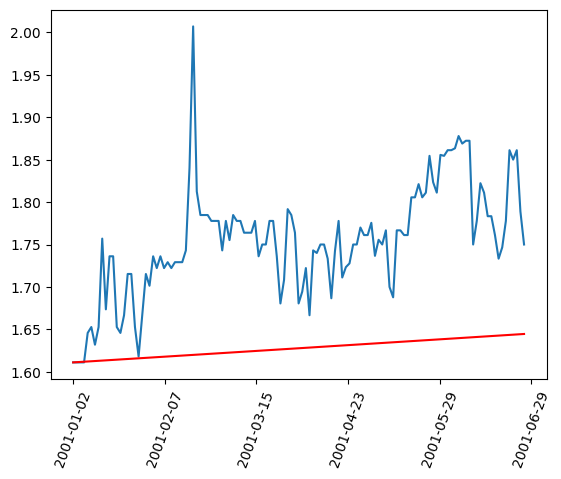



Stock = WCN
total profit for this stock =  0.01975297930000064
rate of return =  0.003174586148173786


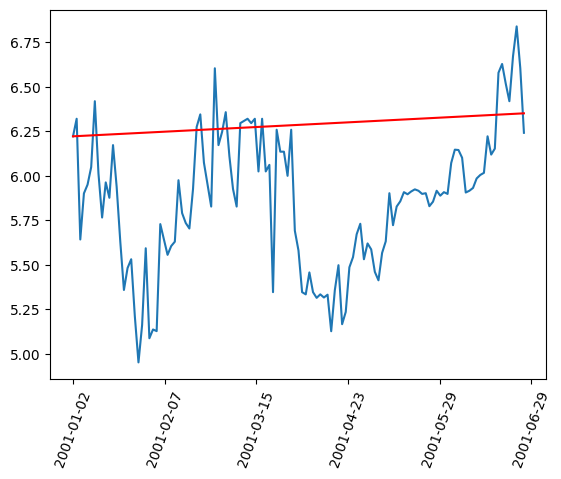



Stock = CPRT
total profit for this stock =  0.4192709923
rate of return =  0.5244302705410484


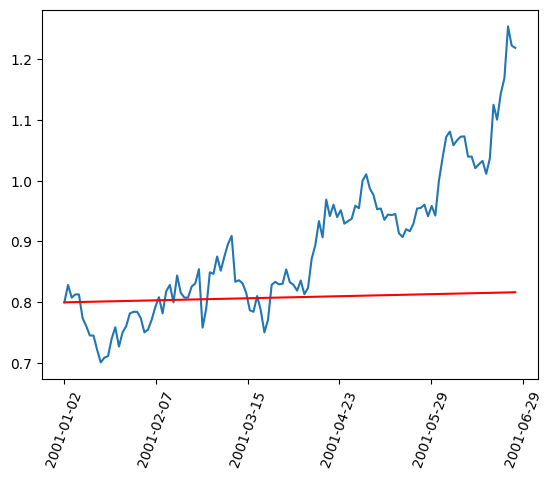



Stock = SO
total profit for this stock =  3.5484752654999987
rate of return =  0.18011170776473673


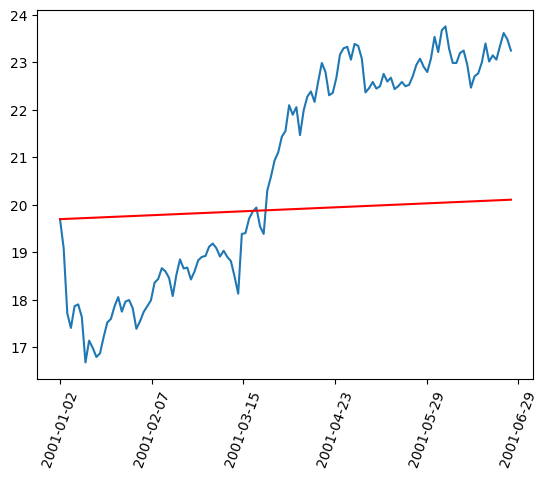



Stock = NVDA
total profit for this stock =  0.26171801240000003
rate of return =  2.098108212959066


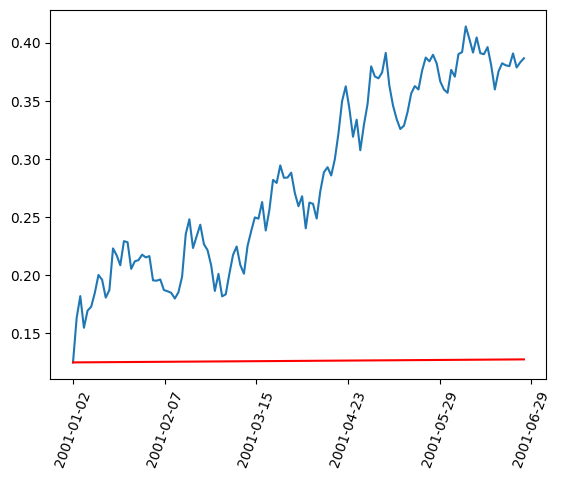



Stock = PSA
total profit for this stock =  5.462499618500001
rate of return =  0.22583977750904394


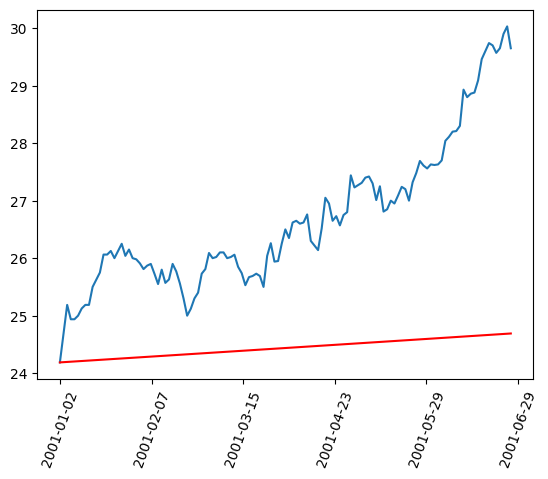



Stock = CCJ
total profit for this stock =  0.5916669368999998
rate of return =  0.2057971954434783


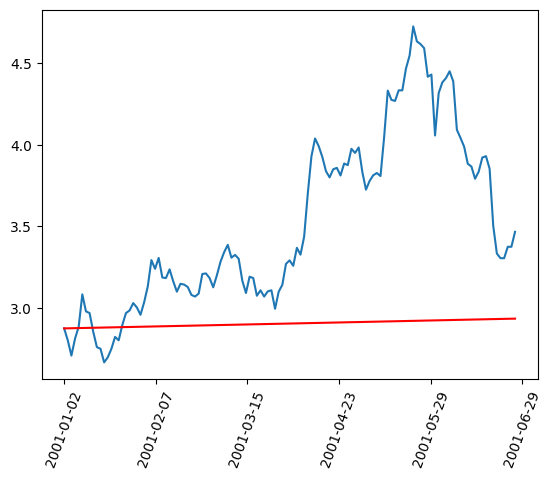



Stock = NVO
total profit for this stock =  0.4712500572
rate of return =  0.26493328031155783


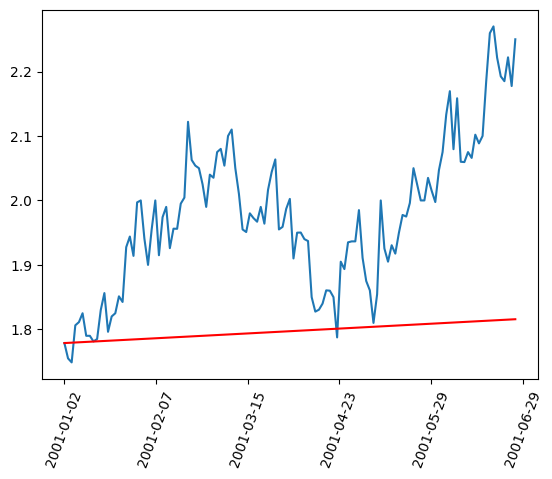

In [ ]:
# Make sure we don't run out of data. Although you should stop running this if you get too close anyway :/
if datetime.datetime(start_year, start_month, start_day).date() >= datetime.datetime.now().date():
  raise Exception("No historical data to test on")
if datetime.datetime(next_year, next_month, next_day).date() >= datetime.datetime.now().date():
  next_year, next_month, next_day = datetime.datetime.now().year, datetime.datetime.now().month, datetime.datetime.now().day

historical_data = remove_stocks_without_enough_data(data, min(i1, i2), i3).iloc[min(i1, i2):i3].dropna()
T = len(historical_data.iloc[:,0])/252
current_S0s = remove_stocks_without_enough_data(data, min(i1, i2), i3).iloc[max(i2, i4):i3].dropna().iloc[0]
next_S0s = historical_data.iloc[-1]

if not (max_sharpe is None):
  weights = (money_to_spend / np.dot(max_sharpe, current_S0s))
  current_rate_of_return = (np.dot(max_sharpe, next_S0s)/np.dot(max_sharpe, current_S0s) - 1)*100

next_time_data = remove_stocks_without_enough_data(data, i2, i3).iloc[i2:i3].dropna()
returns = next_time_data.pct_change() # Rate of returns for the stocks
mean_returns = np.array(returns.mean()) # Mean rate of returns
cov_matrix = np.array(returns.cov()) # Covariance matrix

if current_rate_of_return is None:
  max_sharpe = max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, round(T*252), tolerance)
  sdp, rp = portfolio_volatility(max_sharpe, cov_matrix, math.sqrt(round(T*252))), portfolio_expected_return(max_sharpe, mean_returns, round(T*252))
  sharpe_ratio = (rp - risk_free_rate) / sdp
  max_sharpe_allocation = pd.DataFrame(max_sharpe, index=historical_data.columns, columns=['allocation']) # Convert to pandas dataframe for better printing
  max_sharpe_allocation.allocation = [round(i*100, 5) for i in max_sharpe]
  max_sharpe_allocation = max_sharpe_allocation.T
  prev_max_sharpe_allocation = max_sharpe_allocation
  print("Current funds:", money_to_spend)
  print("Calculated portfolio with maximum Sharpe Ratio of " + str(sharpe_ratio) + ":")
  print(max_sharpe_allocation.drop([t for _, t in enumerate(max_sharpe_allocation.columns) if max_sharpe_allocation[t].iloc[0] <= 0], axis=1))
else:
  print("Money invested:", money_to_spend)
  print("Previous calculated portfolio with maximum Sharpe Ratio of " + str(sharpe_ratio) + ":")
  print(max_sharpe_allocation.drop([t for _, t in enumerate(max_sharpe_allocation.columns) if max_sharpe_allocation[t].iloc[0] <= 0], axis=1))
  print("\n")
  new_value = weights*np.dot(max_sharpe, next_S0s)
  print("New value of portfolio:", new_value)
  print("Profit for this iteration:", new_value - money_to_spend)
  print("Rate of return for this iteration:", current_rate_of_return)
  total_profit += new_value - money_to_spend
  print("Total profit", total_profit)
  print("-"*80)
  print('\n')
  money_to_spend = new_value
  max_sharpe = max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, round(T*252), tolerance)
  sdp, rp = portfolio_volatility(max_sharpe, mean_returns, cov_matrix, math.sqrt(round(T*252))), portfolio_expected_return(max_sharpe, mean_returns, round(T*252))
  sharpe_ratio = (rp - risk_free_rate) / sdp
  prev_max_sharpe_allocation = max_sharpe_allocation
  max_sharpe_allocation = pd.DataFrame(max_sharpe, index=next_time_data.columns, columns=['allocation']) # Convert to pandas dataframe for better printing
  max_sharpe_allocation.allocation = [round(i*100, 5) for i in max_sharpe]
  max_sharpe_allocation = max_sharpe_allocation.T
  print("New calculated portfolio with maximum Sharpe Ratio of " + str(sharpe_ratio) + ":")
  print(max_sharpe_allocation.drop([t for _, t in enumerate(max_sharpe_allocation.columns) if max_sharpe_allocation[t].iloc[0] <= 0], axis=1))
print("-"*80)
print("\n\n")

temp_stocks1 = remove_stocks_without_enough_data(data, min(i1, i2), i3).iloc[min(i1, i2):i3]
temp_stocks2 = remove_stocks_without_enough_data(data, min(i1, i2), i3)
for _, ticker in enumerate(historical_data.columns):      # Plot data
  if max_sharpe_allocation[ticker].iloc[0] <= 0 and prev_max_sharpe_allocation[ticker].iloc[0] <= 0:
    continue
  y1 = historical_data[ticker]
  S_T = y1.iloc[-1]
  t = np.array(list(range(len(y1))))/252
  middleIndex = round((len(y1) - 1)/2)

  dates = []                                # Put dates on the x axis
  for i in temp_stocks1.axes[0].tolist():
    if not (np.isnan(temp_stocks2.iloc[i,0])):
      dates.append(pd.to_datetime(i, unit="D").strftime("%Y-%m-%d"))
  plt.plot(t,y1)
  locs, labels = plt.xticks()
  dates_final = []
  dates_final.append(labels[0])
  for k in range(1, len(locs)-1):
    dates_final.append(dates[np.where(t == min(t, key=lambda x:abs(x-locs[k])))[0][0]])
  dates_final.append(labels[-1])
  plt.xticks(locs, dates_final, rotation=70)

  print("Stock =", ticker)
  print("total profit for this stock = ", S_T - current_S0s[ticker])
  print("rate of return = ", S_T/current_S0s[ticker] - 1)
  if i4 >= 0:
    goal_index = remove_stocks_without_enough_data(data, i2, i3).iloc[i4:i3].dropna().axes[0].tolist()[0]
    index_list = remove_stocks_without_enough_data(data, i1, i3).iloc[i1:i3].dropna().axes[0].tolist()
    curr_index = index_list[0]
    j = 0
    while curr_index < goal_index:
      j += 1
      curr_index = index_list[j]
    plt.scatter([t[j]], [current_S0s[ticker]], color="black")
    S0 = current_S0s[ticker]
    y2 = S0*np.exp(risk_free_rate*(t[j:] - t[j]))
    plt.plot(t[j:], y2, color='red')
  else:
    S0 = y1.iloc[0]
    S_T = y1.iloc[-1]
    y2 = S0*np.exp(risk_free_rate*(t))      # Risk free interest rate
    plt.plot(t, y2, color='red')
  plt.show()
  print("\n")

i1 = i2
i4 = i3
i1_day, i1_month, i1_year = start_day, start_month, start_year
next_day, next_month, next_year = add_days_months_or_years_to_date(next_day, next_month, next_year, unit_of_time, number_of_time_units_per_iteration)
start_day, start_month, start_year = add_days_months_or_years_to_date(next_day, next_month, next_year, unit_of_time, (-1)*number_of_time_units_lookback)
start_time, end_time = get_unix_time_from_date(start_day, start_month, start_year), get_unix_time_from_date(next_day, next_month, next_year)
i2, i3 = get_partition_timeseries_indices(start_time, end_time)

# The Topiary

Pascoe's algorithm relies on some Hilbert space theory. A basic overview is as follows:

Let $\Omega = \{r_1, r_2, \cdots, r_n\}$ be a set of $n$ elements which represent the rate of return of $n$ different stocks. We may define a function $K:\Omega \times \Omega \rightarrow \mathbb{R}$ by $$K(r_i, r_j) = Cov(r_i, r_j).$$
This function is in fact a positive semidefinite kernel function. Thus, we may use the canonical feature map to get an RKHS \mathcal{H} with kernel $K$.

We may similarly define a feature map $\hat{\phi}:\mathcal{M}^1(\Omega) \rightarrow \mathcal{H}$ defined by $$\hat{\phi}(\mu) = \int_\Omega k_x(z) d\mu(z).$$ For each $\mu \in \mathcal{M}^1(\Omega)$ define $\hat{\mu} := \hat{\phi}(\mu)$.

Let $\psi\in\mathcal{H}$ and let $c$ be some constant. Define $\eta\colon\mathcal{H}\to\mathbb{R}$ by
$$ \eta(f) = \left\langle c\psi - \frac{1}{2}f, f \right\rangle.$$
The directional derivative of $\eta(f)$ in the direction of $g$ (i.e. in the direction $g-f$) is given by
$$ \iota_g(f) = \left\langle f - c\psi, f - g \right\rangle.$$
Our goal is to find a local maximum for $\eta$ over probability measures. Pascoe's Aesthetic Margin Update theorem states that given a function $f$ (where $f^*$ is a probability measure), either $\eta$ is locally maximized at $f$, or there exists $z\in\Omega$ such that the directional derivative of $\eta$ in the direction of $\hat{\delta_z}$ is positive. Further, the maximizing element in that direction is given by $(1-t)f + t\hat{\delta_z}$, where
$$ t = \frac{\iota_{\hat{\delta_z}}(f)}{|| \hat{\delta_z} - f||^2}$$

Behold the algorithm:

1. Let $\mu_0$ be a measure that allocates all of all of it's weight into a single stock $z_0$.
2. Iteratively define $$\mu_n = \mu_{n-1} + \frac{\iota_{\hat{\delta_{z_n}}}(\hat{\mu_{n-1}})}{|| \hat{\delta_{z_n}} - \hat{\mu_{n-1}}||^2} \left( \delta_{z_n} - \mu_{n-1}\right)$$ where $z_n$ is the point such that $\iota_{\hat{\delta_z}}(\hat{\mu_0})$ is maximized (and positive).
3. If $\eta(\hat{\mu_n}) - \eta(\hat{\mu_{n-1}}) < tolerance$, then quit and return $\mu_n$.

In [ ]:
desired_stocks = 'all' # This can either be the string "all" for all stocks in our database, or it can be a selection of stocks, for example ['MMM', 'AAPL', 'AMZN', 'GOOG', 'TSLA', 'NVDA', 'MSFT', 'INTC', 'CAT', 'BA']
banned_stocks = ['GASS', 'SHIP', 'TEO', 'TOPS', 'TGS', 'MARA', 'UPST', 'RIOT', 'GRND'] # None for no banned stocks, or a list of the stocks you wish not to include, for example ['GASS', 'SHIP', 'TEO', 'TOPS', 'TGS', 'MARA', 'UPST', 'RIOT', 'GRND']
start_time_historical, end_time_historical = get_unix_time_from_date(1, 8, 2001), get_unix_time_from_date(1, 1, 2002) # For example, the input (1, 4, 2020) corresponds to the date April 1, 2020

In [ ]:
i1, i2 = get_partition_timeseries_indices(start_time_historical, end_time_historical)
if desired_stocks == "all":
  data = json_data
else:
  data = use_only_desired_stocks(json_data, desired_stocks)
if not(banned_stocks is None):
  data = remove_banned_stocks(data, banned_stocks)
data = remove_stocks_without_enough_data(data, i1, i2)
data = data.iloc[i1:i2]

# Function that runs the above algorithm
# Input:
#   M (numpy matrix): n x n covariance matrix for the random variables representing the rate of returns for n different assets
#   psi (numpy vector): length n vector where the entries represent the expected value of the rate of returns
#   precision (float): A number representing the cutoff point for when we wish to stop the algoriothm
# Output:
#   mu (numpy vector): length n vector representing the optimal weights for the corresponding assets
#   previous_mus (list of numpy vectors): A list of each weight in the process, used for tracking the progress of the algorithm.
def topiary_algorithm(M, psi, precision, positive_weights_only=False, starting_weight=None, const_for_eta=1):
  psi *= const_for_eta
  if starting_weight is None:
    mu = np.zeros(len(psi))
    mu[0]=1
  elif starting_weight == 'max':
    mu = np.zeros(len(psi))
    mu[np.argmax(psi)] = 1
  elif starting_weight == 'random':
    mu = np.random.random(size=len(psi))
    mu /= np.sum(mu)
  else:
    mu = starting_weight
  C = np.dot(M, mu)
  precision *= 2
  previous_mus = []
  previous_mus.append(np.copy(mu))

  while True:
    norm_mu_squared = np.dot(mu, C) # Calculating <mu, mu>
    phi_mu = np.dot(mu, psi) # Calculating <phi, mu>
    delta_z = np.argmax(psi - C)
    iota = (psi[delta_z] - C[delta_z]) - (phi_mu - norm_mu_squared)
    if iota <= 0:
      return mu, previous_mus
    norm_delta_minus_mu_squared = M[delta_z, delta_z] - 2*C[delta_z] + norm_mu_squared
    if math.isclose(0, norm_delta_minus_mu_squared):
      raise ZeroDivisionError("norm_delta_minus_mu_squared is too close to 0\n mu:",mu,"\n z=",delta_z)
    t = iota/norm_delta_minus_mu_squared

    if positive_weights_only:
      if t > 1:
        t = 1
      elif t < 0:
        t = 0

    mu = (1-t)*mu
    mu[delta_z] += t
    previous_mus.append(np.copy(mu))
    if t*iota < precision:
      return mu, previous_mus
    C = (1-t)*C + t*M[delta_z]

def negative_eta(mu, psi, M, const_for_eta):
  return .5*np.dot(mu, np.dot(M, mu)) - const_for_eta*np.dot(psi, mu)

def min_eta(psi, M, const_for_eta):
  num_assets = len(psi)
  args = (psi, M, const_for_eta)
  constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1}, # Making sure sum of weights must be equal to 1
                 {'type': 'ineq', 'fun': lambda x: np.min(x)})   # Making sure all elements are positive
  bound = (0.0,1.0)
  bounds = tuple(bound for asset in range(num_assets)) # Each asset can range from 0% of the weight to 100% of the weight

  result = sci.optimize.minimize(negative_eta, num_assets*[1./num_assets,], args=args, # Might be good to test how fast this algorithm converges/test different methods
                        method='SLSQP', bounds=bounds, constraints=constraints, tol=tolerance)['x']
  return result

In [ ]:
def display_topiary_algorithm(data, risk_free_rate, number_of_decimals, T=252, precision = 10**(-8), positive_weights_only_for_topiary=False, const_for_eta=1, too_high_rate=None,
                                      boundary_polynomial_degree=2, efficient_frontier_granularity=100, calculate_analytic_solution=True, starting_weight=None):

  if number_of_decimals < 2:
    raise ValueError("number_of_decimals must be greater than or equal to 2")
  if too_high_rate is None:
    too_high_rate = risk_free_rate*4

  returns = data.pct_change() # Rate of returns for the stocks
  mean_returns = np.array(returns.mean()) # Mean rate of returns
  cov_matrix = np.array(returns.cov()) # Covariance matrix

  # mean_returns = np.array(data.mean())  # This is what pascoe does in his code
  # cov_matrix = np.array(data.cov())
  for i, stock in enumerate(data.columns):
    if (mean_returns[i] - cov_matrix[i, i]) > risk_free_rate:
      diff = (mean_returns[i] - cov_matrix[i, i] - risk_free_rate) / 2
      mean_returns[i] -= diff
      cov_matrix[i, i] += diff

    if mean_returns[i] > too_high_rate:
      cov_matrix[i, i] += (mean_returns[i]-too_high_rate)/2
      mean_returns[i] -= (mean_returns[i]-too_high_rate)/2

  T_root = math.sqrt(T)

  print("Running Topiary Algorithm...")
  t = time.time()
  optimal_weight, path_taken = topiary_algorithm(np.copy(cov_matrix), np.copy(mean_returns), precision, positive_weights_only=positive_weights_only_for_topiary, starting_weight=starting_weight, const_for_eta=const_for_eta)
    # Calculate expected value and standard deviation
  results = np.zeros((3, len(path_taken)))
  for i in range(len(path_taken)):
    weights = path_taken[i]
    portfolio_std_dev, portfolio_return = portfolio_volatility(weights, mean_returns, cov_matrix, T_root), portfolio_expected_return(weights, mean_returns, T)
    results[0,i] = portfolio_std_dev # Standard deviation
    results[1,i] = portfolio_return  # expected return
    results[2,i] = (portfolio_return - risk_free_rate) / portfolio_std_dev # Sharpe ratio
  topiary = pd.DataFrame(optimal_weight, index=data.columns, columns=['allocation']) # Convert to pandas dataframe for better printing
  topiary.allocation = [round(i*100, number_of_decimals-2) for i in optimal_weight]
  topiary = topiary.T
  print("Topiary algorithm finished! This took", time.time() - t, "seconds.")

  print("Finding portfolio with minimizing eta using scipi...")
  t = time.time()
  max_eta = min_eta(mean_returns, cov_matrix, const_for_eta) # Get the portfolio maximizing eta
  eta_sd, eta_rp = portfolio_volatility(max_eta, mean_returns, cov_matrix, T_root), portfolio_expected_return(max_eta, mean_returns, T)  # Calculate expected value and standard deviation
  max_eta_allocation = pd.DataFrame(max_eta, index=data.columns, columns=['allocation']) # Convert to pandas dataframe for better printing
  max_eta_allocation.allocation = [round(i*100, number_of_decimals-2) for i in max_eta]
  max_eta_allocation = max_eta_allocation.T
  print("Portfolio found! This took", time.time() - t, "seconds.")

  print("Grabbing info for individual stocks...")
  t = time.time()
  w, an_vol_individual_stocks, an_rt_individual_stocks = np.zeros(len(mean_returns)), np.zeros(len(mean_returns)), np.zeros(len(mean_returns))
  for i in range(len(mean_returns)):
    w[i-1] = 0
    w[i] = 1
    an_vol_individual_stocks[i] = portfolio_volatility(w, mean_returns, cov_matrix, T_root)
    an_rt_individual_stocks[i] = portfolio_expected_return(w, mean_returns, T)
  print("Information calculated! This took", time.time() - t, "seconds.")

  print("Finding portfolio with maximum Sharpe ratio...")
  t = time.time()
  max_sharpe = max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, T, tolerance) # Get the portfolio with the max Sharpe ratio
  sdp, rp = portfolio_volatility(max_sharpe, mean_returns, cov_matrix, T_root), portfolio_expected_return(max_sharpe, mean_returns, T)  # Calculate expected value and standard deviation
  max_sharpe_allocation = pd.DataFrame(max_sharpe, index=data.columns, columns=['allocation']) # Convert to pandas dataframe for better printing
  max_sharpe_allocation.allocation = [round(i*100, number_of_decimals-2) for i in max_sharpe]
  max_sharpe_allocation = max_sharpe_allocation.T
  print("Portfolio found! This took", time.time() - t, "seconds.")

  print("Finding portfolio with minumum volatility...")
  t = time.time()
  min_vol = min_variance(mean_returns, cov_matrix, T, tolerance) # Get the portfolio with the min volatility
  sdp_min, rp_min = portfolio_volatility(min_vol, mean_returns, cov_matrix, T_root), portfolio_expected_return(min_vol, mean_returns, T) # Calculate expected value and standard deviation
  min_vol_allocation = pd.DataFrame(min_vol, index=data.columns, columns=['allocation'])  # Convert to pandas dataframe for better printing
  min_vol_allocation.allocation = [round(i*100, number_of_decimals-2) for i in min_vol_allocation.allocation]
  min_vol_allocation = min_vol_allocation.T
  print("Portfolio found! This took", time.time() - t, "seconds.")

  print("Finding efficient frontier...")
  t = time.time()
  target = np.linspace(min(min(results[1,:]), min(an_rt_individual_stocks)), max(max(results[1,:]), max(an_rt_individual_stocks)), efficient_frontier_granularity)
  dx = target[1] - target[0]
  target = np.append(target, [target[len(target)-1] + dx])
  target = np.append([target[0] - dx], target)
  efficient_portfolio_means = efficient_frontier(mean_returns, cov_matrix, target, T, tolerance)
  boundary_poly_coefs = np.polynomial.polynomial.polyfit(target, efficient_portfolio_means, boundary_polynomial_degree)
  print("Efficient frontier found! This took", time.time() - t, "seconds.")

  if calculate_analytic_solution:
    print("Calculating Analytic Solution...")
    if np.linalg.cond(cov_matrix) < 10**15:
      t = time.time()
      e = np.ones(len(mean_returns))
      sigma_inv_e = solve_matrix_equation(cov_matrix, e, assume_a="sym")
      w_min_var = sigma_inv_e/np.dot(e, sigma_inv_e)
      sigma_inv_m =  solve_matrix_equation(cov_matrix, mean_returns, assume_a="sym")
      w_mk = sigma_inv_m/np.dot(e, sigma_inv_m)
      w_mk /= sum(w_mk)
      W = lambda x: (1 - x)*w_min_var + x*w_mk
      w_topiary = W(const_for_eta*(np.dot(mean_returns, sigma_inv_e)))
      expected_ret_analytic_top, std_dev_analytic_top = portfolio_expected_return(w_topiary, mean_returns, T), portfolio_volatility(w_topiary, mean_returns, cov_matrix, T_root)
      mu_M = portfolio_expected_return(w_mk, mean_returns, T)
      sigma_M = portfolio_volatility(w_mk, cov_matrix, T_root)
      mu_r = lambda x: risk_free_rate + ((mu_M - risk_free_rate)/sigma_M)*x
      l = np.arange(-1000, 1000, .01)
      std_dev_analytic_CML = np.arange(0, 100, .0001)
      expected_ret_analytic_CML = mu_r(std_dev_analytic_CML)
      std_dev_analytic_eff_front, expected_ret_analytic_eff_front = [None]*len(l), [None]*len(l)
      for i in range(len(l)):
        expected_ret_analytic_eff_front[i] = portfolio_expected_return(W(l[i]), mean_returns, T)
        std_dev_analytic_eff_front[i] = portfolio_volatility(W(l[i]), cov_matrix, T_root)

      j = 0
      while j < len(expected_ret_analytic_eff_front) and expected_ret_analytic_eff_front[j] < min(target):
        j += 1
      expected_ret_analytic_eff_front = expected_ret_analytic_eff_front[max(j-50,0):]
      std_dev_analytic_eff_front = std_dev_analytic_eff_front[max(j-50,0):]
      j = 0
      while j < len(expected_ret_analytic_eff_front) and expected_ret_analytic_eff_front[j] <= max(target):
        j += 1
      expected_ret_analytic_eff_front = expected_ret_analytic_eff_front[:j+50]
      std_dev_analytic_eff_front = std_dev_analytic_eff_front[:j+50]
      j = 0
      while j < len(expected_ret_analytic_CML) and expected_ret_analytic_CML[j] <= max(target):
        j += 1
      expected_ret_analytic_CML = expected_ret_analytic_CML[:j+10]
      std_dev_analytic_CML = std_dev_analytic_CML[:j+10]

      w_mk = pd.DataFrame(w_mk, index=data.columns, columns=['allocation']) # Convert to pandas dataframe for better printing
      w_mk.allocation = [round(i*100, number_of_decimals-2) for i in w_mk.allocation]
      w_mk = w_mk.T
      print("Analytic soltuion computed! This took", time.time() - t, "seconds.")
      singular = False
    else:
      print("Warning: Covariance matrix is too close to being singular. Analytic solution cannot be computed.")
      singular = True
      w_mk = None
  else:
    w_mk = None
    singular = True


  print("Displaying results")
  print("\n\n\n")

  print("-"*80) # Printing info about topiary portfolio
  print("Topiaric portfolio calculated by our Topiary algorithm\n")
  print("Annualised Return:", round(topiary_expected_return, number_of_decimals))
  print("Annualised Volatility:", round(topiary_volatility, number_of_decimals))
  print("Sharpe Ratio:", round((topiary_expected_return - risk_free_rate) / topiary_volatility, number_of_decimals))
  print("\n")
  print(topiary.drop([t for _, t in enumerate(topiary.columns) if topiary[t].iloc[0] <= 0], axis=1))

  print("-"*80) # Printing info about maximal eta portfolio
  print("Maximum Eta Portfolio Allocation\n")
  print("Annualised Return:", round(eta_rp, number_of_decimals))
  print("Annualised Volatility:", round(eta_sd, number_of_decimals))
  print("Sharpe Ratio:", round((eta_rp - risk_free_rate) / eta_sd, number_of_decimals))
  print("\n")
  print(max_eta_allocation.drop([t for _, t in enumerate(max_eta_allocation.columns) if max_eta_allocation[t].iloc[0] <= 0], axis=1))

  print("-"*80) # Printing info about maximal Sharpe ratio portfolio
  print("Maximum Sharpe Ratio Portfolio Allocation\n")
  print("Annualised Return:", round(rp, number_of_decimals))
  print("Annualised Volatility:", round(sdp, number_of_decimals))
  print("Sharpe Ratio:", round((rp - risk_free_rate) / sdp, number_of_decimals))
  print("\n")
  print(max_sharpe_allocation.drop([t for _, t in enumerate(max_sharpe_allocation.columns) if max_sharpe_allocation[t].iloc[0] <= 0], axis=1))

  print("-"*80) # Printing info about minimial volatility portfolio
  print("Minimum Volatility Portfolio Allocation\n")
  print("Annualised Return:", round(rp_min, number_of_decimals))
  print("Annualised Volatility:", round(sdp_min, number_of_decimals))
  print("Sharpe Ratio:", round((rp_min - risk_free_rate) / sdp_min, number_of_decimals))
  print("\n")
  print(min_vol_allocation.drop([t for _, t in enumerate(min_vol_allocation.columns) if min_vol_allocation[t].iloc[0] <= 0], axis=1))

  if not singular:
    print("-"*80)
    print("Analytic Market Portfolio Allocation\n")
    print("Annualised Return:", round(mu_M, number_of_decimals))
    print("Annualised Volatility:", round(sigma_M, number_of_decimals))
    print("Sharpe Ratio:", round((mu_M - risk_free_rate) / sigma_M, number_of_decimals))
    print("\n")
    print(w_mk)
  print("-"*80)
  print("Polynomial Approximation for the Boundary\n")
  boundary_poly_coefs_saved = np.copy(boundary_poly_coefs)
  s = str(round(boundary_poly_coefs[0], number_of_decimals))
  if boundary_poly_coefs[1] >= 0:
    s += " + "
  else:
    s += " - "
    boundary_poly_coefs[1] = (-1)*boundary_poly_coefs[1]
  s += str(round(boundary_poly_coefs[1], number_of_decimals)) + "y"
  for i in range(2, len(boundary_poly_coefs)):
    if boundary_poly_coefs[i] >= 0:
      s += " + "
    else:
      s += " - "
      boundary_poly_coefs[i] = (-1)*boundary_poly_coefs[i]
    s += str(round(boundary_poly_coefs[i], number_of_decimals)) + "y^" + str(i)
  print(s)
  print("\n")

  plt.figure(figsize=(10, 7))
  plt.scatter(results[0,:],results[1,:],c=results[2,:],cmap='YlGnBu', marker='o', s=10)
  for i in range(len(results[0,:]) - 1):
    plt.annotate('', xy=(results[0,i+1], results[1,i+1]), xytext=(results[0,i], results[1,i]),
                 arrowprops=dict(facecolor='black', arrowstyle='->', alpha=0.5))
  color_bar = plt.colorbar()
  color_bar.set_label('Sharpe Ratio')
  plt.scatter(sdp,rp,marker='*',color='y',s=200, label='Maximum Sharpe ratio')
  plt.scatter(sdp_min, rp_min, marker='*',color='g',s=200, label='Minimum volatility')
  # plt.scatter(an_vol_individual_stocks, an_rt_individual_stocks, color='red', marker='o',s=20)
  # for i, txt in enumerate(data.columns):
  #   plt.annotate(txt, (an_vol_individual_stocks[i],an_rt_individual_stocks[i]), xytext=(10,0), textcoords='offset points')
  plt.plot(efficient_portfolio_means, target, linestyle='-.', color='black', label='positive efficient frontier')
  plt.plot(np.polyval(boundary_poly_coefs_saved[::-1], target), target, color='green', alpha=0.5, label='polynomial approximation')
  if not singular:
    plt.scatter([sigma_M], [mu_M], color='red', marker='o',s=50)
    plt.annotate("Market Portflio", (sigma_M, mu_M), xytext=(10,0), textcoords='offset points')
    plt.plot(std_dev_analytic_eff_front, expected_ret_analytic_eff_front, linestyle='-.', color='red', alpha=0.5, label="analytic soltution for efficient frontier")
    # plt.plot(std_dev_analytic_CML, expected_ret_analytic_CML, linestyle='-.', color='blue', alpha=0.5, label="analytic soltution for capital market line")
    plt.scatter(std_dev_analytic_top, expected_ret_analytic_top, marker='*',color='b',s=200, label='Analytic Topiary')
  plt.title('Calculated Portfolio Optimization based on Efficient Frontier')
  plt.xlabel('annualised volatility')
  plt.ylabel('annualised returns')
  plt.legend(labelspacing=0.8)

  return max_sharpe, min_vol, w_mk, (target, efficient_portfolio_means), boundary_poly_coefs_saved

In [ ]:
num_decimal_points = 10
precision = 10**(-15)
boundary_polynomial_degree = 6
efficient_frontier_granularity = 10
calculate_analytic_solution = True
num_days_to_estimate_into_future=252
positive_weights_only_for_topiary = True
starting_weight = None
const_for_eta = .3

max_sharpe, min_vol, w_mk, (target, efficient_portfolio_means), boundary_poly_coefs_saved = display_topiary_algorithm(
                                         data=data.dropna(), risk_free_rate=risk_free_rate, positive_weights_only_for_topiary=positive_weights_only_for_topiary,
                                         number_of_decimals=num_decimal_points, T=num_days_to_estimate_into_future, precision=precision,
                                         boundary_polynomial_degree=boundary_polynomial_degree, starting_weight=starting_weight,
                                         efficient_frontier_granularity=efficient_frontier_granularity,
                                         calculate_analytic_solution=calculate_analytic_solution, const_for_eta=const_for_eta)


Running Topiary Algorithm...


NameError: name 'topiary_algorithm' is not defined

In [ ]:
def test_topiary_algorithm(data, risk_free_rate, number_of_decimals, T=252, precision=10**(-8), positive_weights_only_for_topiary=False, starting_weight=None, eta_constant_range=(0,2), granularity=100, too_high_rate=None):

  returns = data.pct_change() # Rate of returns for the stocks
  mean_returns = np.array(returns.mean()) # Mean rate of returns
  cov_matrix = np.array(returns.cov()) # Covariance matrix
  T_root = math.sqrt(T)
  constants_for_eta = np.linspace(eta_constant_range[0], eta_constant_range[1], granularity)
  ETA = lambda x: np.dot(mean_returns, x) - .5* np.dot(x, np.dot(cov_matrix, x))

  if number_of_decimals < 2:
    raise ValueError("number_of_decimals must be greater than or equal to 2")
  if too_high_rate is None:
    too_high_rate = risk_free_rate*4

  for i, stock in enumerate(data.columns):
    if (mean_returns[i] - cov_matrix[i, i]) > risk_free_rate:
      diff = (mean_returns[i] - cov_matrix[i, i] - risk_free_rate) / 2
      mean_returns[i] -= diff
      cov_matrix[i, i] += diff

    if mean_returns[i] > too_high_rate:
      cov_matrix[i, i] += (mean_returns[i]-too_high_rate)/2
      mean_returns[i] -= (mean_returns[i]-too_high_rate)/2

  for const in constants_for_eta:
    print("Eta = (" + str(const) + ")m*w - 1/2 wΣw\n")
    print("Running Topiary Algorithm...")
    t = time.time()
    optimal_weight, path_taken = topiary_algorithm(np.copy(cov_matrix), np.copy(mean_returns), precision, positive_weights_only=positive_weights_only_for_topiary, starting_weight=starting_weight, const_for_eta=const)
    topiary_volatility, topiary_expected_return = portfolio_volatility(optimal_weight, cov_matrix, T_root), portfolio_expected_return(optimal_weight, mean_returns, T)  # Calculate expected value and standard deviation
    topiary = pd.DataFrame(optimal_weight, index=data.columns, columns=['allocation']) # Convert to pandas dataframe for better printing
    topiary.allocation = [round(i*100, number_of_decimals-2) for i in optimal_weight]
    topiary = topiary.T
    print("Topiary algorithm finished! This took", time.time() - t, "seconds.")

    print("Finding portfolio with minimizing eta using scipi...")
    t = time.time()
    max_eta = min_eta(mean_returns, cov_matrix, const) # Get the portfolio maximizing eta
    eta_sd, eta_rp = portfolio_volatility(max_eta, cov_matrix, T_root), portfolio_expected_return(max_eta, mean_returns, T)  # Calculate expected value and standard deviation
    max_eta_allocation = pd.DataFrame(max_eta, index=data.columns, columns=['allocation']) # Convert to pandas dataframe for better printing
    max_eta_allocation.allocation = [round(i*100, number_of_decimals-2) for i in max_eta]
    max_eta_allocation = max_eta_allocation.T
    print("Portfolio found! This took", time.time() - t, "seconds.")

    if const == 0:
      print("Finding portfolio with minumum volatility...")
      t = time.time()
      min_vol = min_variance(mean_returns, cov_matrix, T, tolerance) # Get the portfolio with the min volatility
      sdp_min, rp_min = portfolio_volatility(min_vol, cov_matrix, T_root), portfolio_expected_return(min_vol, mean_returns, T) # Calculate expected value and standard deviation
      min_vol_allocation = pd.DataFrame(min_vol, index=data.columns, columns=['allocation'])  # Convert to pandas dataframe for better printing
      min_vol_allocation.allocation = [round(i*100, number_of_decimals-2) for i in min_vol_allocation.allocation]
      min_vol_allocation = min_vol_allocation.T
      print("Portfolio found! This took", time.time() - t, "seconds.")

    print('\n\n\n')
    print("-"*80) # Printing info about topiary portfolio
    print("Topiaric portfolio calculated by our Topiary algorithm\n")
    print("Annualised Return:", round(topiary_expected_return, number_of_decimals))
    print("Annualised Volatility:", round(topiary_volatility, number_of_decimals))
    print("Sharpe Ratio:", round((topiary_expected_return - risk_free_rate) / topiary_volatility, number_of_decimals))
    print("Eta(w):", round(ETA(optimal_weight), number_of_decimals))
    print("\n")
    print(topiary.drop([t for _, t in enumerate(topiary.columns) if topiary[t].iloc[0] <= 0], axis=1))

    print("-"*80) # Printing info about maximal eta portfolio
    print("Maximum Eta Portfolio Allocation\n")
    print("Annualised Return:", round(eta_rp, number_of_decimals))
    print("Annualised Volatility:", round(eta_sd, number_of_decimals))
    print("Sharpe Ratio:", round((eta_rp - risk_free_rate) / eta_sd, number_of_decimals))
    print("Eta(w):", round(ETA(max_eta), number_of_decimals))
    print("\n")
    print(max_eta_allocation.drop([t for _, t in enumerate(max_eta_allocation.columns) if max_eta_allocation[t].iloc[0] <= 0], axis=1))
    print("")

    if ETA(optimal_weight) > ETA(max_eta):
      print("Topiaric eta (" + str(ETA(optimal_weight)) + ") is better than using scipy (" + str(ETA(max_eta)) + ")")
    else:
      print("Difference in ETA:", abs(ETA(optimal_weight) - ETA(max_eta)))

    if const == 0:
      print("-"*80) # Printing info about minimial volatility portfolio
      print("Minimum Volatility Portfolio Allocation\n")
      print("Annualised Return:", round(rp_min, number_of_decimals))
      print("Annualised Volatility:", round(sdp_min, number_of_decimals))
      print("Sharpe Ratio:", round((rp_min - risk_free_rate) / sdp_min, number_of_decimals))
      print("Eta(w):", round(ETA(min_vol), number_of_decimals))
      print("\n")
      print(min_vol_allocation.drop([t for _, t in enumerate(min_vol_allocation.columns) if min_vol_allocation[t].iloc[0] <= 0], axis=1))

      if ETA(optimal_weight) > ETA(min_vol):
        print("Topiaric eta (" + str(ETA(optimal_weight)) + ") is better than min volatility (" + str(ETA(min_vol)) + ")")
      else:
        print("Difference in ETA:", abs(ETA(optimal_weight) - ETA(min_vol)))

    print('\n\n\n')




In [ ]:
num_decimal_points = 10
precision = 10**(-15)
num_days_to_estimate_into_future=252
positive_weights_only_for_topiary = True
starting_weight = None
eta_constant_range = (0, 2)
eta_constant_granularity = 101

test_topiary_algorithm(data=data.dropna(), risk_free_rate=risk_free_rate, number_of_decimals=num_decimal_points, T=num_days_to_estimate_into_future,
                       precision=precision, positive_weights_only_for_topiary=positive_weights_only_for_topiary, starting_weight=starting_weight,
                       eta_constant_range=eta_constant_range, granularity=eta_constant_granularity)

Eta = (0.0)m*w - 1/2 wΣw

Running Topiary Algorithm...
Topiary algorithm finished! This took 2.7944977283477783 seconds.
Finding portfolio with minimizing eta using scipi...
Portfolio found! This took 34.766080379486084 seconds.
Finding portfolio with minumum volatility...
Portfolio found! This took 42.58000707626343 seconds.




--------------------------------------------------------------------------------
Topiaric portfolio calculated by our Topiary algorithm

Annualised Return: 0.2133798033
Annualised Volatility: 0.0444347724
Sharpe Ratio: 3.8613858891
Eta(w): 0.0008428277


                 STE       PEP      PSA       FDS        NI       ESS  \
allocation  0.006628  6.311363  0.81672  0.215192  0.041379  4.832627   

                FICO       TAP        DOC        EW  ...       FCX       HAL  \
allocation  0.004206  6.859671  16.888087  0.567244  ...  0.002044  0.267514   

                 VLO       TYL       EXC      ROST       BAX       WTW  \
allocation  1.104683  0.009501 

KeyboardInterrupt: 

In [ ]:
price ={}
def input_from_google(stock_table_2return, banned):
    banned_list = banned.to_list()
    all_stocks = stock_table_2return.columns.to_list()
    real_banned_list = []

    for banned_stock in banned_list:
        if banned_stock in all_stocks:
            real_banned_list += [banned_stock]

    stock_table_2return.drop(columns=real_banned_list, inplace=True)
    #print(stock_table_2return.dtypes)

    for column in stock_table_2return.columns:
        #print(column, stock_table_2return[column].dtypes)
        #stock_table_2return[column] = stock_table_2return[column].apply(lambda x: float(str(x).replace(',', '').replace('$','').replace(' ', '')))
        #print(column)
        #print( stock_table_2return[column])
        price[column]=stock_table_2return[column][-1]
        stock_table_2return[column] = (stock_table_2return.shift(periods=-increment)[column] - stock_table_2return[column]) / stock_table_2return[column]

    return stock_table_2return.dropna()

def topiary(covariance_table, average_per_stock, precision_lvl, stock_list, full_stock_list):
    # start topiary
    topiary_table = pd.Series({x: 0 for x in stock_list})                     # list of weights (portfolio)
    list_search = pd.Series({x: (average_per_stock[x]) for x in stock_list})
    max_stock = list_search.idxmax()                                          # pick stock with highest average price
    topiary_table[max_stock] = 1                                              # allocate 100% of portfolio to max_stock
    topiary_covariance = covariance_table[max_stock]                          # max_stock's column of covariance matrix
    #print(list_search*251)
    #print(average_per_stock*251)
    counter =0

    # Calculate the final topiary
    precision = 10**(-precision_lvl)
    while True:
        norm = topiary_table.dot(topiary_covariance)                          # portfolio dot covariance column
        score = topiary_table.dot(average_per_stock) - norm                   # "eta" score equation


        # guess: find the stock most orthogonal to the portfolio
        vector_x = average_per_stock - topiary_covariance                     # primitive "eta" calculations
        max_stock = vector_x.idxmax()                                         # maximize "eta" calculations
        max_score = average_per_stock[max_stock] - topiary_covariance[max_stock] # recalculate score with new max_stock

        # guess: calculate the length of the orthogonal vector
        if max_score - score < precision:
            print(f"Corrected annualized median:\t{(score + norm/2)*251/increment}")
            print(f"Corrected annualized mean:\t\t{(score + norm)*251/increment}")
            print(f"Corrected annualized deviation:\t{math.sqrt(norm*251/increment)}")
            print(f"Corrected median:\t\t{(score + norm / 2)}")
            print(f"Corrected mean:\t\t\t{(score + norm)}")
            print(f"Corrected deviation:\t{math.sqrt(norm)}")
            break
        t = (max_score - score) / (norm+covariance_table.at[max_stock, max_stock] - 2 * topiary_covariance[max_stock])
        if t > 1:
            t = 1
        if t < 0:
            t = 0

        topiary_table = topiary_table * (1-t)                                  # shrink existing allocations by (1-t)
        topiary_table[max_stock] += t                                          # add new allocation with weight t

        topiary_covariance = topiary_covariance * (1-t) + covariance_table[max_stock] * t # reassign covariance matrix column

    topiary_table_out = pd.Series({x: 0 for x in full_stock_list})
    for stock in stock_list:
        topiary_table_out[stock]=topiary_table[stock]
    #print(topiary_covariance.to_string())
    return topiary_table_out

In [ ]:
memory_time = 60
averages_per_window = pd.DataFrame()
precision = 8
increment = 20
money=33600
topiaries = pd.DataFrame()
performances = pd.DataFrame()
riskfreerate = (.05/(251)) * increment
marginrate = (.15/(251)) * increment
toohighrate = 4 * riskfreerate

NameError: name 'pd' is not defined

In [ ]:
### MAIN ###
# import data
#daily_open_stock = input(stock_files)
#print(google_data.dtypes)
daily_open_stock = input_from_google(google_data, banned_stocks)
days_list = daily_open_stock.index
#print(daily_open_stock)
#print(days_list)

daily_open_stock.reset_index(drop=True, inplace=True)
daily_open_stock['cash'] = riskfreerate
#print(daily_open_stock)


# topiary
# Variables for the while loop
all_days = daily_open_stock.shape[0]
iterator = all_days-1 #memory_time+increment
timer = 0
performance = 0
performances = pd.DataFrame(
    data={stock: performance for stock in daily_open_stock.columns},
    index=[iterator - increment]
)


while iterator < all_days:
    timer += 1
    print(f'{iterator}/{all_days}')
    #print(days_list[iterator])

    # Collect data
    #print(daily_open_stock)
    data_memorized = daily_open_stock.iloc[iterator - memory_time+1:iterator+2].dropna(axis=1)

    #dates_memorized = data_memorized.index
    #print(f'{dates_memorized[-1]}')

    average_per_stock_recent = data_memorized.mean()
    covariance_recent = data_memorized.cov()

    # Enforce non-persistence of arbitrage, assumptions about maximum growth

    for stock in data_memorized.columns:
        if (average_per_stock_recent[stock] - covariance_recent.at[stock, stock]) > riskfreerate:
            diff = (average_per_stock_recent[stock] - covariance_recent.at[stock, stock] - riskfreerate) / 2
            average_per_stock_recent[stock] -= diff
            covariance_recent.at[stock, stock] += diff

        if average_per_stock_recent[stock] > toohighrate:
            covariance_recent.at[stock, stock] += (average_per_stock_recent[stock]-toohighrate)/2
            average_per_stock_recent[stock] -= (average_per_stock_recent[stock]-toohighrate)/2


    #print(average_per_stock_recent*251)
    #covariance_recent=5*covariance_recent

    # Calculate topiary
    topiaries[timer] = topiary(
        covariance_table=covariance_recent,
        average_per_stock=average_per_stock_recent,
        precision_lvl=precision,
        stock_list=data_memorized.columns,
        full_stock_list=daily_open_stock.columns)
    #print(topiaries[timer])
    print(price)
    topiaries = topiaries.copy()
    for stock in data_memorized.columns:
        if topiaries[timer][stock] > 0:
            print(stock)
            print(f"\tFraction:\t{topiaries[timer][stock]}")
            print(f"\tApprox money:\t{topiaries[timer][stock]*money}")
            print(f"\tApprox shares:\t{topiaries[timer][stock]*money/price[stock]}")
            print(f"\tRecent average:\t{average_per_stock_recent[stock] * 251/increment}")
            print(f"\tRecent variance:\t{covariance_recent.at[stock,stock] * 251 / increment}")

    iterator += increment

#print(topiaries)
#print(performance)